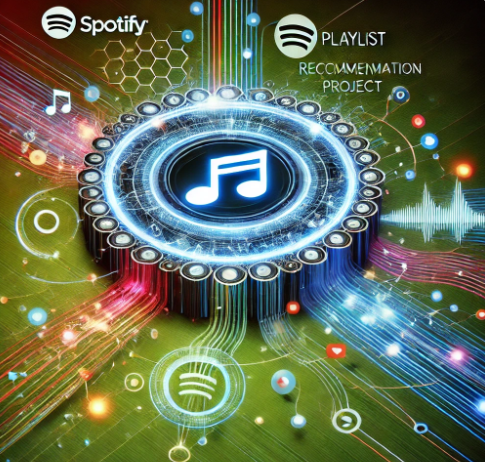

In [ ]:
import torch

print("Is GPU available:", torch.cuda.is_available())
if torch.cuda.is_available():
    print("GPU Name:", torch.cuda.get_device_name(0))
else:
    print("No GPU detected.")


Is GPU available: True
GPU Name: NVIDIA L4


In [ ]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))


Num GPUs Available:  1


# ***Project Title: Building a Personalized Playlist Recommendation System with Spotify Data***

**Business Question**

"How can we develop a system to recommend personalized playlists to users, leveraging playlist data alone to identify contextual relationships between songs and generate relevant suggestions for a given input song?"

**Overview**

This project aims to answer the business question by analyzing and preprocessing Spotify playlist data to uncover patterns and relationships between songs. By leveraging the co-occurrence of tracks within user-created playlists, we can identify contextual similarities between songs and build a personalized recommendation system.

The dataset is a large collection of user playlists, which provides a unique opportunity to analyze song combinations and infer meaningful relationships without requiring additional metadata such as user preferences or song audio features.

**Objective**

The primary goal is to prepare and process the dataset to create a foundation for building a playlist recommendation system using techniques like Word2Vec and other Natural Language Processing (NLP) methods.
This involves extracting meaningful insights from playlist data alone and ensuring the dataset is clean, consistent, and ready for embedding generation.

**Dataset Features**
The Spotify dataset contains the following key attributes:

user_id: A unique identifier for the user who created the playlist.

artistname: The artist of the track.

trackname: The title of the track.

playlistname: The name of the playlist where the track appears.

**Challenges**

Large Dataset Size:

The dataset consists of over 12.7 million rows, making processing and analysis computationally intensive.

Missing Values:

Some records contain missing values in critical columns like artistname, trackname, or playlistname.

Inconsistent Data:

Variability in formatting, such as mixed-case text, special characters, and duplicates.

Outliers:

Playlists with an unusually large number of tracks can skew analysis and distort relationships.

**EDA and Preprocessing Plan**

Exploratory Data Analysis (EDA)
The focus areas of EDA include:

Playlist Length Analysis:

Understand the distribution of playlist sizes and identify outliers.
Group playlists by the number of tracks to observe user behavior patterns.

User Activity:

Analyze the number of playlists per user and the number of unique tracks contributed by each user.

Top Artists and Tracks:

Identify the most frequently occurring artists and tracks in the dataset.

Data Quality Check:

Inspect for missing values, duplicates, and irregularities in text formatting (e.g., special characters).

**Preprocessing Steps**

Handle Missing Values:

Drop or fill null values in critical columns (artistname, trackname, playlistname).

Example: Replace missing artist or track names with placeholders like "unknown_artist".

Normalize Text:

Convert all text to lowercase for consistency.

Remove leading/trailing spaces and special characters.

Handle special letters using normalization (e.g., "Mötley Crüe" → "motley crue").

Remove Duplicates:

Eliminate duplicate rows to improve data quality.

Analyze and Cap Playlist Lengths:

Cap excessively long playlists (e.g., more than 500 tracks) or remove outliers entirely to maintain balance.

Tokenize Playlists:

Transform playlists into tokenized sequences of tracks, which will serve as input for the recommendation model.

Generate Playlist Statistics:

Calculate metrics like average playlist length, unique tracks per playlist, and user contribution to further refine data insights.

**Approach to Recommendation System**

The recommendation system will utilize Word2Vec embeddings to map songs into a high-dimensional space based on their co-occurrence within playlists. Key steps include:

Input Preparation:

Tokenize playlists into sequences of track names.
Train a Word2Vec model to generate vector embeddings for each track.

Similarity Calculation:
Use cosine similarity between track embeddings to identify similar songs for recommendations.

Output:

For a given input song, recommend a set of tracks that frequently co-occur with it in playlists.

**Expected Outcome**

A cleaned and processed dataset ready for Word2Vec embedding generation.

Insights into playlist patterns, user behavior, and popular tracks/artists.

A proof-of-concept recommendation system that suggests personalized playlists or songs based solely on playlist data.

# Recognizing and Handling bad lines (expected 4 elements separated by comas and got different number of elements)

In [ ]:
import gdown
import pandas as pd

# Define the Google Drive file ID
file_id = '189D-QIh1J_3_S6qM7It3f20F0iN7Wvy-'

# Construct the download URL
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output CSV file path
output_csv_path = 'spotify_dataset.csv'

# Download the file using gdown
gdown.download(download_url, output_csv_path, quiet=False)

# Load the CSV into a DataFrame
df_original = pd.read_csv(output_csv_path)

# Display the first few rows
df_original.head()


Downloading...
From (original): https://drive.google.com/uc?export=download&id=189D-QIh1J_3_S6qM7It3f20F0iN7Wvy-
From (redirected): https://drive.google.com/uc?export=download&id=189D-QIh1J_3_S6qM7It3f20F0iN7Wvy-&confirm=t&uuid=a11e48dd-75f2-4869-b29f-77b4db486db9
To: /content/spotify_dataset.csv
100%|██████████| 1.18G/1.18G [00:11<00:00, 101MB/s] 


ParserError: Error tokenizing data. C error: Expected 4 fields in line 14735, saw 5


Can't open the direct link because of bad lines in the dataset, lets check malformed rows:

In [ ]:
with open(output_csv_path, 'r') as file, open('malformed_rows.csv', 'w') as malformed_file:
    for i, line in enumerate(file):
        if len(line.split(',')) != 4:  # Expected number of columns
            malformed_file.write(f"Line {i + 1}: {line}")


Expected 4 elements (=4 columns: user id, artistname, trackname, playlist) and got different result, meaning we need to put a quotechar = ' " ', that will recognize an element as one and not more than that because an element comes with brackets because it's a string.

# Direct link to the Spotify_playlist.csv dataset (no need to download)

In [ ]:
import gdown
import pandas as pd

# Define the Google Drive file ID
file_id = '189D-QIh1J_3_S6qM7It3f20F0iN7Wvy-'

# Construct the download URL
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output CSV file path
output_csv_path = 'spotify_dataset.csv'

# Download the file using gdown
gdown.download(download_url, output_csv_path, quiet=False)

# Load the CSV with proper handling of quoted fields
df_original = pd.read_csv(output_csv_path, quotechar='"',escapechar='\\', on_bad_lines='skip') # Some elements in one row have more than 4 elements (meaning 4 columns) because some track names (for example) contain comas
#so we implement a quotechasr='"' so a song will be read as one element.

# Display the first few rows
df_original.head()


Downloading...
From (original): https://drive.google.com/uc?export=download&id=189D-QIh1J_3_S6qM7It3f20F0iN7Wvy-
From (redirected): https://drive.google.com/uc?export=download&id=189D-QIh1J_3_S6qM7It3f20F0iN7Wvy-&confirm=t&uuid=aa206aaa-6b00-4b7d-ae86-aeabbf5ebbea
To: /content/spotify_dataset.csv
100%|██████████| 1.18G/1.18G [00:22<00:00, 52.3MB/s]


,user_id,"""artistname""","""trackname""","""playlistname"""
0,9cc0cfd4d7d7885102480dd99e7a90d6,Elvis Costello,(The Angels Wanna Wear My) Red Shoes,HARD ROCK 2010
1,9cc0cfd4d7d7885102480dd99e7a90d6,Elvis Costello & The Attractions,"(What's So Funny 'Bout) Peace, Love And Unders...",HARD ROCK 2010
2,9cc0cfd4d7d7885102480dd99e7a90d6,Tiffany Page,7 Years Too Late,HARD ROCK 2010
3,9cc0cfd4d7d7885102480dd99e7a90d6,Elvis Costello & The Attractions,Accidents Will Happen,HARD ROCK 2010
4,9cc0cfd4d7d7885102480dd99e7a90d6,Elvis Costello,Alison,HARD ROCK 2010


# Preliminary EDA (df=data frame)

escapechar handles the backslash \

quotechar handles the coma inside a string ""

In [ ]:
import gdown
import pandas as pd

# Direct link to your Google Drive file
file_id = '189D-QIh1J_3_S6qM7It3f20F0iN7Wvy-'
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Download the file to a local path
output_csv_path = 'spotify_dataset.csv'
gdown.download(download_url, output_csv_path, quiet=False)

# Load the CSV with pandas
df = pd.read_csv(output_csv_path, quotechar='"',escapechar='\\', keep_default_na=True, on_bad_lines='warn')
print(df.head())

Streaming output truncated to the last 5000 lines.
Skipping line 6258854: expected 4 fields, saw 5
Skipping line 6258856: expected 4 fields, saw 6
Skipping line 6258858: expected 4 fields, saw 5
Skipping line 6258861: expected 4 fields, saw 5
Skipping line 6258863: expected 4 fields, saw 5
Skipping line 6258870: expected 4 fields, saw 5
Skipping line 6258873: expected 4 fields, saw 5
Skipping line 6258874: expected 4 fields, saw 5
Skipping line 6258875: expected 4 fields, saw 5
Skipping line 6258878: expected 4 fields, saw 5
Skipping line 6258879: expected 4 fields, saw 5
Skipping line 6259203: expected 4 fields, saw 5
Skipping line 6272218: expected 4 fields, saw 5
Skipping line 6273536: expected 4 fields, saw 5
Skipping line 6273560: expected 4 fields, saw 5
Skipping line 6274127: expected 4 fields, saw 5
Skipping line 6274855: expected 4 fields, saw 5
Skipping line 6280493: expected 4 fields, saw 7
Skipping line 6284775: expected 4 fields, saw 5
Skipping line 6284802: expected 4 fie

                            user_id                      "artistname"  \
0  9cc0cfd4d7d7885102480dd99e7a90d6                    Elvis Costello   
1  9cc0cfd4d7d7885102480dd99e7a90d6  Elvis Costello & The Attractions   
2  9cc0cfd4d7d7885102480dd99e7a90d6                      Tiffany Page   
3  9cc0cfd4d7d7885102480dd99e7a90d6  Elvis Costello & The Attractions   
4  9cc0cfd4d7d7885102480dd99e7a90d6                    Elvis Costello   

                                         "trackname"  "playlistname"  
0               (The Angels Wanna Wear My) Red Shoes  HARD ROCK 2010  
1  (What's So Funny 'Bout) Peace, Love And Unders...  HARD ROCK 2010  
2                                   7 Years Too Late  HARD ROCK 2010  
3                              Accidents Will Happen  HARD ROCK 2010  
4                                             Alison  HARD ROCK 2010  


How many rows in the malformed rows, have less than 4 elements : (answer is 0)

In [ ]:
# Define the file path
file_path = 'spotify_dataset.csv'  # Update with your actual file path

# Open the file and check for malformed rows
malformed_rows = []
with open(file_path, 'r') as file:
    for i, line in enumerate(file):
        # Split the row by the delimiter and count elements
        if len(line.split(',')) < 4:  # Adjust '4' to the expected number of columns
            malformed_rows.append((i + 1, line))  # Store the line number and content

# Display malformed rows
print(f"Number of malformed rows: {len(malformed_rows)}")
for line_number, content in malformed_rows[:10]:  # Show the first 10 malformed rows
    print(f"Line {line_number}: {content}")


Number of malformed rows: 0


In [ ]:

# Display basic information
df_original.info()

# Show the first few rows
df_original.head()

# Check for missing values
df_original.isnull().sum()

# Analyze unique values in columns
df_original.nunique()

# Describe the dataset
df_original.describe(include='all')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12891680 entries, 0 to 12891679
Data columns (total 4 columns):
 #   Column           Dtype 
---  ------           ----- 
 0   user_id          object
 1    "artistname"    object
 2    "trackname"     object
 3    "playlistname"  object
dtypes: object(4)
memory usage: 393.4+ MB


,user_id,"""artistname""","""trackname""","""playlistname"""
count,12891680,12858108,12891592,12890434
unique,15918,289820,2032043,157504
top,4398de6902abde3351347b048fcdc287,Daft Punk,Intro,Starred
freq,295275,36086,6676,1337085


In [ ]:
# Display basic information
df_original.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12891680 entries, 0 to 12891679
Data columns (total 4 columns):
 #   Column           Dtype 
---  ------           ----- 
 0   user_id          object
 1    "artistname"    object
 2    "trackname"     object
 3    "playlistname"  object
dtypes: object(4)
memory usage: 393.4+ MB


dataset has successfully loaded with 12,891,680 rows and 4 columns, but the column names have extra quotes (e.g., "artistname", "trackname", "playlistname"), which might cause issues during analysis.

In [ ]:
df.columns = df.columns.str.strip().str.replace('"', '')
print(df.columns)

Index(['user_id', 'artistname', 'trackname', 'playlistname'], dtype='object')


In [ ]:
# Show the first few rows
df_original.head()

,user_id,"""artistname""","""trackname""","""playlistname"""
0,9cc0cfd4d7d7885102480dd99e7a90d6,Elvis Costello,(The Angels Wanna Wear My) Red Shoes,HARD ROCK 2010
1,9cc0cfd4d7d7885102480dd99e7a90d6,Elvis Costello & The Attractions,"(What's So Funny 'Bout) Peace, Love And Unders...",HARD ROCK 2010
2,9cc0cfd4d7d7885102480dd99e7a90d6,Tiffany Page,7 Years Too Late,HARD ROCK 2010
3,9cc0cfd4d7d7885102480dd99e7a90d6,Elvis Costello & The Attractions,Accidents Will Happen,HARD ROCK 2010
4,9cc0cfd4d7d7885102480dd99e7a90d6,Elvis Costello,Alison,HARD ROCK 2010


In [ ]:
# Check for missing values
df_original.isnull().sum()


,0
user_id,0
"""artistname""",33572
"""trackname""",88
"""playlistname""",1246


In [ ]:
# Analyze unique values in columns
df_original.nunique()

,0
user_id,15918
"""artistname""",289820
"""trackname""",2032043
"""playlistname""",157504


In [ ]:
# Describe the dataset
df_original.describe(include='all')

,user_id,"""artistname""","""trackname""","""playlistname"""
count,12891680,12858108,12891592,12890434
unique,15918,289820,2032043,157504
top,4398de6902abde3351347b048fcdc287,Daft Punk,Intro,Starred
freq,295275,36086,6676,1337085


In [ ]:
print(df[df['"artistname"'].str.contains(r'\\', na=False)])  # Rows with backslash in artistname
print(df[df['"trackname"'].str.contains(r'\\', na=False)])  # Rows with backslash in trackname
print(df[df['"playlistname"'].str.contains(r'\\', na=False)])  # Rows with backslash in playlistname


KeyError: '"artistname"'

#EDA- extensive - i need to devide into blocks for better understanding but it is based on all knowledge i got from initial EDA i did.

In [ ]:
import pandas as pd

# Step 1: Load the CSV with `quotechar='"'`
df_original = pd.read_csv('spotify_dataset.csv', quotechar='"', on_bad_lines='skip')
df_original.to_csv('step1_loaded.csv', index=False)
print("Step 1 saved: step1_loaded.csv")

# Step 2: Clean column names
df_original.columns = df_original.columns.str.strip().str.replace('"', '')  # Remove quotes and spaces
df_original.to_csv('step2_cleaned_columns.csv', index=False)
print("Step 2 saved: step2_cleaned_columns.csv")

# Step 3: Handle missing values
df_original = df_original.dropna()  # Remove rows with missing values
# Optional: Fill missing values instead of dropping them
# df_original.fillna({'artistname': 'unknown', 'trackname': 'unknown', 'playlistname': 'unknown'}, inplace=True)
df_original.to_csv('step3_handled_missing.csv', index=False)
print("Step 3 saved: step3_handled_missing.csv")

# Step 4: Convert all string columns to lowercase
string_columns = df_original.select_dtypes(include='object').columns  # Identify string columns
df_original[string_columns] = df_original[string_columns].apply(lambda col: col.str.lower())
df_original.to_csv('step4_lowercase.csv', index=False)
print("Step 4 saved: step4_lowercase.csv")

# Step 5: Duplicate Rows
print(f"Number of duplicate rows: {df_original.duplicated().sum()}")
df_original = df_original.drop_duplicates()
df_original.to_csv('step5_removed_duplicates.csv', index=False)
print("Step 5 saved: step5_removed_duplicates.csv")

# Step 6: Distribution Analysis
print(df_original['artistname'].value_counts().head(10)) # Most Frequent Artists

print(df_original['trackname'].value_counts().head(10)) # Most Frequent Tracks

#Save these distributions for review:
df_original['artistname'].value_counts().head(10).to_csv('top10_artists.csv')
df_original['trackname'].value_counts().head(10).to_csv('top10_tracks.csv')

# Step 7: Playlist Diversity
playlist_diversity = df_original.groupby('playlistname')['trackname'].nunique()
playlist_diversity.to_csv('step7_playlist_diversity.csv')
print("Step 7 saved: step7_playlist_diversity.csv")

df_original['artistname'] = df_original['artistname'].str.strip()
df_original['trackname'] = df_original['trackname'].str.strip()
df_original['playlistname'] = df_original['playlistname'].str.strip()

# Step 8: Normalize or Standardize Text
#Remove extra spaces, special characters, or unusual formatting in text fields
df_original.to_csv('step8_normalized_text.csv', index=False)
print("Step 8 saved: step8_normalized_text.csv")

# Step 9: Check for Unusual Values
print(df_original[df_original['artistname'].str.len() < 2])  # Artists with very short names
print(df_original[df_original['trackname'].str.len() < 2])  # Tracks with very short names
print(df_original[df_original['playlistname'].str.len() < 2])  # Playlists with very short names

# filter these values out:
df_original = df_original[df_original['artistname'].str.len() >= 2]
df_original = df_original[df_original['trackname'].str.len() >= 2]
df_original = df_original[df_original['playlistname'].str.len() >= 2]

df_original.to_csv('step9_filtered_unusual_values.csv', index=False)
print("Step 9 saved: step9_filtered_unusual_values.csv")

# Step 10: Create Summary Statistics
summary = df_original.describe(include='all')
summary.to_csv('step10_summary_statistics.csv')
print("Step 10 saved: step10_summary_statistics.csv")

# Step 11:Identify Relationships
#Track Count per Artist
track_count_per_artist = df_original.groupby('artistname')['trackname'].nunique()
track_count_per_artist.to_csv('step11_track_count_per_artist.csv')
print("Step 11 saved: step11_track_count_per_artist.csv")

#Tracks per Playlist
tracks_per_playlist = df_original.groupby('playlistname')['trackname'].nunique()
tracks_per_playlist.to_csv('step11_tracks_per_playlist.csv')
print("Step 11 saved: step11_tracks_per_playlist.csv")

# Step 12: Save Cleaned and Processed Data
#Save Cleaned and Processed Data
df_original.to_csv('final_cleaned_dataset.csv', index=False)
print("Final dataset saved: final_cleaned_dataset.csv")






Step 1 saved: step1_loaded.csv
Step 2 saved: step2_cleaned_columns.csv
Step 3 saved: step3_handled_missing.csv
Step 4 saved: step4_lowercase.csv
Number of duplicate rows: 25183
Step 5 saved: step5_removed_duplicates.csv
artistname
daft punk             36049
coldplay              35521
radiohead             31454
the rolling stones    30746
kanye west            29112
jay z                 28966
eminem                28896
queen                 28010
david bowie           27790
michael jackson       26224
Name: count, dtype: int64
trackname
intro          6712
home           5607
closer         3551
runaway        3350
hold on        3282
radioactive    3188
forever        3067
stay           3006
alive          2940
wake me up     2838
Name: count, dtype: int64
Step 7 saved: step7_playlist_diversity.csv
Step 8 saved: step8_normalized_text.csv
                                   user_id artistname  \
14137     650c4d63a819dbb77cc15a87f407039a              
45135     db937456654d2465292c

# Direct link to final_cleaned_dataset.csv (file after EDA)

In [ ]:
import gdown
import pandas as pd

# Define the Google Drive file ID
file_id = '1pw1rhn2FoRoFvdKdq1iSuX6hotUEtn-X'
# Construct the download URL
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output CSV file path
output_csv_path = 'final_cleaned_dataset.csv'

# Download the file using gdown
gdown.download(download_url, output_csv_path, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?export=download&id=1pw1rhn2FoRoFvdKdq1iSuX6hotUEtn-X
From (redirected): https://drive.google.com/uc?export=download&id=1pw1rhn2FoRoFvdKdq1iSuX6hotUEtn-X&confirm=t&uuid=6d4d79e5-409a-4d97-8786-59cec9951b4b
To: /content/final_cleaned_dataset.csv
100%|██████████| 1.04G/1.04G [00:10<00:00, 97.3MB/s]


'final_cleaned_dataset.csv'

In [ ]:
import pandas as pd

# Load the final saved file
df_final = pd.read_csv('final_cleaned_dataset.csv')

# 1. Basic Information
print("Basic Information:")
print(df_final.info())

# 2. Shape of the Dataset
print("\nShape of the Dataset:")
print(f"Number of rows: {df_final.shape[0]}")
print(f"Number of columns: {df_final.shape[1]}")

# 3. Summary Statistics
print("\nSummary Statistics:")
print(df_final.describe(include='all'))  # Include all columns (numeric and categorical)

# 4. Column-Wise Null Check
print("\nMissing Values Per Column:")
print(df_final.isnull().sum())

# 5. Head and Tail (First and Last Rows)
print("\nFirst 5 Rows:")
print(df_final.head())

print("\nLast 5 Rows:")
print(df_final.tail())


Basic Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12743252 entries, 0 to 12743251
Data columns (total 4 columns):
 #   Column        Dtype 
---  ------        ----- 
 0   user_id       object
 1   artistname    object
 2   trackname     object
 3   playlistname  object
dtypes: object(4)
memory usage: 388.9+ MB
None

Shape of the Dataset:
Number of rows: 12743252
Number of columns: 4

Summary Statistics:
                                 user_id artistname trackname playlistname
count                           12743252   12743249  12743230     12743252
unique                             15864     276963   1841157       137880
top     4398de6902abde3351347b048fcdc287  daft punk     intro      starred
freq                              294834      35890      6704      1330532

Missing Values Per Column:
user_id          0
artistname       3
trackname       22
playlistname     0
dtype: int64

First 5 Rows:
                            user_id                       artistnam

In [ ]:
print(f"Shape after step X: {df_final.shape}")


Shape after step X: (12743252, 4)


# Preprocessing of the data

## Step 1: Handling missing values

From last analysis on final_cleaned_dataset.csv we see there are still missing values even after handling them in EDA:

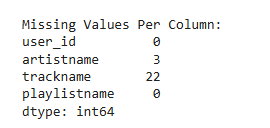

In [ ]:
# Display rows with missing values
missing_data = df_final[df_final.isnull().any(axis=1)]
print("Rows with missing values:")
print(missing_data)


Rows with missing values:
                                   user_id            artistname  \
621134    c4f7f2f76ffb91bc97d5d74cac0bb1bc           brunori sas   
691427    4b229cd34de420c309b4e54a07b52777           stoned baby   
795324    3025b16e8aca079113af72ef07cbf693           brunori sas   
1573529   e29513294cd6754142a2f1e1bb54975f        booker t jones   
1603298   4191cfd13e46e23647d408d812280aee              sonzeira   
2319046   8cb1e3faf1c1643c69d1f806cbcc5b1e                  ween   
2459362   853c7d22d041015dbc3b248194331e50         the algorithm   
3969056   a4f65b7929c00088b8bcba010363d375                  ween   
4718645   db61fa74dbd6b564ae115f42370163d6                benjie   
4737086   f82a1fe28c47aed215b6547fc55fab95         the algorithm   
4837169   932d18ffe570c999355cd5d7627ed375             bossa rio   
5099907   7494ee41e5d815b5f88b90e46e321057        booker t jones   
5765602   5debd9fcd3621c27d6200880bc3e187e  holographic dissolve   
6270819   fba23f128b62

Analysis of Missing Data
Missing artistname:

There are rows where artistname is missing but other columns (like trackname and playlistname) have valid data.
Action: You can fill these with a placeholder like "unknown_artist".
Missing trackname:

Rows with missing trackname lack critical information, as the track is essential for playlist analysis.
Action: These rows should ideally be dropped, as trackname is required for modeling.
playlistname:

There are no missing values in this column, so no action is required here.

In [ ]:
# Fill missing artist names with 'unknown_artist'
df_final['artistname'] = df_final['artistname'].fillna('unknown_artist')

# Drop rows with missing track names, as they lack essential information
df_final = df_final.dropna(subset=['trackname'])

# Verify that there are no missing values
print("Missing values after handling:")
print(df_final.isnull().sum())

# Save the cleaned dataset
df_final.to_csv('processed_data_missing_handled.csv', index=False)
print("Processed data with missing values handled saved: processed_data_missing_handled.csv")


Missing values after handling:
user_id         0
artistname      0
trackname       0
playlistname    0
dtype: int64
Processed data with missing values handled saved: processed_data_missing_handled.csv


Now there are no missing values.

Rows with missing artistname will have "unknown_artist" as a placeholder.

Rows with missing trackname will be dropped.

The dataset will be free of missing values, ready for further preprocessing or analysis.

## Step 2: Analysis of Cleaned Data (after handling all missing values)

In [ ]:
print(f"Shape after step X: {df_final.shape}")

Shape after step X: (12743230, 4)


In [ ]:
# Count the total occurrences of 'unknown_artist'
unknown_artist_count = df_final['artistname'].value_counts().get('unknown_artist', 0)

# Display the count
print(f"Total occurrences of 'unknown_artist': {unknown_artist_count}")


Total occurrences of 'unknown_artist': 3


## Step 3: Analyze Playlist Lengths

Use the number of tracks per playlist to understand distribution and identify outliers.


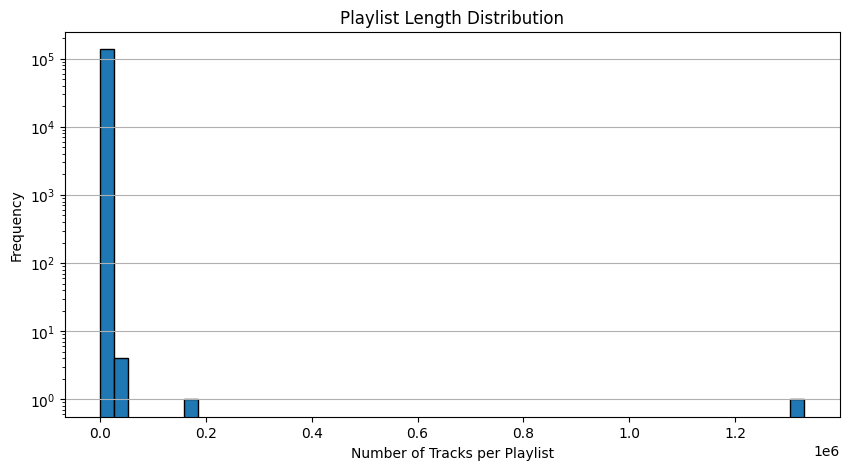

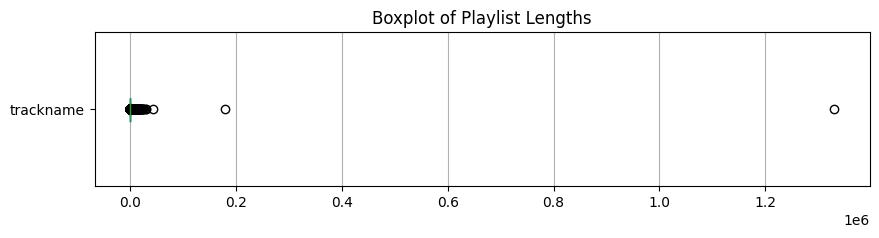

Playlist Length Statistics:
count    1.378800e+05
mean     9.242261e+01
std      3.642729e+03
min      1.000000e+00
25%      1.100000e+01
50%      2.100000e+01
75%      5.200000e+01
max      1.330529e+06
Name: trackname, dtype: float64


In [ ]:
import matplotlib.pyplot as plt

# Calculate playlist lengths
playlist_lengths = df_final.groupby('playlistname')['trackname'].count()

# Save the playlist lengths for reference
playlist_lengths.to_csv('playlist_lengths.csv')

# Plot histogram for playlist lengths
plt.figure(figsize=(10, 5))
playlist_lengths.plot(kind='hist', bins=50, edgecolor='black', logy=True)
plt.title('Playlist Length Distribution')
plt.xlabel('Number of Tracks per Playlist')
plt.ylabel('Frequency')
plt.grid(axis='y')
plt.show()

# Boxplot to visualize outliers
plt.figure(figsize=(10, 2))
playlist_lengths.plot(kind='box', vert=False)
plt.title('Boxplot of Playlist Lengths')
plt.grid(axis='x')
plt.show()

# Basic statistics of playlist lengths
print("Playlist Length Statistics:")
print(playlist_lengths.describe())



Looking at the Playlist Length Statistics, here's what each metric tells us:

Key Metrics:

Count (count):

**Total number of playlists analyzed: 137,880.** This is the total number of **unique playlists** in the dataset.

Mean (mean):

Average number of tracks per playlist: ~92.42. On average, **playlists contain around 92 tracks.** This value is skewed upwards due to outliers (e.g., extremely long playlists).

Standard Deviation (std):

**Standard deviation is very large: ~3,642.73. This indicates that playlist lengths vary widely,** with some being extremely large (outliers).

Minimum (min):

**The smallest playlist has only 1 track.** This might indicate edge cases, such as test or private playlists.

25th Percentile (25%):

**25% of playlists have 11 or fewer tracks.** This suggests that a significant number of playlists are **relatively short.**

Median (50%):

The median playlist length is 21 tracks, meaning that half the playlists contain 21 tracks or fewer. This is a more realistic representation of typical playlist length compared to the mean.

75th Percentile (75%):

75% of playlists have 52 tracks or fewer. This suggests that most playlists are moderately sized, while only **a small proportion are large.**

Maximum (max):

**The largest playlist has 1,330,529 tracks! This is an extreme outlier** and likely represents an aggregated or error-prone playlist.

### The longest playlist is: starred, Number of unique songs in the longest playlist: 417336

In [ ]:
# Find the name of the longest playlist
longest_playlist_name = df_final.groupby('playlistname')['trackname'].count().idxmax()

# Filter the longest playlist
longest_playlist = df_final[df_final['playlistname'] == longest_playlist_name]

# Count unique songs in the longest playlist
unique_songs_count = longest_playlist['trackname'].nunique()

print(f"The longest playlist is: {longest_playlist_name}")
print(f"Number of unique songs in the longest playlist: {unique_songs_count}")


The longest playlist is: starred
Number of unique songs in the longest playlist: 417336


### WORD ANALYSIS EDA on RAW cleaned data

What This Analysis Provides:

1. Most Frequent Words: Common patterns and repetitive words.

2. Rare Words: Insights into outliers and potentially noisy data.

3. Unusual Characters: Words with special characters or numbers.

4. Stop Words: High-frequency but less meaningful words to consider removing.

5. Case Sensitivity: Identifying inconsistencies in capitalization.

6. Track Lengths: Evaluating word count distribution for tracks.

### Step 1: Word Frequency Analysis

Most common words:
[('the', 4054468), ('starred', 1337275), ('of', 1212455), ('a', 752283), ('in', 726628), ('you', 716803), ('i', 684184), ('to', 610761), ('and', 585116), ('my', 580685)]


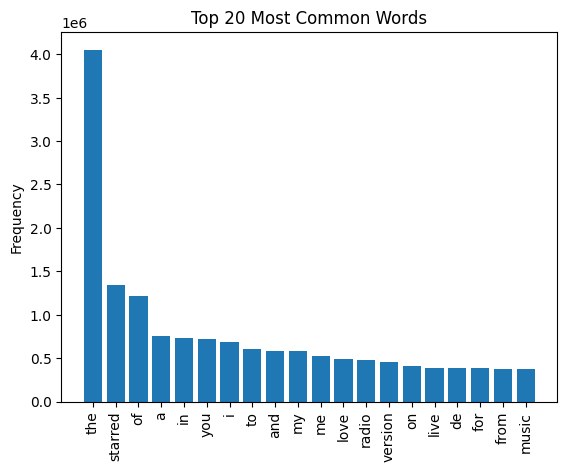

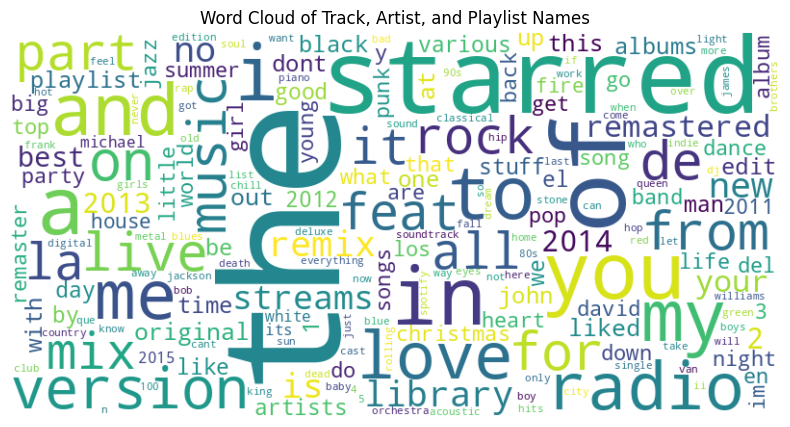

In [ ]:
from collections import Counter
import matplotlib.pyplot as plt
from wordcloud import WordCloud

# Combine all text columns into a single string for analysis
all_text = ' '.join(df_final['trackname'].fillna('') + ' ' +
                    df_final['artistname'].fillna('') + ' ' +
                    df_final['playlistname'].fillna(''))

# Split the text into words
words = all_text.split()

# Count word frequencies
word_counts = Counter(words)

# Display the 10 most common words
print("Most common words:")
print(word_counts.most_common(10))

# Visualize the top 20 words
top_words = word_counts.most_common(20)
words, counts = zip(*top_words)
plt.bar(words, counts)
plt.xticks(rotation=90)
plt.title("Top 20 Most Common Words")
plt.ylabel("Frequency")
plt.show()

# Generate a Word Cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_counts)
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("Word Cloud of Track, Artist, and Playlist Names")
plt.show()


### Step 2: Rare and Unique Words

Number of rare words: 180063
Examples of rare words: ['christodoulou', 'barb4ry', 'battlesmallboss', 'battleorochi', 'batenkaitos', 'hortobgyigyan', 'uttejak', 'berges', 'genma', 'unassuming']


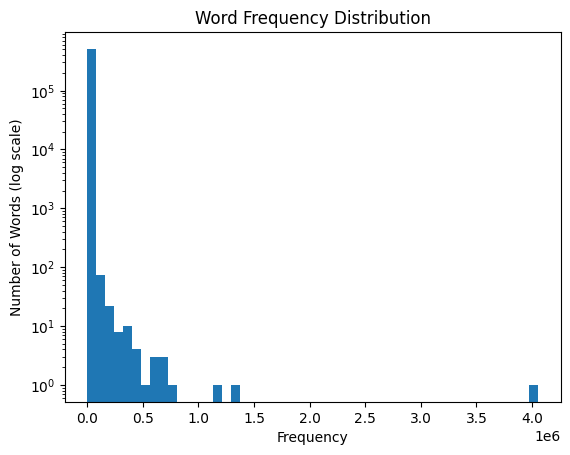

In [ ]:
# Identify rare words that occur only once
rare_words = [word for word, count in word_counts.items() if count == 1]
print(f"Number of rare words: {len(rare_words)}")
print("Examples of rare words:", rare_words[:10])

# Visualize the frequency distribution of all words
plt.hist(word_counts.values(), bins=50, log=True)
plt.title("Word Frequency Distribution")
plt.xlabel("Frequency")
plt.ylabel("Number of Words (log scale)")
plt.show()


### Step 3: Unusual Characters or Patterns

In [ ]:
import re

# Check for words with unusual characters
unusual_words = [word for word in word_counts.keys() if re.search(r'[^a-zA-Z0-9\s]', word)]
print(f"Number of words with unusual characters: {len(unusual_words)}")
print("Examples of words with unusual characters:", unusual_words[:10])

# Check for numbers in words
numeric_words = [word for word in word_counts.keys() if re.search(r'\d', word)]
print(f"Number of words containing numbers: {len(numeric_words)}")
print("Examples of numeric words:", numeric_words[:10])


Number of words with unusual characters: 1
Examples of words with unusual characters: ['unknown_artist']
Number of words containing numbers: 28660
Examples of numeric words: ['2010', '7', '3', '5', '2012', '1', '2080', 'c418', 'bd08', '0x10c']


### Step 4: Stop Word Analysis

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


Most common stop words:
[('the', 4054468), ('of', 1212455), ('a', 752283), ('in', 726628), ('you', 716803), ('i', 684184), ('to', 610761), ('and', 585116), ('my', 580685), ('me', 527998)]


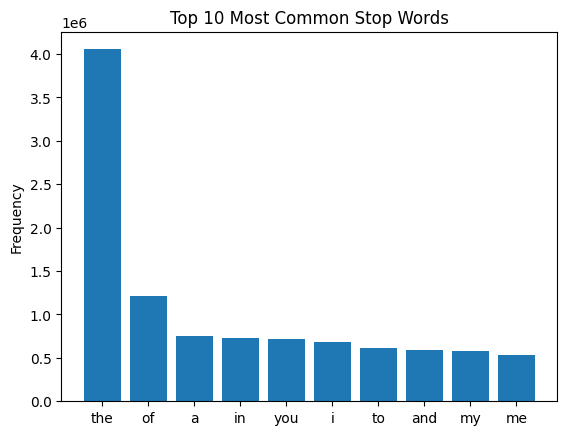

In [ ]:
from nltk.corpus import stopwords
import nltk

# Download stop words if not already downloaded
nltk.download('stopwords')

# List of stop words
stop_words = set(stopwords.words('english'))

# Count stop words in the dataset
stop_word_counts = {word: count for word, count in word_counts.items() if word in stop_words}
print("Most common stop words:")
print(sorted(stop_word_counts.items(), key=lambda x: x[1], reverse=True)[:10])

# Visualize stop words
stop_words, counts = zip(*sorted(stop_word_counts.items(), key=lambda x: x[1], reverse=True)[:10])
plt.bar(stop_words, counts)
plt.title("Top 10 Most Common Stop Words")
plt.ylabel("Frequency")
plt.show()


### Step 5: Case Sensitivity Check

In [ ]:
# Check for case-sensitive duplicates
case_sensitive_words = [word for word in word_counts.keys() if word.lower() != word]
print(f"Number of case-sensitive duplicates: {len(case_sensitive_words)}")
print("Examples of case-sensitive duplicates:", case_sensitive_words[:10])


Number of case-sensitive duplicates: 0
Examples of case-sensitive duplicates: []


### Step 6: Distribution of Track Lengths

Track name length statistics:
count    1.274323e+07
mean     3.451542e+00
std      2.338094e+00
min      0.000000e+00
25%      2.000000e+00
50%      3.000000e+00
75%      4.000000e+00
max      5.100000e+01
Name: track_length, dtype: float64


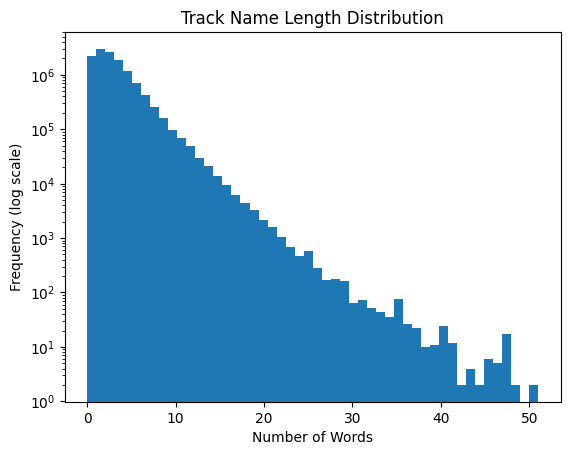

In [ ]:
# Calculate track name lengths
df_final['track_length'] = df_final['trackname'].str.split().str.len()

# Describe the track name lengths
print("Track name length statistics:")
print(df_final['track_length'].describe())

# Visualize the distribution
plt.hist(df_final['track_length'].dropna(), bins=50, log=True)
plt.title("Track Name Length Distribution")
plt.xlabel("Number of Words")
plt.ylabel("Frequency (log scale)")
plt.show()


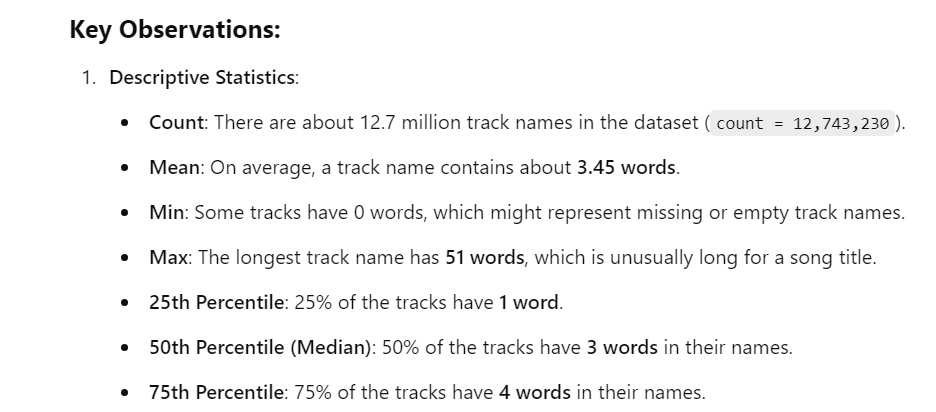

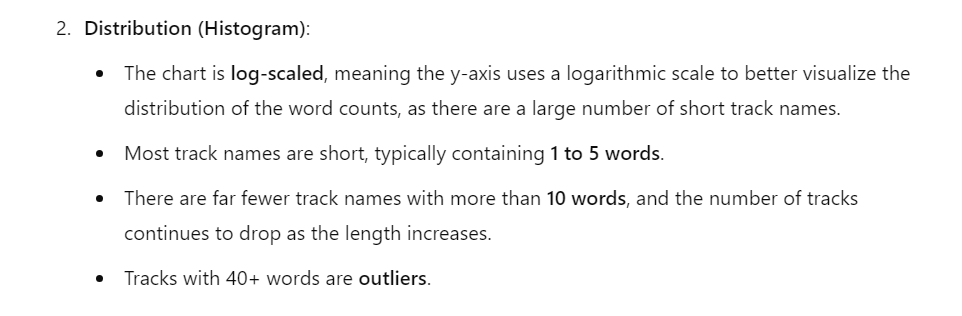

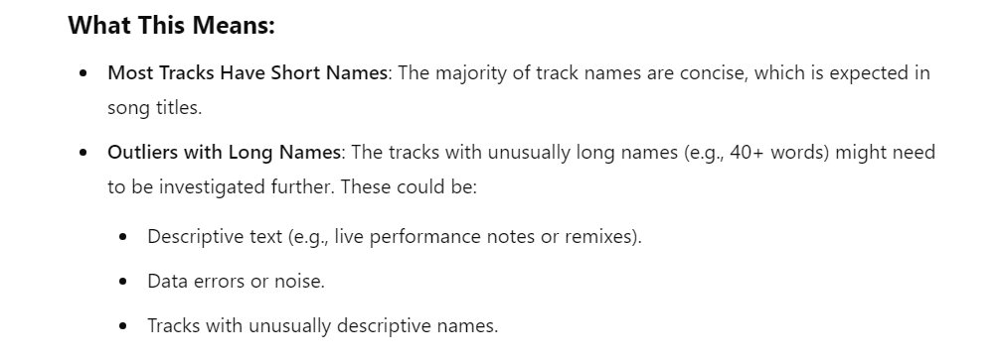

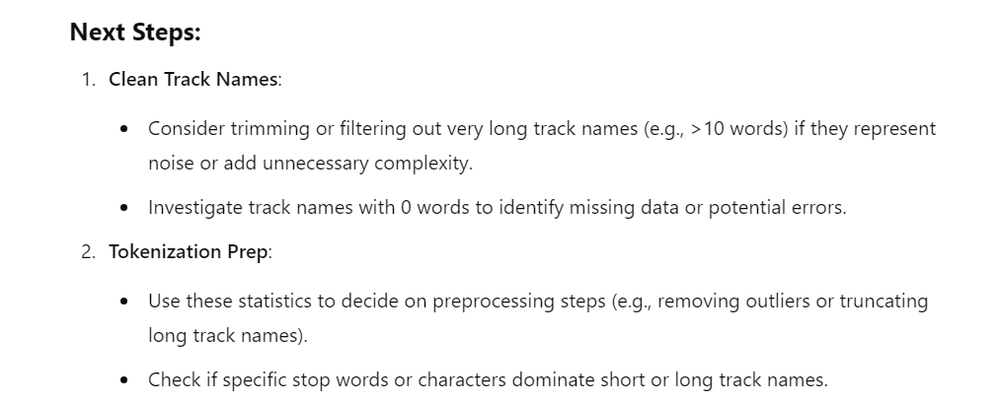

## Step 4: vocabulary and token distributions analysis of 'Starred' playlist (Outlire)

For a Word2Vec model, we primarily focus on analyzing the vocabulary and token distributions rather than diving deep into playlist-specific behaviors.

### Starred playlists a user chose - sample

In [ ]:
# Filter playlists named "starred"
starred_playlists = df_final[df_final['playlistname'].str.lower() == 'starred']

# Display the first few rows to verify
print("Starred playlists sample:")
print(starred_playlists.head())


Starred playlists sample:
                              user_id               artistname  \
767  07f0fc3be95dcd878966b1f9572ff670  bill elm  woody jackson   
768  07f0fc3be95dcd878966b1f9572ff670                  jin roh   
769  07f0fc3be95dcd878966b1f9572ff670         somethingalamode   
770  07f0fc3be95dcd878966b1f9572ff670                 pendulum   
771  07f0fc3be95dcd878966b1f9572ff670              darren korb   

                          trackname playlistname  track_length  
767  theme from red dead redemption      starred             5  
768      22  grace omega main theme      starred             5  
769                            5 am      starred             2  
770                      9000 miles      starred             2  
771                  a proper story      starred             3  


### Percentage of vocabulary from 'starred' playlists: 29.25%

In [ ]:
# Extract tokens from 'starred' playlists
starred_tokens = starred_playlists['trackname'].str.split().explode()

# Unique tokens in 'starred' playlists
unique_starred_tokens = set(starred_tokens)

print(f"Number of unique tokens in 'starred' playlists: {len(unique_starred_tokens)}")

# Compare with overall vocabulary
all_tokens = df_final['trackname'].str.split().explode()
unique_all_tokens = set(all_tokens)

print(f"Total vocabulary size: {len(unique_all_tokens)}")
print(f"Percentage of vocabulary from 'starred' playlists: {len(unique_starred_tokens) / len(unique_all_tokens) * 100:.2f}%")


Number of unique tokens in 'starred' playlists: 121471
Total vocabulary size: 415300
Percentage of vocabulary from 'starred' playlists: 29.25%


### Rare tokens in 'starred' playlists: 55529

In [ ]:
# Count token frequency in 'starred' playlists
starred_token_counts = starred_playlists['trackname'].str.split().explode().value_counts()

# Identify rare tokens (appearing only once)
rare_starred_tokens = starred_token_counts[starred_token_counts == 1]

print(f"Rare tokens in 'starred' playlists: {len(rare_starred_tokens)}")


Rare tokens in 'starred' playlists: 55529


### Analysis of Rare Tokends in "starred" playlists

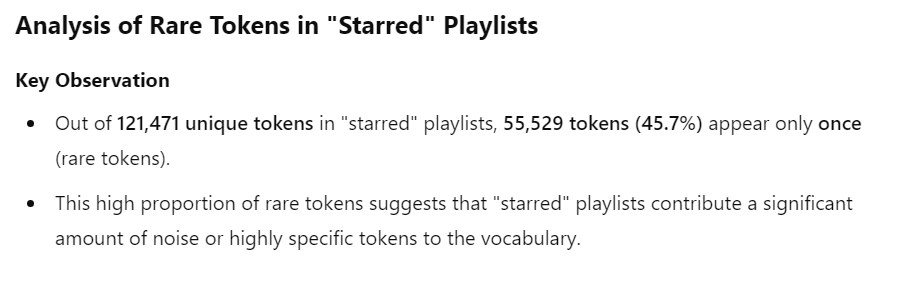

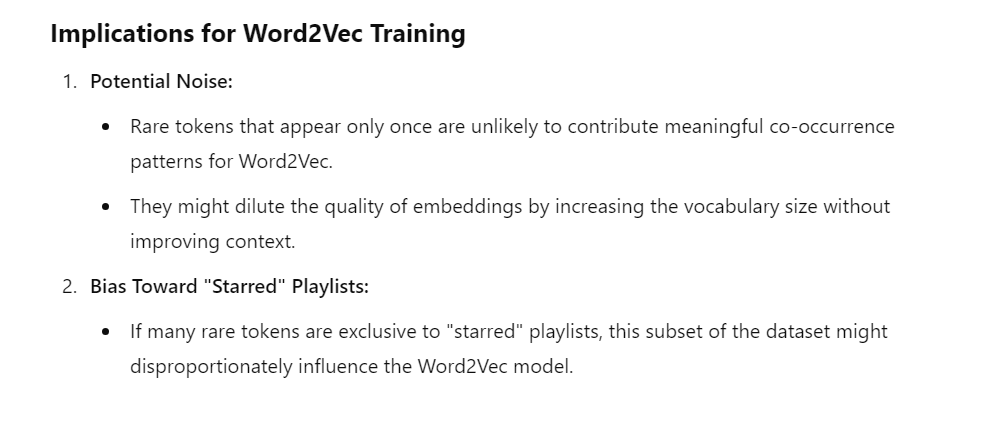

### Percentage of non-rare 'starred' tokens in the rest of the data: 98.90%


In [ ]:
# Identify non-rare tokens in "starred" playlists
non_rare_starred_tokens = starred_token_counts[starred_token_counts > 1].index

# Extract tokens from the rest of the dataset (excluding "starred" playlists)
non_starred_playlists = df_final[df_final['playlistname'].str.lower() != 'starred']
non_starred_tokens = non_starred_playlists['trackname'].str.split().explode().unique()

# Find the intersection of tokens
common_tokens = set(non_rare_starred_tokens).intersection(set(non_starred_tokens))

# Calculate the percentage
percentage_common = (len(common_tokens) / len(non_rare_starred_tokens)) * 100

# Output results
print(f"Number of non-rare tokens in 'starred' playlists: {len(non_rare_starred_tokens)}")
print(f"Number of these tokens also in the rest of the data: {len(common_tokens)}")
print(f"Percentage of non-rare 'starred' tokens in the rest of the data: {percentage_common:.2f}%")


Number of non-rare tokens in 'starred' playlists: 65922
Number of these tokens also in the rest of the data: 65200
Percentage of non-rare 'starred' tokens in the rest of the data: 98.90%


### Explanation how the starred playlist has low impact on overall metadata and word2vec model

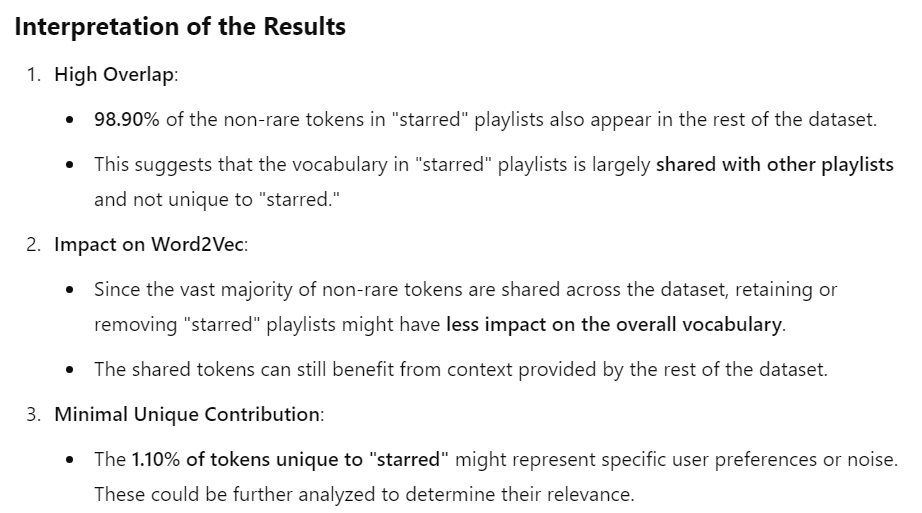

### Top 10 most common tokens in 'starred' playlists

Number of unique tokens in 'starred' playlists: 121451
Top 10 most common tokens in 'starred' playlists:
trackname
the        174439
you         69734
of          59360
i           55957
a           55695
in          52463
me          49498
version     47995
to          43883
love        42553
Name: count, dtype: int64


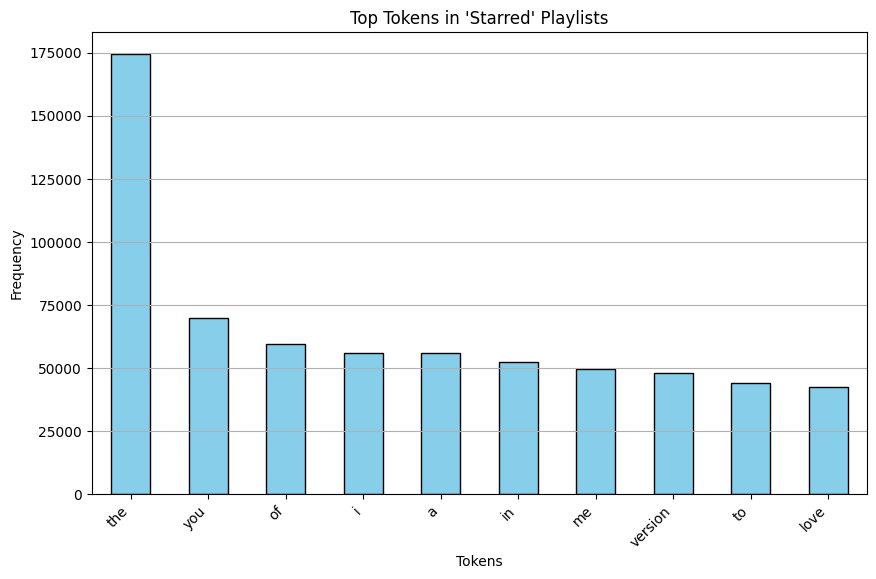

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Step 1: Filter playlists named "starred"
starred_playlists = df_final[df_final['playlistname'].str.lower() == 'starred']

if not starred_playlists.empty:
    # Step 2: Extract tokens from 'trackname' in 'starred' playlists
    starred_tokens = starred_playlists['trackname'].str.split().explode()

    # Step 3: Count unique tokens
    unique_starred_tokens = starred_tokens.nunique()
    print(f"Number of unique tokens in 'starred' playlists: {unique_starred_tokens}")

    # Step 4: Top 10 most common tokens
    top_tokens = starred_tokens.value_counts().head(10)
    print("Top 10 most common tokens in 'starred' playlists:")
    print(top_tokens)

    # Step 5: Visualize top tokens
    plt.figure(figsize=(10, 6))
    top_tokens.plot(kind='bar', color='skyblue', edgecolor='black')
    plt.title("Top Tokens in 'Starred' Playlists")
    plt.xlabel("Tokens")
    plt.ylabel("Frequency")
    plt.xticks(rotation=45, ha='right')
    plt.grid(axis='y')
    plt.show()
else:
    print("No playlists named 'starred' found in the dataset.")


### Percentage of rows with 'starred' playlist: 10.44%

In [ ]:
# Count the number of rows with "starred" as the playlist name
starred_rows_count = df_final[df_final['playlistname'].str.lower() == 'starred'].shape[0]

# Calculate the total number of rows in df_final
total_rows = df_final.shape[0]

# Calculate the percentage
starred_percentage = (starred_rows_count / total_rows) * 100

print(f"Total rows in dataset: {total_rows}")
print(f"Rows with 'starred' playlist: {starred_rows_count}")
print(f"Percentage of rows with 'starred' playlist: {starred_percentage:.2f}%")


Total rows in dataset: 12743230
Rows with 'starred' playlist: 1330529
Percentage of rows with 'starred' playlist: 10.44%


### Number of users who chose ONLY 'starred': 587

In [ ]:
# Step 1: Find users with only "starred" playlists
only_starred_users = df_final.groupby('user_id')['playlistname'].apply(lambda x: set(x.str.lower()) == {'starred'})

# Filter users who chose only "starred"
only_starred_users = only_starred_users[only_starred_users].index

# Step 2: Count and display the results
num_only_starred_users = len(only_starred_users)

print(f"Number of users who chose only 'starred': {num_only_starred_users}")
print("List of users who chose only 'starred':")
print(only_starred_users)


Number of users who chose only 'starred': 587
List of users who chose only 'starred':
Index(['00152c870313100559aad7b097d9c1f5', '004e1cd03ad00ebedf071ffd98665649',
       '0059ac6b3ba3c3f415f09059a3bd703a', '008ac656ed12da791d53ff9f20b17123',
       '009d6038a80daf642db5d1198b760c58', '0129886994c81e6fabc08e5ab2fa494b',
       '016a8eb7c9e5f511bd3749552ab19e56', '017f53f1df26e5adad6a0b93cef8f97b',
       '01ef80101c7c3126b0eab7d5b8071800', '02ac1d2720b551f943ab71f611de9492',
       ...
       'fb465982fe21db80a4bd4719aa80e41e', 'fc37c995a978d79c885f6195c0a360bb',
       'fc7e7592d3afdc92cfb033b1d4174afa', 'fc9922affe4ef68b48c9b01b61c37571',
       'fd94eb26d022a4e17726bbba299683da', 'fe01f365c5423a6d5f064342bec48b38',
       'feeba387444e26c1a1bcf0acf2230f2b', 'fef8fecef4e61a64b3ab7200f249233d',
       'fefb842b510211baa5d17af12d39f1b7', 'ff837f2820fc0d31472a77a6a56f111a'],
      dtype='object', name='user_id', length=587)


## Step 5: User analysis

### 1. Count Playlists per User

In [ ]:
# Count the number of playlists per user
playlists_per_user = df_final.groupby('user_id')['playlistname'].nunique()

# Display summary statistics
print("Playlists per user statistics:")
print(playlists_per_user.describe())

# Top users with the most playlists
print("\nTop 10 users with the most playlists:")
print(playlists_per_user.sort_values(ascending=False).head(10))


Playlists per user statistics:
count    15864.000000
mean        14.498361
std         14.774742
min          1.000000
25%          3.000000
50%          8.000000
75%         22.000000
max        184.000000
Name: playlistname, dtype: float64

Top 10 users with the most playlists:
user_id
872a19d491f4357408551be6d7eea273    184
19ccdb5f2ce9193e6028923f65afaac2    105
57c4979b17f7563f83e69f09701eb584     76
39bd43df0c61c451361200312a4ab6e0     73
13c6654d04eb2e0c09671c8868393722     68
8b604df97432544b8788112f36bc2f07     67
3315b4b13f69b2b3931b0e18a4de512d     58
1dcaa0c136f62562a57acf67b4d0b27f     58
599977e70ddc103506191d0efe38f1b3     56
15af84959451245e028e61c331bdbff4     55
Name: playlistname, dtype: int64


### 2. Visualize Playlists per User

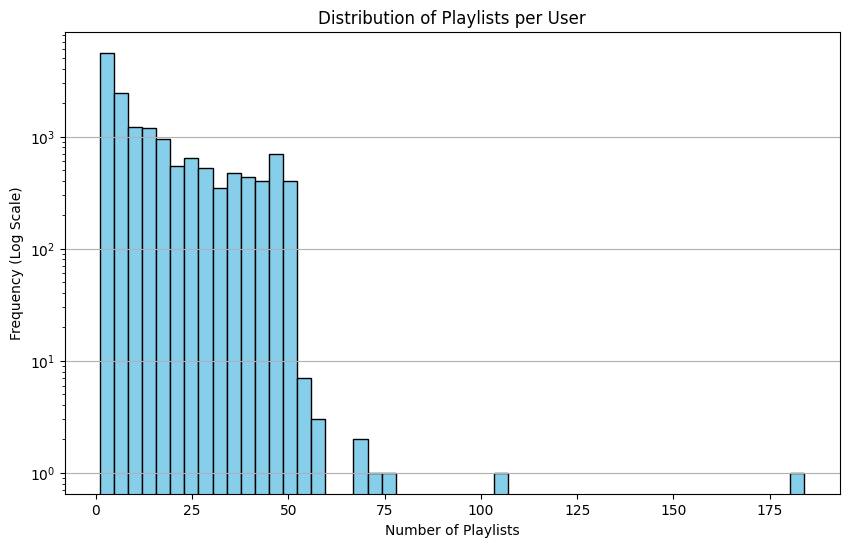

In [ ]:
import matplotlib.pyplot as plt

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(playlists_per_user, bins=50, log=True, color='skyblue', edgecolor='black')
plt.title("Distribution of Playlists per User")
plt.xlabel("Number of Playlists")
plt.ylabel("Frequency (Log Scale)")
plt.grid(axis='y')
plt.show()


### 3. Count Tracks per User

In [ ]:
# Count the number of tracks per user
tracks_per_user = df_final.groupby('user_id')['trackname'].nunique()

# Display summary statistics
print("Tracks per user statistics:")
print(tracks_per_user.describe())

# Top users with the most tracks
print("\nTop 10 users with the most tracks:")
print(tracks_per_user.sort_values(ascending=False).head(10))


Tracks per user statistics:
count     15864.000000
mean        695.698311
std        2058.579181
min           1.000000
25%          88.000000
50%         331.000000
75%         782.000000
max      186096.000000
Name: trackname, dtype: float64

Top 10 users with the most tracks:
user_id
4398de6902abde3351347b048fcdc287    186096
7ee2b92c5bcf6133b8132363e5bda960     78448
fa849dabeb14a2800ad5130907fc5018     47789
ed140fce438f59e6e07e5ee7bd726692     28958
99deafd9b792af8e6a535483088faef2     28853
c410ee930bd5f0e4893632503ec17b05     22942
32b524ed367b1e5a714228fbec80849d     20690
c0efe4e704a37894150489b25eac9042     20184
a9f844ceb4d928d7ff7c189211f301c5     19744
2fa1f93e57cfe2f6c4456e98da54061c     19007
Name: trackname, dtype: int64


### 4. Visualize Tracks per User

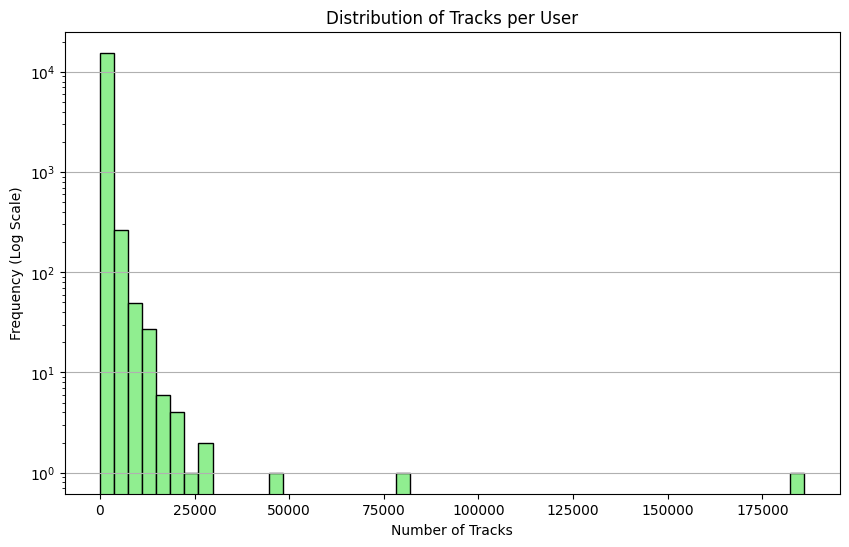

In [ ]:
# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(tracks_per_user, bins=50, log=True, color='lightgreen', edgecolor='black')
plt.title("Distribution of Tracks per User")
plt.xlabel("Number of Tracks")
plt.ylabel("Frequency (Log Scale)")
plt.grid(axis='y')
plt.show()


### 5. Top Users with "Starred" Playlists

In [ ]:
# Filter for "starred" playlists
starred_users = df_final[df_final['playlistname'].str.lower() == 'starred']

# Count the number of "starred" playlists per user
starred_playlists_per_user = starred_users.groupby('user_id')['playlistname'].nunique()

print("Top 10 users with the most 'starred' playlists:")
print(starred_playlists_per_user.sort_values(ascending=False).head(10))


Top 10 users with the most 'starred' playlists:
user_id
000b0f32b5739f052b9d40fcc5c41079    1
ab8516d20963849fc81be7dac21a29ac    1
abfaf1cbf7b20c5e60915bea2c410f24    1
abe6a95b5cc93bbd11ea898963da50a3    1
abc451989719e1f01abd3b3c371c5b77    1
abb68f21d1fd7f0da73f59ac0d6c913e    1
abb4798b059858311c38c1e74a7b1e87    1
abad74dc8dd4e666166fafc5d3277b39    1
ab8d8ef535cd803db4e8fd6a27ab3f0f    1
ab7808569290a47946184b2b3bdb4c7d    1
Name: playlistname, dtype: int64


### 6. Percentage of Users with a Single Playlist

In [ ]:
# Count playlists per user
single_playlist_users = (playlists_per_user == 1).sum()

# Calculate the percentage
percentage_single_playlist = (single_playlist_users / playlists_per_user.shape[0]) * 100

print(f"Number of users with a single playlist: {single_playlist_users}")
print(f"Percentage of users with a single playlist: {percentage_single_playlist:.2f}%")


Number of users with a single playlist: 2202
Percentage of users with a single playlist: 13.88%


### 7. Total unique users in df_final: 15864 & Percentage of users who chose 'starred': 31.64%

In [ ]:
# Total number of unique users
total_unique_users = df_final['user_id'].nunique()

# Filter rows with "starred" playlists and count unique users
starred_users_count = df_final[df_final['playlistname'].str.lower() == 'starred']['user_id'].nunique()

# Calculate percentage of users who chose "starred"
starred_users_percentage = (starred_users_count / total_unique_users) * 100

# Print results
print(f"Total unique users in df_final: {total_unique_users}")
print(f"Number of users who chose 'starred': {starred_users_count}")
print(f"Percentage of users who chose 'starred': {starred_users_percentage:.2f}%")


Total unique users in df_final: 15864
Number of users who chose 'starred': 5019
Percentage of users who chose 'starred': 31.64%


**### Summary about users and playlists in the metadata**

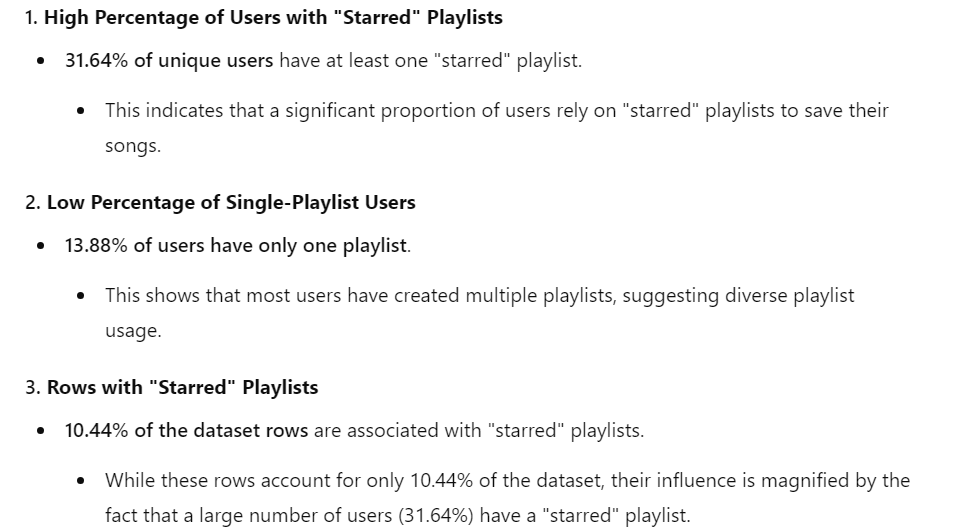

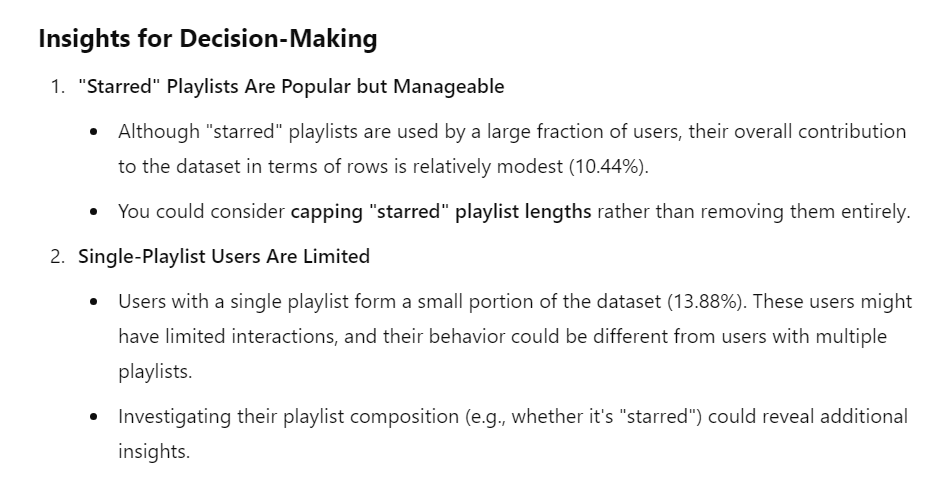

## Step 6: Handle Outliers (Removing 'starred' and checking for outliers in trackname count per user)



As explained before - 'Starred' is not a playlist but rather "liked-songs" by different users and because it is named the same for all users then all their liked songs go to 'starred'.

'Starred' has been found to have non-rare tokens that represent 98% of the data, so there will be a low impact to the token diversity in dataset if we choose to remove this playlist.

'Starred' is an outlier with 1,330,529 tracks.
it is generic and potentially has noisy nature.

'Starred' is the one and only playlist for 587 unique users, so removing means losing information for those users. But the dataset is still very big and has diversity, so again - low impact on the rest of this project.

By removing 'starred' playlist, then dataset size will be reduced without losing much diversity in user interactions.

### Saving the 'starred' playlists to df_starred.csv

In [ ]:
# Extract rows with "starred" playlists
df_starred = df_final[df_final['playlistname'].str.lower() == 'starred']

# Save the "starred" playlists to a CSV file
df_starred.to_csv('df_starred.csv', index=False)

print(f"'Starred' playlists saved as 'df_starred.csv'.")
print(f"Number of rows with 'starred' playlists: {df_starred.shape[0]}")
print(f"Number of unique users with 'starred' playlists: {df_starred['user_id'].nunique()}")


'Starred' playlists saved as 'df_starred.csv'.
Number of rows with 'starred' playlists: 1330529
Number of unique users with 'starred' playlists: 5019


In [ ]:
import gdown
import pandas as pd

# Define the Google Drive file ID
file_id = '1rlK3-msDiu7LJowfbJlFGhkAzREwuEIg'
# Construct the download URL
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output CSV file path
output_csv_path = 'df_starred.csv'

# Download the file using gdown
gdown.download(download_url, output_csv_path, quiet=False)

Downloading...
From: https://drive.google.com/uc?export=download&id=1rlK3-msDiu7LJowfbJlFGhkAzREwuEIg
To: /content/df_starred.csv
100%|██████████| 96.7M/96.7M [00:01<00:00, 52.8MB/s]


'df_starred.csv'

### Removing 'starred' playlist (creating: df_without_starred.csv)


In [ ]:
# Remove rows with "starred" playlists
df_without_starred = df_final[df_final['playlistname'].str.lower() != 'starred']

# Save the cleaned dataset to a CSV file
df_without_starred.to_csv('df_without_starred.csv', index=False)

print(f"Dataset without 'starred' playlists saved as 'df_without_starred.csv'.")
print(f"Number of rows after removing 'starred': {df_without_starred.shape[0]}")
print(f"Number of unique users after removing 'starred': {df_without_starred['user_id'].nunique()}")


Dataset without 'starred' playlists saved as 'df_without_starred.csv'.
Number of rows after removing 'starred': 11412701
Number of unique users after removing 'starred': 15277


In [ ]:
# Display the shape of the DataFrame
print("Shape of the DataFrame:", df_without_starred.shape)

# Display the basic information about the DataFrame
print("\nBasic Info:")
print(df_without_starred.info())

# Display the first few rows for a quick check
print("\nFirst 5 rows:")
print(df_without_starred.head())

Shape of the DataFrame: (11412701, 4)

Basic Info:
<class 'pandas.core.frame.DataFrame'>
Index: 11412701 entries, 0 to 12743251
Data columns (total 4 columns):
 #   Column        Dtype 
---  ------        ----- 
 0   user_id       object
 1   artistname    object
 2   trackname     object
 3   playlistname  object
dtypes: object(4)
memory usage: 435.4+ MB
None

First 5 rows:
                            user_id                       artistname  \
0  9cc0cfd4d7d7885102480dd99e7a90d6                   elvis costello   
1  9cc0cfd4d7d7885102480dd99e7a90d6  elvis costello  the attractions   
2  9cc0cfd4d7d7885102480dd99e7a90d6                     tiffany page   
3  9cc0cfd4d7d7885102480dd99e7a90d6  elvis costello  the attractions   
4  9cc0cfd4d7d7885102480dd99e7a90d6                   elvis costello   

                                          trackname    playlistname  
0                the angels wanna wear my red shoes  hard rock 2010  
1  whats so funny bout peace love and understandi

### Summary Statistics for Tracks per User:

In [ ]:
# Count the number of tracks per user_id
tracks_per_user = df_without_starred.groupby('user_id')['trackname'].count()

# Display the result
print(tracks_per_user)

# Save the counts to a CSV file for further review
tracks_per_user.to_csv('tracks_per_user.csv', header=['track_count'])
print("Track counts per user saved to 'tracks_per_user.csv'")


user_id
00055176fea33f6e027cd3302289378b      120
0007f3dd09c91198371454c608d47f22       97
000b0f32b5739f052b9d40fcc5c41079       75
000c11a16c89aa4b14b328080f5954ee      716
00123e0f544dee3ab006aa7f1e5725a7    18395
                                    ...  
ffe32d5412269f3041c58cbf0dde3306       58
ffec270eae226caa14ddaef291d73fff       32
fff60baf392613ed33f745b89a9b38f7      552
fff616055993498d6127f3f467cf9f2b     3087
fff77dadf8528083c920b9c018847e8b      295
Name: trackname, Length: 15277, dtype: int64
Track counts per user saved to 'tracks_per_user.csv'


In [ ]:
import pandas as pd

# Count the number of tracks per user_id
tracks_per_user = df_without_starred.groupby('user_id')['trackname'].count()

# Generate a summary of statistics
summary = tracks_per_user.describe()

# Display the summary statistics
print("Summary Statistics for Tracks per User:")
print(summary)

# Generate a frequency table
frequency_table = tracks_per_user.value_counts().sort_index()

# Display the frequency table
print("\nFrequency Table (Tracks per User):")
print(frequency_table)

# Save the results to CSV files for further analysis
summary.to_csv('tracks_per_user_summary.csv', header=['Value'])
frequency_table.to_csv('tracks_per_user_frequency.csv', header=['Frequency'])
print("\nSummary and frequency saved to CSV files.")


Summary Statistics for Tracks per User:
count     15277.000000
mean        747.051188
std        2646.441266
min           1.000000
25%          87.000000
50%         329.000000
75%         814.000000
max      247557.000000
Name: trackname, dtype: float64

Frequency Table (Tracks per User):
trackname
1         232
2         124
3          81
4          68
5          62
         ... 
38844       1
59462       1
65802       1
90042       1
247557      1
Name: count, Length: 2709, dtype: int64

Summary and frequency saved to CSV files.


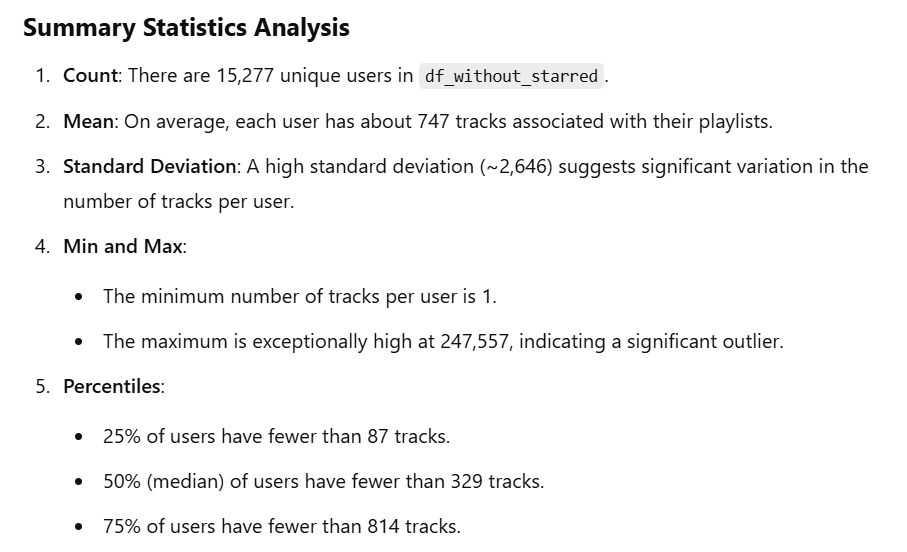

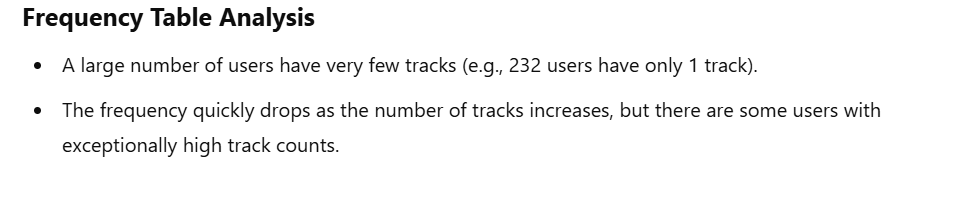

### Investigating the outliers in count of trackname per unique user_id. To get a better feel of the imbalance and how to deal with it.

In [ ]:
# Count the number of tracks per user
tracks_per_user = df_without_starred.groupby('user_id')['trackname'].count()

# Filter users with more than 500 tracks
users_with_more_than_500_tracks = tracks_per_user[tracks_per_user > 500]

# Count the number of such users
num_users_more_than_500 = users_with_more_than_500_tracks.count()

print(f"Number of users with more than 500 tracknames: {num_users_more_than_500}")


Number of users with more than 500 tracknames: 6121


In [ ]:
ranges = [0, 100, 500, 1000, 5000, 10000, tracks_per_user.max()]
range_labels = ['0-100', '101-500', '501-1000', '1001-5000', '5001-10000', '>10000']
user_ranges = pd.cut(tracks_per_user, bins=ranges, labels=range_labels)

# Count users in each range
user_range_counts = user_ranges.value_counts().sort_index()

print("Users by Track Count Ranges:")
print(user_range_counts)

# Save to a file
user_range_counts.to_csv('user_track_count_ranges.csv', header=['User Count'])


Users by Track Count Ranges:
trackname
0-100         4148
101-500       5008
501-1000      3150
1001-5000     2725
5001-10000     180
>10000          66
Name: count, dtype: int64


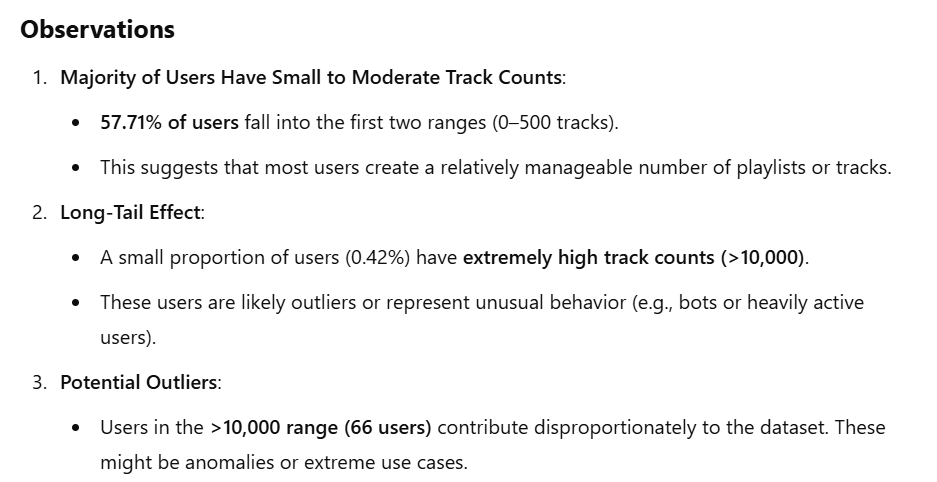

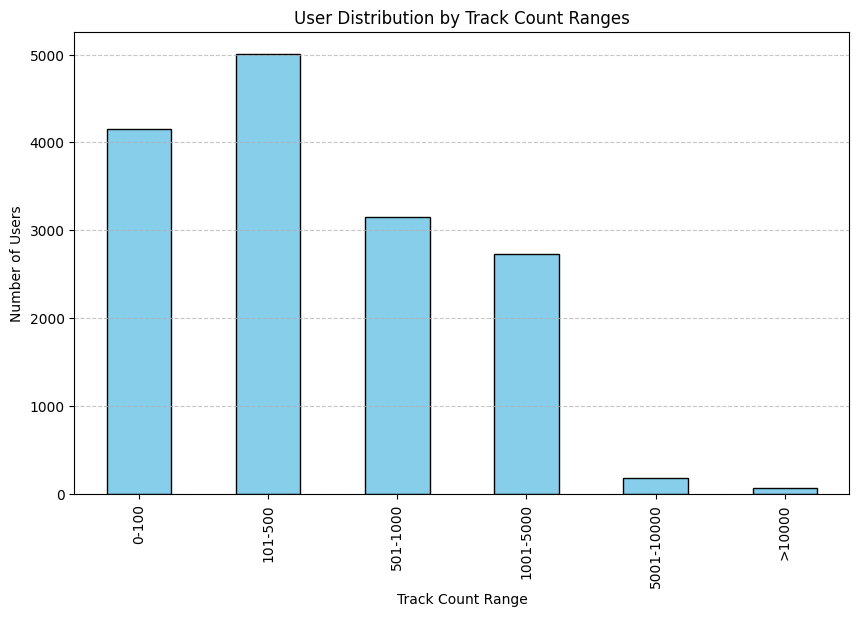

In [ ]:
user_range_counts.plot(kind='bar', color='skyblue', edgecolor='black', figsize=(10, 6))
plt.title("User Distribution by Track Count Ranges")
plt.xlabel("Track Count Range")
plt.ylabel("Number of Users")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


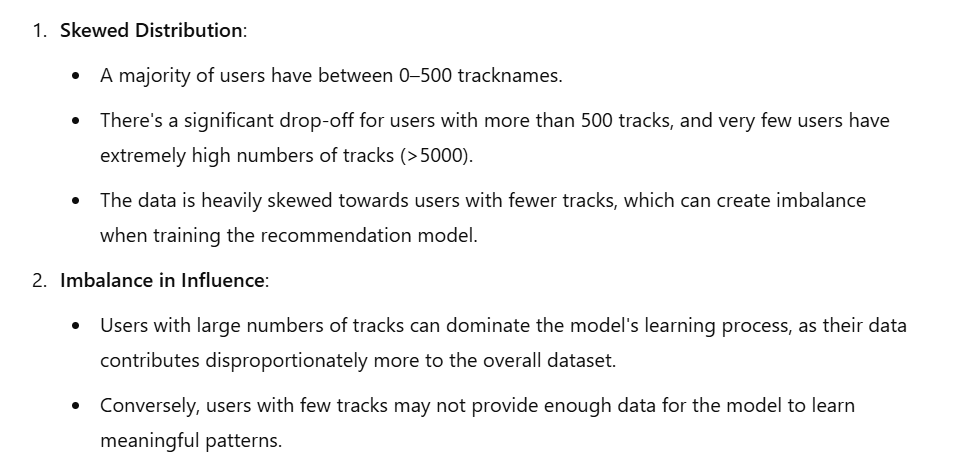

In [ ]:
# Count the number of tracknames per user_id
tracks_per_user = df_without_starred.groupby('user_id')['trackname'].count()

# Filter users with fewer than 2 tracknames
users_with_less_than_2_tracks = tracks_per_user[tracks_per_user < 2]

# Count and display the results
num_users_with_less_than_2_tracks = users_with_less_than_2_tracks.shape[0]
print(f"Number of users with less than 2 tracknames: {num_users_with_less_than_2_tracks}")


Number of users with less than 2 tracknames: 232


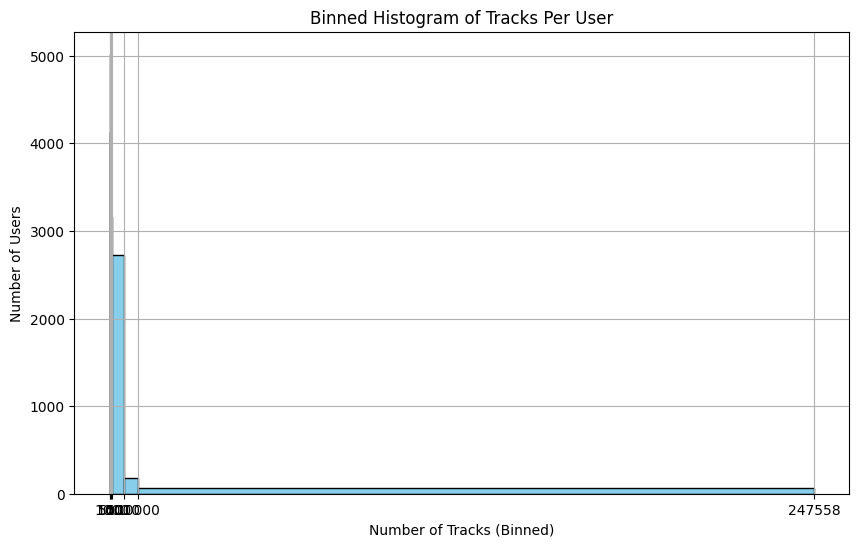

Total Users: 15277
Users with Tracks Between 1-1000: 12306
Percentage of Users in Range: 80.55%


In [ ]:
# Importing necessary libraries
import matplotlib.pyplot as plt

# Calculate the count of tracknames per user
tracks_per_user = df_without_starred.groupby('user_id')['trackname'].count()

# Define bins for the histogram
bins = [1, 100, 500, 1000, 5000, 10000, max(tracks_per_user) + 1]

# Create a histogram
plt.figure(figsize=(10, 6))
tracks_per_user.hist(bins=bins, edgecolor='black', color='skyblue')
plt.title("Binned Histogram of Tracks Per User")
plt.xlabel("Number of Tracks (Binned)")
plt.ylabel("Number of Users")
plt.xticks(bins)
plt.show()

# Calculate a summary for the specified range (1-1000)
users_in_range = tracks_per_user[(tracks_per_user >= 1) & (tracks_per_user <= 1000)].count()
total_users = len(tracks_per_user)
percentage_in_range = (users_in_range / total_users) * 100

# Display the summary
print(f"Total Users: {total_users}")
print(f"Users with Tracks Between 1-1000: {users_in_range}")
print(f"Percentage of Users in Range: {percentage_in_range:.2f}%")


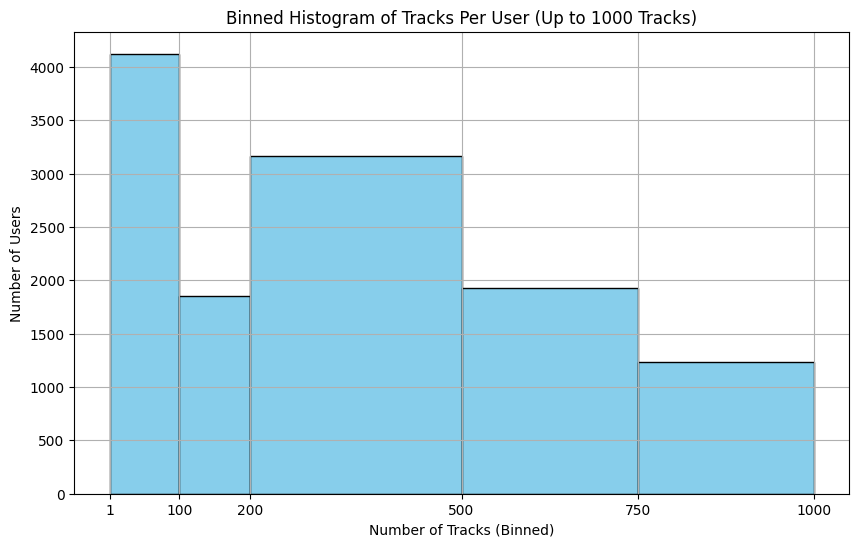

Total Users: 15277
Users with Tracks Between 1-1000: 12306
Percentage of Users in Range: 80.55%


In [ ]:
# Define new bins for the histogram, limiting to 1-1000 tracks
bins = [1, 100, 200, 500, 750, 1000]

# Create a histogram for users with up to 1000 tracks
plt.figure(figsize=(10, 6))
tracks_per_user[tracks_per_user <= 1000].hist(bins=bins, edgecolor='black', color='skyblue')
plt.title("Binned Histogram of Tracks Per User (Up to 1000 Tracks)")
plt.xlabel("Number of Tracks (Binned)")
plt.ylabel("Number of Users")
plt.xticks(bins)
plt.show()

# Calculate a summary for users with up to 1000 tracks
users_in_range = tracks_per_user[(tracks_per_user >= 1) & (tracks_per_user <= 1000)].count()
total_users = len(tracks_per_user)
percentage_in_range = (users_in_range / total_users) * 100

# Display the corrected summary
print(f"Total Users: {total_users}")
print(f"Users with Tracks Between 1-1000: {users_in_range}")
print(f"Percentage of Users in Range: {percentage_in_range:.2f}%")


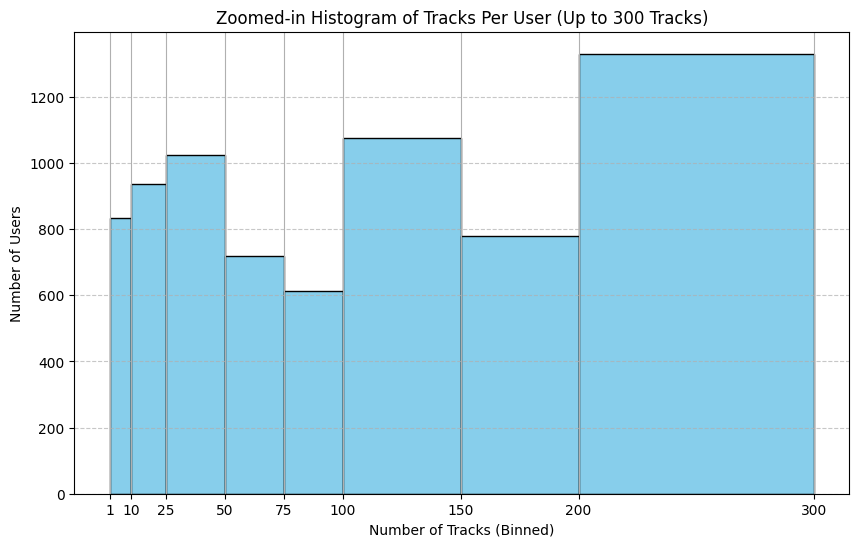

Total Users: 15277
Users with Tracks Between 1-300: 7308
Percentage of Users in Range: 47.84%


In [ ]:
# Define bins for a zoomed-in histogram (e.g., focusing on users with fewer than 300 tracks)
bins = [1, 10, 25, 50, 75, 100, 150, 200, 300]

# Create a zoomed-in histogram
plt.figure(figsize=(10, 6))
tracks_per_user[tracks_per_user <= 300].hist(bins=bins, edgecolor='black', color='skyblue')
plt.title("Zoomed-in Histogram of Tracks Per User (Up to 300 Tracks)")
plt.xlabel("Number of Tracks (Binned)")
plt.ylabel("Number of Users")
plt.xticks(bins)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# Calculate statistics for users with fewer than 300 tracks
users_in_zoom_range = tracks_per_user[tracks_per_user <= 300].count()
percentage_in_zoom_range = (users_in_zoom_range / total_users) * 100

# Display the summary
print(f"Total Users: {total_users}")
print(f"Users with Tracks Between 1-300: {users_in_zoom_range}")
print(f"Percentage of Users in Range: {percentage_in_zoom_range:.2f}%")


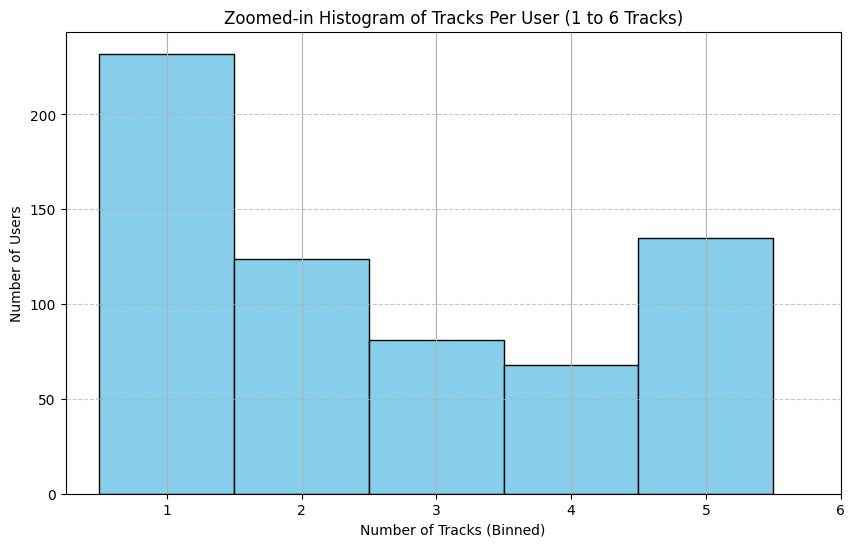

Total Users: 15277
Users with Tracks Between 1-6: 640
Percentage of Users in Range: 4.19%


In [ ]:
# Define bins for a zoomed-in histogram (e.g., focusing on users with 1-6 tracks)
bins = [1, 2, 3, 4, 5, 6]

# Create a zoomed-in histogram
plt.figure(figsize=(10, 6))
tracks_per_user[tracks_per_user <= 6].hist(bins=bins, edgecolor='black', color='skyblue', align='left')
plt.title("Zoomed-in Histogram of Tracks Per User (1 to 6 Tracks)")
plt.xlabel("Number of Tracks (Binned)")
plt.ylabel("Number of Users")
plt.xticks(bins)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# Calculate statistics for users with 1-6 tracks
users_in_zoom_range = tracks_per_user[(tracks_per_user >= 1) & (tracks_per_user <= 6)].count()
percentage_in_zoom_range = (users_in_zoom_range / total_users) * 100

# Display the summary
print(f"Total Users: {total_users}")
print(f"Users with Tracks Between 1-6: {users_in_zoom_range}")
print(f"Percentage of Users in Range: {percentage_in_zoom_range:.2f}%")


# Data Preparation (using df_without_starred)

## Direct link to open df_without_starred.csv file

In [ ]:
import gdown
import pandas as pd

# Define the Google Drive file ID
file_id = '1KmuvtQGND2kGil4WYacwzdbOSJ8wFzTp'
# Construct the download URL
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output CSV file path
output_csv_path = 'df_without_starred.csv'

# Download the file using gdown
gdown.download(download_url, output_csv_path, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?export=download&id=1KmuvtQGND2kGil4WYacwzdbOSJ8wFzTp
From (redirected): https://drive.google.com/uc?export=download&id=1KmuvtQGND2kGil4WYacwzdbOSJ8wFzTp&confirm=t&uuid=fdd64386-b27e-43e8-bc11-34093568f80d
To: /content/df_without_starred.csv
100%|██████████| 947M/947M [00:14<00:00, 67.1MB/s]


'df_without_starred.csv'

In [ ]:
# Load the final saved file
df_without_starred = pd.read_csv('df_without_starred.csv')

df_without_starred.shape

(11412701, 4)

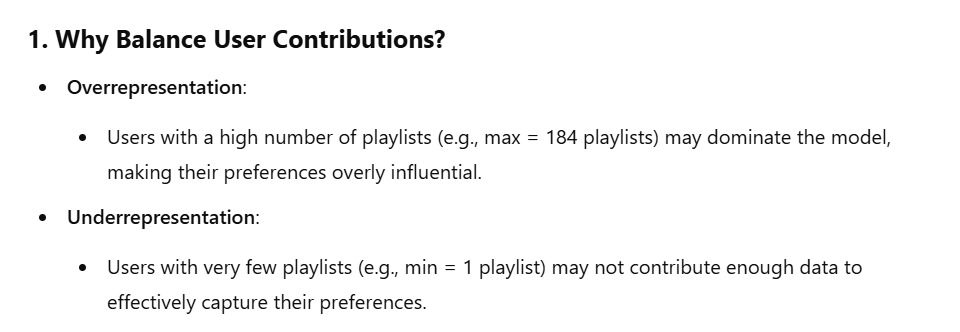

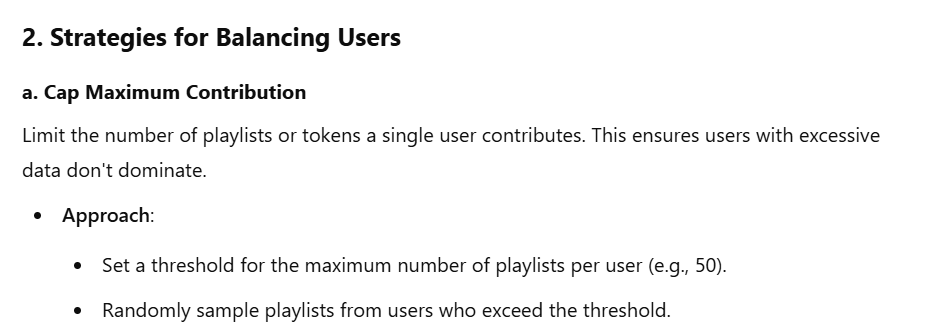

## **The chosen method for balancing data from different users:**

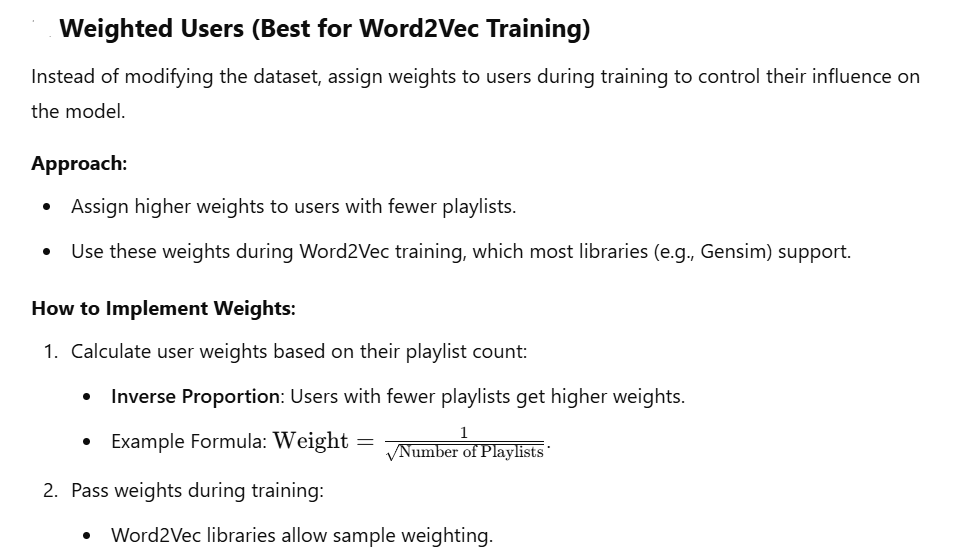

In [ ]:
import numpy as np

# Load the final saved file
df_without_starred = pd.read_csv('df_without_starred.csv')

# Calculate weights for each user
user_playlist_counts = df_without_starred.groupby('user_id')['playlistname'].nunique()
user_weights = (1 / np.sqrt(user_playlist_counts)).to_dict()

# Add weights to the dataframe
df_without_starred['user_weight'] = df_without_starred['user_id'].map(user_weights)

print("User weights calculated.")


User weights calculated.


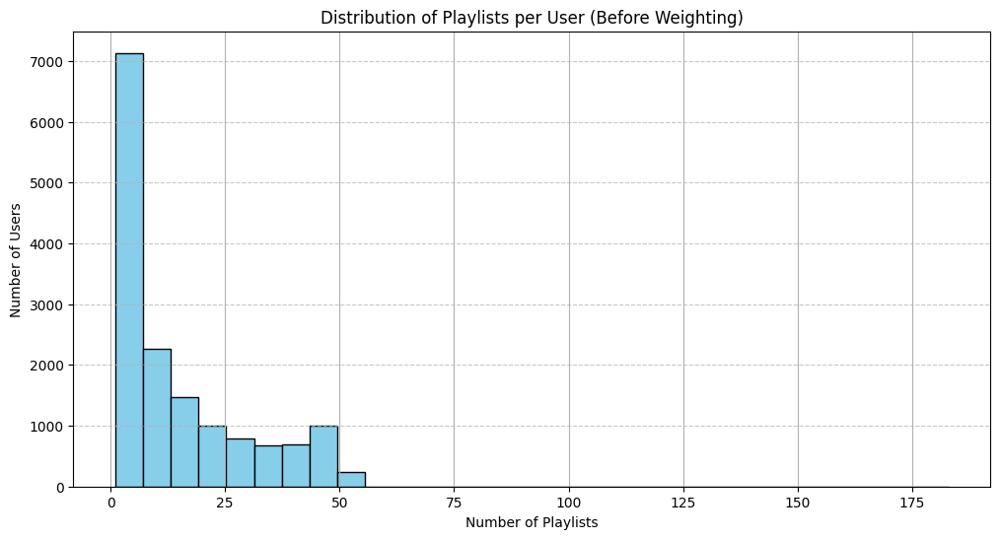

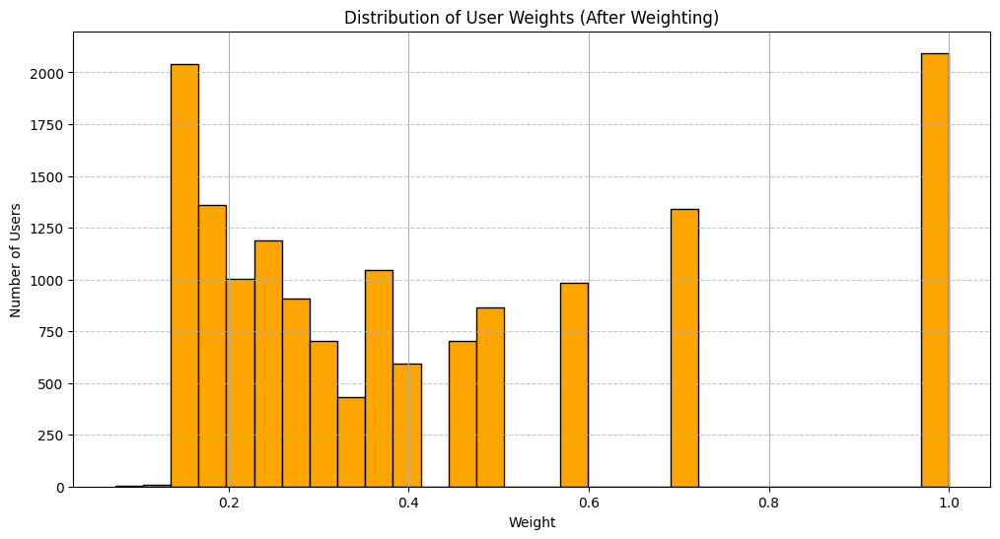

Visualizations completed: Before and after weighting.


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Calculate playlists per user (before weighting)
user_playlist_counts = df_without_starred.groupby('user_id')['playlistname'].nunique()

# Step 2: Calculate weights for each user
# Weight formula: Inverse square root of playlist count
user_weights = (1 / np.sqrt(user_playlist_counts)).to_dict()

# Step 3: Visualize Before Weighting
plt.figure(figsize=(12, 6))
user_playlist_counts.hist(bins=30, edgecolor='black', color='skyblue')
plt.title("Distribution of Playlists per User (Before Weighting)")
plt.xlabel("Number of Playlists")
plt.ylabel("Number of Users")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# Step 4: Visualize After Weighting
# Extract weights into a Series for plotting
user_weights_series = pd.Series(user_weights)

plt.figure(figsize=(12, 6))
user_weights_series.hist(bins=30, edgecolor='black', color='orange')
plt.title("Distribution of User Weights (After Weighting)")
plt.xlabel("Weight")
plt.ylabel("Number of Users")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

print("Visualizations completed: Before and after weighting.")


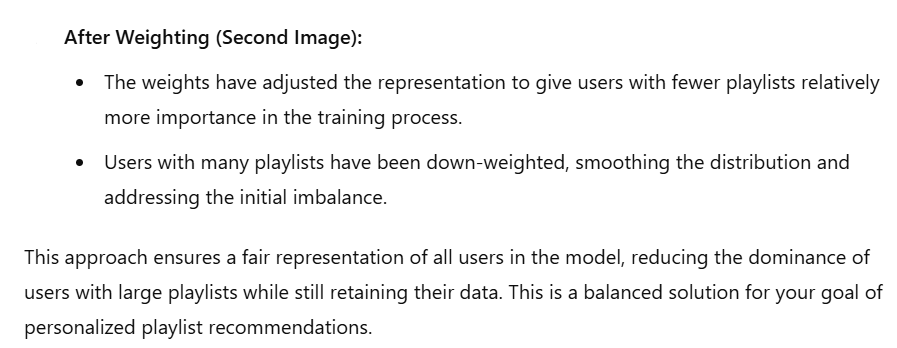

### Balancing users - Saved file 'df_without_starred_user_weighted.csv'

In [ ]:
# Save the weighted df_without_starred to a new CSV file
df_without_starred.to_csv('df_without_starred_user_weighted.csv', index=False)
print("Weighted df_without_starred saved: df_without_starred_user_weighted.csv")


Weighted df_without_starred saved: df_without_starred_user_weighted.csv


In [ ]:
df_without_starred.shape

(11412701, 5)

## **Balancing the count of trackname in the playlists - Retention of Larger Playlists:**

The remaining dataset will primarily consist of users with enough tracknames to provide a strong signal for personalized playlist recommendations.

### Direct link to 'df_without_starred_user_weighted.csv'

In [ ]:
import gdown
import pandas as pd

# Define the Google Drive file ID
file_id = '1X6-i9DKTieulWkBVjFBgmCnkOh6rdALT'
# Construct the download URL
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output CSV file path
output_csv_path = 'df_without_starred_user_weighted.csv'

# Download the file using gdown
gdown.download(download_url, output_csv_path, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?export=download&id=1X6-i9DKTieulWkBVjFBgmCnkOh6rdALT
From (redirected): https://drive.google.com/uc?export=download&id=1X6-i9DKTieulWkBVjFBgmCnkOh6rdALT&confirm=t&uuid=77ca69d6-6e26-4ac3-8a03-2fa3fc8085cf
To: /content/df_without_starred_user_weighted.csv
100%|██████████| 1.16G/1.16G [00:18<00:00, 61.5MB/s]


'df_without_starred_user_weighted.csv'

In [ ]:
# Load the final saved file
df_without_starred_user_weighted = pd.read_csv('df_without_starred_user_weighted.csv')

In [ ]:
import pandas as pd

# Calculate the number of tracknames per user
tracknames_per_user = df_without_starred_user_weighted.groupby('user_id')['trackname'].count()

# Identify users with 6 or fewer tracknames
users_to_remove = tracknames_per_user[tracknames_per_user <= 6].index

# Filter the dataframe to retain only users with more than 6 tracknames
df_retained = df_without_starred_user_weighted[~df_without_starred['user_id'].isin(users_to_remove)]

# Save the filtered dataframe to a new CSV
df_retained.to_csv('df_without_starred_retained_large_playlists.csv', index=False)
print("Filtered dataframe saved: df_without_starred_retained_large_playlists.csv")

# Summary of the filtering
print(f"Total users removed: {len(users_to_remove)}")
print(f"Remaining rows in the dataframe: {df_retained.shape[0]}")


Filtered dataframe saved: df_without_starred_retained_large_playlists.csv
Total users removed: 640
Remaining rows in the dataframe: 11410958


In [ ]:
# Load the retained dataframe
df_retained = pd.read_csv('df_without_starred_retained_large_playlists.csv')

# Check the basic info of the dataframe
print("DataFrame Info:")
print(df_retained.info())

# Count unique user IDs
unique_users = df_retained['user_id'].nunique()
print(f"\nNumber of unique user IDs in df_retained: {unique_users}")


DataFrame Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11410958 entries, 0 to 11410957
Data columns (total 5 columns):
 #   Column        Dtype  
---  ------        -----  
 0   user_id       object 
 1   artistname    object 
 2   trackname     object 
 3   playlistname  object 
 4   user_weight   float64
dtypes: float64(1), object(4)
memory usage: 435.3+ MB
None

Number of unique user IDs in df_retained: 14637


### Excluding edge-cases for 66 unique users who have very long (above 10,000 tracknames) playlist/s and are either bots or heavily users who represent annomality behaviour to check later on, but now we exclude to better balance the playlists (meaning trackname count balancing) - creating 'df_retained_filtered.csv' and 'extreme_users.csv'

In [ ]:
# Step 1: Identify users with more than 10,000 tracks
user_track_counts = df_retained.groupby('user_id')['trackname'].count()
extreme_users = user_track_counts[user_track_counts > 10000].index

print(f"Number of users with more than 10,000 tracks: {len(extreme_users)}")

# Step 2: Separate these users into a different dataframe
extreme_users_df = df_retained[df_retained['user_id'].isin(extreme_users)]

# Step 3: Exclude these users from the main dataframe
df_retained_filtered = df_retained[~df_retained['user_id'].isin(extreme_users)]

# Step 4: Save both dataframes to separate CSV files
extreme_users_df.to_csv('extreme_users.csv', index=False)
print("Extreme users dataset saved: extreme_users.csv")

df_retained_filtered.to_csv('df_retained_filtered.csv', index=False)
print("Filtered dataset saved: df_retained_filtered.csv")

# Step 5: Verify the new shapes of the dataframes
print(f"Original df_retained shape: {df_retained.shape}")
print(f"Filtered df_retained shape: {df_retained_filtered.shape}")
print(f"Extreme users dataframe shape: {extreme_users_df.shape}")


Number of users with more than 10,000 tracks: 66
Extreme users dataset saved: extreme_users.csv
Filtered dataset saved: df_retained_filtered.csv
Original df_retained shape: (11401770, 5)
Filtered df_retained shape: (10008812, 5)
Extreme users dataframe shape: (1392958, 5)


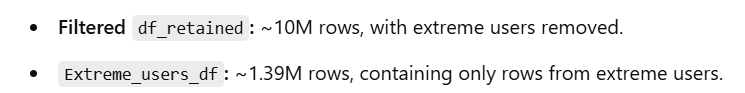

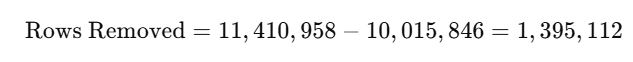

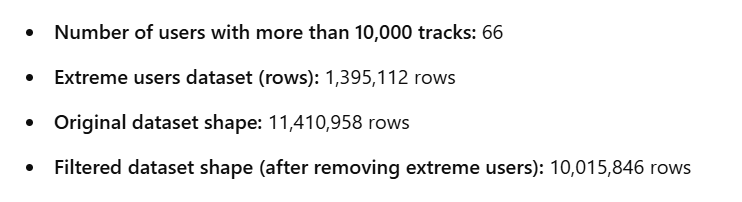

In [ ]:
print(df_retained.columns)
print(extreme_users_df.columns)


Index(['user_id', 'artistname', 'trackname', 'playlistname', 'user_weight'], dtype='object')
Index(['user_id', 'artistname', 'trackname', 'playlistname', 'user_weight'], dtype='object')


In [ ]:
extreme_user_ids = user_track_counts[user_track_counts > 10000].index
print(f"Extreme User IDs: {extreme_user_ids}")
print(extreme_users_df['user_id'].nunique())  # Check if it matches 66


Extreme User IDs: Index(['00123e0f544dee3ab006aa7f1e5725a7', '05422749e89268463444e00ddea1faf1',
       '0d2ab594e618cd02b12cea190bd19bdc', '0e8a2028b0ca919a288924dea8719973',
       '1039e5bfd726bb324ce7f5ea2d0d6fc4', '11da254d9d1948488318e3ea286bf484',
       '139c408e52a497aac29753125d65b0ae', '1c923257b8b90ff1760cb92fb28aaa32',
       '1e83ee751379a76633915ffce34e9647', '22cd1234e26a76c179ad62f6d08f7294',
       '280b75289c00a3b31c9a392ea96e79f8', '2e7291dab286ee7a5135a89e69c5cd8d',
       '2fa1f93e57cfe2f6c4456e98da54061c', '3196442b472af9bbb51e1628ca3c188a',
       '32b524ed367b1e5a714228fbec80849d', '3f30047abd0b82240c0861a63e07255a',
       '4398de6902abde3351347b048fcdc287', '479b70f0fa04f20af57002cc34b025f0',
       '48da4a7b1a0ff8f0d605b6565971816b', '4d98b75af2c5f1d41d75afeee395374e',
       '5968fe6ff4531c2efd244584f35ea94a', '61baddf7207fea410abdc56e680fa869',
       '63a104c619db7621d3258678842d37c0', '6752faf971cd451d87b270621979e2d5',
       '6b85a8076b4f3b1036ef15f09e

In [ ]:
user_track_counts = df_retained.groupby('user_id')['trackname'].count()
extreme_user_ids = user_track_counts[user_track_counts > 10000].index

# Filter the extreme users
extreme_users_df = df_retained[df_retained['user_id'].isin(extreme_user_ids)]
print(extreme_users_df['user_id'].nunique())  # Should match 66


66


In [ ]:
# Calculate the trackname count per user in the filtered dataframe
user_track_counts_filtered = df_retained_filtered.groupby('user_id')['trackname'].count()

# Find the maximum trackname count
max_trackname_count = user_track_counts_filtered.max()

print(f"Maximum trackname count per user after filtering extreme users: {max_trackname_count}")


Maximum trackname count per user after filtering extreme users: 9900


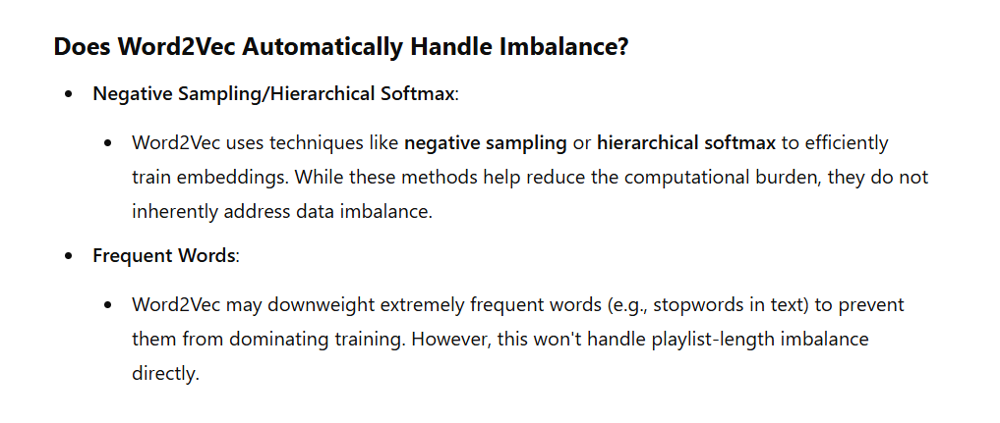

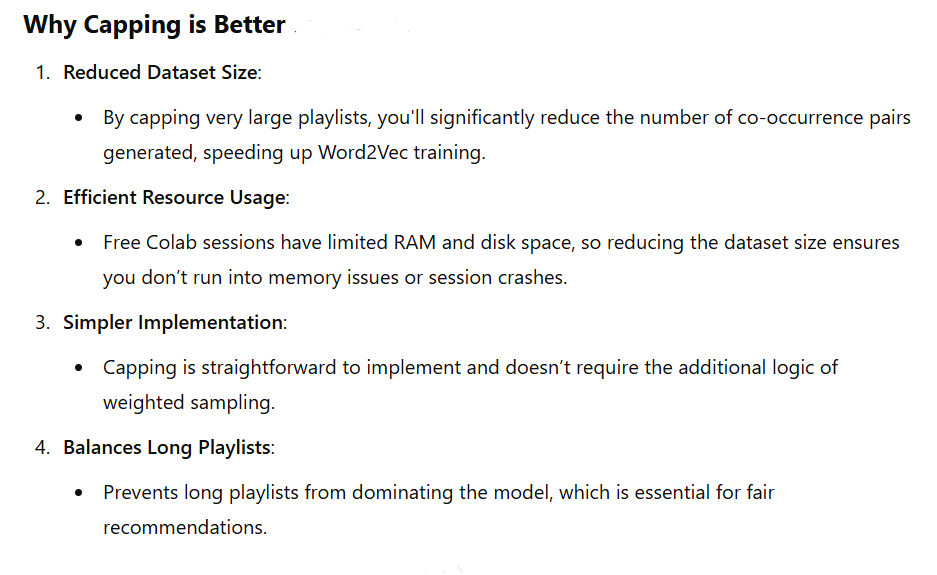

**We need to use capping (instead of weighting) and risk of losing some data, because of low computational resources (running on free version of Google Colab doesn't give much GPU)**

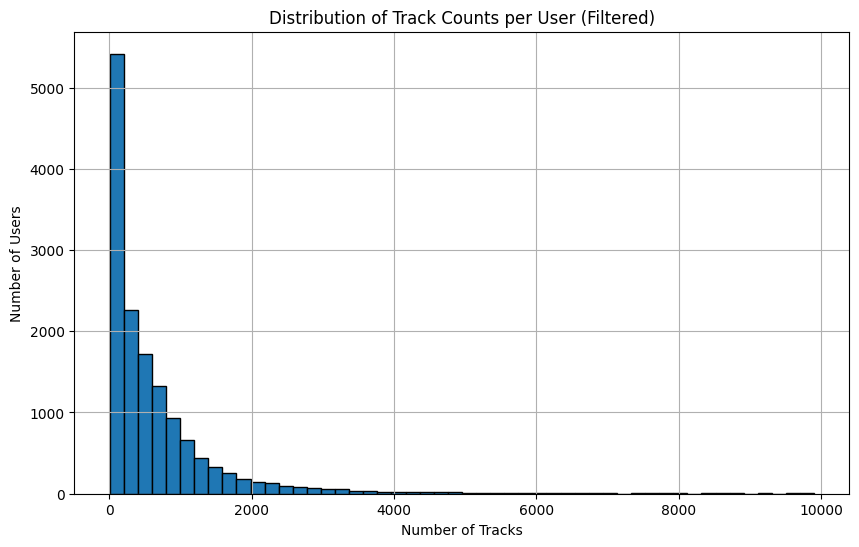

In [ ]:
user_track_counts_filtered.hist(bins=50, edgecolor='black', figsize=(10, 6))
plt.title('Distribution of Track Counts per User (Filtered)')
plt.xlabel('Number of Tracks')
plt.ylabel('Number of Users')
plt.show()


### **Removed data so far during cleanup +preprocess+ preparation:**

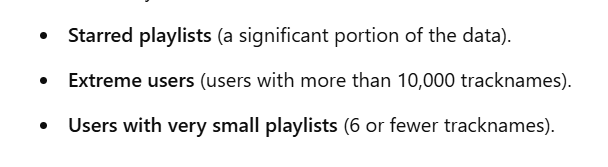

### In the current situation where there is still imbalance in trackname data there are 2 options :

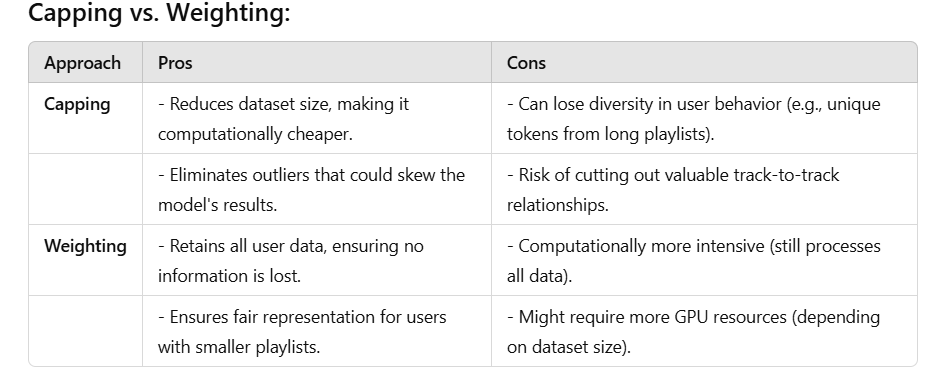

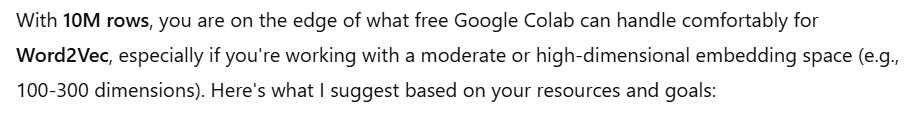

### Recalculate user weights by combining playlists and track counts

recalculating weights by combining playlists and track counts can give a more holistic balance. This approach ensures that both aspects (the number of playlists a user creates and the number of tracks they add) are taken into account, making the dataset fairer for training the Word2Vec model.



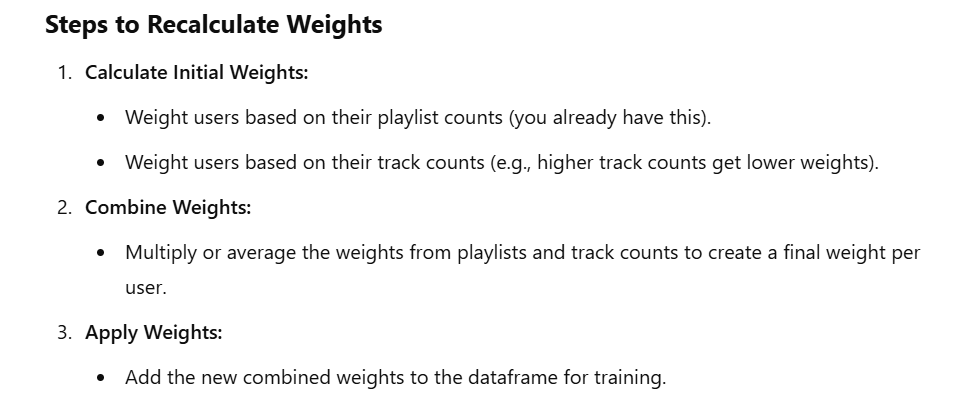

In [ ]:
import numpy as np

# Step 1: Load the dataset
df_retained_filtered = pd.read_csv('df_retained_filtered.csv')

# Step 2: Calculate playlist-based weights (already done earlier, but repeating for clarity)
user_playlist_counts = df_retained_filtered.groupby('user_id')['playlistname'].nunique()
playlist_weights = (1 / np.sqrt(user_playlist_counts)).to_dict()

# Step 3: Calculate track-based weights
user_track_counts = df_retained_filtered.groupby('user_id')['trackname'].count()
track_weights = (1 / np.sqrt(user_track_counts)).to_dict()

# Step 4: Combine weights (average of both weights)
combined_weights = {user_id: (playlist_weights.get(user_id, 0) + track_weights.get(user_id, 0)) / 2
                    for user_id in set(playlist_weights) | set(track_weights)}

# Step 5: Add weights to the dataframe
df_retained_filtered['combined_weight'] = df_retained_filtered['user_id'].map(combined_weights)

# Step 6: Save the weighted dataset
df_retained_filtered.to_csv('df_retained_filtered_with_weights.csv', index=False)
print("Weighted dataset saved: df_retained_filtered_with_weights.csv")


Weighted dataset saved: df_retained_filtered_with_weights.csv


# Direct link to 'df_retained_filtered_with_weights.csv'    final before tokenizing + Analyzing

In [ ]:
import gdown
import pandas as pd

# Define the Google Drive file ID
file_id = '1UkWF9iJcjo5l3EQs7e6hkrg3c2Khkf-D'
# Construct the download URL
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output CSV file path
output_csv_path = 'df_retained_filtered_with_weights.csv'

# Download the file using gdown
gdown.download(download_url, output_csv_path, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?export=download&id=1UkWF9iJcjo5l3EQs7e6hkrg3c2Khkf-D
From (redirected): https://drive.google.com/uc?export=download&id=1UkWF9iJcjo5l3EQs7e6hkrg3c2Khkf-D&confirm=t&uuid=a8307019-ac39-4269-85b9-e78a7c5d8fec
To: /content/df_retained_filtered_with_weights.csv
100%|██████████| 1.20G/1.20G [00:17<00:00, 69.1MB/s]


'df_retained_filtered_with_weights.csv'

In [ ]:
import numpy as np

# Step 1: Load the dataset
df_retained_filtered_with_weights = pd.read_csv('df_retained_filtered_with_weights.csv')

In [ ]:
# Load the weighted dataset
df_retained_filtered_with_weights = pd.read_csv('df_retained_filtered_with_weights.csv')

# Display the shape of the dataset
print("Shape of the dataset:", df_retained_filtered_with_weights.shape)

# Display the info of the dataset
print("\nDataset Info:")
print(df_retained_filtered_with_weights.info())

# Display the first few rows of the dataset
print("\nFirst 5 Rows:")
print(df_retained_filtered_with_weights.head())


Shape of the dataset: (10008812, 6)

Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10008812 entries, 0 to 10008811
Data columns (total 6 columns):
 #   Column           Dtype  
---  ------           -----  
 0   user_id          object 
 1   artistname       object 
 2   trackname        object 
 3   playlistname     object 
 4   user_weight      float64
 5   combined_weight  float64
dtypes: float64(2), object(4)
memory usage: 458.2+ MB
None

First 5 Rows:
                            user_id                       artistname  \
0  9cc0cfd4d7d7885102480dd99e7a90d6                   elvis costello   
1  9cc0cfd4d7d7885102480dd99e7a90d6  elvis costello  the attractions   
2  9cc0cfd4d7d7885102480dd99e7a90d6                     tiffany page   
3  9cc0cfd4d7d7885102480dd99e7a90d6  elvis costello  the attractions   
4  9cc0cfd4d7d7885102480dd99e7a90d6                   elvis costello   

                                          trackname    playlistname  \
0                

In [ ]:
# Display column names
print(df_retained_filtered_with_weights.columns)


Index(['user_id', 'artistname', 'trackname', 'playlistname', 'user_weight',
       'combined_weight'],
      dtype='object')


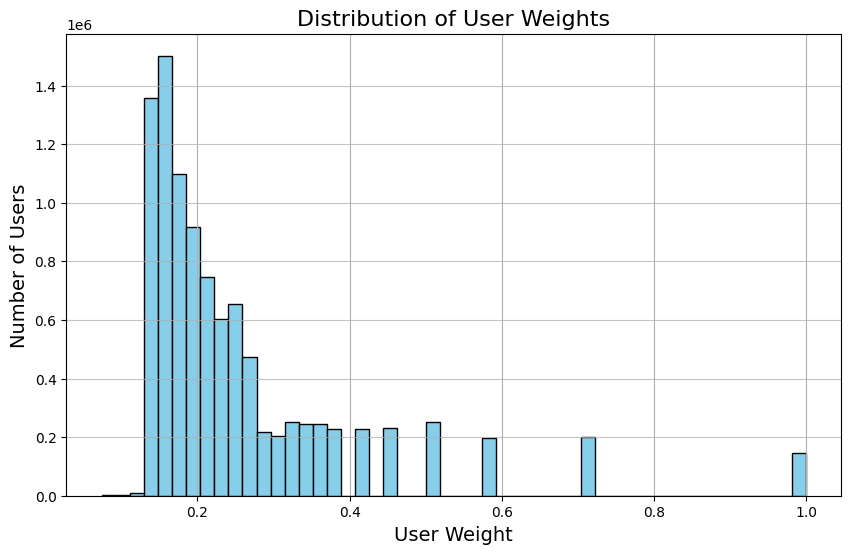

In [ ]:
import matplotlib.pyplot as plt

# Plot the distribution of weights
plt.figure(figsize=(10, 6))
df_retained_filtered_with_weights['user_weight'].hist(bins=50, color='skyblue', edgecolor='black')
plt.title("Distribution of User Weights", fontsize=16)
plt.xlabel("User Weight", fontsize=14)
plt.ylabel("Number of Users", fontsize=14)
plt.grid(axis='y', alpha=0.75)
plt.show()


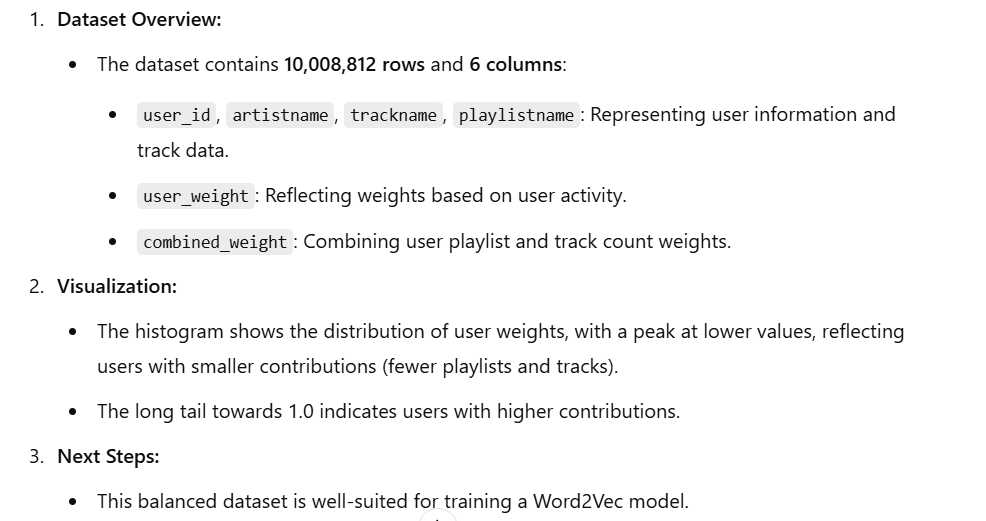

# Removing blank track names such as " "

In [ ]:
# Check for missing or empty tracknames
empty_tracknames = df_retained_filtered_with_weights['trackname'].isnull().sum()
blank_tracknames = (df_retained_filtered_with_weights['trackname'].str.strip() == '').sum()

print(f"Number of missing tracknames: {empty_tracknames}")
print(f"Number of blank (empty string) tracknames: {blank_tracknames}")

# Display rows with empty or blank tracknames
if empty_tracknames > 0 or blank_tracknames > 0:
    print("\nRows with missing or blank tracknames:")
    print(df_retained_filtered_with_weights[df_retained_filtered_with_weights['trackname'].isnull() | (df_retained_filtered_with_weights['trackname'].str.strip() == '')])
else:
    print("No missing or blank tracknames found.")


Number of missing tracknames: 0
Number of blank (empty string) tracknames: 186

Rows with missing or blank tracknames:
                                  user_id                       artistname  \
6634     50346e4190d1707ebc6b39a95f86927a                    nobuo uematsu   
98262    c4397b41b68a636a810517e59f6a476b                   hundred waters   
110314   250b36ff8b1502104ea0615f9023f5be                  verka serduchka   
233789   cf2f50c728306256e274fc536c9ac9ed  gteborgs symfoniettatomas blank   
249241   a879e989ddc0b2325c6255cf77a77d44                         glykeria   
...                                   ...                              ...   
9699542  89d1fe9afb0703e6f971f1357a3ef2a3                             sfdk   
9732040  b0a59241c8dd59faba9a28741cf5cfed                               iu   
9920313  1d7a6816a47881ad65c4d0fb65b49c41                   hundred waters   
9933403  a6c4715c5a225cc942500b1ea7e56aa0                             sfdk   
9993577  4a5b8338cbe3a8

In [ ]:
# Remove rows with blank (empty string) tracknames
df_retained_filtered_with_weights = df_retained_filtered_with_weights[df_retained_filtered_with_weights['trackname'].str.strip() != '']

# Verify the number of rows after removal
print(f"Number of rows after removing blank tracknames: {df_retained_filtered_with_weights.shape[0]}")

# Save the updated dataset to a new file
df_retained_filtered_with_weights.to_csv('df_retained_filtered_with_weights_cleaned.csv', index=False)
print("Cleaned dataset saved: df_retained_filtered_with_weights_cleaned.csv")


Number of rows after removing blank tracknames: 10008626
Cleaned dataset saved: df_retained_filtered_with_weights_cleaned.csv


## Step 7: TOKENIZING (Data preparation before modeling word2vec)

### Direct link to 'df_retained_filtered_with_weights_cleaned.csv' (last final file before tokenizing)

In [ ]:
import gdown
import pandas as pd

# Define the Google Drive file ID
file_id = '1Or6VOzQq4xcGxmmtIP8KTEiHkY13BbiT'
# Construct the download URL
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output CSV file path
output_csv_path = 'df_retained_filtered_with_weights_cleaned.csv'

# Download the file using gdown
gdown.download(download_url, output_csv_path, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?export=download&id=1Or6VOzQq4xcGxmmtIP8KTEiHkY13BbiT
From (redirected): https://drive.google.com/uc?export=download&id=1Or6VOzQq4xcGxmmtIP8KTEiHkY13BbiT&confirm=t&uuid=f9242677-a53c-42cd-9362-a18e5c6f2cd0
To: /content/df_retained_filtered_with_weights_cleaned.csv
100%|██████████| 1.20G/1.20G [00:10<00:00, 109MB/s]


'df_retained_filtered_with_weights_cleaned.csv'

In [ ]:
# Load the final saved file
df_clean = pd.read_csv('df_retained_filtered_with_weights_cleaned.csv')

In [ ]:
df_clean.shape

(10008626, 6)

In [ ]:
df_clean.columns

Index(['user_id', 'artistname', 'trackname', 'playlistname', 'user_weight',
       'combined_weight'],
      dtype='object')

## Step-by-Step: Grouping by Artist with Weights



Integrating weights into the artist-based grouping approach ensures that recommendations take user influence (through playlists and track counts) into account. Here's how we can incorporate the weights into the process:

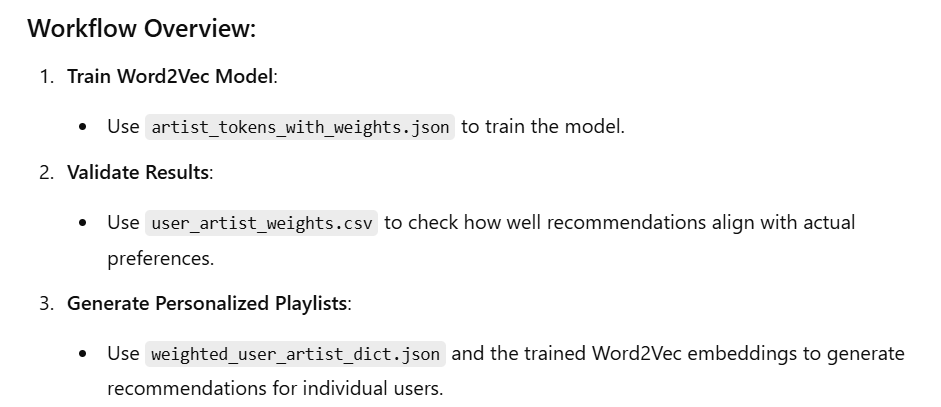

### Step 1: Incorporate Weights in Grouping

The user_weight and combined_weight columns represent user-specific influence.

When grouping by user_id and artistname, we calculate a weighted frequency for each artist's tracks.


In [ ]:
# Group by user_id and artistname, aggregating track names into lists and summing weights
user_artist_weights = (
    df_clean.groupby(['user_id', 'artistname'])
    .agg(
        tracklist=('trackname', list),  # Aggregate track names into lists
        user_weight=('user_weight', 'mean'),  # Average user weight for the user-artist pair
        combined_weight=('combined_weight', 'sum')  # Sum of combined weights
    )
    .reset_index()
)

# Verify the results
print(user_artist_weights.head())


                            user_id           artistname  \
0  00055176fea33f6e027cd3302289378b  5 seconds of summer   
1  00055176fea33f6e027cd3302289378b      abigail breslin   
2  00055176fea33f6e027cd3302289378b  against the current   
3  00055176fea33f6e027cd3302289378b         all time low   
4  00055176fea33f6e027cd3302289378b                auryn   

                                           tracklist  user_weight  \
0  [disconnected, dont stop  acoustic, english lo...          1.0   
1                                         [you suck]          1.0   
2  [another you another way, closer faster, gravity]          1.0   
3  [backseat serenade, break your little heart, d...          1.0   
4                              [saturday im in love]          1.0   

   combined_weight  
0         5.456435  
1         0.545644  
2         1.636931  
3         4.365148  
4         0.545644  


### Step 2: Create a Weighted User-Artist Dictionary
Use the user_weight or combined_weight to adjust the importance of each user's tracks.

In [ ]:
from collections import defaultdict

# Initialize dictionary
weighted_user_artist_dict = defaultdict(dict)

# Populate the dictionary
for _, row in user_artist_weights.iterrows():
    user_id = row['user_id']
    artist = row['artistname']
    tracks = row['tracklist']
    weight = row['combined_weight']  # Choose the weight you want to prioritize
    weighted_user_artist_dict[user_id][artist] = {'tracks': tracks, 'weight': weight}

# Verify the structure of one user
example_user = list(weighted_user_artist_dict.keys())[0]
print(f"Example User ({example_user}):", weighted_user_artist_dict[example_user])


Example User (00055176fea33f6e027cd3302289378b): {'5 seconds of summer': {'tracks': ['disconnected', 'dont stop  acoustic', 'english love affair', 'everything i didnt say', 'everything i didnt say  live', 'if you dont know', 'just saying', 'long way home', 'long way home  acoustic', 'the only reason'], 'weight': 5.4564354645876385}, 'abigail breslin': {'tracks': ['you suck'], 'weight': 0.5456435464587639}, 'against the current': {'tracks': ['another you another way', 'closer faster', 'gravity'], 'weight': 1.6369306393762917}, 'all time low': {'tracks': ['backseat serenade', 'break your little heart', 'dear maria count me in', 'jasey rae', 'merry christmas kiss my ass', 'somethings gotta give', 'the reckless and the brave', 'therapy'], 'weight': 4.365148371670111}, 'auryn': {'tracks': ['saturday im in love'], 'weight': 0.5456435464587639}, 'austin mahone': {'tracks': ['what about love'], 'weight': 0.5456435464587639}, 'avril lavigne': {'tracks': ['girlfriend', 'heres to never growing up

### Step 3.1: Tokenize Tracks with Weights (Step 1 in tokenizing, later on this step needs adjustments after analyzing the tokens, look at step 3.2 at the end of notebook)
When preparing tokens for Word2Vec, use weights to repeat tracks or adjust their presence in the tokenized dataset.

In [ ]:
import json

# Open a file to save tokens incrementally
with open('artist_tokens_with_weights.json', 'w') as f:
    f.write('[')  # Start the JSON list

    for user_id, artist_dict in weighted_user_artist_dict.items():
        for artist, data in artist_dict.items():
            tracks = data['tracks']
            weight = data['weight']

            # Repeat tracks based on weight
            weighted_tracks = tracks * int(round(weight * 10))  # Scale weight for repetition

            # Write the weighted tracks as a JSON array
            json.dump(weighted_tracks, f)
            f.write(',')  # Add a comma after each chunk

    f.seek(f.tell() - 1, 0)  # Remove the last comma
    f.write(']')  # End the JSON list

print("Weighted tokens for Word2Vec saved as 'artist_tokens_with_weights.json'.")


Weighted tokens for Word2Vec saved as 'artist_tokens_with_weights.json'.


## Realizing that i should devide to chunks because the full artist_token_with_weights.json is 11 GB and even upluading with gdown has its limits. so this is the chunky munky new code for tokens: (each chunk is 500 MB)

In [ ]:
import json
import os

# Define the chunk size (500 MB)
chunk_size_limit = 500 * 1024 * 1024  # 500 MB in bytes
output_dir = './chunks/'  # Directory to save chunk files
os.makedirs(output_dir, exist_ok=True)  # Create the directory if it doesn't exist

# Initialize variables
chunk_index = 1
current_chunk_size = 0
current_chunk = []

# Start processing weighted tokens
for user_id, artist_dict in weighted_user_artist_dict.items():
    for artist, data in artist_dict.items():
        tracks = data['tracks']
        weight = data['weight']

        # Repeat tracks based on weight
        weighted_tracks = tracks * int(round(weight * 10))  # Scale weight for repetition

        # Serialize the weighted tracks to JSON and calculate its size
        serialized_record = json.dumps(weighted_tracks)
        record_size = len(serialized_record.encode('utf-8'))

        # Check if adding this record exceeds the chunk size
        if current_chunk_size + record_size > chunk_size_limit:
            # Save the current chunk to a file
            output_file = os.path.join(output_dir, f'artist_tokens_chunk_{chunk_index}.json')
            with open(output_file, 'w') as f:
                f.write('[')  # Start the JSON list
                f.write(','.join(current_chunk))  # Write all records in the current chunk
                f.write(']')  # End the JSON list

            print(f"Chunk {chunk_index} saved with size: {current_chunk_size / (1024 * 1024):.2f} MB")

            # Reset for the next chunk
            chunk_index += 1
            current_chunk_size = 0
            current_chunk = []

        # Add the serialized record to the current chunk
        current_chunk.append(serialized_record)
        current_chunk_size += record_size

# Save the last chunk if it has data
if current_chunk:
    output_file = os.path.join(output_dir, f'artist_tokens_chunk_{chunk_index}.json')
    with open(output_file, 'w') as f:
        f.write('[')  # Start the JSON list
        f.write(','.join(current_chunk))  # Write all records in the current chunk
        f.write(']')  # End the JSON list

    print(f"Chunk {chunk_index} saved with size: {current_chunk_size / (1024 * 1024):.2f} MB")

print(f"All chunks saved to {output_dir}")


Chunk 1 saved with size: 499.76 MB
Chunk 2 saved with size: 240.20 MB
Chunk 3 saved with size: 634.66 MB
Chunk 4 saved with size: 499.99 MB
Chunk 5 saved with size: 486.17 MB
Chunk 6 saved with size: 499.74 MB
Chunk 7 saved with size: 498.03 MB
Chunk 8 saved with size: 499.97 MB
Chunk 9 saved with size: 500.00 MB
Chunk 10 saved with size: 499.70 MB
Chunk 11 saved with size: 499.96 MB
Chunk 12 saved with size: 499.83 MB
Chunk 13 saved with size: 499.90 MB
Chunk 14 saved with size: 466.00 MB
Chunk 15 saved with size: 499.62 MB
Chunk 16 saved with size: 499.88 MB
Chunk 17 saved with size: 498.81 MB
Chunk 18 saved with size: 499.90 MB
Chunk 19 saved with size: 499.45 MB
Chunk 20 saved with size: 496.52 MB
Chunk 21 saved with size: 499.92 MB
Chunk 22 saved with size: 448.82 MB
Chunk 23 saved with size: 500.00 MB
Chunk 24 saved with size: 496.46 MB
Chunk 25 saved with size: 499.93 MB
Chunk 26 saved with size: 16.01 MB
All chunks saved to ./chunks/


In [ ]:
import shutil

# Define the directory and output zip file name
chunk_dir = './chunks'
zip_file = 'artist_tokens_chunks.zip'

# Compress the directory
shutil.make_archive(zip_file.replace('.zip', ''), 'zip', chunk_dir)

print(f"Directory {chunk_dir} compressed to {zip_file}")


Directory ./chunks compressed to artist_tokens_chunks.zip


# Direct link to artist_tokens_chunks.zip (containing all artist_tokens_with_weights.json devided into small chunks)

In [ ]:
import gdown
import pandas as pd

# Define the Google Drive file ID
file_id = '12G5gByjOh7NsUhzr_8i0h-m7BdUoKfyg'
# Construct the download URL
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output CSV file path
output_csv_path = 'artist_tokens_chunks.zip'

# Download the file using gdown
gdown.download(download_url, output_csv_path, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?export=download&id=12G5gByjOh7NsUhzr_8i0h-m7BdUoKfyg
From (redirected): https://drive.google.com/uc?export=download&id=12G5gByjOh7NsUhzr_8i0h-m7BdUoKfyg&confirm=t&uuid=b66a4572-753d-4e5d-b51f-e82fa04c9e78
To: /content/artist_tokens_chunks.zip
100%|██████████| 671M/671M [00:14<00:00, 45.6MB/s]


'artist_tokens_chunks.zip'

### Step 4: Save Intermediate Outputs


In [ ]:
# Save user-artist-weighted grouped data
user_artist_weights.to_csv('user_artist_weights.csv', index=False)
print("User-artist-weight mapping saved as 'user_artist_weights.csv'.")

# Save the weighted user-artist dictionary
with open('weighted_user_artist_dict.json', 'w') as f:
    json.dump(weighted_user_artist_dict, f)

print("Weighted user-artist dictionary saved as 'weighted_user_artist_dict.json'.")


User-artist-weight mapping saved as 'user_artist_weights.csv'.
Weighted user-artist dictionary saved as 'weighted_user_artist_dict.json'.


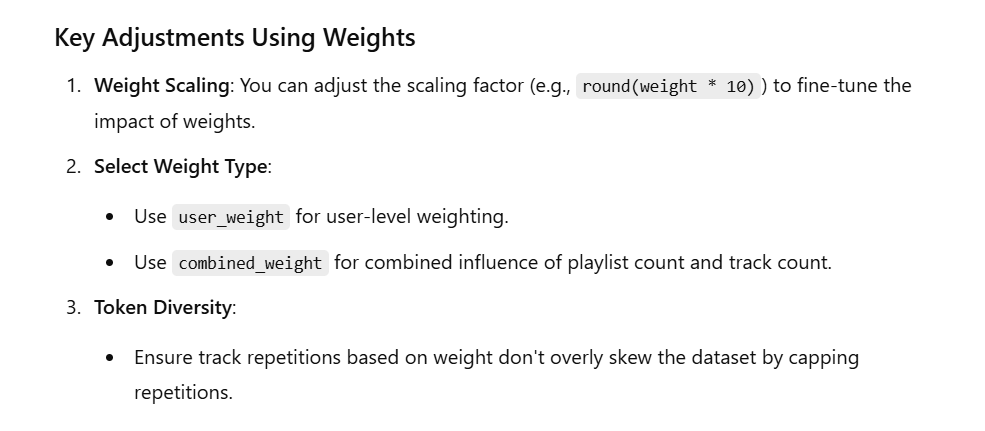

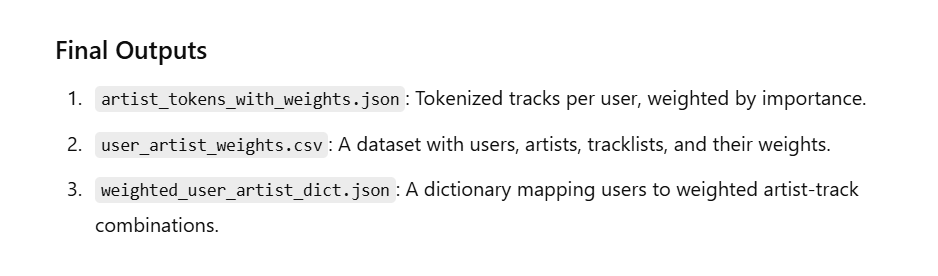

Step 8 : WORD2VEC model

## Direct link to all 3 files in tokenizing process

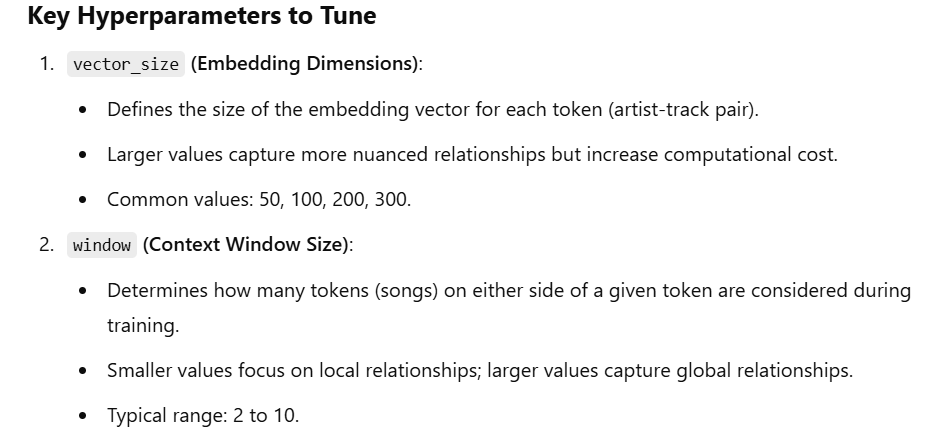

In [ ]:
import gdown
import pandas as pd

# Define the Google Drive file ID
file_id = '1fjmDxhIQ_JVHK2trzI5KPsUNB_XUxe7W'
# Construct the download URL
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output CSV file path
output_csv_path = 'weighted_user_artist_dict.json'

# Download the file using gdown
gdown.download(download_url, output_csv_path, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?export=download&id=1fjmDxhIQ_JVHK2trzI5KPsUNB_XUxe7W
From (redirected): https://drive.google.com/uc?export=download&id=1fjmDxhIQ_JVHK2trzI5KPsUNB_XUxe7W&confirm=t&uuid=393900eb-3efc-4084-949b-fa66877d07b5
To: /content/weighted_user_artist_dict.json
100%|██████████| 396M/396M [00:10<00:00, 38.3MB/s]


'weighted_user_artist_dict.json'

In [ ]:
import gdown
import pandas as pd

# Define the Google Drive file ID
file_id = '1A3N2QnJc6YzHRyUOYw9PkpRMKZhvr8MJ'
# Construct the download URL
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output CSV file path
output_csv_path = 'user_artist_weights.csv'
# Download the file using gdown
gdown.download(download_url, output_csv_path, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?export=download&id=1A3N2QnJc6YzHRyUOYw9PkpRMKZhvr8MJ
From (redirected): https://drive.google.com/uc?export=download&id=1A3N2QnJc6YzHRyUOYw9PkpRMKZhvr8MJ&confirm=t&uuid=1064b259-6c9f-4c9c-952f-ea53b8640b9b
To: /content/user_artist_weights.csv
100%|██████████| 464M/464M [00:06<00:00, 74.7MB/s]


'user_artist_weights.csv'

# Direct link to artist_tokens_checks.zip (tokens for the model are devided into mini jasons to feed the model)

In [ ]:
import gdown
import pandas as pd

# Define the Google Drive file ID
file_id = '12G5gByjOh7NsUhzr_8i0h-m7BdUoKfyg'
# Construct the download URL
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output CSV file path
output_csv_path = 'artist_tokens_chunks.zip'

# Download the file using gdown
gdown.download(download_url, output_csv_path, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?export=download&id=12G5gByjOh7NsUhzr_8i0h-m7BdUoKfyg
From (redirected): https://drive.google.com/uc?export=download&id=12G5gByjOh7NsUhzr_8i0h-m7BdUoKfyg&confirm=t&uuid=b66a4572-753d-4e5d-b51f-e82fa04c9e78
To: /content/artist_tokens_chunks.zip
100%|██████████| 671M/671M [00:14<00:00, 45.6MB/s]


'artist_tokens_chunks.zip'

## Extraction of 26 mini jasons of tokens :

In [ ]:
import zipfile

# Path to the downloaded ZIP file
zip_file_path = 'artist_tokens_chunks.zip'
extract_to_path = 'artist_tokens_chunks/'  # Directory to extract files

# Extract the ZIP file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to_path)

print("Extraction completed!")


Extraction completed!


In [ ]:
import os

# List files in the extracted directory
extracted_files = os.listdir(extract_to_path)
print(f"Extracted files: {extracted_files}")


Extracted files: ['artist_tokens_chunk_16.json', 'artist_tokens_chunk_25.json', 'artist_tokens_chunk_21.json', 'artist_tokens_chunk_1.json', 'artist_tokens_chunk_20.json', 'artist_tokens_chunk_22.json', 'artist_tokens_chunk_6.json', 'artist_tokens_chunk_3.json', 'artist_tokens_chunk_24.json', 'artist_tokens_chunk_18.json', 'artist_tokens_chunk_26.json', 'artist_tokens_chunk_7.json', 'artist_tokens_chunk_11.json', 'artist_tokens_chunk_19.json', 'artist_tokens_chunk_8.json', 'artist_tokens_chunk_2.json', 'artist_tokens_chunk_15.json', 'artist_tokens_chunk_4.json', 'artist_tokens_chunk_10.json', 'artist_tokens_chunk_17.json', 'artist_tokens_chunk_5.json', 'artist_tokens_chunk_23.json', 'artist_tokens_chunk_9.json', 'artist_tokens_chunk_13.json', 'artist_tokens_chunk_14.json', 'artist_tokens_chunk_12.json']


In [ ]:
import json

# Load and inspect a sample file
sample_file = os.path.join(extract_to_path, extracted_files[0])  # Load the first file
with open(sample_file, 'r') as f:
    data = json.load(f)

print(f"Sample data from {sample_file}: {data[:10]}")  # Print a sample of the data


Sample data from artist_tokens_chunks/artist_tokens_chunk_16.json: [['the christmas waltz  2004 digital remaster', 'you dont know how glad i am  2002  remaster', 'a sleepin bee', 'alfie  2006 digital remaster', 'all of you  1995 digital remaster', 'almost in your arms', 'angel eyes  1994 digital remaster', 'at long last love  1995  remaster', 'back in your own back yard  digitally remastered 93', 'bewitched', 'blue prelude', 'by myself  digitally remastered 96', 'darn that dream', 'days of wine and roses  2006 digital remaster', 'dearly beloved', 'dearly beloved  1992 digital remaster', 'did i remember  2006 digital remaster', 'dont go to strangers  digitally remastered 96', 'dont take your love from me  remaster', 'fly me to the moon in other words  1996 digital remaster', 'gee baby aint i good to you  digitally remastered 96', 'glad to be unhappy  2001 digital remaster', 'happy talk', 'hello dolly', 'i thought about you', 'i wanna be loved  2002 digital remaster', 'ill never stop lov

### To ensure the artist names are there, we can inspect a portion of the data:

Tokens Are Just Track Names: If the tokens are only the track names, you won't find explicit artist names directly in this file. However, the tracks were generated with weights from the weighted_user_artist_dict. So, the artist names were "implied" during the token creation process.

In [ ]:
# Inspect the length and a sample of the token data
print(f"Number of tokens: {len(data)}")
print("Sample token:", data[:5])


Number of tokens: 102612
Sample token: [['disconnected', 'dont stop  acoustic', 'english love affair', 'everything i didnt say', 'everything i didnt say  live', 'if you dont know', 'just saying', 'long way home', 'long way home  acoustic', 'the only reason', 'disconnected', 'dont stop  acoustic', 'english love affair', 'everything i didnt say', 'everything i didnt say  live', 'if you dont know', 'just saying', 'long way home', 'long way home  acoustic', 'the only reason', 'disconnected', 'dont stop  acoustic', 'english love affair', 'everything i didnt say', 'everything i didnt say  live', 'if you dont know', 'just saying', 'long way home', 'long way home  acoustic', 'the only reason', 'disconnected', 'dont stop  acoustic', 'english love affair', 'everything i didnt say', 'everything i didnt say  live', 'if you dont know', 'just saying', 'long way home', 'long way home  acoustic', 'the only reason', 'disconnected', 'dont stop  acoustic', 'english love affair', 'everything i didnt say',

If your goal is to create user-personalized playlists and ensure that the model understands the relationship between artists and tracks, then you must include artist context during token creation.

## Step 3.2 - back to step 3.1 - Modifying the tokens to concatenated [artist_name : track_name] because for personalized playlists "artists" content is very important to depict a user behaviour, so an implied option of tokens like before just don't cut it !!

this code is for full file, but like before it will be too big so move to the next block for creating the tokens in chunks !!

In [ ]:
import json

# Load a single JSON chunk file
file_path = '/content/artist_tokens_chunks/artist_tokens_chunk_1.json'  # Replace with the actual path
with open(file_path, 'r') as f:
    data = json.load(f)

# Print the first 10 items for inspection
print("Sample tokens:", data[:10])


Sample tokens: [['disconnected', 'dont stop  acoustic', 'english love affair', 'everything i didnt say', 'everything i didnt say  live', 'if you dont know', 'just saying', 'long way home', 'long way home  acoustic', 'the only reason', 'disconnected', 'dont stop  acoustic', 'english love affair', 'everything i didnt say', 'everything i didnt say  live', 'if you dont know', 'just saying', 'long way home', 'long way home  acoustic', 'the only reason', 'disconnected', 'dont stop  acoustic', 'english love affair', 'everything i didnt say', 'everything i didnt say  live', 'if you dont know', 'just saying', 'long way home', 'long way home  acoustic', 'the only reason', 'disconnected', 'dont stop  acoustic', 'english love affair', 'everything i didnt say', 'everything i didnt say  live', 'if you dont know', 'just saying', 'long way home', 'long way home  acoustic', 'the only reason', 'disconnected', 'dont stop  acoustic', 'english love affair', 'everything i didnt say', 'everything i didnt say

In [ ]:
import json

# Open a file to save tokens incrementally
with open('artist_tokens_with_weights.json', 'w') as f:
    f.write('[')  # Start the JSON list

    for user_id, artist_dict in weighted_user_artist_dict.items():
        for artist, data in artist_dict.items():
            tracks = data['tracks']
            weight = data['weight']

            # Generate tokens in the format "artist_name:track_name"
            weighted_tokens = [f"{artist}:{track}" for track in tracks] * int(round(weight * 5))  # Scale weight by 5

            # Write the weighted tokens as a JSON array
            json.dump(weighted_tokens, f)
            f.write(',')  # Add a comma after each chunk

    f.seek(f.tell() - 1, 0)  # Remove the last comma
    f.write(']')  # End the JSON list

print("Weighted tokens for Word2Vec saved as 'artist_tokens_with_weights.json'.")


KeyboardInterrupt: 

### Creating the tokens [artist_name : track_name] in chunks:

In [ ]:
import json
import os

# Define the chunk size (500 MB)
chunk_size_limit = 500 * 1024 * 1024  # 500 MB in bytes
output_dir = './chunks_modified/'  # Directory to save chunk files
os.makedirs(output_dir, exist_ok=True)  # Create the directory if it doesn't exist

# Initialize variables
chunk_index = 1
current_chunk_size = 0
current_chunk = []

# Start processing weighted tokens
for user_id, artist_dict in weighted_user_artist_dict.items():
    for artist, data in artist_dict.items():
        tracks = data['tracks']
        weight = data['weight']

        # Generate tokens in the format "artist_name:track_name" and repeat based on weight
        weighted_tokens = [f"{artist}:{track}" for track in tracks] * int(round(weight * 5))  # Scale weight by 5

        # Serialize the weighted tokens to JSON and calculate its size
        serialized_record = json.dumps(weighted_tokens)
        record_size = len(serialized_record.encode('utf-8'))

        # Check if adding this record exceeds the chunk size
        if current_chunk_size + record_size > chunk_size_limit:
            # Save the current chunk to a file
            output_file = os.path.join(output_dir, f'artist_tokens_chunk_modified_{chunk_index}.json')
            with open(output_file, 'w') as f:
                f.write('[')  # Start the JSON list
                f.write(','.join(current_chunk))  # Write all records in the current chunk
                f.write(']')  # End the JSON list

            print(f"Chunk {chunk_index} saved with size: {current_chunk_size / (1024 * 1024):.2f} MB")

            # Reset for the next chunk
            chunk_index += 1
            current_chunk_size = 0
            current_chunk = []

        # Add the serialized record to the current chunk
        current_chunk.append(serialized_record)
        current_chunk_size += record_size

# Save the last chunk if it has data
if current_chunk:
    output_file = os.path.join(output_dir, f'artist_tokens_chunk_modified_{chunk_index}.json')
    with open(output_file, 'w') as f:
        f.write('[')  # Start the JSON list
        f.write(','.join(current_chunk))  # Write all records in the current chunk
        f.write(']')  # End the JSON list

    print(f"Chunk {chunk_index} saved with size: {current_chunk_size / (1024 * 1024):.2f} MB")

print(f"All chunks saved to {output_dir}")


Chunk 1 saved with size: 499.84 MB
Chunk 2 saved with size: 500.00 MB
Chunk 3 saved with size: 499.99 MB
Chunk 4 saved with size: 499.65 MB
Chunk 5 saved with size: 499.83 MB
Chunk 6 saved with size: 499.99 MB
Chunk 7 saved with size: 500.00 MB
Chunk 8 saved with size: 498.92 MB
Chunk 9 saved with size: 499.91 MB
Chunk 10 saved with size: 494.81 MB
Chunk 11 saved with size: 486.99 MB
Chunk 12 saved with size: 500.00 MB
Chunk 13 saved with size: 487.82 MB
Chunk 14 saved with size: 499.95 MB
Chunk 15 saved with size: 499.93 MB
Chunk 16 saved with size: 498.70 MB
Chunk 17 saved with size: 498.20 MB
Chunk 18 saved with size: 499.93 MB
Chunk 19 saved with size: 359.52 MB
All chunks saved to ./chunks_modified/


In [ ]:
import shutil

# Define the directory and output zip file name
chunk_dir = './chunks_modified'
zip_file = 'artist_tokens_chunks_modified.zip'

# Compress the directory
shutil.make_archive(zip_file.replace('.zip', ''), 'zip', chunk_dir)

print(f"Directory {chunk_dir} compressed to {zip_file}")


Directory ./chunks_modified compressed to artist_tokens_chunks_modified.zip


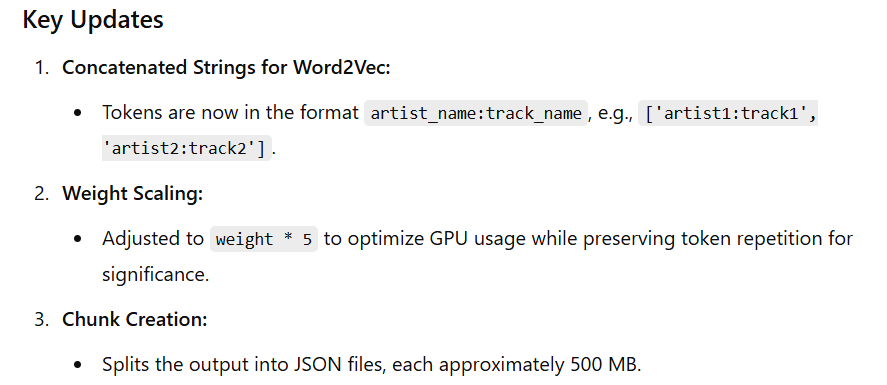

# Direct link to artist_tokens_chunks_modified.zip

In [ ]:
import gdown
import pandas as pd

# Define the Google Drive file ID
file_id = '1NajTCvKe714wR0B0nDhJxpDJoqf9LlpP'
# Construct the download URL
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output CSV file path
output_csv_path = 'artist_tokens_chunks_modified.zip'

# Download the file using gdown
gdown.download(download_url, output_csv_path, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?export=download&id=1NajTCvKe714wR0B0nDhJxpDJoqf9LlpP
From (redirected): https://drive.google.com/uc?export=download&id=1NajTCvKe714wR0B0nDhJxpDJoqf9LlpP&confirm=t&uuid=18d64284-af0c-4eaa-9360-3a32d9292c23
To: /content/artist_tokens_chunks_modified.zip
100%|██████████| 510M/510M [00:07<00:00, 70.4MB/s]


'artist_tokens_chunks_modified.zip'

## Extraction of 19 mini jasons of tokens :

In [ ]:
import zipfile

# Path to the downloaded ZIP file
zip_file_path = 'artist_tokens_chunks_modified.zip'
extract_to_path = 'artist_tokens_chunks_modified/'  # Directory to extract files

# Extract the ZIP file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to_path)

print("Extraction completed!")

Extraction completed!


## Analyzing the modified tokens

In [ ]:
import os

# List files in the extracted directory
extracted_files = os.listdir(extract_to_path)
print(f"Extracted files: {extracted_files}")

Extracted files: ['artist_tokens_chunk_modified_15.json', 'artist_tokens_chunk_modified_10.json', 'artist_tokens_chunk_modified_8.json', 'artist_tokens_chunk_modified_11.json', 'artist_tokens_chunk_modified_14.json', 'artist_tokens_chunk_modified_1.json', 'artist_tokens_chunk_modified_13.json', 'artist_tokens_chunk_modified_17.json', 'artist_tokens_chunk_modified_2.json', 'artist_tokens_chunk_modified_6.json', 'artist_tokens_chunk_modified_7.json', 'artist_tokens_chunk_modified_4.json', 'artist_tokens_chunk_modified_5.json', 'artist_tokens_chunk_modified_16.json', 'artist_tokens_chunk_modified_12.json', 'artist_tokens_chunk_modified_3.json', 'artist_tokens_chunk_modified_19.json', 'artist_tokens_chunk_modified_18.json', 'artist_tokens_chunk_modified_9.json']


In [ ]:
import json

# Load and inspect a sample file
sample_file = os.path.join(extract_to_path, extracted_files[0])  # Load the first file
with open(sample_file, 'r') as f:
    data = json.load(f)

print(f"Sample data from {sample_file}: {data[:10]}")  # Print a sample of the data


Sample data from artist_tokens_chunks_modified/artist_tokens_chunk_modified_15.json: [['alejandro sanz:cancin sin emocin', 'alejandro sanz:ellos son asi', 'alejandro sanz:eres mia', 'alejandro sanz:ese que me di la vida', 'alejandro sanz:la fuerza del corazn', 'alejandro sanz:mi soledad y yo', 'alejandro sanz:por bandera', 'alejandro sanz:quiero morir en tu veneno', 'alejandro sanz:se me olvid todo al verte', 'alejandro sanz:lo ves', 'alejandro sanz:lo ves  piano y voz', 'alejandro sanz:a golpes contra el calendario', 'alejandro sanz:como te echo de menos', 'alejandro sanz:los dos cogidos de la mano', 'alejandro sanz:mi primera cancin', 'alejandro sanz:pisando fuerte', 'alejandro sanz:que no te dara yo', 'alejandro sanz:se le apago la luz  version basico', 'alejandro sanz:si tu me miras', 'alejandro sanz:tu letra podre acariciar', 'alejandro sanz:viviendo deprisa', 'alejandro sanz:a la primera persona', 'alejandro sanz:amiga mia', 'alejandro sanz:aquello que me diste', 'alejandro sanz:

In [ ]:
# Inspect the length and a sample of the token data
print(f"Number of tokens: {len(data)}")
print("Sample token:", data[:5])

Number of tokens: 110529
Sample token: [['alejandro sanz:cancin sin emocin', 'alejandro sanz:ellos son asi', 'alejandro sanz:eres mia', 'alejandro sanz:ese que me di la vida', 'alejandro sanz:la fuerza del corazn', 'alejandro sanz:mi soledad y yo', 'alejandro sanz:por bandera', 'alejandro sanz:quiero morir en tu veneno', 'alejandro sanz:se me olvid todo al verte', 'alejandro sanz:lo ves', 'alejandro sanz:lo ves  piano y voz', 'alejandro sanz:a golpes contra el calendario', 'alejandro sanz:como te echo de menos', 'alejandro sanz:los dos cogidos de la mano', 'alejandro sanz:mi primera cancin', 'alejandro sanz:pisando fuerte', 'alejandro sanz:que no te dara yo', 'alejandro sanz:se le apago la luz  version basico', 'alejandro sanz:si tu me miras', 'alejandro sanz:tu letra podre acariciar', 'alejandro sanz:viviendo deprisa', 'alejandro sanz:a la primera persona', 'alejandro sanz:amiga mia', 'alejandro sanz:aquello que me diste', 'alejandro sanz:cai  feat nia pastori', 'alejandro sanz:como t

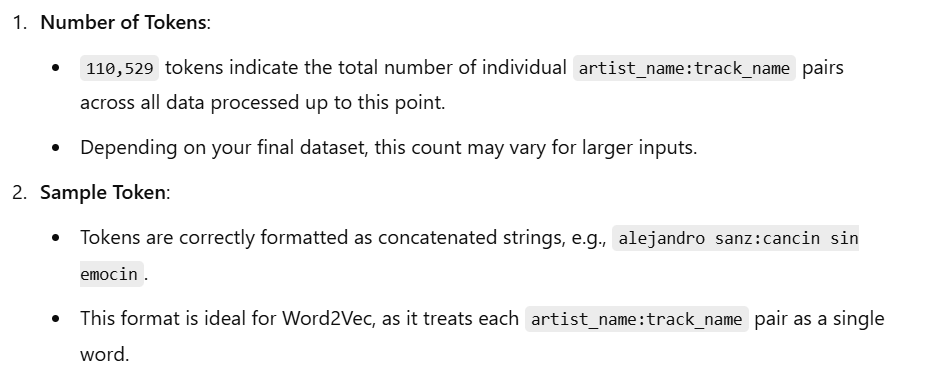

# Working in Google Colab free enviroment could be challenging - you can switch to GPU but it doesn't help if you don't have enough RAM to run this process. Also chunks are 500 MB which is possibly to big for the limited RAM.

So i will create now the Zip file with 100 MB tokens files instead of 500 MB + i will add saved checkpoints in case it crashes again so i won't lose the process made, and then continue from the last saved checkpoint in a way that's called "incremental learning".

This way + showing progress, could lead to better faster time consuming and data consuming for the model results.

## Zip process made again - Recreating 100 MB files from the last zip file - saving to artist_tokens_chunks_modified.zip file

In [ ]:
import os
import json
import zipfile
import shutil

# Paths
input_zip_path = 'artist_tokens_chunks_modified.zip'  # Your zip file containing 500 MB chunks
output_dir = './100MB_chunks/'  # Directory to save 100 MB chunks
os.makedirs(output_dir, exist_ok=True)

# Define the chunk size (100 MB)
chunk_size_limit = 100 * 1024 * 1024  # 100 MB in bytes

# New zip file to save all 100 MB chunks
output_zip_path = 'artist_tokens_100MB_chunks.zip'

# Unzip and process each 500 MB file
with zipfile.ZipFile(input_zip_path, 'r') as zip_ref, zipfile.ZipFile(output_zip_path, 'w') as output_zip:
    for file_name in zip_ref.namelist():
        print(f"Processing {file_name}...")

        # Extract the file
        zip_ref.extract(file_name, './temp/')
        input_file_path = os.path.join('./temp/', file_name)

        # Load the JSON data
        with open(input_file_path, 'r') as file:
            data = json.load(file)

        # Split into smaller chunks
        chunk_index = 1
        current_chunk_size = 0
        current_chunk = []

        for item in data:
            # Serialize the item and calculate its size
            serialized_record = json.dumps(item)
            record_size = len(serialized_record.encode('utf-8'))

            # Check if adding this record exceeds the chunk size
            if current_chunk_size + record_size > chunk_size_limit:
                # Save the current chunk
                output_file_name = f'{os.path.splitext(file_name)[0]}_chunk_{chunk_index}.json'
                output_file_path = os.path.join(output_dir, output_file_name)

                with open(output_file_path, 'w') as f:
                    f.write('[')  # Start JSON array
                    f.write(','.join(current_chunk))  # Write all records
                    f.write(']')  # End JSON array

                # Add the chunk to the new zip file
                output_zip.write(output_file_path, arcname=os.path.basename(output_file_path))

                print(f"Saved chunk: {output_file_path} with size: {current_chunk_size / (1024 * 1024):.2f} MB")

                # Reset for the next chunk
                chunk_index += 1
                current_chunk_size = 0
                current_chunk = []

            # Add the item to the current chunk
            current_chunk.append(serialized_record)
            current_chunk_size += record_size

        # Save the last chunk if it has data
        if current_chunk:
            output_file_name = f'{os.path.splitext(file_name)[0]}_chunk_{chunk_index}.json'
            output_file_path = os.path.join(output_dir, output_file_name)

            with open(output_file_path, 'w') as f:
                f.write('[')  # Start JSON array
                f.write(','.join(current_chunk))  # Write all records
                f.write(']')  # End JSON array

            # Add the chunk to the new zip file
            output_zip.write(output_file_path, arcname=os.path.basename(output_file_path))

            print(f"Saved last chunk: {output_file_path} with size: {current_chunk_size / (1024 * 1024):.2f} MB")

# Clean up temp directory
shutil.rmtree('./temp/', ignore_errors=True)
print(f"All files processed and saved to {output_dir}")
print(f"All 100 MB chunks zipped into: {output_zip_path}")


Processing artist_tokens_chunk_modified_15.json...
Saved chunk: ./100MB_chunks/artist_tokens_chunk_modified_15_chunk_1.json with size: 78.65 MB
Saved chunk: ./100MB_chunks/artist_tokens_chunk_modified_15_chunk_2.json with size: 99.95 MB
Saved chunk: ./100MB_chunks/artist_tokens_chunk_modified_15_chunk_3.json with size: 100.00 MB
Saved chunk: ./100MB_chunks/artist_tokens_chunk_modified_15_chunk_4.json with size: 39.41 MB
Saved chunk: ./100MB_chunks/artist_tokens_chunk_modified_15_chunk_5.json with size: 96.64 MB
Saved last chunk: ./100MB_chunks/artist_tokens_chunk_modified_15_chunk_6.json with size: 85.29 MB
Processing artist_tokens_chunk_modified_10.json...
Saved chunk: ./100MB_chunks/artist_tokens_chunk_modified_10_chunk_1.json with size: 99.98 MB
Saved chunk: ./100MB_chunks/artist_tokens_chunk_modified_10_chunk_2.json with size: 99.22 MB
Saved chunk: ./100MB_chunks/artist_tokens_chunk_modified_10_chunk_3.json with size: 99.17 MB
Saved chunk: ./100MB_chunks/artist_tokens_chunk_modifie

In [ ]:
with zipfile.ZipFile(output_zip_path, 'r') as zip_ref:
    file_list = zip_ref.namelist()
    print(f"Total files in ZIP: {len(file_list)}")
    for file in file_list:
        print(file)


Total files in ZIP: 101
artist_tokens_chunk_modified_15_chunk_1.json
artist_tokens_chunk_modified_15_chunk_2.json
artist_tokens_chunk_modified_15_chunk_3.json
artist_tokens_chunk_modified_15_chunk_4.json
artist_tokens_chunk_modified_15_chunk_5.json
artist_tokens_chunk_modified_15_chunk_6.json
artist_tokens_chunk_modified_10_chunk_1.json
artist_tokens_chunk_modified_10_chunk_2.json
artist_tokens_chunk_modified_10_chunk_3.json
artist_tokens_chunk_modified_10_chunk_4.json
artist_tokens_chunk_modified_10_chunk_5.json
artist_tokens_chunk_modified_8_chunk_1.json
artist_tokens_chunk_modified_8_chunk_2.json
artist_tokens_chunk_modified_8_chunk_3.json
artist_tokens_chunk_modified_8_chunk_4.json
artist_tokens_chunk_modified_8_chunk_5.json
artist_tokens_chunk_modified_8_chunk_6.json
artist_tokens_chunk_modified_11_chunk_1.json
artist_tokens_chunk_modified_11_chunk_2.json
artist_tokens_chunk_modified_11_chunk_3.json
artist_tokens_chunk_modified_11_chunk_4.json
artist_tokens_chunk_modified_11_chunk

In [ ]:
with zipfile.ZipFile(output_zip_path, 'r') as zip_ref:
    file_list = zip_ref.namelist()
    print(f"Total files in ZIP: {len(file_list)}")
    total_zip_size = sum(zip_ref.getinfo(file).file_size for file in file_list)
    print(f"Total size of files in ZIP: {total_zip_size / (1024 * 1024 * 1024):.2f} GB")


Total files in ZIP: 101
Total size of files in ZIP: 9.11 GB


# Zip file is too big so we continue shrinking it (you can go and do it with .gz compression but then it changes json to gz and its too much right now),  i take the easy way and devide the zip created into 500MB zips :

(you can't read 9GB from a drive with gdown library because gmail has its limits about this and gdown will stop working when you arrive that limit)

In [ ]:
import os
import zipfile

# Input zip file and directory
input_zip_path = 'artist_tokens_100MB_chunks.zip'
output_zip_dir = './500MB_zips/'  # Directory to save 500 MB zip files
os.makedirs(output_zip_dir, exist_ok=True)

# Size limit for each zip file (500 MB)
zip_size_limit = 500 * 1024 * 1024  # 500 MB in bytes

# Extract all files from the original zip
with zipfile.ZipFile(input_zip_path, 'r') as input_zip:
    file_list = input_zip.namelist()  # Get the list of files in the zip

    current_zip_size = 0
    current_zip_index = 1
    current_zip_files = []

    # Iterate over the files in the original zip
    for file_name in file_list:
        file_info = input_zip.getinfo(file_name)
        file_size = file_info.file_size

        # Check if adding this file exceeds the current zip size limit
        if current_zip_size + file_size > zip_size_limit:
            # Save the current 500 MB zip file
            output_zip_path = os.path.join(output_zip_dir, f'chunked_zip_{current_zip_index}.zip')
            with zipfile.ZipFile(output_zip_path, 'w') as output_zip:
                for f in current_zip_files:
                    with input_zip.open(f) as source_file:
                        output_zip.writestr(f, source_file.read())
            print(f"Saved zip: {output_zip_path} with size: {current_zip_size / (1024 * 1024):.2f} MB")

            # Reset for the next zip file
            current_zip_index += 1
            current_zip_size = 0
            current_zip_files = []

        # Add the current file to the list for the current zip
        current_zip_files.append(file_name)
        current_zip_size += file_size

    # Save the last zip file if there are remaining files
    if current_zip_files:
        output_zip_path = os.path.join(output_zip_dir, f'chunked_zip_{current_zip_index}.zip')
        with zipfile.ZipFile(output_zip_path, 'w') as output_zip:
            for f in current_zip_files:
                with input_zip.open(f) as source_file:
                    output_zip.writestr(f, source_file.read())
        print(f"Saved last zip: {output_zip_path} with size: {current_zip_size / (1024 * 1024):.2f} MB")

print("All files split into 500 MB zip files.")



Saved zip: ./500MB_zips/chunked_zip_1.zip with size: 414.73 MB
Saved zip: ./500MB_zips/chunked_zip_2.zip with size: 483.82 MB
Saved zip: ./500MB_zips/chunked_zip_3.zip with size: 432.90 MB
Saved zip: ./500MB_zips/chunked_zip_4.zip with size: 461.58 MB
Saved zip: ./500MB_zips/chunked_zip_5.zip with size: 485.28 MB
Saved zip: ./500MB_zips/chunked_zip_6.zip with size: 472.16 MB
Saved zip: ./500MB_zips/chunked_zip_7.zip with size: 430.33 MB
Saved zip: ./500MB_zips/chunked_zip_8.zip with size: 445.01 MB
Saved zip: ./500MB_zips/chunked_zip_9.zip with size: 390.15 MB
Saved zip: ./500MB_zips/chunked_zip_10.zip with size: 451.61 MB
Saved zip: ./500MB_zips/chunked_zip_11.zip with size: 404.30 MB
Saved zip: ./500MB_zips/chunked_zip_12.zip with size: 495.76 MB
Saved zip: ./500MB_zips/chunked_zip_13.zip with size: 297.85 MB
Saved zip: ./500MB_zips/chunked_zip_14.zip with size: 450.98 MB
Saved zip: ./500MB_zips/chunked_zip_15.zip with size: 451.16 MB
Saved zip: ./500MB_zips/chunked_zip_16.zip with s

In [ ]:
import os
import random
import shutil

# Directory with 500 MB ZIP files
source_dir = './500MB_zips/'

# Directories for train and test splits
train_dir = './500MB_train_zips/'
test_dir = './500MB_test_zips/'

os.makedirs(train_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

# List of all ZIP files
zip_files = [f for f in os.listdir(source_dir) if f.endswith('.zip')]

# Shuffle and split into 80% train and 20% test
random.seed(42)  # Ensure reproducibility
random.shuffle(zip_files)
split_index = int(0.8 * len(zip_files))
train_files = zip_files[:split_index]
test_files = zip_files[split_index:]

# Move files to respective directories
for f in train_files:
    shutil.move(os.path.join(source_dir, f), os.path.join(train_dir, f))
for f in test_files:
    shutil.move(os.path.join(source_dir, f), os.path.join(test_dir, f))

print(f"Training files: {len(train_files)}")
print(f"Testing files: {len(test_files)}")


Training files: 16
Testing files: 5


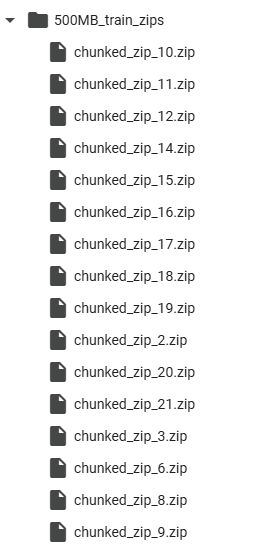

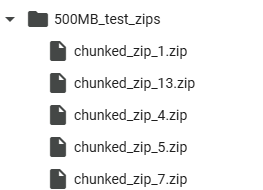

# Direct 500MB zip files upload of same seed, so it's not a random split but rather fixed one , like in the picture

In [1]:
from google.colab import drive
import os

# Mount Google Drive
drive.mount('/content/drive')

# Path to saved folders in Google Drive
train_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_test_zips'
test_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_train_zips'

# Ensure directories exist
if not os.path.exists(train_dir):
    raise FileNotFoundError(f"Training directory not found at {train_dir}")
if not os.path.exists(test_dir):
    raise FileNotFoundError(f"Testing directory not found at {test_dir}")

print(f"Training files found: {len(os.listdir(train_dir))}")
print(f"Testing files found: {len(os.listdir(test_dir))}")


Mounted at /content/drive
Training files found: 5
Testing files found: 16


## Analyze one of the Json 100MB files inside one of the Zip 500MB files

In [ ]:
import zipfile
import os
import json

# Path to the ZIP file containing 100 MB chunks
zip_file_path = './artist_tokens_100MB_chunks.zip'

# Directory to extract the content
extraction_dir = './extracted_chunks/'
os.makedirs(extraction_dir, exist_ok=True)

# Extract a specific JSON file from the ZIP
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    # List all files in the ZIP
    file_list = zip_ref.namelist()
    print(f"Files in ZIP: {file_list}")

    # Extract the first JSON file for analysis
    target_file = file_list[0]  # Adjust the index if you want a different file
    zip_ref.extract(target_file, extraction_dir)
    extracted_file_path = os.path.join(extraction_dir, target_file)
    print(f"Extracted: {extracted_file_path}")

# Load and analyze the JSON file
with open(extracted_file_path, 'r') as f:
    data = json.load(f)

# Analyze the content
print(f"Total records: {len(data)}")
print("Sample record:")
print(json.dumps(data[:1], indent=2))  # Print the first record nicely formatted


Streaming output truncated to the last 5000 lines.
    "alejandro sanz:se lo dices tu",
    "alejandro sanz:se molestan",
    "alejandro sanz:te lo agradezco pero no",
    "alejandro sanz:te quiero y te temo",
    "alejandro sanz:amiga mia",
    "alejandro sanz:aprendiz unplugged",
    "alejandro sanz:como te echo de menos  unplugged",
    "alejandro sanz:corazon partio",
    "alejandro sanz:cuando nadie me ve  unplugged",
    "alejandro sanz:lo que fui es lo que soy  unplugged",
    "alejandro sanz:quiero morir en tu veneno  unplugged",
    "alejandro sanz:quisiera ser  unplugged",
    "alejandro sanz:se le apago la luz",
    "alejandro sanz:siempre es de noche  unplugged",
    "alejandro sanz:toca para mi",
    "alejandro sanz:todo es de color  unplugged",
    "alejandro sanz:y slo se me ocurre amarte",
    "alejandro sanz:a golpes contra el calendario",
    "alejandro sanz:como te echo de menos",
    "alejandro sanz:cuando acabas t",
    "alejandro sanz:el escaparate",
    "alejandr

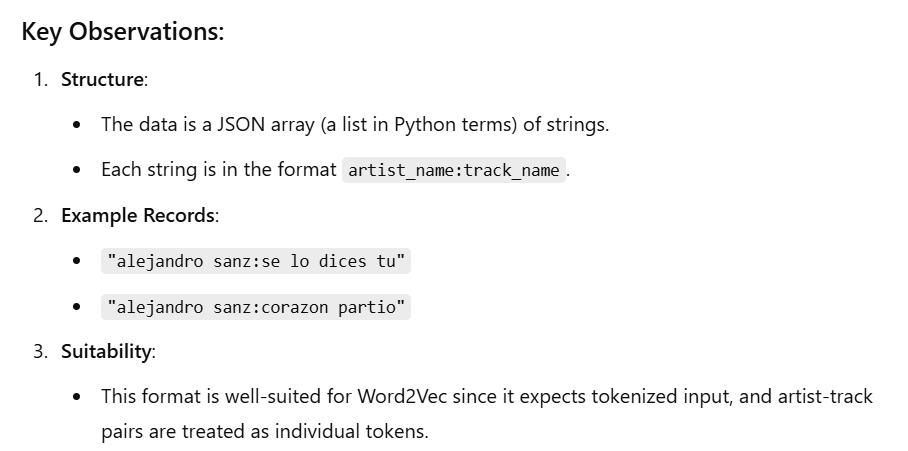

In [ ]:
from collections import Counter

# Flatten the nested list
flattened_data = [item for sublist in data for item in sublist]

# Analyze the JSON data
print(f"Total tokens in the file: {len(flattened_data)}")

# Split artist:track for deeper analysis
artist_track_pairs = [item.split(':') for item in flattened_data]
artists = [pair[0] for pair in artist_track_pairs]
tracks = [pair[1] for pair in artist_track_pairs]

# Analyze top artists
artist_counts = Counter(artists).most_common(10)
print("Top 10 artists:")
for artist, count in artist_counts:
    print(f"{artist}: {count} tracks")

# Analyze top tracks
track_counts = Counter(tracks).most_common(10)
print("Top 10 tracks:")
for track, count in track_counts:
    print(f"{track}: {count}")


Total tokens in the file: 2247573
Top 10 artists:
sonata arctica: 73640 tracks
judas priest: 67124 tracks
def leppard: 58461 tracks
beastie boys: 57969 tracks
bruce springsteen: 51936 tracks
dj vadim: 46046 tracks
within temptation: 40112 tracks
rush: 37885 tracks
marilyn manson: 37401 tracks
rage: 35427 tracks
Top 10 tracks:
intro: 1609
love: 1087
untitled: 1044
angel: 987
prelude: 968
broken: 879
fullmoon: 866
land of the free: 860
dont say a word: 840
the promise: 838


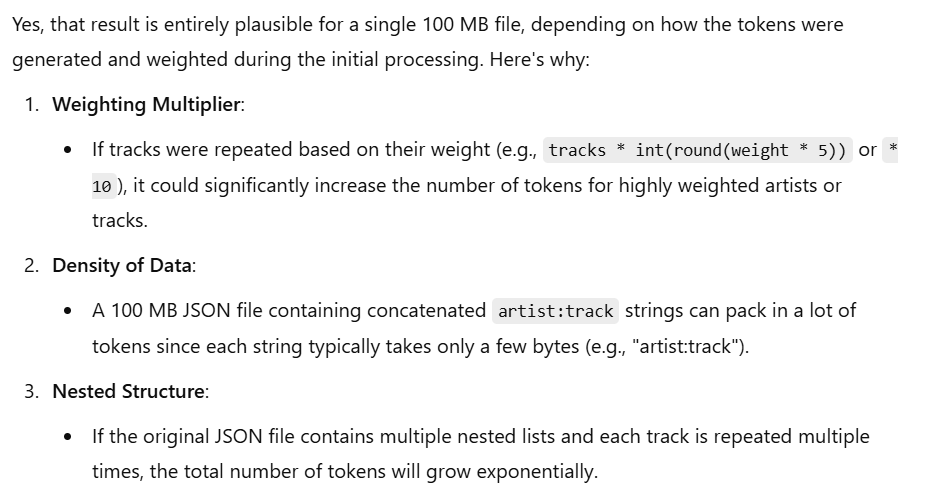

In [ ]:
total_size = sum(len(item) for sublist in data for item in sublist)
print(f"Total size of tokens in characters: {total_size} bytes")


Total size of tokens in characters: 73469460 bytes


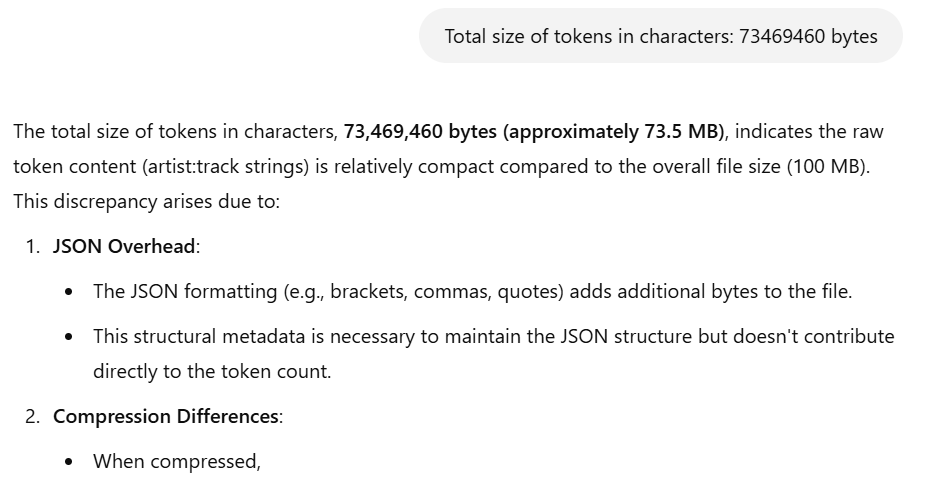

# Training Model WORD2VEC with 80% of the tokens

In [ ]:
import os
import zipfile
import json
from gensim.models import Word2Vec

# Updated Paths
train_zips_dir = '/content/500MB_train_zips'  # Updated directory for training ZIPs
checkpoint_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/'  # Directory to save model checkpoints
os.makedirs(checkpoint_dir, exist_ok=True)

# Parameters for Word2Vec
word2vec_params = {
    'vector_size': 100,  # Embedding dimensions
    'window': 5,         # Context window size
    'min_count': 2,      # Minimum word frequency
    'workers': 4,        # Number of CPU cores for parallelization
    'sg': 1,             # Skip-gram method (set to 0 for CBOW)
}

# Check for existing checkpoints
latest_checkpoint = None
if os.listdir(checkpoint_dir):
    latest_checkpoint = max(
        [os.path.join(checkpoint_dir, f) for f in os.listdir(checkpoint_dir) if f.endswith('.model')],
        key=os.path.getctime
    )

# Load or initialize the model
if latest_checkpoint:
    print(f"Resuming training from checkpoint: {latest_checkpoint}")
    model = Word2Vec.load(latest_checkpoint)
else:
    print("No checkpoints found. Initializing a new Word2Vec model...")
    model = Word2Vec(**word2vec_params)

# Training loop
print("Starting training...")
for zip_file in sorted(os.listdir(train_zips_dir)):
    zip_path = os.path.join(train_zips_dir, zip_file)

    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        for json_file in sorted(zip_ref.namelist()):
            print(f"  Loading JSON file: {json_file}...")

            # Extract and load the JSON file
            with zip_ref.open(json_file) as f:
                tokens = json.load(f)

            # Ensure the model's vocabulary is built or updated
            if not model.wv:
                print("  Building vocabulary...")
                model.build_vocab(tokens)
            else:
                print("  Updating vocabulary...")
                model.build_vocab(tokens, update=True)

            # Train the model on the current batch of tokens
            print("  Training model on current batch...")
            model.train(
                tokens,
                total_examples=model.corpus_count,
                epochs=model.epochs
            )

            # Save a checkpoint after each JSON file
            checkpoint_path = os.path.join(checkpoint_dir, f"word2vec_checkpoint_{zip_file}_{json_file}.model")
            model.save(checkpoint_path)
            print(f"  Checkpoint saved: {checkpoint_path}")

print("Training completed.")


No checkpoints found. Initializing a new Word2Vec model...
Starting training...
Processing ZIP file: chunked_zip_1.zip...
  Loading JSON file: artist_tokens_chunk_modified_15_chunk_1.json...
  Building vocabulary...
  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_1.zip_artist_tokens_chunk_modified_15_chunk_1.json.model
  Loading JSON file: artist_tokens_chunk_modified_15_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_1.zip_artist_tokens_chunk_modified_15_chunk_2.json.model
  Loading JSON file: artist_tokens_chunk_modified_15_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_1.zip_artist_tokens_chunk_modified_15_chunk_3.json.model
  Loading JSON file: artist_tokens_chunk_modified_15_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_1.zip_artist_tokens_chunk_modified_15_chunk_4.json.model
  Loading JSON file: artist_tokens_chunk_modified_15_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_1.zip_artist_tokens_chunk_modified_15_chunk_5.json.model
Processing ZIP file: chunked_zip_10.zip...
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_10.zip_artist_tokens_chunk_modified_2_chunk_2.json.model
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_10.zip_artist_tokens_chunk_modified_2_chunk_3.json.model
Processing ZIP file: chunked_zip_11.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_11.zip_artist_tokens_chunk_modified_6_chunk_1.json.model
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_11.zip_artist_tokens_chunk_modified_6_chunk_2.json.model
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_11.zip_artist_tokens_chunk_modified_6_chunk_3.json.model
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_11.zip_artist_tokens_chunk_modified_6_chunk_4.json.model
Processing ZIP file: chunked_zip_12.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_12.zip_artist_tokens_chunk_modified_6_chunk_5.json.model
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_12.zip_artist_tokens_chunk_modified_7_chunk_1.json.model
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_12.zip_artist_tokens_chunk_modified_7_chunk_2.json.model
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_12.zip_artist_tokens_chunk_modified_7_chunk_3.json.model
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_12.zip_artist_tokens_chunk_modified_7_chunk_4.json.model
Processing ZIP file: chunked_zip_14.zip...
  Loading JSON file: artist_tokens_chunk_modified_4_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_14.zip_artist_tokens_chunk_modified_4_chunk_3.json.model
  Loading JSON file: artist_tokens_chunk_modified_4_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_14.zip_artist_tokens_chunk_modified_4_chunk_4.json.model
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_14.zip_artist_tokens_chunk_modified_5_chunk_1.json.model
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_14.zip_artist_tokens_chunk_modified_5_chunk_2.json.model
Processing ZIP file: chunked_zip_15.zip...
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_15.zip_artist_tokens_chunk_modified_16_chunk_1.json.model
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_15.zip_artist_tokens_chunk_modified_5_chunk_3.json.model
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_15.zip_artist_tokens_chunk_modified_5_chunk_4.json.model
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_15.zip_artist_tokens_chunk_modified_5_chunk_5.json.model
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_15.zip_artist_tokens_chunk_modified_5_chunk_6.json.model
Processing ZIP file: chunked_zip_16.zip...
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_16.zip_artist_tokens_chunk_modified_12_chunk_1.json.model
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_16.zip_artist_tokens_chunk_modified_16_chunk_2.json.model
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_16.zip_artist_tokens_chunk_modified_16_chunk_3.json.model
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_16.zip_artist_tokens_chunk_modified_16_chunk_4.json.model
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_16.zip_artist_tokens_chunk_modified_16_chunk_5.json.model
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_16.zip_artist_tokens_chunk_modified_16_chunk_6.json.model
Processing ZIP file: chunked_zip_2.zip...
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_2.zip_artist_tokens_chunk_modified_10_chunk_1.json.model
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_2.zip_artist_tokens_chunk_modified_10_chunk_2.json.model
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_2.zip_artist_tokens_chunk_modified_10_chunk_3.json.model
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_2.zip_artist_tokens_chunk_modified_10_chunk_4.json.model
  Loading JSON file: artist_tokens_chunk_modified_15_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_2.zip_artist_tokens_chunk_modified_15_chunk_6.json.model
Processing ZIP file: chunked_zip_20.zip...
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_20.zip_artist_tokens_chunk_modified_18_chunk_2.json.model
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_20.zip_artist_tokens_chunk_modified_18_chunk_3.json.model
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_20.zip_artist_tokens_chunk_modified_18_chunk_4.json.model
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_20.zip_artist_tokens_chunk_modified_18_chunk_5.json.model
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_20.zip_artist_tokens_chunk_modified_18_chunk_6.json.model
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_20.zip_artist_tokens_chunk_modified_9_chunk_1.json.model
Processing ZIP file: chunked_zip_21.zip...
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_21.zip_artist_tokens_chunk_modified_9_chunk_2.json.model
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_21.zip_artist_tokens_chunk_modified_9_chunk_3.json.model
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_21.zip_artist_tokens_chunk_modified_9_chunk_4.json.model
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_21.zip_artist_tokens_chunk_modified_9_chunk_5.json.model
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_21.zip_artist_tokens_chunk_modified_9_chunk_6.json.model
Processing ZIP file: chunked_zip_3.zip...
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_3.zip_artist_tokens_chunk_modified_10_chunk_5.json.model
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_3.zip_artist_tokens_chunk_modified_8_chunk_1.json.model
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_3.zip_artist_tokens_chunk_modified_8_chunk_2.json.model
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_3.zip_artist_tokens_chunk_modified_8_chunk_3.json.model
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_3.zip_artist_tokens_chunk_modified_8_chunk_4.json.model
Processing ZIP file: chunked_zip_4.zip...
  Loading JSON file: artist_tokens_chunk_modified_11_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_4.zip_artist_tokens_chunk_modified_11_chunk_1.json.model
  Loading JSON file: artist_tokens_chunk_modified_11_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_4.zip_artist_tokens_chunk_modified_11_chunk_2.json.model
  Loading JSON file: artist_tokens_chunk_modified_11_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_4.zip_artist_tokens_chunk_modified_11_chunk_3.json.model
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_4.zip_artist_tokens_chunk_modified_8_chunk_5.json.model
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_4.zip_artist_tokens_chunk_modified_8_chunk_6.json.model
Processing ZIP file: chunked_zip_5.zip...
  Loading JSON file: artist_tokens_chunk_modified_11_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_5.zip_artist_tokens_chunk_modified_11_chunk_4.json.model
  Loading JSON file: artist_tokens_chunk_modified_11_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_5.zip_artist_tokens_chunk_modified_11_chunk_5.json.model
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_5.zip_artist_tokens_chunk_modified_14_chunk_1.json.model
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_5.zip_artist_tokens_chunk_modified_14_chunk_2.json.model
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_5.zip_artist_tokens_chunk_modified_14_chunk_3.json.model
Processing ZIP file: chunked_zip_6.zip...
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_6.zip_artist_tokens_chunk_modified_14_chunk_4.json.model
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_6.zip_artist_tokens_chunk_modified_14_chunk_5.json.model
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_6.zip_artist_tokens_chunk_modified_14_chunk_6.json.model
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_6.zip_artist_tokens_chunk_modified_1_chunk_1.json.model
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_6.zip_artist_tokens_chunk_modified_1_chunk_2.json.model
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_6.zip_artist_tokens_chunk_modified_1_chunk_3.json.model
Processing ZIP file: chunked_zip_8.zip...
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_8.zip_artist_tokens_chunk_modified_13_chunk_3.json.model
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_8.zip_artist_tokens_chunk_modified_13_chunk_4.json.model
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_8.zip_artist_tokens_chunk_modified_13_chunk_5.json.model
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_8.zip_artist_tokens_chunk_modified_17_chunk_1.json.model
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_8.zip_artist_tokens_chunk_modified_17_chunk_2.json.model
Processing ZIP file: chunked_zip_9.zip...
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_9.zip_artist_tokens_chunk_modified_17_chunk_3.json.model
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_9.zip_artist_tokens_chunk_modified_17_chunk_4.json.model
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
  Checkpoint saved: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_9.zip_artist_tokens_chunk_modified_2_chunk_1.json.model
Training completed.


In [ ]:
import os

checkpoint_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/'
checkpoints = sorted(
    [os.path.join(checkpoint_dir, f) for f in os.listdir(checkpoint_dir) if f.endswith('.model')],
    key=os.path.getctime
)

if checkpoints:
    latest_checkpoint = checkpoints[-1]
    print(f"Latest checkpoint: {latest_checkpoint}")
else:
    print("No checkpoints found.")


Latest checkpoint: /content/drive/MyDrive/Final Project DATA SCIENCE/checkpoints/word2vec_checkpoint_chunked_zip_9.zip_artist_tokens_chunk_modified_2_chunk_1.json.model


I have created a zipped_checkpoints.zip file for all the checkpoints saved during the process. Only about half the chunks are in it. There was a problem with storage on drive (exceeded limit) so i choose to drop saving checkpoints and run the training model again and save only the last checkpoint which is the completed trained model (word2vec).

# Training model WORD2VEC on seed saved in '500MB_train_zips' folder in my drive (2nd attempt to get full trained model)

In [ ]:
import os
import zipfile
import json
from gensim.models import Word2Vec

# Paths
train_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_train_zips' # Directory containing training ZIPs
final_model_path = '/content/drive/MyDrive/Final Project DATA SCIENCE/final_word2vec_model.model'  # Path to save the final trained model

# Parameters for Word2Vec
word2vec_params = {
    'vector_size': 100,  # Embedding dimensions
    'window': 5,         # Context window size
    'min_count': 2,      # Minimum word frequency
    'workers': 4,        # Number of CPU cores for parallelization
    'sg': 1,             # Skip-gram method (set to 0 for CBOW)
}

# Initialize a new Word2Vec model
print("Initializing a new Word2Vec model...")
model = Word2Vec(**word2vec_params)

# Training loop
print("Starting training...")
for zip_file in sorted(os.listdir(train_zips_dir)):
    zip_path = os.path.join(train_zips_dir, zip_file)

    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        for json_file in sorted(zip_ref.namelist()):
            print(f"  Loading JSON file: {json_file}...")

            # Extract and load the JSON file
            with zip_ref.open(json_file) as f:
                tokens = json.load(f)

            # Ensure the model's vocabulary is built or updated
            if not model.wv.key_to_index:
                print("  Building vocabulary...")
                model.build_vocab(tokens)
            else:
                print("  Updating vocabulary...")
                model.build_vocab(tokens, update=True)

            # Train the model on the current batch of tokens
            print("  Training model on current batch...")
            model.train(
                tokens,
                total_examples=model.corpus_count,
                epochs=model.epochs
            )

print("Training completed.")

# Save the final model
model.save(final_model_path)
print(f"Final model saved at: {final_model_path}")


Initializing a new Word2Vec model...
Starting training...


FileNotFoundError: [Errno 2] No such file or directory: '/content/500MB_train_zips/'

# Training model WORD2VEC on seed saved in '500MB_train_zips' folder in my drive (3rd attempt, the 2nd worked but i got that now i need to monitor loss function)

In [ ]:
import os
import zipfile
import json
from gensim.models import Word2Vec
from gensim.models.callbacks import CallbackAny2Vec
import matplotlib.pyplot as plt

# Paths
train_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_train_zips' # Directory containing training ZIPs
final_model_path = '/content/drive/MyDrive/Final Project DATA SCIENCE/final_word2vec_model.model'  # Path to save the final trained model

# Parameters for Word2Vec
word2vec_params = {
    'vector_size': 100,  # Embedding dimensions
    'window': 5,         # Context window size
    'min_count': 2,      # Minimum word frequency
    'workers': 4,        # Number of CPU cores for parallelization
    'sg': 1,             # Skip-gram method (set to 0 for CBOW)
}

# Custom LossLogger callback to track and log loss
class LossLogger(CallbackAny2Vec):
    def __init__(self):
        self.epoch = 0
        self.losses = []

    def on_epoch_end(self, model):
        loss = model.get_latest_training_loss()
        self.losses.append(loss)
        print(f"Epoch {self.epoch}: Loss = {loss:.4f}")
        self.epoch += 1

loss_logger = LossLogger()

# Initialize a new Word2Vec model
print("Initializing a new Word2Vec model...")
model = Word2Vec(**word2vec_params)

# Training loop
print("Starting training...")
for zip_file in sorted(os.listdir(train_zips_dir)):
    zip_path = os.path.join(train_zips_dir, zip_file)

    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        for json_file in sorted(zip_ref.namelist()):
            print(f"  Loading JSON file: {json_file}...")

            # Extract and load the JSON file
            with zip_ref.open(json_file) as f:
                tokens = json.load(f)

            # Ensure the model's vocabulary is built or updated
            if not model.wv.key_to_index:
                print("  Building vocabulary...")
                model.build_vocab(tokens)
            else:
                print("  Updating vocabulary...")
                model.build_vocab(tokens, update=True)

            # Train the model with explicit callback for loss logging
            print("  Training model on current batch...")
            model.train(
                tokens,
                total_examples=model.corpus_count,
                epochs=5,  # Train for a fixed number of epochs
                compute_loss=True,
                callbacks=[loss_logger]  # Attach the LossLogger
            )

print("Training completed.")

# Save the final model
model.save(final_model_path)
print(f"Final model saved at: {final_model_path}")

# Visualize the loss values
plt.plot(loss_logger.losses, label='Loss')
plt.xlabel('Epoch')
plt.ylabel('Training Loss')
plt.title('Convergence of Word2Vec Training')
plt.legend()
plt.show()


Initializing a new Word2Vec model...
Starting training...
Processing ZIP file: chunked_zip_10.zip...
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_2.json...
  Building vocabulary...
  Training model on current batch...
Epoch 0: Loss = 254578.5000
Epoch 1: Loss = 515858.0000
Epoch 2: Loss = 763494.8750
Epoch 3: Loss = 1010150.6250
Epoch 4: Loss = 1274845.3750
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 5: Loss = 3411332.0000
Epoch 6: Loss = 5738966.0000
Epoch 7: Loss = 7264876.0000
Epoch 8: Loss = 8514499.0000
Epoch 9: Loss = 9185565.0000
Processing ZIP file: chunked_zip_11.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 10: Loss = 3987974.5000
Epoch 11: Loss = 5789548.5000
Epoch 12: Loss = 7102132.0000
Epoch 13: Loss = 8110771.5000
Epoch 14: Loss = 8737548.0000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 15: Loss = 3995856.0000
Epoch 16: Loss = 6148703.5000
Epoch 17: Loss = 7653308.0000
Epoch 18: Loss = 8763368.0000
Epoch 19: Loss = 9472937.0000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 20: Loss = 2080152.1250
Epoch 21: Loss = 3247502.7500
Epoch 22: Loss = 4308240.0000
Epoch 23: Loss = 5266112.5000
Epoch 24: Loss = 6098164.0000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 25: Loss = 128663.8203
Epoch 26: Loss = 225205.0312
Epoch 27: Loss = 314683.1875
Epoch 28: Loss = 400665.3438
Epoch 29: Loss = 485228.4375
Processing ZIP file: chunked_zip_12.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 30: Loss = 2384076.0000
Epoch 31: Loss = 3545849.2500
Epoch 32: Loss = 4399979.0000
Epoch 33: Loss = 5188484.5000
Epoch 34: Loss = 5945733.5000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 35: Loss = 1585965.7500
Epoch 36: Loss = 2354236.5000
Epoch 37: Loss = 2988690.7500
Epoch 38: Loss = 3553286.7500
Epoch 39: Loss = 4049340.0000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 40: Loss = 1527548.6250
Epoch 41: Loss = 2218178.2500
Epoch 42: Loss = 2791267.0000
Epoch 43: Loss = 3250896.7500
Epoch 44: Loss = 3777821.0000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 45: Loss = 2133672.7500
Epoch 46: Loss = 3373273.7500
Epoch 47: Loss = 4399726.0000
Epoch 48: Loss = 5281922.0000
Epoch 49: Loss = 6100007.5000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_4.json...
  Updating vocabulary...


KeyboardInterrupt: 

In [ ]:
import os
import zipfile
import json
from gensim.models import Word2Vec
from gensim.models.callbacks import CallbackAny2Vec
import matplotlib.pyplot as plt

# Callback to track loss during training
class LossLogger(CallbackAny2Vec):
    def __init__(self):
        self.epoch = 0
        self.losses = []

    def on_epoch_end(self, model):
        loss = model.get_latest_training_loss()
        if self.epoch == 0:
            self.losses.append(loss)
        else:
            self.losses.append(loss - sum(self.losses))
        print(f'Epoch {self.epoch}: Loss = {self.losses[-1]}')
        self.epoch += 1

# Paths
train_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_train_zips'  # Directory containing training ZIPs
final_model_path = '/content/drive/MyDrive/Final Project DATA SCIENCE/final2_word2vec_model.model'  # Path to save the final trained model

# Parameters for Word2Vec
word2vec_params = {
    'vector_size': 100,  # Embedding dimensions
    'window': 5,         # Context window size
    'min_count': 2,      # Minimum word frequency
    'workers': 4,        # Number of CPU cores for parallelization
    'sg': 1,             # Skip-gram method (set to 0 for CBOW)
    'compute_loss': True # Enable loss computation
}

# Initialize a new Word2Vec model
print("Initializing a new Word2Vec model...")
model = Word2Vec(**word2vec_params)

# Initialize loss logger
loss_logger = LossLogger()

# Training loop
print("Starting training...")
for zip_file in sorted(os.listdir(train_zips_dir)):
    zip_path = os.path.join(train_zips_dir, zip_file)

    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        token_batches = []
        for json_file in sorted(zip_ref.namelist()):
            print(f"  Loading JSON file: {json_file}...")

            # Extract and load the JSON file
            with zip_ref.open(json_file) as f:
                tokens = json.load(f)
                token_batches.append(tokens)

        # Flatten the token_batches into a list of sentences
        flattened_tokens = [sentence for batch in token_batches for sentence in batch]

        # Build or update the vocabulary
        if not model.wv.key_to_index:
            print("  Building vocabulary...")
            model.build_vocab(flattened_tokens, progress_per=1000)
        else:
            print("  Updating vocabulary...")
            model.build_vocab(flattened_tokens, update=True, progress_per=1000)

        # Train the model on the current batch of tokens
        print("  Training model on current batch...")
        model.train(
            flattened_tokens,
            total_examples=model.corpus_count,
            epochs=5,
            callbacks=[loss_logger]
        )

print("Training completed.")

# Save the final model
model.save(final_model_path)
print(f"Final model saved at: {final_model_path}")

# Plot the loss
plt.plot(loss_logger.losses)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss per Epoch')
plt.show()


Initializing a new Word2Vec model...
Starting training...
Processing ZIP file: chunked_zip_10.zip...
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_2.json...
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_3.json...
  Building vocabulary...
  Training model on current batch...
Epoch 0: Loss = 0.0
Epoch 1: Loss = 0.0
Epoch 2: Loss = 0.0
Epoch 3: Loss = 0.0
Epoch 4: Loss = 0.0
Processing ZIP file: chunked_zip_11.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_1.json...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_2.json...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_3.json...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 5: Loss = 0.0
Epoch 6: Loss = 0.0
Epoch 7: Loss = 0.0
Epoch 8: Loss = 0.0
Epoch 9: Loss = 0.0
Processing ZIP file: chunked_zip_12.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_5.json...


Exception ignored in: <function _xla_gc_callback at 0x788ef6384ea0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/jax/_src/lib/__init__.py", line 96, in _xla_gc_callback
    def _xla_gc_callback(*args):
    
KeyboardInterrupt: 


  Loading JSON file: artist_tokens_chunk_modified_7_chunk_1.json...
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_2.json...
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_3.json...


Exception ignored in: <function _xla_gc_callback at 0x788ef6384ea0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/jax/_src/lib/__init__.py", line 97, in _xla_gc_callback
    xla_client._xla.collect_garbage()
KeyboardInterrupt: 


  Loading JSON file: artist_tokens_chunk_modified_7_chunk_4.json...
  Updating vocabulary...


KeyboardInterrupt: 

In [ ]:
import os
import zipfile
import json
from gensim.models import Word2Vec
from gensim.models.callbacks import CallbackAny2Vec
import matplotlib.pyplot as plt

# Paths
train_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_train_zips'  # Directory containing training ZIPs
final_model_path = '/content/drive/MyDrive/Final Project DATA SCIENCE/final2_word2vec_model.model'  # Path to save the final trained model

# Parameters for Word2Vec
word2vec_params = {
    'vector_size': 150,  # Adjust embedding dimensions for better learning
    'window': 10,        # Context window size
    'min_count': 1,      # Include rare words
    'workers': 4,        # Number of CPU cores for parallelization
    'sg': 1,             # Skip-gram method (set to 0 for CBOW)
    'epochs': 10         # Number of epochs for each training batch
}

# Custom LossLogger callback to track and log loss
class LossLogger(CallbackAny2Vec):
    def __init__(self):
        self.epoch = 0
        self.losses = []

    def on_epoch_end(self, model):
        loss = model.get_latest_training_loss()
        self.losses.append(loss)
        print(f"Epoch {self.epoch}: Loss = {loss:.4f}")
        self.epoch += 1

loss_logger = LossLogger()

# Initialize a new Word2Vec model
print("Initializing a new Word2Vec model...")
model = Word2Vec(**word2vec_params)

# Training loop
print("Starting training...")
for zip_file in sorted(os.listdir(train_zips_dir)):
    zip_path = os.path.join(train_zips_dir, zip_file)

    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        for json_file in sorted(zip_ref.namelist()):
            print(f"  Loading JSON file: {json_file}...")

            # Extract and load the JSON file
            with zip_ref.open(json_file) as f:
                tokens = json.load(f)

            # Ensure the model's vocabulary is built or updated
            if not model.wv.key_to_index:
                print("  Building vocabulary...")
                model.build_vocab(tokens)
            else:
                print("  Updating vocabulary...")
                model.build_vocab(tokens, update=True)

            # Train the model with explicit callback for loss logging
            print("  Training model on current batch...")
            model.train(
                tokens,
                total_examples=model.corpus_count,
                epochs=word2vec_params['epochs'],  # Train for a fixed number of epochs
                compute_loss=True,
                callbacks=[loss_logger]  # Attach the LossLogger
            )

print("Training completed.")

# Save the final model
model.save(final_model_path)
print(f"Final model saved at: {final_model_path}")

# Visualize the loss values
plt.plot(loss_logger.losses, label='Loss')
plt.xlabel('Epoch')
plt.ylabel('Training Loss')
plt.title('Convergence of Word2Vec Training')
plt.legend()
plt.show()


Initializing a new Word2Vec model...
Starting training...
Processing ZIP file: chunked_zip_10.zip...
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_2.json...
  Building vocabulary...
  Training model on current batch...
Epoch 0: Loss = 468099.3438
Epoch 1: Loss = 923659.1250
Epoch 2: Loss = 1365136.5000
Epoch 3: Loss = 1703049.0000
Epoch 4: Loss = 2004942.8750
Epoch 5: Loss = 2321982.7500
Epoch 6: Loss = 2649268.5000
Epoch 7: Loss = 2966803.7500
Epoch 8: Loss = 3277658.0000
Epoch 9: Loss = 3585451.2500
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 10: Loss = 3811568.2500
Epoch 11: Loss = 5701463.0000
Epoch 12: Loss = 6827002.0000
Epoch 13: Loss = 7600000.5000
Epoch 14: Loss = 8042827.0000
Epoch 15: Loss = 8321600.0000
Epoch 16: Loss = 8498845.0000
Epoch 17: Loss = 8667851.0000
Epoch 18: Loss = 8813933.0000
Epoch 19: Loss = 8950102.0000
Processing ZIP file: chunked_zip_11.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 20: Loss = 3966941.7500
Epoch 21: Loss = 5360460.0000
Epoch 22: Loss = 6082648.5000
Epoch 23: Loss = 6547227.5000
Epoch 24: Loss = 6884388.5000
Epoch 25: Loss = 7097509.5000
Epoch 26: Loss = 7277281.5000
Epoch 27: Loss = 7432300.5000
Epoch 28: Loss = 7586365.0000
Epoch 29: Loss = 7743287.5000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 30: Loss = 3733685.2500


KeyboardInterrupt: 

# Explanations using epochs and hyperparameters snapshots

## From the 3rd attempt we understand epochs are **not** converging:

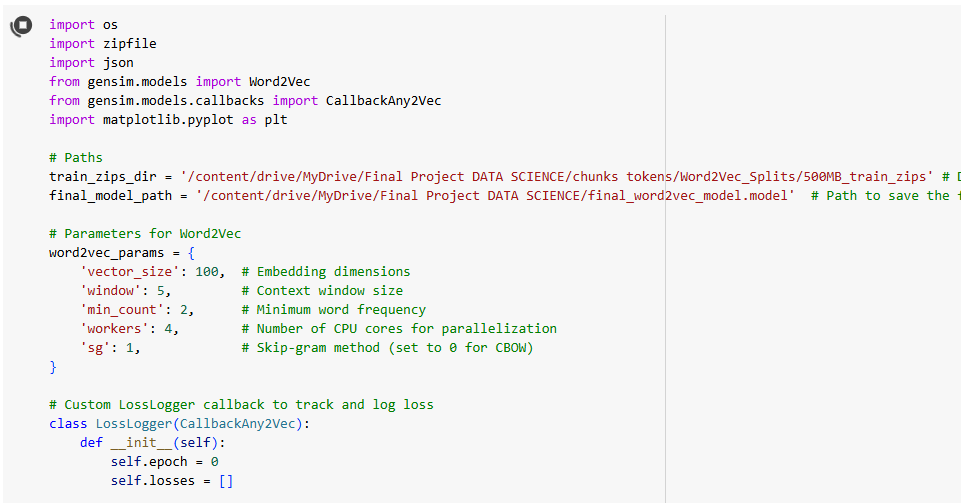

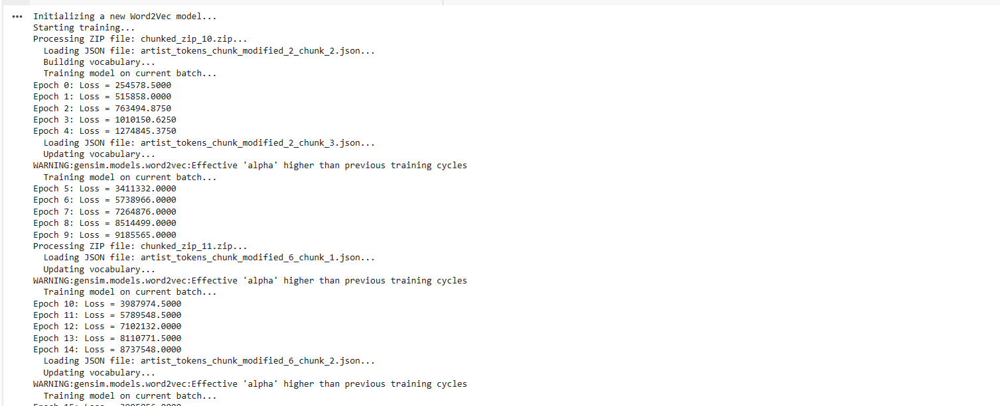

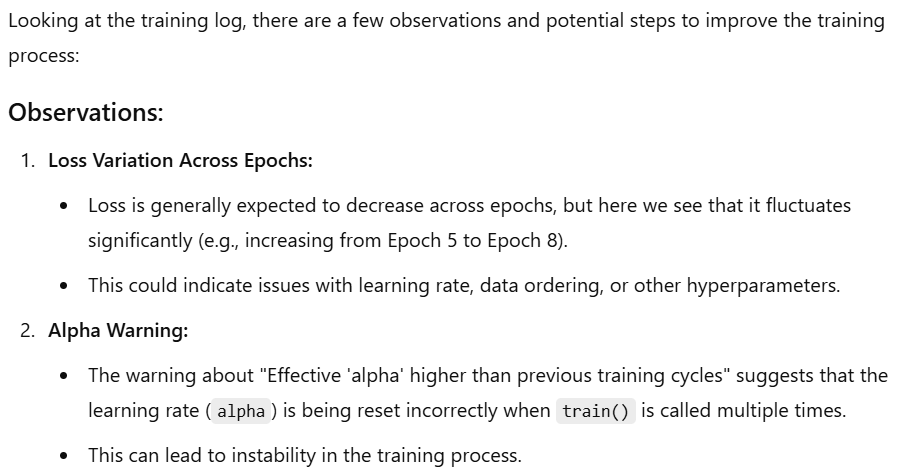

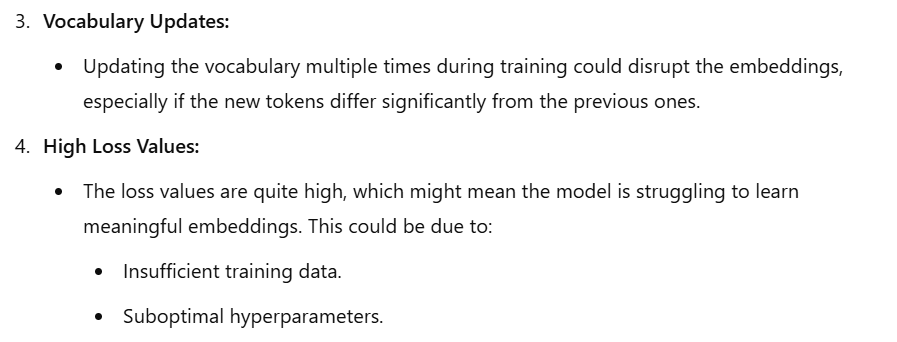

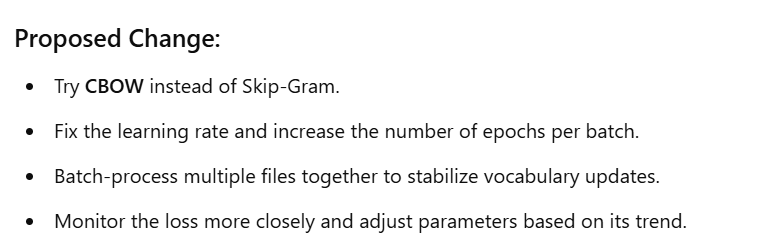

## So in the code after that, we try to implement the proposed changed but then all **epochs are 0** :

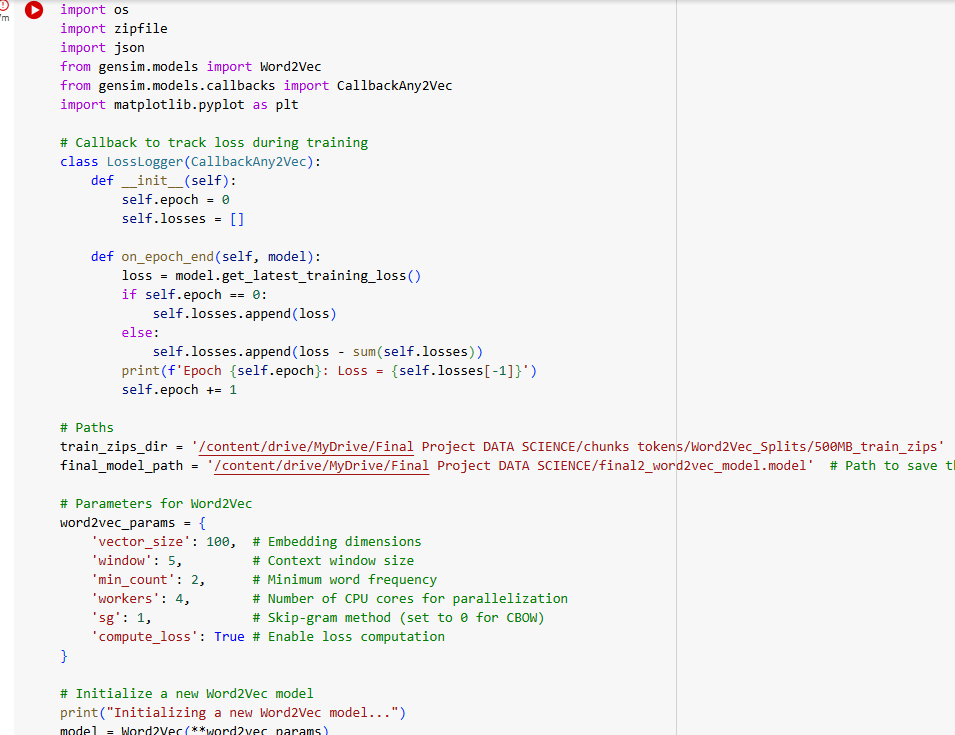

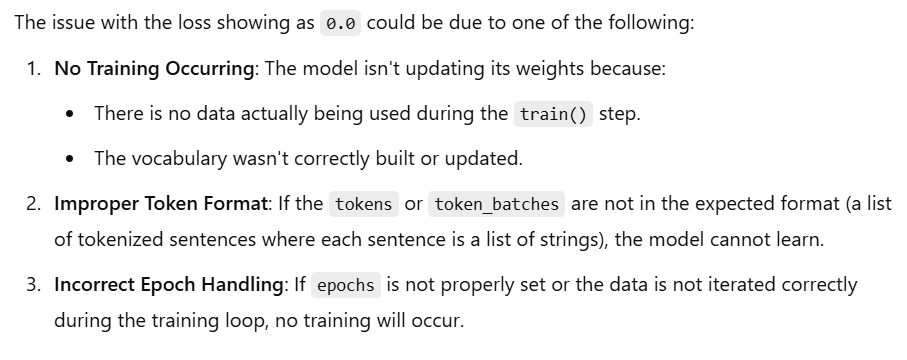

## Back to original attempt with a refined hyper parameter tuning :

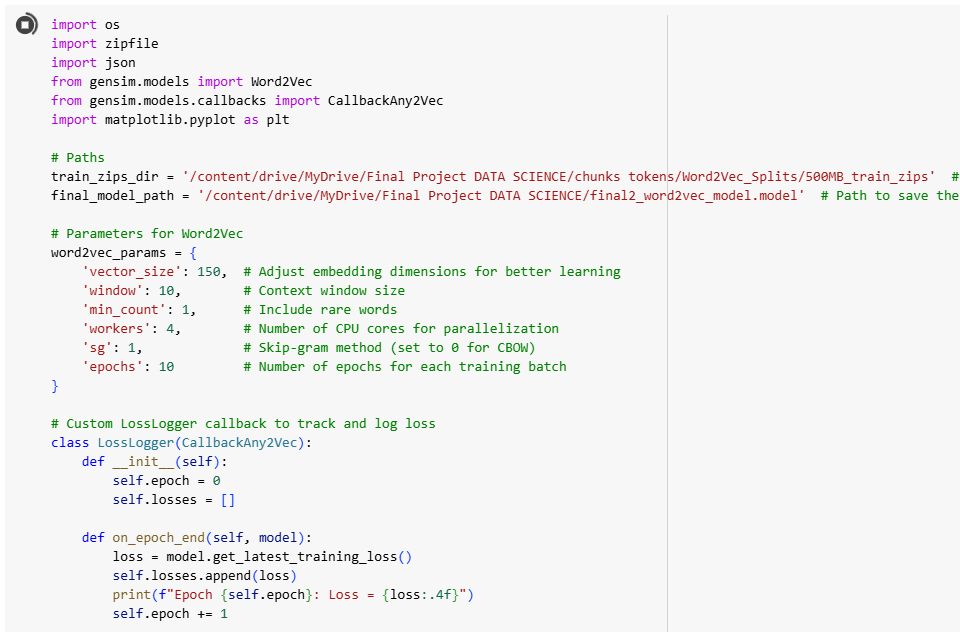

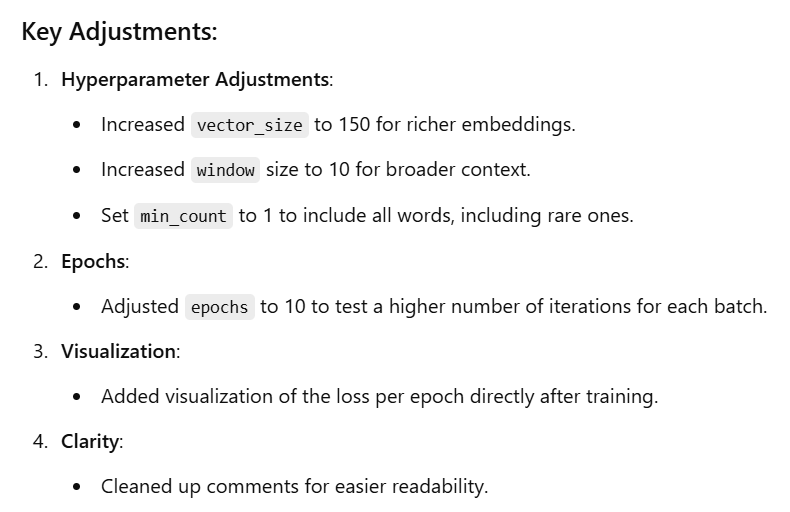

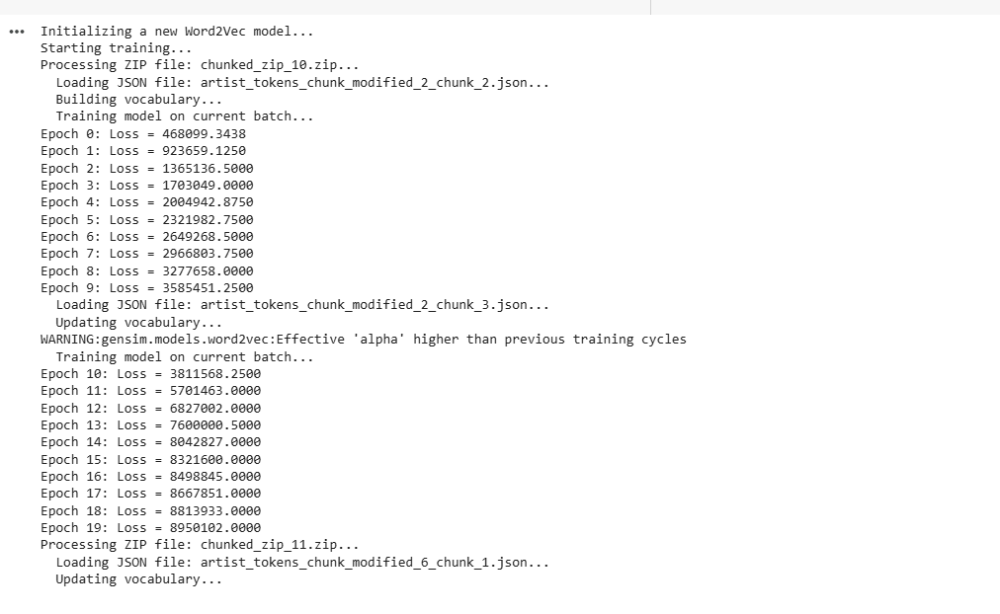

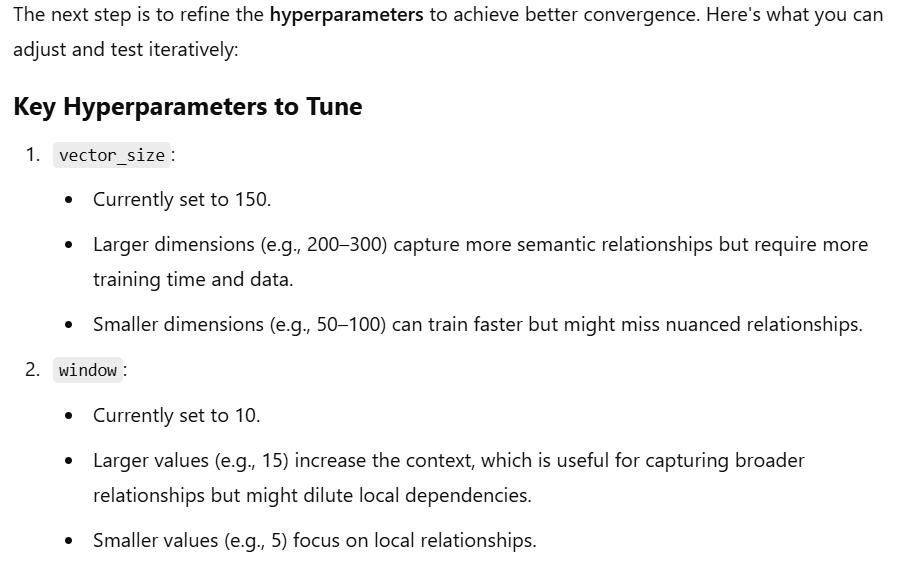

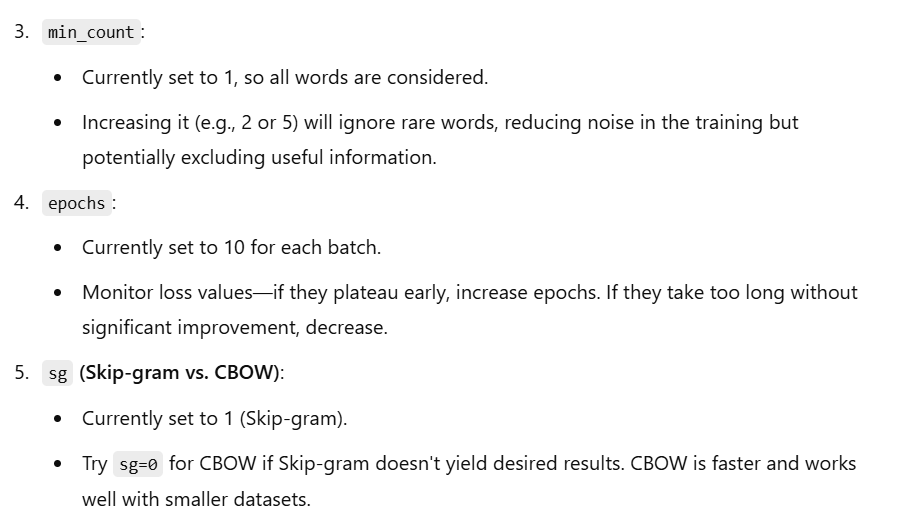

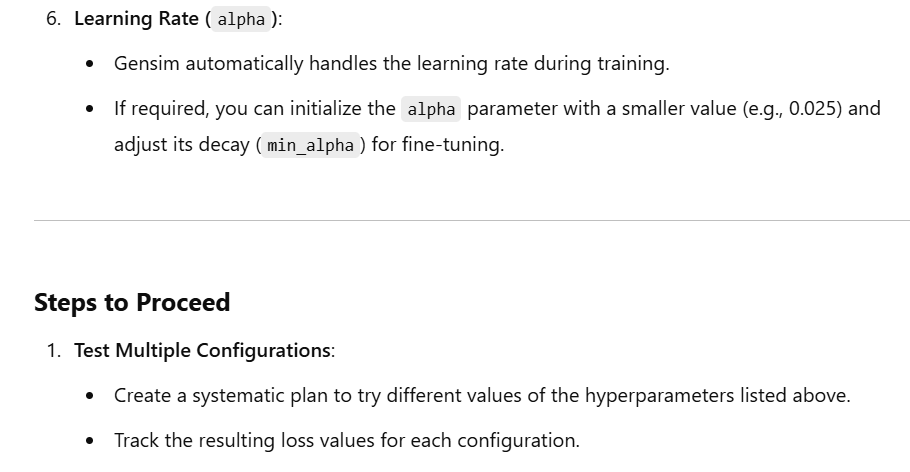

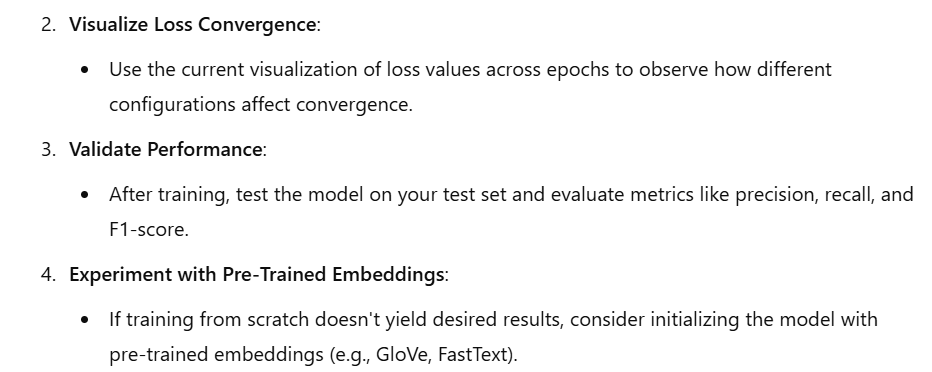

# WORD2VEC workflow for testing different hyper-parameters

## Training the 1st word2vec model - experiment num.1

Initializing a new Word2Vec model...
Starting training...
Processing ZIP file: chunked_zip_10.zip...
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_2.json...
  Building vocabulary...
  Training model on current batch...
Epoch 0: Loss = 254574.6875
Epoch 1: Loss = 515850.9375
Epoch 2: Loss = 763464.7500
Epoch 3: Loss = 1010105.3750
Epoch 4: Loss = 1274789.2500
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 5: Loss = 3485903.0000
Epoch 6: Loss = 5615548.5000
Epoch 7: Loss = 7281765.5000
Epoch 8: Loss = 8482238.0000
Epoch 9: Loss = 9195146.0000
Processing ZIP file: chunked_zip_11.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 10: Loss = 3798861.2500
Epoch 11: Loss = 5655886.0000
Epoch 12: Loss = 7185540.0000
Epoch 13: Loss = 8327013.0000
Epoch 14: Loss = 8947577.0000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 15: Loss = 3728438.7500
Epoch 16: Loss = 5660453.5000
Epoch 17: Loss = 7247829.0000
Epoch 18: Loss = 8525331.0000
Epoch 19: Loss = 9184456.0000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 20: Loss = 2144811.2500
Epoch 21: Loss = 3407329.2500
Epoch 22: Loss = 4400116.5000
Epoch 23: Loss = 5298925.5000
Epoch 24: Loss = 6240987.0000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 25: Loss = 128606.5156
Epoch 26: Loss = 224612.9688
Epoch 27: Loss = 313932.0938
Epoch 28: Loss = 399379.4375
Epoch 29: Loss = 483894.6250
Processing ZIP file: chunked_zip_12.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 30: Loss = 2186734.5000
Epoch 31: Loss = 3360923.2500
Epoch 32: Loss = 4347763.0000
Epoch 33: Loss = 5117259.0000
Epoch 34: Loss = 5859209.0000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 35: Loss = 1403617.5000
Epoch 36: Loss = 2244691.7500
Epoch 37: Loss = 2863175.0000
Epoch 38: Loss = 3398727.5000
Epoch 39: Loss = 3893420.0000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 40: Loss = 1419692.8750
Epoch 41: Loss = 2218713.0000
Epoch 42: Loss = 2768474.2500
Epoch 43: Loss = 3289251.2500
Epoch 44: Loss = 3772187.0000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 45: Loss = 2385531.7500
Epoch 46: Loss = 3608209.2500
Epoch 47: Loss = 4539329.0000
Epoch 48: Loss = 5439899.5000
Epoch 49: Loss = 6252618.0000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 50: Loss = 2098581.0000
Epoch 51: Loss = 3275561.7500
Epoch 52: Loss = 4190810.7500
Epoch 53: Loss = 4975450.5000
Epoch 54: Loss = 5737046.0000
Processing ZIP file: chunked_zip_14.zip...
  Loading JSON file: artist_tokens_chunk_modified_4_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 55: Loss = 127373.7812
Epoch 56: Loss = 244668.0156
Epoch 57: Loss = 357896.8438
Epoch 58: Loss = 469305.6562
Epoch 59: Loss = 578850.0000
  Loading JSON file: artist_tokens_chunk_modified_4_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 60: Loss = 1293938.5000
Epoch 61: Loss = 2010647.0000
Epoch 62: Loss = 2504164.5000
Epoch 63: Loss = 2996023.0000
Epoch 64: Loss = 3465084.2500
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 65: Loss = 1174199.0000
Epoch 66: Loss = 1814812.3750
Epoch 67: Loss = 2344089.0000
Epoch 68: Loss = 2787870.2500
Epoch 69: Loss = 3292221.7500
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 70: Loss = 697385.7500
Epoch 71: Loss = 1079656.3750
Epoch 72: Loss = 1373604.5000
Epoch 73: Loss = 1640058.3750
Epoch 74: Loss = 1909906.3750
Processing ZIP file: chunked_zip_15.zip...
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 75: Loss = 1487191.1250
Epoch 76: Loss = 2294023.2500
Epoch 77: Loss = 2905424.2500
Epoch 78: Loss = 3500698.7500
Epoch 79: Loss = 4053134.7500
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 80: Loss = 620020.5625
Epoch 81: Loss = 894383.3125
Epoch 82: Loss = 1201901.1250
Epoch 83: Loss = 1398405.1250
Epoch 84: Loss = 1598858.6250
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 85: Loss = 1020325.0000
Epoch 86: Loss = 1434053.5000
Epoch 87: Loss = 1784364.3750
Epoch 88: Loss = 2067712.1250
Epoch 89: Loss = 2319748.2500
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 90: Loss = 1358949.6250
Epoch 91: Loss = 1996594.5000
Epoch 92: Loss = 2524048.5000
Epoch 93: Loss = 2968580.2500
Epoch 94: Loss = 3424026.0000
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 95: Loss = 590189.9375
Epoch 96: Loss = 893598.5000
Epoch 97: Loss = 1135478.8750
Epoch 98: Loss = 1312871.2500
Epoch 99: Loss = 1494414.3750
Processing ZIP file: chunked_zip_16.zip...
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 100: Loss = 968102.3125
Epoch 101: Loss = 1478220.6250
Epoch 102: Loss = 1797069.8750
Epoch 103: Loss = 2093754.3750
Epoch 104: Loss = 2348967.2500
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 105: Loss = 1207219.2500
Epoch 106: Loss = 1827098.2500
Epoch 107: Loss = 2281916.5000
Epoch 108: Loss = 2656810.0000
Epoch 109: Loss = 2995490.0000
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 110: Loss = 1201767.3750
Epoch 111: Loss = 1836582.6250
Epoch 112: Loss = 2312684.0000
Epoch 113: Loss = 2764471.7500
Epoch 114: Loss = 3190429.0000
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 115: Loss = 1221892.6250
Epoch 116: Loss = 1905108.8750
Epoch 117: Loss = 2441687.0000
Epoch 118: Loss = 2893274.2500
Epoch 119: Loss = 3371718.2500
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 120: Loss = 1478716.8750
Epoch 121: Loss = 2258831.5000
Epoch 122: Loss = 2815393.2500
Epoch 123: Loss = 3390475.2500
Epoch 124: Loss = 3991913.2500
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 125: Loss = 21442.1465
Epoch 126: Loss = 27726.6523
Epoch 127: Loss = 32514.2988
Epoch 128: Loss = 36731.8398
Epoch 129: Loss = 40712.6172
Processing ZIP file: chunked_zip_17.zip...
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 130: Loss = 949159.1250
Epoch 131: Loss = 1463979.3750
Epoch 132: Loss = 1799484.0000
Epoch 133: Loss = 2168918.7500
Epoch 134: Loss = 2530709.2500
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 135: Loss = 1321999.2500
Epoch 136: Loss = 1919612.2500
Epoch 137: Loss = 2423167.7500
Epoch 138: Loss = 2792474.7500
Epoch 139: Loss = 3134082.0000
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_4.json...


  Updating vocabulary...
  Training model on current batch...
Epoch 140: Loss = 1314503.7500
Epoch 141: Loss = 1992770.0000
Epoch 142: Loss = 2489180.5000
Epoch 143: Loss = 2943912.2500
Epoch 144: Loss = 3364736.5000
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 145: Loss = 1395964.8750
Epoch 146: Loss = 2039805.6250
Epoch 147: Loss = 2560356.7500
Epoch 148: Loss = 2973554.2500
Epoch 149: Loss = 3381218.2500
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 150: Loss = 15629.3096
Epoch 151: Loss = 19646.6250
Epoch 152: Loss = 22990.5938
Epoch 153: Loss = 25798.8965
Epoch 154: Loss = 28590.3965
Processing ZIP file: chunked_zip_18.zip...
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 155: Loss = 877965.5625
Epoch 156: Loss = 1322286.3750
Epoch 157: Loss = 1671965.5000
Epoch 158: Loss = 2000179.8750
Epoch 159: Loss = 2276558.5000
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 160: Loss = 1156030.1250
Epoch 161: Loss = 1730164.7500
Epoch 162: Loss = 2182439.0000
Epoch 163: Loss = 2558334.5000
Epoch 164: Loss = 2917663.5000
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 165: Loss = 564622.6875
Epoch 166: Loss = 819691.6250
Epoch 167: Loss = 1059638.7500
Epoch 168: Loss = 1232841.6250
Epoch 169: Loss = 1419616.5000
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 170: Loss = 797520.8125
Epoch 171: Loss = 1162231.2500
Epoch 172: Loss = 1474601.8750
Epoch 173: Loss = 1810869.7500
Epoch 174: Loss = 2099773.5000
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 175: Loss = 929228.4375
Epoch 176: Loss = 1391346.7500
Epoch 177: Loss = 1715141.2500
Epoch 178: Loss = 1988041.3750
Epoch 179: Loss = 2239340.7500
Processing ZIP file: chunked_zip_19.zip...
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 180: Loss = 1143625.0000
Epoch 181: Loss = 1593644.1250
Epoch 182: Loss = 1960370.0000
Epoch 183: Loss = 2261530.2500
Epoch 184: Loss = 2550119.0000
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 185: Loss = 1053173.6250
Epoch 186: Loss = 1568958.3750
Epoch 187: Loss = 1968205.5000
Epoch 188: Loss = 2321956.5000
Epoch 189: Loss = 2642918.0000
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 190: Loss = 967572.0625
Epoch 191: Loss = 1347029.5000
Epoch 192: Loss = 1705183.1250
Epoch 193: Loss = 2012637.6250
Epoch 194: Loss = 2281772.0000
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 195: Loss = 851761.0625
Epoch 196: Loss = 1250565.5000
Epoch 197: Loss = 1582553.3750
Epoch 198: Loss = 1845073.2500
Epoch 199: Loss = 2102253.5000
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 200: Loss = 564776.5000
Epoch 201: Loss = 845821.6875
Epoch 202: Loss = 1075016.1250
Epoch 203: Loss = 1258523.0000
Epoch 204: Loss = 1437908.8750
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 205: Loss = 98057.9062
Epoch 206: Loss = 122399.8828
Epoch 207: Loss = 146784.6250
Epoch 208: Loss = 163693.0781
Epoch 209: Loss = 179826.5781
Processing ZIP file: chunked_zip_2.zip...
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 210: Loss = 974545.6875
Epoch 211: Loss = 1400510.0000
Epoch 212: Loss = 1705864.8750
Epoch 213: Loss = 1993037.6250
Epoch 214: Loss = 2216298.0000
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 215: Loss = 825016.0000
Epoch 216: Loss = 1182621.3750
Epoch 217: Loss = 1463681.6250
Epoch 218: Loss = 1709216.6250
Epoch 219: Loss = 1941441.6250
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 220: Loss = 896385.3125
Epoch 221: Loss = 1329073.3750
Epoch 222: Loss = 1633806.0000
Epoch 223: Loss = 1924843.6250
Epoch 224: Loss = 2176164.2500
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 225: Loss = 871487.5625
Epoch 226: Loss = 1252510.0000
Epoch 227: Loss = 1554246.3750
Epoch 228: Loss = 1830867.1250
Epoch 229: Loss = 2059334.3750
  Loading JSON file: artist_tokens_chunk_modified_15_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 230: Loss = 517285.0000
Epoch 231: Loss = 727667.5000
Epoch 232: Loss = 891506.2500
Epoch 233: Loss = 1025735.4375
Epoch 234: Loss = 1147554.0000
Processing ZIP file: chunked_zip_20.zip...
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 235: Loss = 781228.5000
Epoch 236: Loss = 1228347.1250
Epoch 237: Loss = 1519372.5000
Epoch 238: Loss = 1799248.8750
Epoch 239: Loss = 2116812.2500
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 240: Loss = 883951.0000
Epoch 241: Loss = 1265465.6250
Epoch 242: Loss = 1579759.6250
Epoch 243: Loss = 1864429.2500
Epoch 244: Loss = 2130421.5000
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 245: Loss = 843925.5625
Epoch 246: Loss = 1242908.7500
Epoch 247: Loss = 1544826.2500
Epoch 248: Loss = 1780448.6250
Epoch 249: Loss = 2053389.0000
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 250: Loss = 874010.8750
Epoch 251: Loss = 1278307.5000
Epoch 252: Loss = 1579817.8750
Epoch 253: Loss = 1846412.8750
Epoch 254: Loss = 2090710.6250
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 255: Loss = 27235.3066
Epoch 256: Loss = 36870.1758
Epoch 257: Loss = 43737.2422
Epoch 258: Loss = 49498.0977
Epoch 259: Loss = 54964.0273
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 260: Loss = 488275.2500
Epoch 261: Loss = 671042.0625
Epoch 262: Loss = 797643.3750
Epoch 263: Loss = 908195.4375
Epoch 264: Loss = 1030596.3125
Processing ZIP file: chunked_zip_21.zip...
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 265: Loss = 494384.8438
Epoch 266: Loss = 665788.8125
Epoch 267: Loss = 828048.6250
Epoch 268: Loss = 968974.2500
Epoch 269: Loss = 1081571.2500
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 270: Loss = 828698.0625
Epoch 271: Loss = 1212904.0000
Epoch 272: Loss = 1473229.0000
Epoch 273: Loss = 1726295.8750
Epoch 274: Loss = 1986679.2500
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 275: Loss = 821001.3750
Epoch 276: Loss = 1172739.6250
Epoch 277: Loss = 1436008.0000
Epoch 278: Loss = 1688612.0000
Epoch 279: Loss = 1901545.5000
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 280: Loss = 880779.1875
Epoch 281: Loss = 1222793.8750
Epoch 282: Loss = 1496087.2500
Epoch 283: Loss = 1746741.6250
Epoch 284: Loss = 1970807.2500
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 285: Loss = 219153.1719
Epoch 286: Loss = 315326.5000
Epoch 287: Loss = 401986.7812
Epoch 288: Loss = 479766.0625
Epoch 289: Loss = 557048.0625
Processing ZIP file: chunked_zip_3.zip...
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 290: Loss = 731350.5000
Epoch 291: Loss = 1065680.1250
Epoch 292: Loss = 1308866.0000
Epoch 293: Loss = 1506680.7500
Epoch 294: Loss = 1711648.3750
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 295: Loss = 436529.2500
Epoch 296: Loss = 654102.2500
Epoch 297: Loss = 834216.3125
Epoch 298: Loss = 977849.1875
Epoch 299: Loss = 1093032.7500
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 300: Loss = 895213.4375
Epoch 301: Loss = 1238626.0000
Epoch 302: Loss = 1601916.5000
Epoch 303: Loss = 1820911.1250
Epoch 304: Loss = 2053188.2500
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 305: Loss = 248979.7656
Epoch 306: Loss = 344898.5312
Epoch 307: Loss = 430430.0000
Epoch 308: Loss = 506140.7500
Epoch 309: Loss = 579596.8125
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 310: Loss = 236360.9375
Epoch 311: Loss = 371772.3438
Epoch 312: Loss = 492300.7188
Epoch 313: Loss = 560178.8750
Epoch 314: Loss = 654518.1250
Processing ZIP file: chunked_zip_6.zip...
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 315: Loss = 895414.3125
Epoch 316: Loss = 1268617.1250
Epoch 317: Loss = 1560626.0000
Epoch 318: Loss = 1798478.3750
Epoch 319: Loss = 2038221.1250
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 320: Loss = 330879.7500
Epoch 321: Loss = 539357.2500
Epoch 322: Loss = 707190.4375
Epoch 323: Loss = 852727.3125
Epoch 324: Loss = 996507.8750
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 325: Loss = 11950.4912
Epoch 326: Loss = 19246.4336
Epoch 327: Loss = 25488.4629
Epoch 328: Loss = 31259.2754
Epoch 329: Loss = 36955.8672
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 330: Loss = 215010.0938
Epoch 331: Loss = 322298.0312
Epoch 332: Loss = 404442.9688
Epoch 333: Loss = 470182.9062
Epoch 334: Loss = 530773.0000
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 335: Loss = 91930.0938
Epoch 336: Loss = 144288.3750
Epoch 337: Loss = 185601.4688
Epoch 338: Loss = 221268.7344
Epoch 339: Loss = 254107.5469
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 340: Loss = 799654.9375
Epoch 341: Loss = 1164494.7500
Epoch 342: Loss = 1441727.7500
Epoch 343: Loss = 1692753.7500
Epoch 344: Loss = 1928500.5000
Processing ZIP file: chunked_zip_8.zip...
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 345: Loss = 866058.0000
Epoch 346: Loss = 1221104.8750
Epoch 347: Loss = 1529050.5000
Epoch 348: Loss = 1770101.8750
Epoch 349: Loss = 2005881.8750
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 350: Loss = 737191.6250
Epoch 351: Loss = 1091937.1250
Epoch 352: Loss = 1355473.2500
Epoch 353: Loss = 1583955.6250
Epoch 354: Loss = 1801679.6250
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 355: Loss = 720665.7500
Epoch 356: Loss = 1083445.5000
Epoch 357: Loss = 1309440.6250
Epoch 358: Loss = 1520620.6250
Epoch 359: Loss = 1712011.5000
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 360: Loss = 912544.5625
Epoch 361: Loss = 1330702.1250
Epoch 362: Loss = 1653132.7500
Epoch 363: Loss = 1933752.7500
Epoch 364: Loss = 2178969.2500
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 365: Loss = 336576.6250
Epoch 366: Loss = 515188.1250
Epoch 367: Loss = 643790.1250
Epoch 368: Loss = 761286.7500
Epoch 369: Loss = 886456.4375
Processing ZIP file: chunked_zip_9.zip...
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 370: Loss = 87032.3125
Epoch 371: Loss = 152544.9062
Epoch 372: Loss = 205174.0312
Epoch 373: Loss = 249998.2812
Epoch 374: Loss = 290735.1562
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 375: Loss = 459740.4062
Epoch 376: Loss = 675232.3125
Epoch 377: Loss = 835829.5000
Epoch 378: Loss = 984929.1250
Epoch 379: Loss = 1119605.3750
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 380: Loss = 366071.6875
Epoch 381: Loss = 544380.8125
Epoch 382: Loss = 680573.7500
Epoch 383: Loss = 803445.0000
Epoch 384: Loss = 924132.3125
Training completed.
Final model saved at: /content/drive/MyDrive/Final Project DATA SCIENCE/final2_word2vec_model.model


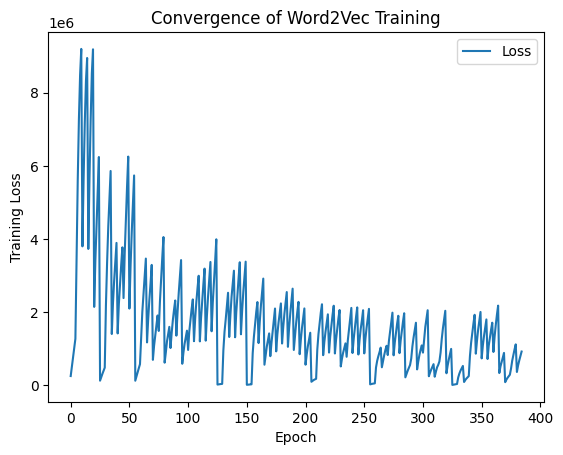

In [ ]:
import os
import zipfile
import json
from gensim.models import Word2Vec
from gensim.models.callbacks import CallbackAny2Vec
import matplotlib.pyplot as plt

# Paths
train_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_train_zips'  # Directory containing training ZIPs
final_model_path = '/content/drive/MyDrive/Final Project DATA SCIENCE/final2_word2vec_model.model'  # Path to save the final trained model

# Parameters for Word2Vec
word2vec_params = {
    'vector_size': 100,  # Embedding dimensions
    'window': 5,         # Context window size
    'min_count': 2,      # Minimum word frequency
    'workers': 4,        # Number of CPU cores for parallelization
    'sg': 1,             # Skip-gram method (set to 0 for CBOW)
}

# Custom LossLogger callback to track and log loss
class LossLogger(CallbackAny2Vec):
    def __init__(self):
        self.epoch = 0
        self.losses = []

    def on_epoch_end(self, model):
        loss = model.get_latest_training_loss()
        self.losses.append(loss)
        print(f"Epoch {self.epoch}: Loss = {loss:.4f}")
        self.epoch += 1

loss_logger = LossLogger()

# Initialize a new Word2Vec model
print("Initializing a new Word2Vec model...")
model = Word2Vec(**word2vec_params)

# Training loop
print("Starting training...")
for zip_file in sorted(os.listdir(train_zips_dir)):
    zip_path = os.path.join(train_zips_dir, zip_file)

    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        for json_file in sorted(zip_ref.namelist()):
            print(f"  Loading JSON file: {json_file}...")

            # Extract and load the JSON file
            with zip_ref.open(json_file) as f:
                tokens = json.load(f)

            # Ensure the model's vocabulary is built or updated
            if not model.wv.key_to_index:
                print("  Building vocabulary...")
                model.build_vocab(tokens)
            else:
                print("  Updating vocabulary...")
                model.build_vocab(tokens, update=True)

            # Train the model with explicit callback for loss logging
            print("  Training model on current batch...")
            model.train(
                tokens,
                total_examples=model.corpus_count,
                epochs=5,  # Train for a fixed number of epochs
                compute_loss=True,
                callbacks=[loss_logger]  # Attach the LossLogger
            )

print("Training completed.")

# Save the final model
model.save(final_model_path)
print(f"Final model saved at: {final_model_path}")

# Visualize the loss values
plt.plot(loss_logger.losses, label='Loss')
plt.xlabel('Epoch')
plt.ylabel('Training Loss')
plt.title('Convergence of Word2Vec Training')
plt.legend()
plt.show()


## Analyzing the convergence graph

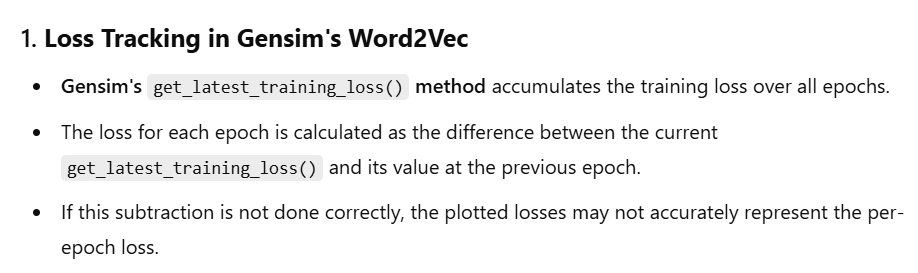

### Last few LOSS VALUES

In [ ]:
print(loss_logger.losses[-10:])


[459740.40625, 675232.3125, 835829.5, 984929.125, 1119605.375, 366071.6875, 544380.8125, 680573.75, 803445.0, 924132.3125]


### Coputing the LOG LOSS for last epoch !!

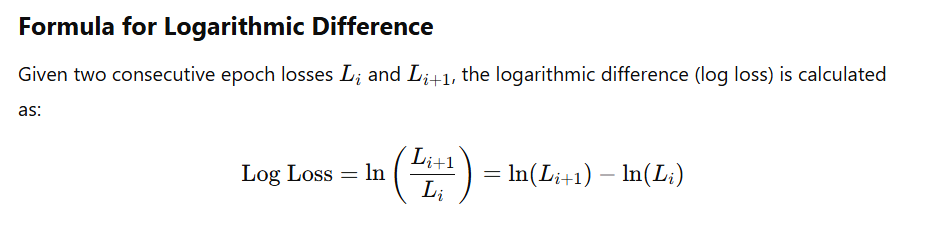

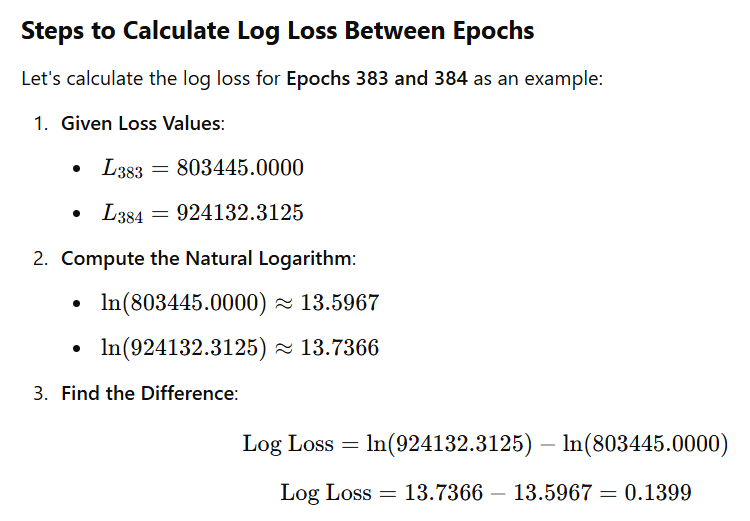

## Validation on the first trained word2vec model - experiment num.1

In [4]:
!pip install fuzzywuzzy[speedup]


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 162.7/162.7 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 43.1 MB/s eta 0:00:00


In [ ]:
import os
import numpy as np
import pandas as pd
from gensim.models import Word2Vec
from rapidfuzz import fuzz
import time

# Paths
model_path = '/content/drive/MyDrive/Final Project DATA SCIENCE/final2_word2vec_model.model'  # Path to the trained model
ground_truth_path = '/content/formatted_user_artist_weights_subset.csv'  # Path to the ground truth CSV

# Load Word2Vec model
print(f"Loading Word2Vec model from {model_path}...")
model = Word2Vec.load(model_path)
print(f"Vocabulary size: {len(model.wv)}")

# Load ground truth
def load_ground_truth(path, subset_size=None):
    print(f"Loading ground truth from {path}...")
    ground_truth = pd.read_csv(path)
    print(f"Total users in ground truth: {len(ground_truth)}")
    if subset_size:
        ground_truth = ground_truth.sample(n=subset_size, random_state=42)  # Random subset for validation
        print(f"Subset size for validation: {len(ground_truth)}")
    return ground_truth

# Limit to 1,000 users for faster validation
ground_truth_df = load_ground_truth(ground_truth_path, subset_size=1000)

# Prefilter vocabulary for efficiency
model_vocab = set(model.wv.key_to_index.keys())

# Fuzzy matching threshold
threshold = 60

# Validate model recommendations
def validate_recommendations(model, ground_truth_df):
    total_precision = 0
    total_recall = 0
    total_f1 = 0
    valid_recommendations = 0

    start_time = time.time()
    total_users = len(ground_truth_df)

    for idx, row in ground_truth_df.iterrows():
        user_id = row['user_id']
        formatted_tracks = row['formatted_tracklist'].split(',')
        ground_truth_tracks = [track.strip().lower() for track in formatted_tracks]

        # Seed track for the user
        if formatted_tracks:
            seed_track = formatted_tracks[0].strip().lower()

            # Check if the seed track is in the model vocabulary
            if seed_track not in model_vocab:
                continue

            try:
                # Generate recommendations
                recommendations = model.wv.most_similar(seed_track, topn=10)
                recommended_artists = {rec.split(':')[0] for rec, _ in recommendations if ':' in rec}

                # Ground truth artists
                ground_truth_artists = {track.split(':')[0] for track in ground_truth_tracks}

                # Fuzzy matching
                true_positives = sum(
                    any(fuzz.ratio(rec_artist, gt_artist) >= threshold for gt_artist in ground_truth_artists)
                    for rec_artist in recommended_artists
                )

                # Calculate metrics
                precision = true_positives / len(recommended_artists) if recommended_artists else 0
                recall = true_positives / len(ground_truth_artists) if ground_truth_artists else 0
                f1 = (2 * precision * recall / (precision + recall)) if (precision + recall) > 0 else 0

                total_precision += precision
                total_recall += recall
                total_f1 += f1
                valid_recommendations += 1

            except Exception as e:
                print(f"Error processing user {user_id}: {e}")

        # Progress tracking
        if (idx + 1) % 10 == 0 or (idx + 1) == total_users:
            elapsed_time = time.time() - start_time
            print(f"Processed {idx + 1}/{total_users} users. Elapsed time: {elapsed_time:.2f}s")

    # Calculate average metrics
    if valid_recommendations > 0:
        avg_precision = total_precision / valid_recommendations
        avg_recall = total_recall / valid_recommendations
        avg_f1 = total_f1 / valid_recommendations
    else:
        avg_precision = avg_recall = avg_f1 = 0

    # Print final metrics
    print("\n--- Artist-Based Metrics with Fuzzy Matching ---")
    print(f"Average Precision: {avg_precision:.4f}")
    print(f"Average Recall: {avg_recall:.4f}")
    print(f"Average F1-score: {avg_f1:.4f}")

# Run validation
validate_recommendations(model, ground_truth_df)


Loading Word2Vec model from /content/drive/MyDrive/Final Project DATA SCIENCE/final2_word2vec_model.model...
Vocabulary size: 1577269
Loading ground truth from /content/formatted_user_artist_weights_subset.csv...
Total users in ground truth: 565725
Subset size for validation: 1000
Processed 262630/1000 users. Elapsed time: 0.60s
Processed 288980/1000 users. Elapsed time: 0.63s
Processed 118080/1000 users. Elapsed time: 0.85s
Processed 72080/1000 users. Elapsed time: 0.95s
Processed 19110/1000 users. Elapsed time: 1.42s
Processed 263150/1000 users. Elapsed time: 1.53s
Processed 223440/1000 users. Elapsed time: 1.74s
Processed 209120/1000 users. Elapsed time: 1.78s
Processed 560800/1000 users. Elapsed time: 2.63s
Processed 415180/1000 users. Elapsed time: 3.87s
Processed 121970/1000 users. Elapsed time: 4.80s
Processed 105300/1000 users. Elapsed time: 4.87s
Processed 547660/1000 users. Elapsed time: 5.09s
Processed 329490/1000 users. Elapsed time: 5.27s
Processed 535810/1000 users. Elaps

## Train model - experiment num.2

Initializing a new Word2Vec model...
Starting training...
Processing ZIP file: chunked_zip_10.zip...
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_2.json...
  Building vocabulary...
  Training model on current batch...
Epoch 0: Loss = 468149.5312
Epoch 1: Loss = 923692.6875
Epoch 2: Loss = 1380686.1250
Epoch 3: Loss = 1791795.3750
Epoch 4: Loss = 2130111.5000
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 5: Loss = 4268179.0000
Epoch 6: Loss = 6332547.5000
Epoch 7: Loss = 7689152.0000
Epoch 8: Loss = 8532346.0000
Epoch 9: Loss = 8993865.0000
Processing ZIP file: chunked_zip_11.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 10: Loss = 4644473.0000
Epoch 11: Loss = 6446513.5000
Epoch 12: Loss = 7813818.0000
Epoch 13: Loss = 8534917.0000
Epoch 14: Loss = 8982021.0000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 15: Loss = 4213363.5000
Epoch 16: Loss = 6211809.5000
Epoch 17: Loss = 7549282.0000
Epoch 18: Loss = 8490575.0000
Epoch 19: Loss = 9053834.0000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 20: Loss = 2563487.2500
Epoch 21: Loss = 3911904.7500
Epoch 22: Loss = 5077776.0000
Epoch 23: Loss = 6002336.5000
Epoch 24: Loss = 6867921.0000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 25: Loss = 193253.4219
Epoch 26: Loss = 339726.4375
Epoch 27: Loss = 476580.2188
Epoch 28: Loss = 607418.6250
Epoch 29: Loss = 736175.2500
Processing ZIP file: chunked_zip_12.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 30: Loss = 2480754.2500
Epoch 31: Loss = 3740743.0000
Epoch 32: Loss = 4669156.5000
Epoch 33: Loss = 5404263.0000
Epoch 34: Loss = 6008937.0000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 35: Loss = 1593792.2500
Epoch 36: Loss = 2440875.0000
Epoch 37: Loss = 3065696.7500
Epoch 38: Loss = 3511021.2500
Epoch 39: Loss = 4032976.5000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 40: Loss = 1671412.7500
Epoch 41: Loss = 2473681.0000
Epoch 42: Loss = 3114208.5000
Epoch 43: Loss = 3642882.0000
Epoch 44: Loss = 4119875.0000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 45: Loss = 2563320.5000
Epoch 46: Loss = 3842777.7500
Epoch 47: Loss = 4831231.5000
Epoch 48: Loss = 5602443.0000
Epoch 49: Loss = 6266466.0000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 50: Loss = 2402928.2500
Epoch 51: Loss = 3545338.7500
Epoch 52: Loss = 4342327.0000
Epoch 53: Loss = 5047072.5000
Epoch 54: Loss = 5767349.0000
Processing ZIP file: chunked_zip_14.zip...
  Loading JSON file: artist_tokens_chunk_modified_4_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 55: Loss = 150518.9531
Epoch 56: Loss = 310093.2812
Epoch 57: Loss = 465540.5312
Epoch 58: Loss = 613092.8750
Epoch 59: Loss = 754357.5625
  Loading JSON file: artist_tokens_chunk_modified_4_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 60: Loss = 1397458.7500
Epoch 61: Loss = 2091162.6250
Epoch 62: Loss = 2560157.5000
Epoch 63: Loss = 2974486.2500
Epoch 64: Loss = 3402689.7500
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 65: Loss = 1268404.2500
Epoch 66: Loss = 1965736.2500
Epoch 67: Loss = 2455822.0000
Epoch 68: Loss = 2967205.2500
Epoch 69: Loss = 3418791.0000
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 70: Loss = 907024.1250
Epoch 71: Loss = 1280862.6250
Epoch 72: Loss = 1563621.0000
Epoch 73: Loss = 1809555.5000
Epoch 74: Loss = 2056004.6250
Processing ZIP file: chunked_zip_15.zip...
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 75: Loss = 1856391.8750
Epoch 76: Loss = 2683714.2500
Epoch 77: Loss = 3382708.0000
Epoch 78: Loss = 3842218.2500
Epoch 79: Loss = 4335393.5000
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 80: Loss = 865073.5000
Epoch 81: Loss = 1313880.5000
Epoch 82: Loss = 1523676.2500
Epoch 83: Loss = 1749456.0000
Epoch 84: Loss = 1947868.0000
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 85: Loss = 928556.1250
Epoch 86: Loss = 1331832.5000
Epoch 87: Loss = 1652955.7500
Epoch 88: Loss = 1924854.0000
Epoch 89: Loss = 2155739.0000
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 90: Loss = 1371493.8750
Epoch 91: Loss = 2101035.7500
Epoch 92: Loss = 2560563.0000
Epoch 93: Loss = 2945183.7500
Epoch 94: Loss = 3383597.5000
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 95: Loss = 664676.1250
Epoch 96: Loss = 950805.5000
Epoch 97: Loss = 1174851.2500
Epoch 98: Loss = 1364612.8750
Epoch 99: Loss = 1512727.1250
Processing ZIP file: chunked_zip_16.zip...
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 100: Loss = 1079003.2500
Epoch 101: Loss = 1532478.1250
Epoch 102: Loss = 1893433.3750
Epoch 103: Loss = 2171478.0000
Epoch 104: Loss = 2411415.5000
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 105: Loss = 1224966.1250
Epoch 106: Loss = 1834434.0000
Epoch 107: Loss = 2263175.2500
Epoch 108: Loss = 2675428.7500
Epoch 109: Loss = 3047559.0000
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 110: Loss = 1472165.8750
Epoch 111: Loss = 2174032.0000
Epoch 112: Loss = 2652202.2500
Epoch 113: Loss = 3084863.2500
Epoch 114: Loss = 3483650.5000
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 115: Loss = 1445185.8750
Epoch 116: Loss = 2095151.3750
Epoch 117: Loss = 2531765.5000
Epoch 118: Loss = 3002589.5000
Epoch 119: Loss = 3397449.5000
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 120: Loss = 1579410.0000
Epoch 121: Loss = 2392545.5000
Epoch 122: Loss = 2986488.2500
Epoch 123: Loss = 3540605.2500
Epoch 124: Loss = 4072211.5000
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 125: Loss = 23694.8457
Epoch 126: Loss = 27937.1953
Epoch 127: Loss = 31187.4648
Epoch 128: Loss = 34085.0898
Epoch 129: Loss = 36610.5547
Processing ZIP file: chunked_zip_17.zip...
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 130: Loss = 1074145.0000
Epoch 131: Loss = 1561834.2500
Epoch 132: Loss = 2018391.5000
Epoch 133: Loss = 2401594.5000
Epoch 134: Loss = 2713118.2500
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 135: Loss = 1485058.5000
Epoch 136: Loss = 2116703.5000
Epoch 137: Loss = 2562293.2500
Epoch 138: Loss = 3016448.5000
Epoch 139: Loss = 3408678.5000
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 140: Loss = 1360568.0000
Epoch 141: Loss = 2019470.8750
Epoch 142: Loss = 2545254.5000
Epoch 143: Loss = 2979505.2500
Epoch 144: Loss = 3388703.0000
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 145: Loss = 1548858.5000
Epoch 146: Loss = 2206427.0000
Epoch 147: Loss = 2738368.5000
Epoch 148: Loss = 3164354.2500
Epoch 149: Loss = 3570559.7500
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 150: Loss = 16105.3906
Epoch 151: Loss = 19452.1816
Epoch 152: Loss = 22002.8691
Epoch 153: Loss = 25773.7988
Epoch 154: Loss = 27659.7305
Processing ZIP file: chunked_zip_18.zip...
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 155: Loss = 1013384.0000
Epoch 156: Loss = 1493743.3750
Epoch 157: Loss = 1869194.3750
Epoch 158: Loss = 2163404.2500
Epoch 159: Loss = 2426553.0000
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 160: Loss = 1366330.7500
Epoch 161: Loss = 2035853.1250
Epoch 162: Loss = 2461849.0000
Epoch 163: Loss = 2830346.0000
Epoch 164: Loss = 3222117.7500
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 165: Loss = 628082.4375
Epoch 166: Loss = 898012.5000
Epoch 167: Loss = 1126897.8750
Epoch 168: Loss = 1318387.0000
Epoch 169: Loss = 1501506.2500
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 170: Loss = 820964.6250
Epoch 171: Loss = 1250341.1250
Epoch 172: Loss = 1588389.8750
Epoch 173: Loss = 1894730.8750
Epoch 174: Loss = 2216232.0000
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 175: Loss = 1017466.0000
Epoch 176: Loss = 1433987.5000
Epoch 177: Loss = 1738133.2500
Epoch 178: Loss = 2030619.1250
Epoch 179: Loss = 2270610.7500
Processing ZIP file: chunked_zip_19.zip...
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 180: Loss = 1260054.2500
Epoch 181: Loss = 1800398.3750
Epoch 182: Loss = 2231210.5000
Epoch 183: Loss = 2541778.2500
Epoch 184: Loss = 2813678.0000
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 185: Loss = 1223877.0000
Epoch 186: Loss = 1695355.7500
Epoch 187: Loss = 2061650.7500
Epoch 188: Loss = 2393185.7500
Epoch 189: Loss = 2697222.2500
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 190: Loss = 1075667.6250
Epoch 191: Loss = 1530816.2500
Epoch 192: Loss = 1860362.8750
Epoch 193: Loss = 2163344.2500
Epoch 194: Loss = 2402050.7500
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 195: Loss = 1066837.6250
Epoch 196: Loss = 1433528.0000
Epoch 197: Loss = 1737806.1250
Epoch 198: Loss = 2005149.5000
Epoch 199: Loss = 2252105.2500
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 200: Loss = 612509.1875
Epoch 201: Loss = 890807.1875
Epoch 202: Loss = 1067348.8750
Epoch 203: Loss = 1216918.3750
Epoch 204: Loss = 1360943.5000
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 205: Loss = 80831.9844
Epoch 206: Loss = 106867.6094
Epoch 207: Loss = 127523.3828
Epoch 208: Loss = 150180.3750
Epoch 209: Loss = 171214.0156
Processing ZIP file: chunked_zip_2.zip...
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 210: Loss = 1087773.6250
Epoch 211: Loss = 1539656.1250
Epoch 212: Loss = 1817526.8750
Epoch 213: Loss = 2084230.7500
Epoch 214: Loss = 2325576.7500
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 215: Loss = 971315.5625
Epoch 216: Loss = 1365278.5000
Epoch 217: Loss = 1751185.2500
Epoch 218: Loss = 1983543.2500
Epoch 219: Loss = 2272005.7500
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 220: Loss = 946638.2500
Epoch 221: Loss = 1369878.1250
Epoch 222: Loss = 1666043.3750
Epoch 223: Loss = 1914066.3750
Epoch 224: Loss = 2130987.5000
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 225: Loss = 996546.2500
Epoch 226: Loss = 1385379.8750
Epoch 227: Loss = 1662261.0000
Epoch 228: Loss = 1902367.5000
Epoch 229: Loss = 2141270.7500
  Loading JSON file: artist_tokens_chunk_modified_15_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 230: Loss = 504820.4062
Epoch 231: Loss = 706013.0625
Epoch 232: Loss = 858704.3750
Epoch 233: Loss = 992636.8125
Epoch 234: Loss = 1122288.6250
Processing ZIP file: chunked_zip_20.zip...
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 235: Loss = 881499.9375
Epoch 236: Loss = 1382245.2500
Epoch 237: Loss = 1746406.6250
Epoch 238: Loss = 2022044.7500
Epoch 239: Loss = 2272734.2500
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 240: Loss = 881022.6250
Epoch 241: Loss = 1291894.1250
Epoch 242: Loss = 1619669.1250
Epoch 243: Loss = 1894277.1250
Epoch 244: Loss = 2157280.7500
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 245: Loss = 901670.0625
Epoch 246: Loss = 1287937.7500
Epoch 247: Loss = 1600831.5000
Epoch 248: Loss = 1880513.7500
Epoch 249: Loss = 2126274.0000
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 250: Loss = 961198.8750
Epoch 251: Loss = 1366422.7500
Epoch 252: Loss = 1602589.7500
Epoch 253: Loss = 1857483.3750
Epoch 254: Loss = 2114419.0000
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 255: Loss = 30899.9434
Epoch 256: Loss = 39275.8867
Epoch 257: Loss = 45400.9453
Epoch 258: Loss = 50487.3164
Epoch 259: Loss = 55192.6602
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 260: Loss = 463330.9688
Epoch 261: Loss = 636525.2500
Epoch 262: Loss = 767834.3750
Epoch 263: Loss = 885026.1250
Epoch 264: Loss = 995018.0625
Processing ZIP file: chunked_zip_21.zip...
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 265: Loss = 440306.2500
Epoch 266: Loss = 627855.8750
Epoch 267: Loss = 781035.5625
Epoch 268: Loss = 888083.8750
Epoch 269: Loss = 1026551.2500
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 270: Loss = 1010512.6250
Epoch 271: Loss = 1371611.7500
Epoch 272: Loss = 1651068.5000
Epoch 273: Loss = 1915219.5000
Epoch 274: Loss = 2140240.7500
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 275: Loss = 914165.3125
Epoch 276: Loss = 1271500.1250
Epoch 277: Loss = 1537046.1250
Epoch 278: Loss = 1773234.6250
Epoch 279: Loss = 1985903.0000
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 280: Loss = 896001.9375
Epoch 281: Loss = 1288459.2500
Epoch 282: Loss = 1559755.2500
Epoch 283: Loss = 1832287.1250
Epoch 284: Loss = 2036149.1250
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 285: Loss = 270437.5938
Epoch 286: Loss = 368742.5625
Epoch 287: Loss = 449141.3438
Epoch 288: Loss = 532889.9375
Epoch 289: Loss = 600722.2500
Processing ZIP file: chunked_zip_3.zip...
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 290: Loss = 693754.4375
Epoch 291: Loss = 1022299.6250
Epoch 292: Loss = 1270105.5000
Epoch 293: Loss = 1486264.2500
Epoch 294: Loss = 1708953.6250
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 295: Loss = 517415.1562
Epoch 296: Loss = 768917.6875
Epoch 297: Loss = 938654.1875
Epoch 298: Loss = 1091609.3750
Epoch 299: Loss = 1216678.2500
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 300: Loss = 1007475.7500
Epoch 301: Loss = 1373897.3750
Epoch 302: Loss = 1627494.3750
Epoch 303: Loss = 1872606.0000
Epoch 304: Loss = 2118400.0000
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 305: Loss = 273360.6562
Epoch 306: Loss = 380775.7500
Epoch 307: Loss = 463716.4688
Epoch 308: Loss = 542390.1875
Epoch 309: Loss = 610739.0000
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 310: Loss = 235542.8438
Epoch 311: Loss = 334251.0000
Epoch 312: Loss = 426357.1562
Epoch 313: Loss = 497173.9062
Epoch 314: Loss = 564233.4375
Processing ZIP file: chunked_zip_6.zip...
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 315: Loss = 872808.3750
Epoch 316: Loss = 1292388.5000
Epoch 317: Loss = 1577712.3750
Epoch 318: Loss = 1849697.0000
Epoch 319: Loss = 2104779.2500
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 320: Loss = 489962.6562
Epoch 321: Loss = 704994.3125
Epoch 322: Loss = 857440.3750
Epoch 323: Loss = 993546.3750
Epoch 324: Loss = 1118647.6250
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 325: Loss = 12479.6230
Epoch 326: Loss = 19115.5898
Epoch 327: Loss = 24606.6055
Epoch 328: Loss = 29712.3867
Epoch 329: Loss = 34989.3203
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 330: Loss = 242818.6719
Epoch 331: Loss = 347865.9062
Epoch 332: Loss = 430115.8125
Epoch 333: Loss = 501693.4375
Epoch 334: Loss = 568620.8750
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 335: Loss = 130192.0078
Epoch 336: Loss = 194907.2500
Epoch 337: Loss = 242120.7500
Epoch 338: Loss = 282522.0312
Epoch 339: Loss = 321487.9688
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 340: Loss = 865307.6250
Epoch 341: Loss = 1195893.1250
Epoch 342: Loss = 1440809.1250
Epoch 343: Loss = 1667853.5000
Epoch 344: Loss = 1899178.5000
Processing ZIP file: chunked_zip_8.zip...
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 345: Loss = 834931.2500
Epoch 346: Loss = 1218170.5000
Epoch 347: Loss = 1517916.3750
Epoch 348: Loss = 1756795.8750
Epoch 349: Loss = 1978015.1250
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 350: Loss = 860827.0000
Epoch 351: Loss = 1188885.0000
Epoch 352: Loss = 1393106.5000
Epoch 353: Loss = 1580338.8750
Epoch 354: Loss = 1758343.5000
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 355: Loss = 805011.2500
Epoch 356: Loss = 1124562.7500
Epoch 357: Loss = 1335755.8750
Epoch 358: Loss = 1525643.2500
Epoch 359: Loss = 1709478.0000
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 360: Loss = 956514.7500
Epoch 361: Loss = 1374094.6250
Epoch 362: Loss = 1687563.5000
Epoch 363: Loss = 1961089.6250
Epoch 364: Loss = 2200774.0000
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 365: Loss = 398576.0000
Epoch 366: Loss = 566944.6875
Epoch 367: Loss = 708028.2500
Epoch 368: Loss = 825624.8125
Epoch 369: Loss = 949683.9375
Processing ZIP file: chunked_zip_9.zip...
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 370: Loss = 109641.2812
Epoch 371: Loss = 171089.5938
Epoch 372: Loss = 217921.0938
Epoch 373: Loss = 258468.5938
Epoch 374: Loss = 295814.7500
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 375: Loss = 510981.6250
Epoch 376: Loss = 706216.9375
Epoch 377: Loss = 859726.5000
Epoch 378: Loss = 999076.5000
Epoch 379: Loss = 1123610.3750
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 380: Loss = 406149.4375
Epoch 381: Loss = 611103.7500
Epoch 382: Loss = 753377.4375
Epoch 383: Loss = 881816.2500
Epoch 384: Loss = 1010238.2500
Training completed.
Final model saved at: /content/drive/MyDrive/Final Project DATA SCIENCE/final3_word2vec_model.model


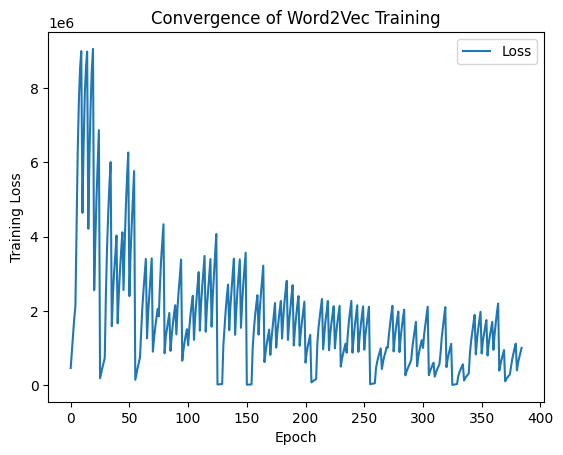

In [ ]:
import os
import zipfile
import json
from gensim.models import Word2Vec
from gensim.models.callbacks import CallbackAny2Vec
import matplotlib.pyplot as plt


# Paths
train_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_train_zips'  # Directory containing training ZIPs
final_model_path = '/content/drive/MyDrive/Final Project DATA SCIENCE/final3_word2vec_model.model'  # Path to save the final trained model

# Parameters for Word2Vec
word2vec_params = {
    'vector_size': 100,  # Embedding dimensions
    'window': 10,         # Context window size - increased to 10 (2nd experiment)
    'min_count': 2,      # Minimum word frequency
    'workers': 4,        # Number of CPU cores for parallelization
    'sg': 1,             # Skip-gram method (set to 0 for CBOW)
}

# Custom LossLogger callback to track and log loss
class LossLogger(CallbackAny2Vec):
    def __init__(self):
        self.epoch = 0
        self.losses = []

    def on_epoch_end(self, model):
        loss = model.get_latest_training_loss()
        self.losses.append(loss)
        print(f"Epoch {self.epoch}: Loss = {loss:.4f}")
        self.epoch += 1

loss_logger = LossLogger()

# Initialize a new Word2Vec model
print("Initializing a new Word2Vec model...")
model = Word2Vec(**word2vec_params)

# Training loop
print("Starting training...")
for zip_file in sorted(os.listdir(train_zips_dir)):
    zip_path = os.path.join(train_zips_dir, zip_file)

    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        for json_file in sorted(zip_ref.namelist()):
            print(f"  Loading JSON file: {json_file}...")

            # Extract and load the JSON file
            with zip_ref.open(json_file) as f:
                tokens = json.load(f)

            # Ensure the model's vocabulary is built or updated
            if not model.wv.key_to_index:
                print("  Building vocabulary...")
                model.build_vocab(tokens)
            else:
                print("  Updating vocabulary...")
                model.build_vocab(tokens, update=True)

            # Train the model with explicit callback for loss logging
            print("  Training model on current batch...")
            model.train(
                tokens,
                total_examples=model.corpus_count,
                epochs=5,  # Train for a fixed number of epochs
                compute_loss=True,
                callbacks=[loss_logger]  # Attach the LossLogger
            )

print("Training completed.")

# Save the final model
model.save(final_model_path)
print(f"Final model saved at: {final_model_path}")

# Visualize the loss values
plt.plot(loss_logger.losses, label='Loss')
plt.xlabel('Epoch')
plt.ylabel('Training Loss')
plt.title('Convergence of Word2Vec Training')
plt.legend()
plt.show()


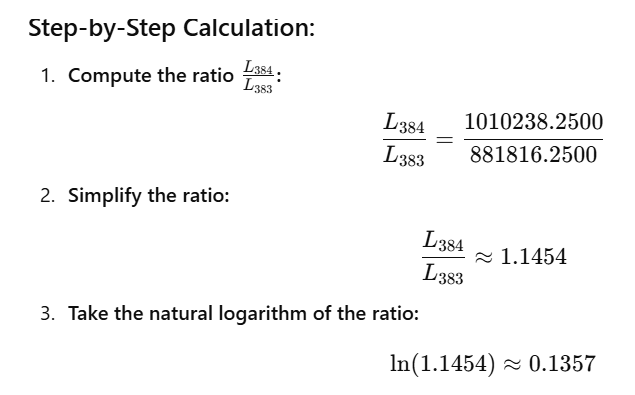

## Validation model - from experiment num.2


In [ ]:
import os
import numpy as np
import pandas as pd
from gensim.models import Word2Vec
from rapidfuzz import fuzz
import time

# Paths
model_path = '/content/drive/MyDrive/Final Project DATA SCIENCE/final3_word2vec_model.model'  # Path to the trained model
ground_truth_path = '/content/formatted_user_artist_weights_subset.csv'  # Path to the ground truth CSV

# Load Word2Vec model
print(f"Loading Word2Vec model from {model_path}...")
model = Word2Vec.load(model_path)
print(f"Vocabulary size: {len(model.wv)}")

# Load ground truth
def load_ground_truth(path, subset_size=None):
    print(f"Loading ground truth from {path}...")
    ground_truth = pd.read_csv(path)
    print(f"Total users in ground truth: {len(ground_truth)}")
    if subset_size:
        ground_truth = ground_truth.sample(n=subset_size, random_state=42)  # Random subset for validation
        print(f"Subset size for validation: {len(ground_truth)}")
    return ground_truth

# Limit to 1,000 users for faster validation
ground_truth_df = load_ground_truth(ground_truth_path, subset_size=1000)

# Prefilter vocabulary for efficiency
model_vocab = set(model.wv.key_to_index.keys())

# Fuzzy matching threshold
threshold = 60

# Validate model recommendations
def validate_recommendations(model, ground_truth_df):
    total_precision = 0
    total_recall = 0
    total_f1 = 0
    valid_recommendations = 0

    start_time = time.time()
    total_users = len(ground_truth_df)

    for idx, row in ground_truth_df.iterrows():
        user_id = row['user_id']
        formatted_tracks = row['formatted_tracklist'].split(',')
        ground_truth_tracks = [track.strip().lower() for track in formatted_tracks]

        # Seed track for the user
        if formatted_tracks:
            seed_track = formatted_tracks[0].strip().lower()

            # Check if the seed track is in the model vocabulary
            if seed_track not in model_vocab:
                continue

            try:
                # Generate recommendations
                recommendations = model.wv.most_similar(seed_track, topn=10)
                recommended_artists = {rec.split(':')[0] for rec, _ in recommendations if ':' in rec}

                # Ground truth artists
                ground_truth_artists = {track.split(':')[0] for track in ground_truth_tracks}

                # Fuzzy matching
                true_positives = sum(
                    any(fuzz.ratio(rec_artist, gt_artist) >= threshold for gt_artist in ground_truth_artists)
                    for rec_artist in recommended_artists
                )

                # Calculate metrics
                precision = true_positives / len(recommended_artists) if recommended_artists else 0
                recall = true_positives / len(ground_truth_artists) if ground_truth_artists else 0
                f1 = (2 * precision * recall / (precision + recall)) if (precision + recall) > 0 else 0

                total_precision += precision
                total_recall += recall
                total_f1 += f1
                valid_recommendations += 1

            except Exception as e:
                print(f"Error processing user {user_id}: {e}")

        # Progress tracking
        if (idx + 1) % 10 == 0 or (idx + 1) == total_users:
            elapsed_time = time.time() - start_time
            print(f"Processed {idx + 1}/{total_users} users. Elapsed time: {elapsed_time:.2f}s")

    # Calculate average metrics
    if valid_recommendations > 0:
        avg_precision = total_precision / valid_recommendations
        avg_recall = total_recall / valid_recommendations
        avg_f1 = total_f1 / valid_recommendations
    else:
        avg_precision = avg_recall = avg_f1 = 0

    # Print final metrics
    print("\n--- Artist-Based Metrics with Fuzzy Matching ---")
    print(f"Average Precision: {avg_precision:.4f}")
    print(f"Average Recall: {avg_recall:.4f}")
    print(f"Average F1-score: {avg_f1:.4f}")

# Run validation
validate_recommendations(model, ground_truth_df)


Loading Word2Vec model from /content/drive/MyDrive/Final Project DATA SCIENCE/final3_word2vec_model.model...
Vocabulary size: 1577269
Loading ground truth from /content/formatted_user_artist_weights_subset.csv...
Total users in ground truth: 565725
Subset size for validation: 1000
Processed 262630/1000 users. Elapsed time: 1.11s
Processed 288980/1000 users. Elapsed time: 1.13s
Processed 118080/1000 users. Elapsed time: 1.28s
Processed 72080/1000 users. Elapsed time: 1.35s
Processed 19110/1000 users. Elapsed time: 1.67s
Processed 263150/1000 users. Elapsed time: 1.76s
Processed 223440/1000 users. Elapsed time: 1.90s
Processed 209120/1000 users. Elapsed time: 1.92s
Processed 560800/1000 users. Elapsed time: 2.38s
Processed 415180/1000 users. Elapsed time: 3.19s
Processed 121970/1000 users. Elapsed time: 3.78s
Processed 105300/1000 users. Elapsed time: 3.82s
Processed 547660/1000 users. Elapsed time: 3.94s
Processed 329490/1000 users. Elapsed time: 4.07s
Processed 535810/1000 users. Elaps

**Increasing the window size gives the model more context, and now we see metrics have improved !!**

## Train model - experiment num.3

Initializing a new Word2Vec model...
Starting training...
Processing ZIP file: chunked_zip_10.zip...
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_2.json...
  Building vocabulary...
  Training model on current batch...
Epoch 0: Loss = 468073.0312
Epoch 1: Loss = 923619.5625
Epoch 2: Loss = 1391964.2500
Epoch 3: Loss = 1814138.6250
Epoch 4: Loss = 2189248.5000
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 5: Loss = 4240319.0000
Epoch 6: Loss = 6651514.5000
Epoch 7: Loss = 8190222.5000
Epoch 8: Loss = 8980583.0000
Epoch 9: Loss = 9582092.0000
Processing ZIP file: chunked_zip_11.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 10: Loss = 4333521.0000
Epoch 11: Loss = 6247297.0000
Epoch 12: Loss = 7614744.0000
Epoch 13: Loss = 8413953.0000
Epoch 14: Loss = 8816292.0000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 15: Loss = 4273540.5000
Epoch 16: Loss = 6094828.0000
Epoch 17: Loss = 7601499.0000
Epoch 18: Loss = 8607487.0000
Epoch 19: Loss = 9199013.0000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 20: Loss = 2530790.5000
Epoch 21: Loss = 3850496.0000
Epoch 22: Loss = 4982248.5000
Epoch 23: Loss = 5805508.0000
Epoch 24: Loss = 6630701.5000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 25: Loss = 193405.1719
Epoch 26: Loss = 339896.9688
Epoch 27: Loss = 476753.2500
Epoch 28: Loss = 607590.6875
Epoch 29: Loss = 736314.6250
Processing ZIP file: chunked_zip_12.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 30: Loss = 2341137.2500
Epoch 31: Loss = 3574269.7500
Epoch 32: Loss = 4498315.5000
Epoch 33: Loss = 5255549.5000
Epoch 34: Loss = 5953142.0000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 35: Loss = 1633216.5000
Epoch 36: Loss = 2421989.2500
Epoch 37: Loss = 2992647.2500
Epoch 38: Loss = 3509092.7500
Epoch 39: Loss = 3959938.5000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 40: Loss = 1816059.2500
Epoch 41: Loss = 2593931.5000
Epoch 42: Loss = 3149868.2500
Epoch 43: Loss = 3671425.2500
Epoch 44: Loss = 4170178.5000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 45: Loss = 2404859.7500
Epoch 46: Loss = 3592739.0000
Epoch 47: Loss = 4546432.5000
Epoch 48: Loss = 5398269.5000
Epoch 49: Loss = 6159375.5000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 50: Loss = 2335834.5000
Epoch 51: Loss = 3419813.2500
Epoch 52: Loss = 4297558.0000
Epoch 53: Loss = 5014888.0000
Epoch 54: Loss = 5659708.0000
Processing ZIP file: chunked_zip_14.zip...
  Loading JSON file: artist_tokens_chunk_modified_4_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 55: Loss = 146211.6094
Epoch 56: Loss = 303276.1875
Epoch 57: Loss = 458302.5000
Epoch 58: Loss = 605770.6875
Epoch 59: Loss = 748157.0625
  Loading JSON file: artist_tokens_chunk_modified_4_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 60: Loss = 1392194.8750
Epoch 61: Loss = 2102671.2500
Epoch 62: Loss = 2618702.2500
Epoch 63: Loss = 3005966.7500
Epoch 64: Loss = 3435301.0000
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 65: Loss = 1423042.3750
Epoch 66: Loss = 2202050.0000
Epoch 67: Loss = 2741747.0000
Epoch 68: Loss = 3171300.7500
Epoch 69: Loss = 3621923.7500
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 70: Loss = 893207.5000
Epoch 71: Loss = 1260091.6250
Epoch 72: Loss = 1530937.6250
Epoch 73: Loss = 1771637.7500
Epoch 74: Loss = 2015435.3750
Processing ZIP file: chunked_zip_15.zip...
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 75: Loss = 1765163.6250
Epoch 76: Loss = 2575541.5000
Epoch 77: Loss = 3191308.0000
Epoch 78: Loss = 3769666.2500
Epoch 79: Loss = 4316378.5000
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 80: Loss = 599386.8125
Epoch 81: Loss = 1056068.0000
Epoch 82: Loss = 1286978.8750
Epoch 83: Loss = 1588021.6250
Epoch 84: Loss = 1826212.3750
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 85: Loss = 1100163.5000
Epoch 86: Loss = 1547241.0000
Epoch 87: Loss = 1878013.7500
Epoch 88: Loss = 2170683.0000
Epoch 89: Loss = 2409429.2500
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 90: Loss = 1447976.3750
Epoch 91: Loss = 2095840.2500
Epoch 92: Loss = 2637090.7500
Epoch 93: Loss = 2983131.2500
Epoch 94: Loss = 3412093.2500
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 95: Loss = 666808.7500
Epoch 96: Loss = 965705.0000
Epoch 97: Loss = 1173691.2500
Epoch 98: Loss = 1327242.6250
Epoch 99: Loss = 1506171.7500
Processing ZIP file: chunked_zip_16.zip...
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 100: Loss = 995831.3750
Epoch 101: Loss = 1462036.2500
Epoch 102: Loss = 1831646.7500
Epoch 103: Loss = 2118225.7500
Epoch 104: Loss = 2405789.5000
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 105: Loss = 1401929.1250
Epoch 106: Loss = 2060203.1250
Epoch 107: Loss = 2471385.5000
Epoch 108: Loss = 2855710.7500
Epoch 109: Loss = 3209452.0000
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 110: Loss = 1499828.2500
Epoch 111: Loss = 2202502.2500
Epoch 112: Loss = 2664096.0000
Epoch 113: Loss = 3076305.2500
Epoch 114: Loss = 3436994.7500
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 115: Loss = 1529908.6250
Epoch 116: Loss = 2197756.7500
Epoch 117: Loss = 2682842.2500
Epoch 118: Loss = 3139413.5000
Epoch 119: Loss = 3530512.5000
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 120: Loss = 1778994.0000
Epoch 121: Loss = 2572668.0000
Epoch 122: Loss = 3208077.5000
Epoch 123: Loss = 3727882.7500
Epoch 124: Loss = 4271587.5000
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 125: Loss = 23390.9805
Epoch 126: Loss = 27611.5625
Epoch 127: Loss = 30744.7891
Epoch 128: Loss = 33506.4414
Epoch 129: Loss = 36144.3125
Processing ZIP file: chunked_zip_17.zip...
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 130: Loss = 1068593.3750
Epoch 131: Loss = 1517636.8750
Epoch 132: Loss = 1822930.6250
Epoch 133: Loss = 2111486.2500
Epoch 134: Loss = 2350595.0000
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 135: Loss = 1452570.1250
Epoch 136: Loss = 2094830.1250
Epoch 137: Loss = 2530626.2500
Epoch 138: Loss = 2975070.0000
Epoch 139: Loss = 3373404.0000
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 140: Loss = 1422472.0000
Epoch 141: Loss = 2084426.2500
Epoch 142: Loss = 2552444.5000
Epoch 143: Loss = 2967473.5000
Epoch 144: Loss = 3347512.5000
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 145: Loss = 1656519.7500
Epoch 146: Loss = 2364119.7500
Epoch 147: Loss = 2819346.7500
Epoch 148: Loss = 3231443.2500
Epoch 149: Loss = 3573546.0000
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 150: Loss = 16208.0459
Epoch 151: Loss = 19618.5391
Epoch 152: Loss = 22254.9941
Epoch 153: Loss = 24411.6523
Epoch 154: Loss = 26396.3809
Processing ZIP file: chunked_zip_18.zip...
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 155: Loss = 1091748.3750
Epoch 156: Loss = 1538612.8750
Epoch 157: Loss = 1860767.8750
Epoch 158: Loss = 2159917.2500
Epoch 159: Loss = 2408987.5000
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 160: Loss = 1318263.3750
Epoch 161: Loss = 1936233.8750
Epoch 162: Loss = 2381260.5000
Epoch 163: Loss = 2766105.0000
Epoch 164: Loss = 3129541.7500
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 165: Loss = 698796.2500
Epoch 166: Loss = 1003434.6250
Epoch 167: Loss = 1222711.3750
Epoch 168: Loss = 1372183.1250
Epoch 169: Loss = 1539436.7500
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 170: Loss = 921171.5625
Epoch 171: Loss = 1445883.3750
Epoch 172: Loss = 1800953.7500
Epoch 173: Loss = 2069357.2500
Epoch 174: Loss = 2331380.2500
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 175: Loss = 1116442.6250
Epoch 176: Loss = 1566272.1250
Epoch 177: Loss = 1890343.1250
Epoch 178: Loss = 2121762.0000
Epoch 179: Loss = 2357496.0000
Processing ZIP file: chunked_zip_19.zip...
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 180: Loss = 1141078.0000
Epoch 181: Loss = 1689131.1250
Epoch 182: Loss = 2062853.5000
Epoch 183: Loss = 2419578.2500
Epoch 184: Loss = 2681414.7500
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 185: Loss = 1160854.7500
Epoch 186: Loss = 1650726.5000
Epoch 187: Loss = 2037079.3750
Epoch 188: Loss = 2344696.7500
Epoch 189: Loss = 2630894.0000
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 190: Loss = 936725.7500
Epoch 191: Loss = 1421888.2500
Epoch 192: Loss = 1736382.2500
Epoch 193: Loss = 2048767.8750
Epoch 194: Loss = 2273741.2500
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 195: Loss = 1004349.1250
Epoch 196: Loss = 1407818.5000
Epoch 197: Loss = 1682157.1250
Epoch 198: Loss = 1958312.5000
Epoch 199: Loss = 2175249.7500
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 200: Loss = 599257.5000
Epoch 201: Loss = 828190.0000
Epoch 202: Loss = 1057164.1250
Epoch 203: Loss = 1203594.2500
Epoch 204: Loss = 1353083.3750
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 205: Loss = 114415.9219
Epoch 206: Loss = 151052.5469
Epoch 207: Loss = 178057.6719
Epoch 208: Loss = 198527.8594
Epoch 209: Loss = 209382.3750
Processing ZIP file: chunked_zip_2.zip...
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 210: Loss = 1052814.3750
Epoch 211: Loss = 1498750.7500
Epoch 212: Loss = 1808935.5000
Epoch 213: Loss = 2080014.0000
Epoch 214: Loss = 2303610.0000
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 215: Loss = 813691.8750
Epoch 216: Loss = 1163196.8750
Epoch 217: Loss = 1422408.6250
Epoch 218: Loss = 1644219.2500
Epoch 219: Loss = 1879658.2500
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 220: Loss = 1031255.5625
Epoch 221: Loss = 1453634.0000
Epoch 222: Loss = 1764389.3750
Epoch 223: Loss = 2033611.3750
Epoch 224: Loss = 2277083.0000
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 225: Loss = 874684.7500
Epoch 226: Loss = 1263725.1250
Epoch 227: Loss = 1532057.5000
Epoch 228: Loss = 1786568.0000
Epoch 229: Loss = 1984748.0000
  Loading JSON file: artist_tokens_chunk_modified_15_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 230: Loss = 455608.7188
Epoch 231: Loss = 675849.7500
Epoch 232: Loss = 812830.3750
Epoch 233: Loss = 935717.4375
Epoch 234: Loss = 1048905.1250
Processing ZIP file: chunked_zip_20.zip...
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 235: Loss = 1064301.5000
Epoch 236: Loss = 1521214.3750
Epoch 237: Loss = 1874523.8750
Epoch 238: Loss = 2144570.7500
Epoch 239: Loss = 2342411.5000
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 240: Loss = 938121.7500
Epoch 241: Loss = 1338466.7500
Epoch 242: Loss = 1633229.6250
Epoch 243: Loss = 1884201.2500
Epoch 244: Loss = 2154290.7500
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 245: Loss = 964633.0000
Epoch 246: Loss = 1353964.8750
Epoch 247: Loss = 1639357.2500
Epoch 248: Loss = 1887539.7500
Epoch 249: Loss = 2102397.5000
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 250: Loss = 1013419.4375
Epoch 251: Loss = 1359344.3750
Epoch 252: Loss = 1671777.5000
Epoch 253: Loss = 1935289.5000
Epoch 254: Loss = 2172641.2500
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 255: Loss = 30784.7188
Epoch 256: Loss = 37033.4102
Epoch 257: Loss = 41595.9766
Epoch 258: Loss = 45371.4805
Epoch 259: Loss = 50113.1406
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 260: Loss = 430850.3438
Epoch 261: Loss = 625369.8125
Epoch 262: Loss = 749659.3750
Epoch 263: Loss = 864595.2500
Epoch 264: Loss = 956404.6875
Processing ZIP file: chunked_zip_21.zip...
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 265: Loss = 442599.0312
Epoch 266: Loss = 650374.8125
Epoch 267: Loss = 778871.5000
Epoch 268: Loss = 907416.4375
Epoch 269: Loss = 1030872.2500
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 270: Loss = 845112.6875
Epoch 271: Loss = 1207632.2500
Epoch 272: Loss = 1456730.3750
Epoch 273: Loss = 1678914.8750
Epoch 274: Loss = 1896368.3750
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 275: Loss = 761887.0000
Epoch 276: Loss = 1136503.0000
Epoch 277: Loss = 1412321.5000
Epoch 278: Loss = 1631322.7500
Epoch 279: Loss = 1821889.8750
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 280: Loss = 931777.9375
Epoch 281: Loss = 1312164.0000
Epoch 282: Loss = 1595914.3750
Epoch 283: Loss = 1815797.0000
Epoch 284: Loss = 2029890.7500
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 285: Loss = 263433.1562
Epoch 286: Loss = 387894.6562
Epoch 287: Loss = 464920.7188
Epoch 288: Loss = 542080.3750
Epoch 289: Loss = 603154.7500
Processing ZIP file: chunked_zip_3.zip...
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 290: Loss = 821901.1875
Epoch 291: Loss = 1137691.0000
Epoch 292: Loss = 1371783.2500
Epoch 293: Loss = 1578546.1250
Epoch 294: Loss = 1777774.2500
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 295: Loss = 538010.6875
Epoch 296: Loss = 759114.6250
Epoch 297: Loss = 907066.5000
Epoch 298: Loss = 1054549.2500
Epoch 299: Loss = 1171286.1250
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 300: Loss = 967849.5000
Epoch 301: Loss = 1354068.0000
Epoch 302: Loss = 1633027.2500
Epoch 303: Loss = 1893043.8750
Epoch 304: Loss = 2110810.7500
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 305: Loss = 230764.5938
Epoch 306: Loss = 336656.8125
Epoch 307: Loss = 418416.4062
Epoch 308: Loss = 493489.2812
Epoch 309: Loss = 545362.0000
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 310: Loss = 268910.1562
Epoch 311: Loss = 366920.6562
Epoch 312: Loss = 452618.2188
Epoch 313: Loss = 530920.7500
Epoch 314: Loss = 584660.9375
Processing ZIP file: chunked_zip_6.zip...
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 315: Loss = 906377.5000
Epoch 316: Loss = 1275670.0000
Epoch 317: Loss = 1571254.5000
Epoch 318: Loss = 1850969.7500
Epoch 319: Loss = 2089206.0000
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 320: Loss = 472237.1875
Epoch 321: Loss = 696992.3125
Epoch 322: Loss = 863733.6875
Epoch 323: Loss = 962276.0000
Epoch 324: Loss = 1079376.8750
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 325: Loss = 12413.8594
Epoch 326: Loss = 18996.4258
Epoch 327: Loss = 24232.1348
Epoch 328: Loss = 29206.3066
Epoch 329: Loss = 34103.5977
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_1.json...


  Updating vocabulary...
  Training model on current batch...
Epoch 330: Loss = 317538.3438
Epoch 331: Loss = 417824.7500
Epoch 332: Loss = 488514.6562
Epoch 333: Loss = 552732.6250
Epoch 334: Loss = 608858.6250
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 335: Loss = 130678.9219
Epoch 336: Loss = 194994.5000
Epoch 337: Loss = 242579.6094
Epoch 338: Loss = 283352.7188
Epoch 339: Loss = 321692.0312
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 340: Loss = 724760.0000
Epoch 341: Loss = 1058749.2500
Epoch 342: Loss = 1317060.1250
Epoch 343: Loss = 1541104.7500
Epoch 344: Loss = 1735535.1250
Processing ZIP file: chunked_zip_8.zip...
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 345: Loss = 941592.7500
Epoch 346: Loss = 1330369.5000
Epoch 347: Loss = 1593291.2500
Epoch 348: Loss = 1849379.8750
Epoch 349: Loss = 2067760.5000
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 350: Loss = 686553.8125
Epoch 351: Loss = 1014464.8125
Epoch 352: Loss = 1256925.3750
Epoch 353: Loss = 1439083.6250
Epoch 354: Loss = 1602465.7500
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 355: Loss = 709970.3750
Epoch 356: Loss = 1010756.1875
Epoch 357: Loss = 1266658.1250
Epoch 358: Loss = 1451885.7500
Epoch 359: Loss = 1632623.8750
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 360: Loss = 847345.6250
Epoch 361: Loss = 1260014.1250
Epoch 362: Loss = 1560355.8750
Epoch 363: Loss = 1857486.3750
Epoch 364: Loss = 2115687.0000
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 365: Loss = 440526.8750
Epoch 366: Loss = 618350.6875
Epoch 367: Loss = 749264.8750
Epoch 368: Loss = 869173.3750
Epoch 369: Loss = 979083.4375
Processing ZIP file: chunked_zip_9.zip...
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 370: Loss = 108969.9297
Epoch 371: Loss = 169530.9531
Epoch 372: Loss = 215870.6250
Epoch 373: Loss = 256009.5781
Epoch 374: Loss = 292749.6875
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 375: Loss = 478214.8125
Epoch 376: Loss = 686463.1250
Epoch 377: Loss = 881988.0625
Epoch 378: Loss = 1021668.9375
Epoch 379: Loss = 1136718.2500
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 380: Loss = 467465.0625
Epoch 381: Loss = 629538.3125
Epoch 382: Loss = 769622.5625
Epoch 383: Loss = 895992.4375
Epoch 384: Loss = 1010324.5625
Training completed.
Final model saved at: /content/drive/MyDrive/Final Project DATA SCIENCE/final4_word2vec_model.model


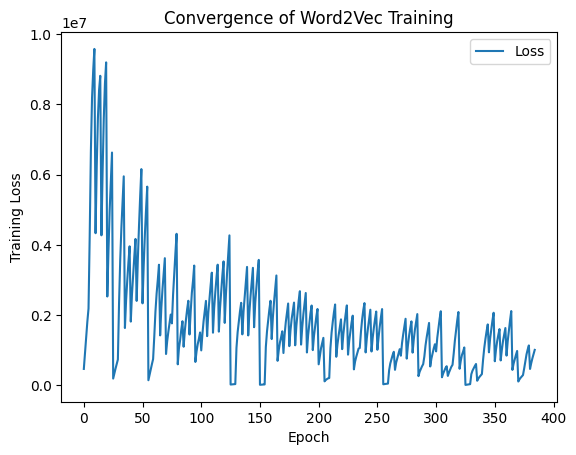

In [ ]:
import os
import zipfile
import json
from gensim.models import Word2Vec
from gensim.models.callbacks import CallbackAny2Vec
import matplotlib.pyplot as plt


# Paths
train_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_train_zips'  # Directory containing training ZIPs
final_model_path = '/content/drive/MyDrive/Final Project DATA SCIENCE/final4_word2vec_model.model'  # Path to save the final trained model

# Parameters for Word2Vec
word2vec_params = {
    'vector_size': 200,  # Embedding dimensions (increased vector_size to 200)
    'window': 10,         # Context window size
    'min_count': 2,      # Minimum word frequency
    'workers': 4,        # Number of CPU cores for parallelization
    'sg': 1,             # Skip-gram method (set to 0 for CBOW)
}

# Custom LossLogger callback to track and log loss
class LossLogger(CallbackAny2Vec):
    def __init__(self):
        self.epoch = 0
        self.losses = []

    def on_epoch_end(self, model):
        loss = model.get_latest_training_loss()
        self.losses.append(loss)
        print(f"Epoch {self.epoch}: Loss = {loss:.4f}")
        self.epoch += 1

loss_logger = LossLogger()

# Initialize a new Word2Vec model
print("Initializing a new Word2Vec model...")
model = Word2Vec(**word2vec_params)

# Training loop
print("Starting training...")
for zip_file in sorted(os.listdir(train_zips_dir)):
    zip_path = os.path.join(train_zips_dir, zip_file)

    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        for json_file in sorted(zip_ref.namelist()):
            print(f"  Loading JSON file: {json_file}...")

            # Extract and load the JSON file
            with zip_ref.open(json_file) as f:
                tokens = json.load(f)

            # Ensure the model's vocabulary is built or updated
            if not model.wv.key_to_index:
                print("  Building vocabulary...")
                model.build_vocab(tokens)
            else:
                print("  Updating vocabulary...")
                model.build_vocab(tokens, update=True)

            # Train the model with explicit callback for loss logging
            print("  Training model on current batch...")
            model.train(
                tokens,
                total_examples=model.corpus_count,
                epochs=5,  # Train for a fixed number of epochs
                compute_loss=True,
                callbacks=[loss_logger]  # Attach the LossLogger
            )

print("Training completed.")

# Save the final model
model.save(final_model_path)
print(f"Final model saved at: {final_model_path}")

# Visualize the loss values
plt.plot(loss_logger.losses, label='Loss')
plt.xlabel('Epoch')
plt.ylabel('Training Loss')
plt.title('Convergence of Word2Vec Training')
plt.legend()
plt.show()


## Validation model - from experiment num.3

In [ ]:
import os
import numpy as np
import pandas as pd
from gensim.models import Word2Vec
from rapidfuzz import fuzz
import time

# Paths
model_path = '/content/drive/MyDrive/Final Project DATA SCIENCE/final4_word2vec_model.model'  # Path to the trained model
ground_truth_path = '/content/formatted_user_artist_weights_subset.csv'  # Path to the ground truth CSV

# Load Word2Vec model
print(f"Loading Word2Vec model from {model_path}...")
model = Word2Vec.load(model_path)
print(f"Vocabulary size: {len(model.wv)}")

# Load ground truth
def load_ground_truth(path, subset_size=None):
    print(f"Loading ground truth from {path}...")
    ground_truth = pd.read_csv(path)
    print(f"Total users in ground truth: {len(ground_truth)}")
    if subset_size:
        ground_truth = ground_truth.sample(n=subset_size, random_state=42)  # Random subset for validation
        print(f"Subset size for validation: {len(ground_truth)}")
    return ground_truth

# Limit to 1,000 users for faster validation
ground_truth_df = load_ground_truth(ground_truth_path, subset_size=1000)

# Prefilter vocabulary for efficiency
model_vocab = set(model.wv.key_to_index.keys())

# Fuzzy matching threshold
threshold = 60

# Validate model recommendations
def validate_recommendations(model, ground_truth_df):
    total_precision = 0
    total_recall = 0
    total_f1 = 0
    valid_recommendations = 0

    start_time = time.time()
    total_users = len(ground_truth_df)

    for idx, row in ground_truth_df.iterrows():
        user_id = row['user_id']
        formatted_tracks = row['formatted_tracklist'].split(',')
        ground_truth_tracks = [track.strip().lower() for track in formatted_tracks]

        # Seed track for the user
        if formatted_tracks:
            seed_track = formatted_tracks[0].strip().lower()

            # Check if the seed track is in the model vocabulary
            if seed_track not in model_vocab:
                continue

            try:
                # Generate recommendations
                recommendations = model.wv.most_similar(seed_track, topn=10)
                recommended_artists = {rec.split(':')[0] for rec, _ in recommendations if ':' in rec}

                # Ground truth artists
                ground_truth_artists = {track.split(':')[0] for track in ground_truth_tracks}

                # Fuzzy matching
                true_positives = sum(
                    any(fuzz.ratio(rec_artist, gt_artist) >= threshold for gt_artist in ground_truth_artists)
                    for rec_artist in recommended_artists
                )

                # Calculate metrics
                precision = true_positives / len(recommended_artists) if recommended_artists else 0
                recall = true_positives / len(ground_truth_artists) if ground_truth_artists else 0
                f1 = (2 * precision * recall / (precision + recall)) if (precision + recall) > 0 else 0

                total_precision += precision
                total_recall += recall
                total_f1 += f1
                valid_recommendations += 1

            except Exception as e:
                print(f"Error processing user {user_id}: {e}")

        # Progress tracking
        if (idx + 1) % 10 == 0 or (idx + 1) == total_users:
            elapsed_time = time.time() - start_time
            print(f"Processed {idx + 1}/{total_users} users. Elapsed time: {elapsed_time:.2f}s")

    # Calculate average metrics
    if valid_recommendations > 0:
        avg_precision = total_precision / valid_recommendations
        avg_recall = total_recall / valid_recommendations
        avg_f1 = total_f1 / valid_recommendations
    else:
        avg_precision = avg_recall = avg_f1 = 0

    # Print final metrics
    print("\n--- Artist-Based Metrics with Fuzzy Matching ---")
    print(f"Average Precision: {avg_precision:.4f}")
    print(f"Average Recall: {avg_recall:.4f}")
    print(f"Average F1-score: {avg_f1:.4f}")

# Run validation
validate_recommendations(model, ground_truth_df)


Loading Word2Vec model from /content/drive/MyDrive/Final Project DATA SCIENCE/final4_word2vec_model.model...
Vocabulary size: 1577269
Loading ground truth from /content/formatted_user_artist_weights_subset.csv...
Total users in ground truth: 565725
Subset size for validation: 1000
Processed 262630/1000 users. Elapsed time: 0.92s
Processed 288980/1000 users. Elapsed time: 0.96s
Processed 118080/1000 users. Elapsed time: 1.22s
Processed 72080/1000 users. Elapsed time: 1.35s
Processed 19110/1000 users. Elapsed time: 1.81s
Processed 263150/1000 users. Elapsed time: 1.96s
Processed 223440/1000 users. Elapsed time: 2.21s
Processed 209120/1000 users. Elapsed time: 2.25s
Processed 560800/1000 users. Elapsed time: 3.18s
Processed 415180/1000 users. Elapsed time: 4.74s
Processed 121970/1000 users. Elapsed time: 5.87s
Processed 105300/1000 users. Elapsed time: 5.94s
Processed 547660/1000 users. Elapsed time: 6.26s
Processed 329490/1000 users. Elapsed time: 6.52s
Processed 535810/1000 users. Elaps

## Train model - experiment num.4

Lower min_count (e.g., from 2 to 1) to include more rare words in the vocabulary.

Initializing a new Word2Vec model...
Starting training...
Processing ZIP file: chunked_zip_10.zip...
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_2.json...
  Building vocabulary...
  Training model on current batch...
Epoch 0: Loss = 468073.0312
Epoch 1: Loss = 923619.5625
Epoch 2: Loss = 1391964.2500
Epoch 3: Loss = 1814138.6250
Epoch 4: Loss = 2189248.5000
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 5: Loss = 4433663.5000
Epoch 6: Loss = 6686166.5000
Epoch 7: Loss = 8282167.5000
Epoch 8: Loss = 9178006.0000
Epoch 9: Loss = 9729430.0000
Processing ZIP file: chunked_zip_11.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 10: Loss = 4485077.5000
Epoch 11: Loss = 6376247.5000
Epoch 12: Loss = 7418680.5000
Epoch 13: Loss = 8272167.5000
Epoch 14: Loss = 8808434.0000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 15: Loss = 4282245.5000
Epoch 16: Loss = 6283622.5000
Epoch 17: Loss = 7761434.5000
Epoch 18: Loss = 8624577.0000
Epoch 19: Loss = 9167952.0000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 20: Loss = 2529791.2500
Epoch 21: Loss = 3904004.0000
Epoch 22: Loss = 4972555.5000
Epoch 23: Loss = 5915325.5000
Epoch 24: Loss = 6632410.5000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 25: Loss = 195999.1094
Epoch 26: Loss = 342523.5938
Epoch 27: Loss = 479283.8438
Epoch 28: Loss = 610866.6250
Epoch 29: Loss = 738473.5625
Processing ZIP file: chunked_zip_12.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 30: Loss = 2434403.7500
Epoch 31: Loss = 3637929.2500
Epoch 32: Loss = 4520913.0000
Epoch 33: Loss = 5290111.5000
Epoch 34: Loss = 6002716.5000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 35: Loss = 1666967.1250
Epoch 36: Loss = 2587160.2500
Epoch 37: Loss = 3182331.2500
Epoch 38: Loss = 3740181.2500
Epoch 39: Loss = 4203422.5000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 40: Loss = 1642888.1250
Epoch 41: Loss = 2408127.7500
Epoch 42: Loss = 2970402.2500
Epoch 43: Loss = 3469712.7500
Epoch 44: Loss = 4019231.7500
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 45: Loss = 2346911.0000
Epoch 46: Loss = 3519266.5000
Epoch 47: Loss = 4579075.0000
Epoch 48: Loss = 5363295.0000
Epoch 49: Loss = 5997711.0000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 50: Loss = 2440470.2500
Epoch 51: Loss = 3671405.0000
Epoch 52: Loss = 4499011.0000
Epoch 53: Loss = 5219208.5000
Epoch 54: Loss = 5837974.5000
Processing ZIP file: chunked_zip_14.zip...
  Loading JSON file: artist_tokens_chunk_modified_4_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 55: Loss = 143300.5000
Epoch 56: Loss = 295911.9688
Epoch 57: Loss = 446602.6875
Epoch 58: Loss = 591201.1250
Epoch 59: Loss = 729019.3125
  Loading JSON file: artist_tokens_chunk_modified_4_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 60: Loss = 1531850.0000
Epoch 61: Loss = 2204381.2500
Epoch 62: Loss = 2732186.0000
Epoch 63: Loss = 3141893.0000
Epoch 64: Loss = 3561086.7500
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 65: Loss = 1283432.2500
Epoch 66: Loss = 1983970.0000
Epoch 67: Loss = 2501340.5000
Epoch 68: Loss = 2915407.7500
Epoch 69: Loss = 3344295.2500
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 70: Loss = 876411.7500
Epoch 71: Loss = 1303809.1250
Epoch 72: Loss = 1615241.0000
Epoch 73: Loss = 1865647.5000
Epoch 74: Loss = 2130460.0000
Processing ZIP file: chunked_zip_15.zip...
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 75: Loss = 1770350.3750
Epoch 76: Loss = 2601249.5000
Epoch 77: Loss = 3284039.0000
Epoch 78: Loss = 3860329.2500
Epoch 79: Loss = 4350333.5000
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 80: Loss = 689615.9375
Epoch 81: Loss = 1042020.6250
Epoch 82: Loss = 1319811.8750
Epoch 83: Loss = 1539328.3750
Epoch 84: Loss = 1730803.2500
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 85: Loss = 967197.4375
Epoch 86: Loss = 1390787.5000
Epoch 87: Loss = 1697059.0000
Epoch 88: Loss = 1956076.5000
Epoch 89: Loss = 2202501.7500
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 90: Loss = 1554805.1250
Epoch 91: Loss = 2175500.2500
Epoch 92: Loss = 2663802.2500
Epoch 93: Loss = 3105689.7500
Epoch 94: Loss = 3486407.7500
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 95: Loss = 678679.5625
Epoch 96: Loss = 973435.3750
Epoch 97: Loss = 1210057.0000
Epoch 98: Loss = 1427622.5000
Epoch 99: Loss = 1584817.1250
Processing ZIP file: chunked_zip_16.zip...
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 100: Loss = 1015133.1875
Epoch 101: Loss = 1488948.7500
Epoch 102: Loss = 1814782.0000
Epoch 103: Loss = 2091795.0000
Epoch 104: Loss = 2368883.5000
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 105: Loss = 1355993.2500
Epoch 106: Loss = 1902866.3750
Epoch 107: Loss = 2368130.2500
Epoch 108: Loss = 2808490.0000
Epoch 109: Loss = 3128365.5000
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 110: Loss = 1329038.0000
Epoch 111: Loss = 2030000.1250
Epoch 112: Loss = 2445407.5000
Epoch 113: Loss = 2920303.2500
Epoch 114: Loss = 3402519.2500
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 115: Loss = 1575644.0000
Epoch 116: Loss = 2234387.2500
Epoch 117: Loss = 2746933.7500
Epoch 118: Loss = 3223542.2500
Epoch 119: Loss = 3632275.5000
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 120: Loss = 1576823.2500
Epoch 121: Loss = 2376345.7500
Epoch 122: Loss = 3002502.7500
Epoch 123: Loss = 3578103.5000
Epoch 124: Loss = 4185044.7500
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 125: Loss = 21417.3672
Epoch 126: Loss = 26926.9473
Epoch 127: Loss = 30885.5059
Epoch 128: Loss = 34319.7930
Epoch 129: Loss = 37492.6367
Processing ZIP file: chunked_zip_17.zip...
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 130: Loss = 1063569.7500
Epoch 131: Loss = 1533122.1250
Epoch 132: Loss = 1965902.1250
Epoch 133: Loss = 2297110.2500
Epoch 134: Loss = 2584944.5000
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 135: Loss = 1514232.8750
Epoch 136: Loss = 2228641.2500
Epoch 137: Loss = 2691487.0000
Epoch 138: Loss = 3168422.2500
Epoch 139: Loss = 3583595.7500
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 140: Loss = 1481016.3750
Epoch 141: Loss = 2128187.7500
Epoch 142: Loss = 2626908.5000
Epoch 143: Loss = 3063264.0000
Epoch 144: Loss = 3462173.7500
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 145: Loss = 1626021.6250
Epoch 146: Loss = 2305781.0000
Epoch 147: Loss = 2781216.2500
Epoch 148: Loss = 3199600.0000
Epoch 149: Loss = 3582308.0000
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 150: Loss = 16420.6152
Epoch 151: Loss = 20026.3223
Epoch 152: Loss = 22834.3730
Epoch 153: Loss = 25071.1387
Epoch 154: Loss = 27090.0449
Processing ZIP file: chunked_zip_18.zip...
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 155: Loss = 981984.8750
Epoch 156: Loss = 1456881.8750
Epoch 157: Loss = 1777981.1250
Epoch 158: Loss = 2025092.7500
Epoch 159: Loss = 2272961.2500
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 160: Loss = 1363938.2500
Epoch 161: Loss = 1983390.3750
Epoch 162: Loss = 2449194.5000
Epoch 163: Loss = 2869413.5000
Epoch 164: Loss = 3254602.0000
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 165: Loss = 720677.3125
Epoch 166: Loss = 1024173.9375
Epoch 167: Loss = 1215987.7500
Epoch 168: Loss = 1389563.7500
Epoch 169: Loss = 1535913.1250
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 170: Loss = 878728.3750
Epoch 171: Loss = 1324225.6250
Epoch 172: Loss = 1687147.3750
Epoch 173: Loss = 2004050.7500
Epoch 174: Loss = 2296391.5000
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 175: Loss = 1218614.1250
Epoch 176: Loss = 1573907.6250
Epoch 177: Loss = 1864319.1250
Epoch 178: Loss = 2097951.2500
Epoch 179: Loss = 2316554.2500
Processing ZIP file: chunked_zip_19.zip...
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 180: Loss = 1239346.2500
Epoch 181: Loss = 1717112.3750
Epoch 182: Loss = 2100125.2500
Epoch 183: Loss = 2455109.7500
Epoch 184: Loss = 2741177.5000
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 185: Loss = 1219080.0000
Epoch 186: Loss = 1766821.3750
Epoch 187: Loss = 2152039.7500
Epoch 188: Loss = 2511207.5000
Epoch 189: Loss = 2789852.2500
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 190: Loss = 1074639.1250
Epoch 191: Loss = 1512175.8750
Epoch 192: Loss = 1835955.8750
Epoch 193: Loss = 2114770.5000
Epoch 194: Loss = 2367777.7500
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 195: Loss = 996908.7500
Epoch 196: Loss = 1346838.1250
Epoch 197: Loss = 1651160.7500
Epoch 198: Loss = 1924959.1250
Epoch 199: Loss = 2165597.0000
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 200: Loss = 621575.3125
Epoch 201: Loss = 898733.5000
Epoch 202: Loss = 1079988.6250
Epoch 203: Loss = 1255888.7500
Epoch 204: Loss = 1422571.2500
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 205: Loss = 114923.8047
Epoch 206: Loss = 152593.2188
Epoch 207: Loss = 180288.4219
Epoch 208: Loss = 197820.2031
Epoch 209: Loss = 219207.8125
Processing ZIP file: chunked_zip_2.zip...
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 210: Loss = 1141892.2500
Epoch 211: Loss = 1550001.2500
Epoch 212: Loss = 1853065.3750
Epoch 213: Loss = 2137390.5000
Epoch 214: Loss = 2338643.7500
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 215: Loss = 860484.9375
Epoch 216: Loss = 1375744.3750
Epoch 217: Loss = 1642788.0000
Epoch 218: Loss = 1891779.2500
Epoch 219: Loss = 2118735.7500
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 220: Loss = 948227.6875
Epoch 221: Loss = 1343330.8750
Epoch 222: Loss = 1652411.6250
Epoch 223: Loss = 1911280.6250
Epoch 224: Loss = 2191066.2500
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 225: Loss = 1003338.3125
Epoch 226: Loss = 1431147.5000
Epoch 227: Loss = 1711931.8750
Epoch 228: Loss = 2006417.5000
Epoch 229: Loss = 2248657.0000
  Loading JSON file: artist_tokens_chunk_modified_15_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 230: Loss = 507177.3750
Epoch 231: Loss = 748550.2500
Epoch 232: Loss = 906302.0625
Epoch 233: Loss = 1067350.0000
Epoch 234: Loss = 1172011.7500
Processing ZIP file: chunked_zip_20.zip...
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 235: Loss = 900876.1250
Epoch 236: Loss = 1327309.6250
Epoch 237: Loss = 1677875.5000
Epoch 238: Loss = 1945129.8750
Epoch 239: Loss = 2232298.7500
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 240: Loss = 996006.5625
Epoch 241: Loss = 1393029.0000
Epoch 242: Loss = 1660722.7500
Epoch 243: Loss = 1921203.2500
Epoch 244: Loss = 2178519.7500
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 245: Loss = 966114.7500
Epoch 246: Loss = 1373171.6250
Epoch 247: Loss = 1640953.6250
Epoch 248: Loss = 1881240.8750
Epoch 249: Loss = 2150492.2500
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 250: Loss = 1031866.3750
Epoch 251: Loss = 1435239.5000
Epoch 252: Loss = 1744882.1250
Epoch 253: Loss = 1999943.8750
Epoch 254: Loss = 2222791.7500
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 255: Loss = 31457.2266
Epoch 256: Loss = 40180.3125
Epoch 257: Loss = 44598.5742
Epoch 258: Loss = 49802.5625
Epoch 259: Loss = 54542.3281
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 260: Loss = 504635.7188
Epoch 261: Loss = 695693.1875
Epoch 262: Loss = 830901.0000
Epoch 263: Loss = 944450.7500
Epoch 264: Loss = 1058675.6250
Processing ZIP file: chunked_zip_21.zip...
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 265: Loss = 460393.1562
Epoch 266: Loss = 664997.3125
Epoch 267: Loss = 791732.8125
Epoch 268: Loss = 937597.1875
Epoch 269: Loss = 1051523.1250
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 270: Loss = 900905.7500
Epoch 271: Loss = 1281065.3750
Epoch 272: Loss = 1567055.2500
Epoch 273: Loss = 1796584.5000
Epoch 274: Loss = 1997699.1250
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 275: Loss = 896643.5625
Epoch 276: Loss = 1242308.8750
Epoch 277: Loss = 1488872.1250
Epoch 278: Loss = 1701204.5000
Epoch 279: Loss = 1925318.0000
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 280: Loss = 910457.3750
Epoch 281: Loss = 1281256.8750
Epoch 282: Loss = 1587064.6250
Epoch 283: Loss = 1835149.8750
Epoch 284: Loss = 2064988.6250
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 285: Loss = 343539.3750
Epoch 286: Loss = 452940.3125
Epoch 287: Loss = 536842.1875
Epoch 288: Loss = 612878.7500
Epoch 289: Loss = 679964.6250
Processing ZIP file: chunked_zip_3.zip...
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 290: Loss = 824512.1250
Epoch 291: Loss = 1140356.6250
Epoch 292: Loss = 1405373.7500
Epoch 293: Loss = 1596896.6250
Epoch 294: Loss = 1789688.8750
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 295: Loss = 471364.9688
Epoch 296: Loss = 686981.6875
Epoch 297: Loss = 846683.6875
Epoch 298: Loss = 995948.4375
Epoch 299: Loss = 1118523.6250
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 300: Loss = 933222.5000
Epoch 301: Loss = 1421421.2500
Epoch 302: Loss = 1703289.5000
Epoch 303: Loss = 1916462.3750
Epoch 304: Loss = 2156955.7500
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 305: Loss = 291253.2812
Epoch 306: Loss = 405202.8125
Epoch 307: Loss = 481464.6250
Epoch 308: Loss = 558487.9375
Epoch 309: Loss = 608798.1250
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 310: Loss = 330693.1250
Epoch 311: Loss = 433411.1875
Epoch 312: Loss = 526455.5000
Epoch 313: Loss = 595516.4375
Epoch 314: Loss = 663459.5625
Processing ZIP file: chunked_zip_6.zip...
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 315: Loss = 957291.0000
Epoch 316: Loss = 1335262.6250
Epoch 317: Loss = 1612831.7500
Epoch 318: Loss = 1861448.2500
Epoch 319: Loss = 2120794.2500
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 320: Loss = 540123.8125
Epoch 321: Loss = 782492.9375
Epoch 322: Loss = 954233.1875
Epoch 323: Loss = 1082354.1250
Epoch 324: Loss = 1155738.0000
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 325: Loss = 12648.0469
Epoch 326: Loss = 19450.9551
Epoch 327: Loss = 25130.7598
Epoch 328: Loss = 30367.1641
Epoch 329: Loss = 35411.7148
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 330: Loss = 232284.9062
Epoch 331: Loss = 327191.2812
Epoch 332: Loss = 428923.7188
Epoch 333: Loss = 507478.5625
Epoch 334: Loss = 575486.7500
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 335: Loss = 130735.3047
Epoch 336: Loss = 195317.2812
Epoch 337: Loss = 242738.2031
Epoch 338: Loss = 283418.9688
Epoch 339: Loss = 322157.3125
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 340: Loss = 848583.2500
Epoch 341: Loss = 1151910.6250
Epoch 342: Loss = 1427843.1250
Epoch 343: Loss = 1634436.7500
Epoch 344: Loss = 1848352.3750
Processing ZIP file: chunked_zip_8.zip...
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 345: Loss = 933721.6875
Epoch 346: Loss = 1311348.2500
Epoch 347: Loss = 1602585.0000
Epoch 348: Loss = 1878818.0000
Epoch 349: Loss = 2110149.2500
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 350: Loss = 748649.3125
Epoch 351: Loss = 1096634.5000
Epoch 352: Loss = 1303559.2500
Epoch 353: Loss = 1499328.3750
Epoch 354: Loss = 1703261.1250
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 355: Loss = 705828.1875
Epoch 356: Loss = 1030748.8750
Epoch 357: Loss = 1301677.8750
Epoch 358: Loss = 1495404.5000
Epoch 359: Loss = 1707792.3750
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 360: Loss = 1055755.3750
Epoch 361: Loss = 1445093.2500
Epoch 362: Loss = 1779744.1250
Epoch 363: Loss = 2073317.0000
Epoch 364: Loss = 2312770.7500
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 365: Loss = 412996.0312
Epoch 366: Loss = 613033.6250
Epoch 367: Loss = 749048.3750
Epoch 368: Loss = 874561.9375
Epoch 369: Loss = 993477.3750
Processing ZIP file: chunked_zip_9.zip...
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 370: Loss = 109072.8438
Epoch 371: Loss = 171156.0625
Epoch 372: Loss = 218861.1406
Epoch 373: Loss = 259862.7031
Epoch 374: Loss = 297446.7500
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 375: Loss = 524556.4375
Epoch 376: Loss = 748977.1250
Epoch 377: Loss = 915867.1250
Epoch 378: Loss = 1060082.3750
Epoch 379: Loss = 1173082.0000
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 380: Loss = 462899.9375
Epoch 381: Loss = 631177.6250
Epoch 382: Loss = 775810.3125
Epoch 383: Loss = 891856.5000
Epoch 384: Loss = 1005339.3125
Training completed.
Final model saved at: /content/drive/MyDrive/Final Project DATA SCIENCE/final5_word2vec_model.model


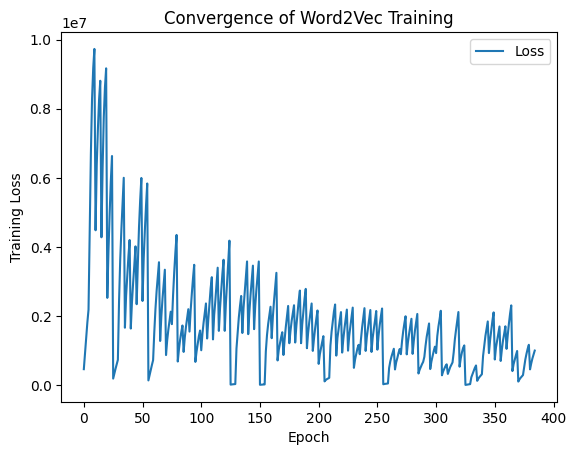

In [ ]:
import os
import zipfile
import json
from gensim.models import Word2Vec
from gensim.models.callbacks import CallbackAny2Vec
import matplotlib.pyplot as plt


# Paths
train_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_train_zips'  # Directory containing training ZIPs
final_model_path = '/content/drive/MyDrive/Final Project DATA SCIENCE/final5_word2vec_model.model'  # Path to save the final trained model

# Parameters for Word2Vec
word2vec_params = {
    'vector_size': 200,  # Embedding dimensions
    'window': 10,         # Context window size
    'min_count': 1,      # Minimum word frequency (decreased min_count to 1)
    'workers': 4,        # Number of CPU cores for parallelization
    'sg': 1,             # Skip-gram method (set to 0 for CBOW)
}

# Custom LossLogger callback to track and log loss
class LossLogger(CallbackAny2Vec):
    def __init__(self):
        self.epoch = 0
        self.losses = []

    def on_epoch_end(self, model):
        loss = model.get_latest_training_loss()
        self.losses.append(loss)
        print(f"Epoch {self.epoch}: Loss = {loss:.4f}")
        self.epoch += 1

loss_logger = LossLogger()

# Initialize a new Word2Vec model
print("Initializing a new Word2Vec model...")
model = Word2Vec(**word2vec_params)

# Training loop
print("Starting training...")
for zip_file in sorted(os.listdir(train_zips_dir)):
    zip_path = os.path.join(train_zips_dir, zip_file)

    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        for json_file in sorted(zip_ref.namelist()):
            print(f"  Loading JSON file: {json_file}...")

            # Extract and load the JSON file
            with zip_ref.open(json_file) as f:
                tokens = json.load(f)

            # Ensure the model's vocabulary is built or updated
            if not model.wv.key_to_index:
                print("  Building vocabulary...")
                model.build_vocab(tokens)
            else:
                print("  Updating vocabulary...")
                model.build_vocab(tokens, update=True)

            # Train the model with explicit callback for loss logging
            print("  Training model on current batch...")
            model.train(
                tokens,
                total_examples=model.corpus_count,
                epochs=5,  # Train for a fixed number of epochs
                compute_loss=True,
                callbacks=[loss_logger]  # Attach the LossLogger
            )

print("Training completed.")

# Save the final model
model.save(final_model_path)
print(f"Final model saved at: {final_model_path}")

# Visualize the loss values
plt.plot(loss_logger.losses, label='Loss')
plt.xlabel('Epoch')
plt.ylabel('Training Loss')
plt.title('Convergence of Word2Vec Training')
plt.legend()
plt.show()


**used CPU/RAM during the word2vec model creation** :

**this model its resources from CPU and doesn't work on GPU, here is a proof for this- **

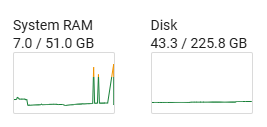

## Validation model - from experiment num.4

In [ ]:
import os
import numpy as np
import pandas as pd
from gensim.models import Word2Vec
from rapidfuzz import fuzz
import time

# Paths
model_path = '/content/drive/MyDrive/Final Project DATA SCIENCE/final5_word2vec_model.model'  # Path to the trained model
ground_truth_path = '/content/formatted_user_artist_weights_subset.csv'  # Path to the ground truth CSV

# Load Word2Vec model
print(f"Loading Word2Vec model from {model_path}...")
model = Word2Vec.load(model_path)
print(f"Vocabulary size: {len(model.wv)}")

# Load ground truth
def load_ground_truth(path, subset_size=None):
    print(f"Loading ground truth from {path}...")
    ground_truth = pd.read_csv(path)
    print(f"Total users in ground truth: {len(ground_truth)}")
    if subset_size:
        ground_truth = ground_truth.sample(n=subset_size, random_state=42)  # Random subset for validation
        print(f"Subset size for validation: {len(ground_truth)}")
    return ground_truth

# Limit to 1,000 users for faster validation
ground_truth_df = load_ground_truth(ground_truth_path, subset_size=1000)

# Prefilter vocabulary for efficiency
model_vocab = set(model.wv.key_to_index.keys())

# Fuzzy matching threshold
threshold = 60

# Validate model recommendations
def validate_recommendations(model, ground_truth_df):
    total_precision = 0
    total_recall = 0
    total_f1 = 0
    valid_recommendations = 0

    start_time = time.time()
    total_users = len(ground_truth_df)

    for idx, row in ground_truth_df.iterrows():
        user_id = row['user_id']
        formatted_tracks = row['formatted_tracklist'].split(',')
        ground_truth_tracks = [track.strip().lower() for track in formatted_tracks]

        # Seed track for the user
        if formatted_tracks:
            seed_track = formatted_tracks[0].strip().lower()

            # Check if the seed track is in the model vocabulary
            if seed_track not in model_vocab:
                continue

            try:
                # Generate recommendations
                recommendations = model.wv.most_similar(seed_track, topn=10)
                recommended_artists = {rec.split(':')[0] for rec, _ in recommendations if ':' in rec}

                # Ground truth artists
                ground_truth_artists = {track.split(':')[0] for track in ground_truth_tracks}

                # Fuzzy matching
                true_positives = sum(
                    any(fuzz.ratio(rec_artist, gt_artist) >= threshold for gt_artist in ground_truth_artists)
                    for rec_artist in recommended_artists
                )

                # Calculate metrics
                precision = true_positives / len(recommended_artists) if recommended_artists else 0
                recall = true_positives / len(ground_truth_artists) if ground_truth_artists else 0
                f1 = (2 * precision * recall / (precision + recall)) if (precision + recall) > 0 else 0

                total_precision += precision
                total_recall += recall
                total_f1 += f1
                valid_recommendations += 1

            except Exception as e:
                print(f"Error processing user {user_id}: {e}")

        # Progress tracking
        if (idx + 1) % 10 == 0 or (idx + 1) == total_users:
            elapsed_time = time.time() - start_time
            print(f"Processed {idx + 1}/{total_users} users. Elapsed time: {elapsed_time:.2f}s")

    # Calculate average metrics
    if valid_recommendations > 0:
        avg_precision = total_precision / valid_recommendations
        avg_recall = total_recall / valid_recommendations
        avg_f1 = total_f1 / valid_recommendations
    else:
        avg_precision = avg_recall = avg_f1 = 0

    # Print final metrics
    print("\n--- Artist-Based Metrics with Fuzzy Matching ---")
    print(f"Average Precision: {avg_precision:.4f}")
    print(f"Average Recall: {avg_recall:.4f}")
    print(f"Average F1-score: {avg_f1:.4f}")

# Run validation
validate_recommendations(model, ground_truth_df)


Loading Word2Vec model from /content/drive/MyDrive/Final Project DATA SCIENCE/final5_word2vec_model.model...
Vocabulary size: 1814866
Loading ground truth from /content/formatted_user_artist_weights_subset.csv...
Total users in ground truth: 565725
Subset size for validation: 1000
Processed 262630/1000 users. Elapsed time: 1.93s
Processed 288980/1000 users. Elapsed time: 2.02s
Processed 118080/1000 users. Elapsed time: 2.47s
Processed 72080/1000 users. Elapsed time: 2.70s
Processed 19110/1000 users. Elapsed time: 3.68s
Processed 263150/1000 users. Elapsed time: 3.90s
Processed 223440/1000 users. Elapsed time: 4.49s
Processed 209120/1000 users. Elapsed time: 4.57s
Processed 560800/1000 users. Elapsed time: 6.43s
Processed 415180/1000 users. Elapsed time: 10.15s
Processed 121970/1000 users. Elapsed time: 12.75s
Processed 105300/1000 users. Elapsed time: 12.97s
Processed 547660/1000 users. Elapsed time: 13.43s
Processed 329490/1000 users. Elapsed time: 13.78s
Processed 535810/1000 users. 

## Train model - experiment num.5

working with CBOW hyper parameter

Initializing a new Word2Vec model...
Starting training...
Processing ZIP file: chunked_zip_10.zip...
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_2.json...
  Building vocabulary...
  Training model on current batch...
Epoch 0: Loss = 42436.8203
Epoch 1: Loss = 84835.5391
Epoch 2: Loss = 127091.0859
Epoch 3: Loss = 169339.3594
Epoch 4: Loss = 211543.0781
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 5: Loss = 724404.7500
Epoch 6: Loss = 1301516.7500
Epoch 7: Loss = 1844052.3750
Epoch 8: Loss = 2424574.0000
Epoch 9: Loss = 2991879.5000
Processing ZIP file: chunked_zip_11.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 10: Loss = 1026664.6875
Epoch 11: Loss = 1719643.5000
Epoch 12: Loss = 2339721.0000
Epoch 13: Loss = 2867502.5000
Epoch 14: Loss = 3370804.5000
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 15: Loss = 1001423.5000
Epoch 16: Loss = 1636657.3750
Epoch 17: Loss = 2179753.5000
Epoch 18: Loss = 2683973.2500
Epoch 19: Loss = 3123281.7500
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 20: Loss = 539130.1875
Epoch 21: Loss = 901274.5000
Epoch 22: Loss = 1227529.8750
Epoch 23: Loss = 1532467.3750
Epoch 24: Loss = 1821876.2500
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 25: Loss = 25447.0039
Epoch 26: Loss = 45043.8555
Epoch 27: Loss = 63324.2891
Epoch 28: Loss = 80713.6562
Epoch 29: Loss = 97819.7344
Processing ZIP file: chunked_zip_12.zip...
  Loading JSON file: artist_tokens_chunk_modified_6_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 30: Loss = 630170.9375
Epoch 31: Loss = 1027631.5625
Epoch 32: Loss = 1350290.6250
Epoch 33: Loss = 1641976.1250
Epoch 34: Loss = 1939404.0000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 35: Loss = 403284.6875
Epoch 36: Loss = 663075.6250
Epoch 37: Loss = 842057.5000
Epoch 38: Loss = 1032947.5625
Epoch 39: Loss = 1217757.0000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 40: Loss = 397329.2812
Epoch 41: Loss = 644961.0000
Epoch 42: Loss = 844707.1875
Epoch 43: Loss = 1035952.2500
Epoch 44: Loss = 1207782.0000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 45: Loss = 588870.8750
Epoch 46: Loss = 985519.4375
Epoch 47: Loss = 1302280.6250
Epoch 48: Loss = 1576111.6250
Epoch 49: Loss = 1871951.5000
  Loading JSON file: artist_tokens_chunk_modified_7_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 50: Loss = 584345.6875
Epoch 51: Loss = 929365.1875
Epoch 52: Loss = 1180142.5000
Epoch 53: Loss = 1447553.7500
Epoch 54: Loss = 1694588.1250
Processing ZIP file: chunked_zip_14.zip...
  Loading JSON file: artist_tokens_chunk_modified_4_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 55: Loss = 35778.1250
Epoch 56: Loss = 67461.7422
Epoch 57: Loss = 98356.1016
Epoch 58: Loss = 128788.2109
Epoch 59: Loss = 158816.2812
  Loading JSON file: artist_tokens_chunk_modified_4_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 60: Loss = 352023.3438
Epoch 61: Loss = 581683.8750
Epoch 62: Loss = 786223.5000
Epoch 63: Loss = 946253.6250
Epoch 64: Loss = 1112218.1250
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 65: Loss = 332453.2188
Epoch 66: Loss = 546951.0000
Epoch 67: Loss = 717644.7500
Epoch 68: Loss = 873446.8750
Epoch 69: Loss = 1022001.1250
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 70: Loss = 238951.1094
Epoch 71: Loss = 364092.6875
Epoch 72: Loss = 478958.5312
Epoch 73: Loss = 582684.7500
Epoch 74: Loss = 681120.0000
Processing ZIP file: chunked_zip_15.zip...
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 75: Loss = 410435.6562
Epoch 76: Loss = 661482.0000
Epoch 77: Loss = 870467.4375
Epoch 78: Loss = 1064771.2500
Epoch 79: Loss = 1262731.6250
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 80: Loss = 187147.0000
Epoch 81: Loss = 271390.2812
Epoch 82: Loss = 344174.8438
Epoch 83: Loss = 431427.9375
Epoch 84: Loss = 504021.3438
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 85: Loss = 275013.4688
Epoch 86: Loss = 427089.8438
Epoch 87: Loss = 555761.0625
Epoch 88: Loss = 673036.0000
Epoch 89: Loss = 789743.5625
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 90: Loss = 350879.5312
Epoch 91: Loss = 572909.7500
Epoch 92: Loss = 751935.6250
Epoch 93: Loss = 927374.4375
Epoch 94: Loss = 1065276.5000
  Loading JSON file: artist_tokens_chunk_modified_5_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 95: Loss = 162770.2344
Epoch 96: Loss = 254316.4531
Epoch 97: Loss = 331171.8125
Epoch 98: Loss = 401958.0312
Epoch 99: Loss = 472842.5625
Processing ZIP file: chunked_zip_16.zip...
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 100: Loss = 275557.3750
Epoch 101: Loss = 430736.1562
Epoch 102: Loss = 556019.6250
Epoch 103: Loss = 665465.8750
Epoch 104: Loss = 778781.1875
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 105: Loss = 348432.0625
Epoch 106: Loss = 537931.0625
Epoch 107: Loss = 698004.0625
Epoch 108: Loss = 834159.1875
Epoch 109: Loss = 970880.3125
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 110: Loss = 316808.0000
Epoch 111: Loss = 521867.2188
Epoch 112: Loss = 691631.8125
Epoch 113: Loss = 844650.4375
Epoch 114: Loss = 999687.6250
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 115: Loss = 372131.0938
Epoch 116: Loss = 568820.9375
Epoch 117: Loss = 752129.8125
Epoch 118: Loss = 924028.2500
Epoch 119: Loss = 1071024.3750
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 120: Loss = 418712.4062
Epoch 121: Loss = 668129.0000
Epoch 122: Loss = 881030.1875
Epoch 123: Loss = 1071772.5000
Epoch 124: Loss = 1240034.8750
  Loading JSON file: artist_tokens_chunk_modified_16_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 125: Loss = 6513.0967
Epoch 126: Loss = 8503.7910
Epoch 127: Loss = 10140.4258
Epoch 128: Loss = 11593.1807
Epoch 129: Loss = 12997.2354
Processing ZIP file: chunked_zip_17.zip...
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 130: Loss = 237944.5938
Epoch 131: Loss = 394407.1562
Epoch 132: Loss = 513958.6875
Epoch 133: Loss = 634964.0625
Epoch 134: Loss = 763140.0625
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 135: Loss = 322823.7500
Epoch 136: Loss = 543812.5625
Epoch 137: Loss = 707320.5000
Epoch 138: Loss = 864674.3125
Epoch 139: Loss = 1002102.1250
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 140: Loss = 374729.2188
Epoch 141: Loss = 576722.6250
Epoch 142: Loss = 775060.6875
Epoch 143: Loss = 934191.1250
Epoch 144: Loss = 1097955.3750
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 145: Loss = 362771.5000
Epoch 146: Loss = 616429.1250
Epoch 147: Loss = 817169.8125
Epoch 148: Loss = 988760.0625
Epoch 149: Loss = 1136002.1250
  Loading JSON file: artist_tokens_chunk_modified_12_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 150: Loss = 4382.3716
Epoch 151: Loss = 5654.7310
Epoch 152: Loss = 6695.4673
Epoch 153: Loss = 7641.6299
Epoch 154: Loss = 8594.8369
Processing ZIP file: chunked_zip_18.zip...
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 155: Loss = 273125.7812
Epoch 156: Loss = 445469.2812
Epoch 157: Loss = 570765.2500
Epoch 158: Loss = 683219.1250
Epoch 159: Loss = 789044.8125
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 160: Loss = 352102.0312
Epoch 161: Loss = 541260.3125
Epoch 162: Loss = 708423.3125
Epoch 163: Loss = 850738.5625
Epoch 164: Loss = 986553.6250
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 165: Loss = 163715.1094
Epoch 166: Loss = 255352.9062
Epoch 167: Loss = 334272.7500
Epoch 168: Loss = 397955.5938
Epoch 169: Loss = 462436.9062
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 170: Loss = 206556.2812
Epoch 171: Loss = 335048.2812
Epoch 172: Loss = 440121.4062
Epoch 173: Loss = 538610.5625
Epoch 174: Loss = 630091.1250
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 175: Loss = 251974.4531
Epoch 176: Loss = 395314.4375
Epoch 177: Loss = 519679.5000
Epoch 178: Loss = 625766.1875
Epoch 179: Loss = 736975.0000
Processing ZIP file: chunked_zip_19.zip...
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 180: Loss = 309250.5000
Epoch 181: Loss = 466803.8438
Epoch 182: Loss = 604561.3750
Epoch 183: Loss = 741123.5625
Epoch 184: Loss = 860571.6875
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 185: Loss = 309983.2500
Epoch 186: Loss = 473573.8125
Epoch 187: Loss = 621137.6250
Epoch 188: Loss = 760200.1875
Epoch 189: Loss = 890440.8125
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 190: Loss = 228280.2031
Epoch 191: Loss = 369382.7812
Epoch 192: Loss = 485239.1250
Epoch 193: Loss = 592204.6250
Epoch 194: Loss = 692491.8750
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 195: Loss = 230362.8750
Epoch 196: Loss = 367609.0312
Epoch 197: Loss = 480467.5312
Epoch 198: Loss = 590849.5625
Epoch 199: Loss = 696097.6250
  Loading JSON file: artist_tokens_chunk_modified_19_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 200: Loss = 143470.7500
Epoch 201: Loss = 226451.0938
Epoch 202: Loss = 296328.6562
Epoch 203: Loss = 360043.5625
Epoch 204: Loss = 421972.9688
  Loading JSON file: artist_tokens_chunk_modified_3_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 205: Loss = 19331.5312
Epoch 206: Loss = 26580.0684
Epoch 207: Loss = 35088.4922
Epoch 208: Loss = 41579.6797
Epoch 209: Loss = 48449.3047
Processing ZIP file: chunked_zip_2.zip...
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 210: Loss = 267699.5625
Epoch 211: Loss = 443213.1562
Epoch 212: Loss = 564599.1875
Epoch 213: Loss = 676863.5000
Epoch 214: Loss = 780821.1250
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 215: Loss = 204093.7031
Epoch 216: Loss = 320017.8438
Epoch 217: Loss = 411767.9062
Epoch 218: Loss = 501375.9062
Epoch 219: Loss = 577696.1875
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 220: Loss = 260385.7969
Epoch 221: Loss = 395539.3125
Epoch 222: Loss = 505139.0000
Epoch 223: Loss = 601438.2500
Epoch 224: Loss = 703093.5625
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 225: Loss = 261077.4219
Epoch 226: Loss = 408587.0625
Epoch 227: Loss = 542764.7500
Epoch 228: Loss = 654237.4375
Epoch 229: Loss = 750459.6250
  Loading JSON file: artist_tokens_chunk_modified_15_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 230: Loss = 128888.4688
Epoch 231: Loss = 210426.8906
Epoch 232: Loss = 268193.3438
Epoch 233: Loss = 315994.1562
Epoch 234: Loss = 360427.8438
Processing ZIP file: chunked_zip_20.zip...
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 235: Loss = 231426.6562
Epoch 236: Loss = 370282.7500
Epoch 237: Loss = 490360.5000
Epoch 238: Loss = 614754.3750
Epoch 239: Loss = 714691.6250
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 240: Loss = 258843.7812
Epoch 241: Loss = 402251.7500
Epoch 242: Loss = 507461.5312
Epoch 243: Loss = 600498.9375
Epoch 244: Loss = 687675.8750
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 245: Loss = 246583.2812
Epoch 246: Loss = 385223.2188
Epoch 247: Loss = 494987.2500
Epoch 248: Loss = 595081.0000
Epoch 249: Loss = 697364.5000
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 250: Loss = 266275.7188
Epoch 251: Loss = 416937.5938
Epoch 252: Loss = 529595.6250
Epoch 253: Loss = 620731.6875
Epoch 254: Loss = 718129.4375
  Loading JSON file: artist_tokens_chunk_modified_18_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 255: Loss = 7290.9106
Epoch 256: Loss = 10755.2939
Epoch 257: Loss = 13444.1680
Epoch 258: Loss = 15792.0234
Epoch 259: Loss = 17991.5586
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 260: Loss = 108603.4922
Epoch 261: Loss = 171364.9062
Epoch 262: Loss = 221390.8438
Epoch 263: Loss = 268334.9062
Epoch 264: Loss = 315555.9375
Processing ZIP file: chunked_zip_21.zip...
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 265: Loss = 114401.3359
Epoch 266: Loss = 173899.2500
Epoch 267: Loss = 239910.1875
Epoch 268: Loss = 293488.5000
Epoch 269: Loss = 334107.2188
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 270: Loss = 242749.9531
Epoch 271: Loss = 377358.9062
Epoch 272: Loss = 499818.8125
Epoch 273: Loss = 596450.3125
Epoch 274: Loss = 696426.0000
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 275: Loss = 216702.6875
Epoch 276: Loss = 336906.7188
Epoch 277: Loss = 441988.7500
Epoch 278: Loss = 535896.7500
Epoch 279: Loss = 631833.6250
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 280: Loss = 232933.5312
Epoch 281: Loss = 393870.5938
Epoch 282: Loss = 507136.6562
Epoch 283: Loss = 622342.3750
Epoch 284: Loss = 715990.8750
  Loading JSON file: artist_tokens_chunk_modified_9_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 285: Loss = 66283.0469
Epoch 286: Loss = 104285.3047
Epoch 287: Loss = 138895.8438
Epoch 288: Loss = 168929.5312
Epoch 289: Loss = 195555.7188
Processing ZIP file: chunked_zip_3.zip...
  Loading JSON file: artist_tokens_chunk_modified_10_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 290: Loss = 192069.2500
Epoch 291: Loss = 297719.2188
Epoch 292: Loss = 396205.4688
Epoch 293: Loss = 479287.6875
Epoch 294: Loss = 554903.0625
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 295: Loss = 132331.9844
Epoch 296: Loss = 206808.6406
Epoch 297: Loss = 268838.4688
Epoch 298: Loss = 316812.4688
Epoch 299: Loss = 367705.9688
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 300: Loss = 220439.2188
Epoch 301: Loss = 334951.4062
Epoch 302: Loss = 423281.2500
Epoch 303: Loss = 526606.6875
Epoch 304: Loss = 606490.3750
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_3.json...


  Updating vocabulary...
  Training model on current batch...
Epoch 305: Loss = 72603.8594
Epoch 306: Loss = 118129.3516
Epoch 307: Loss = 148327.3594
Epoch 308: Loss = 174427.2656
Epoch 309: Loss = 201376.7188
  Loading JSON file: artist_tokens_chunk_modified_8_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 310: Loss = 76494.4609
Epoch 311: Loss = 109515.0703
Epoch 312: Loss = 144208.7656
Epoch 313: Loss = 172695.7969
Epoch 314: Loss = 197185.1094
Processing ZIP file: chunked_zip_6.zip...
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 315: Loss = 259542.4844
Epoch 316: Loss = 394138.9688
Epoch 317: Loss = 509219.8750
Epoch 318: Loss = 605046.7500
Epoch 319: Loss = 692351.8750
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 320: Loss = 97080.5469
Epoch 321: Loss = 161819.5938
Epoch 322: Loss = 215440.9062
Epoch 323: Loss = 259616.4531
Epoch 324: Loss = 300204.0938
  Loading JSON file: artist_tokens_chunk_modified_14_chunk_6.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 325: Loss = 3536.0347
Epoch 326: Loss = 6117.6709
Epoch 327: Loss = 8423.4883
Epoch 328: Loss = 10027.3926
Epoch 329: Loss = 12152.2598
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 330: Loss = 83006.9688
Epoch 331: Loss = 125287.2031
Epoch 332: Loss = 155054.4688
Epoch 333: Loss = 189394.3438
Epoch 334: Loss = 221460.8906
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 335: Loss = 18722.3086
Epoch 336: Loss = 30787.1602
Epoch 337: Loss = 41055.3672
Epoch 338: Loss = 50311.9883
Epoch 339: Loss = 58973.9844
  Loading JSON file: artist_tokens_chunk_modified_1_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 340: Loss = 233370.2656
Epoch 341: Loss = 357691.9062
Epoch 342: Loss = 456507.8750
Epoch 343: Loss = 549633.3125
Epoch 344: Loss = 634058.0625
Processing ZIP file: chunked_zip_8.zip...
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 345: Loss = 230095.0312
Epoch 346: Loss = 358436.4375
Epoch 347: Loss = 474254.6875
Epoch 348: Loss = 583303.5625
Epoch 349: Loss = 674738.7500
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 350: Loss = 226660.4219
Epoch 351: Loss = 359317.8438
Epoch 352: Loss = 462621.8750
Epoch 353: Loss = 556636.6875
Epoch 354: Loss = 627898.9375
  Loading JSON file: artist_tokens_chunk_modified_13_chunk_5.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 355: Loss = 194626.4219
Epoch 356: Loss = 322617.4688
Epoch 357: Loss = 417181.2500
Epoch 358: Loss = 504133.3750
Epoch 359: Loss = 589562.8750
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 360: Loss = 256848.7344
Epoch 361: Loss = 403190.5938
Epoch 362: Loss = 525319.7500
Epoch 363: Loss = 629149.9375
Epoch 364: Loss = 726809.9375
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_2.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 365: Loss = 111580.4453
Epoch 366: Loss = 168410.3281
Epoch 367: Loss = 219610.2031
Epoch 368: Loss = 264304.7188
Epoch 369: Loss = 311128.3750
Processing ZIP file: chunked_zip_9.zip...
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_3.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 370: Loss = 27079.8984
Epoch 371: Loss = 49465.2227
Epoch 372: Loss = 69262.1641
Epoch 373: Loss = 87333.9922
Epoch 374: Loss = 104366.7578
  Loading JSON file: artist_tokens_chunk_modified_17_chunk_4.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 375: Loss = 131348.8594
Epoch 376: Loss = 212579.0625
Epoch 377: Loss = 284683.1875
Epoch 378: Loss = 338239.1875
Epoch 379: Loss = 391651.7500
  Loading JSON file: artist_tokens_chunk_modified_2_chunk_1.json...
  Updating vocabulary...


  Training model on current batch...
Epoch 380: Loss = 115096.2969
Epoch 381: Loss = 181081.5938
Epoch 382: Loss = 244649.8594
Epoch 383: Loss = 297553.0000
Epoch 384: Loss = 347847.8125
Training completed.
Final model saved at: /content/drive/MyDrive/Final Project DATA SCIENCE/final6_word2vec_model.model


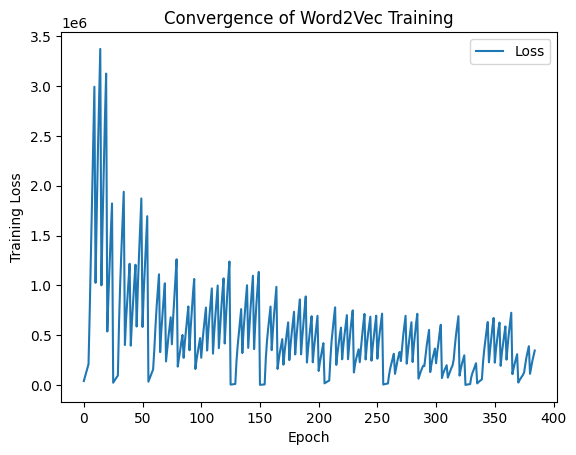

In [2]:
import os
import zipfile
import json
from gensim.models import Word2Vec
from gensim.models.callbacks import CallbackAny2Vec
import matplotlib.pyplot as plt


# Paths
train_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_train_zips'  # Directory containing training ZIPs
final_model_path = '/content/drive/MyDrive/Final Project DATA SCIENCE/final6_word2vec_model.model'  # Path to save the final trained model

# Parameters for Word2Vec
word2vec_params = {
    'vector_size': 200,  # Embedding dimensions
    'window': 10,         # Context window size
    'min_count': 2,      # Minimum word frequency (decreased min_count to 1)
    'workers': 4,        # Number of CPU cores for parallelization
    'sg': 0,             # Skip-gram method (set to 0 for CBOW)
}

# Custom LossLogger callback to track and log loss
class LossLogger(CallbackAny2Vec):
    def __init__(self):
        self.epoch = 0
        self.losses = []

    def on_epoch_end(self, model):
        loss = model.get_latest_training_loss()
        self.losses.append(loss)
        print(f"Epoch {self.epoch}: Loss = {loss:.4f}")
        self.epoch += 1

loss_logger = LossLogger()

# Initialize a new Word2Vec model
print("Initializing a new Word2Vec model...")
model = Word2Vec(**word2vec_params)

# Training loop
print("Starting training...")
for zip_file in sorted(os.listdir(train_zips_dir)):
    zip_path = os.path.join(train_zips_dir, zip_file)

    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        for json_file in sorted(zip_ref.namelist()):
            print(f"  Loading JSON file: {json_file}...")

            # Extract and load the JSON file
            with zip_ref.open(json_file) as f:
                tokens = json.load(f)

            # Ensure the model's vocabulary is built or updated
            if not model.wv.key_to_index:
                print("  Building vocabulary...")
                model.build_vocab(tokens)
            else:
                print("  Updating vocabulary...")
                model.build_vocab(tokens, update=True)

            # Train the model with explicit callback for loss logging
            print("  Training model on current batch...")
            model.train(
                tokens,
                total_examples=model.corpus_count,
                epochs=5,  # Train for a fixed number of epochs
                compute_loss=True,
                callbacks=[loss_logger]  # Attach the LossLogger
            )

print("Training completed.")

# Save the final model
model.save(final_model_path)
print(f"Final model saved at: {final_model_path}")

# Visualize the loss values
plt.plot(loss_logger.losses, label='Loss')
plt.xlabel('Epoch')
plt.ylabel('Training Loss')
plt.title('Convergence of Word2Vec Training')
plt.legend()
plt.show()


## Validation model - from experiment num.5

In [5]:
import os
import numpy as np
import pandas as pd
from gensim.models import Word2Vec
from rapidfuzz import fuzz
import time

# Paths
model_path = '/content/drive/MyDrive/Final Project DATA SCIENCE/final6_word2vec_model.model'  # Path to the trained model
ground_truth_path = '/content/formatted_user_artist_weights_subset.csv'  # Path to the ground truth CSV

# Load Word2Vec model
print(f"Loading Word2Vec model from {model_path}...")
model = Word2Vec.load(model_path)
print(f"Vocabulary size: {len(model.wv)}")

# Load ground truth
def load_ground_truth(path, subset_size=None):
    print(f"Loading ground truth from {path}...")
    ground_truth = pd.read_csv(path)
    print(f"Total users in ground truth: {len(ground_truth)}")
    if subset_size:
        ground_truth = ground_truth.sample(n=subset_size, random_state=42)  # Random subset for validation
        print(f"Subset size for validation: {len(ground_truth)}")
    return ground_truth

# Limit to 1,000 users for faster validation
ground_truth_df = load_ground_truth(ground_truth_path, subset_size=1000)

# Prefilter vocabulary for efficiency
model_vocab = set(model.wv.key_to_index.keys())

# Fuzzy matching threshold
threshold = 60

# Validate model recommendations
def validate_recommendations(model, ground_truth_df):
    total_precision = 0
    total_recall = 0
    total_f1 = 0
    valid_recommendations = 0

    start_time = time.time()
    total_users = len(ground_truth_df)

    for idx, row in ground_truth_df.iterrows():
        user_id = row['user_id']
        formatted_tracks = row['formatted_tracklist'].split(',')
        ground_truth_tracks = [track.strip().lower() for track in formatted_tracks]

        # Seed track for the user
        if formatted_tracks:
            seed_track = formatted_tracks[0].strip().lower()

            # Check if the seed track is in the model vocabulary
            if seed_track not in model_vocab:
                continue

            try:
                # Generate recommendations
                recommendations = model.wv.most_similar(seed_track, topn=10)
                recommended_artists = {rec.split(':')[0] for rec, _ in recommendations if ':' in rec}

                # Ground truth artists
                ground_truth_artists = {track.split(':')[0] for track in ground_truth_tracks}

                # Fuzzy matching
                true_positives = sum(
                    any(fuzz.ratio(rec_artist, gt_artist) >= threshold for gt_artist in ground_truth_artists)
                    for rec_artist in recommended_artists
                )

                # Calculate metrics
                precision = true_positives / len(recommended_artists) if recommended_artists else 0
                recall = true_positives / len(ground_truth_artists) if ground_truth_artists else 0
                f1 = (2 * precision * recall / (precision + recall)) if (precision + recall) > 0 else 0

                total_precision += precision
                total_recall += recall
                total_f1 += f1
                valid_recommendations += 1

            except Exception as e:
                print(f"Error processing user {user_id}: {e}")

        # Progress tracking
        if (idx + 1) % 10 == 0 or (idx + 1) == total_users:
            elapsed_time = time.time() - start_time
            print(f"Processed {idx + 1}/{total_users} users. Elapsed time: {elapsed_time:.2f}s")

    # Calculate average metrics
    if valid_recommendations > 0:
        avg_precision = total_precision / valid_recommendations
        avg_recall = total_recall / valid_recommendations
        avg_f1 = total_f1 / valid_recommendations
    else:
        avg_precision = avg_recall = avg_f1 = 0

    # Print final metrics
    print("\n--- Artist-Based Metrics with Fuzzy Matching ---")
    print(f"Average Precision: {avg_precision:.4f}")
    print(f"Average Recall: {avg_recall:.4f}")
    print(f"Average F1-score: {avg_f1:.4f}")

# Run validation
validate_recommendations(model, ground_truth_df)


Loading Word2Vec model from /content/drive/MyDrive/Final Project DATA SCIENCE/final6_word2vec_model.model...
Vocabulary size: 1577269
Loading ground truth from /content/formatted_user_artist_weights_subset.csv...
Total users in ground truth: 565725
Subset size for validation: 1000
Processed 262630/1000 users. Elapsed time: 0.74s
Processed 288980/1000 users. Elapsed time: 0.79s
Processed 118080/1000 users. Elapsed time: 1.09s
Processed 72080/1000 users. Elapsed time: 1.23s
Processed 19110/1000 users. Elapsed time: 1.78s
Processed 263150/1000 users. Elapsed time: 1.95s
Processed 223440/1000 users. Elapsed time: 2.30s
Processed 209120/1000 users. Elapsed time: 2.36s
Processed 560800/1000 users. Elapsed time: 3.50s
Processed 415180/1000 users. Elapsed time: 5.26s
Processed 121970/1000 users. Elapsed time: 6.59s
Processed 105300/1000 users. Elapsed time: 6.70s
Processed 547660/1000 users. Elapsed time: 6.98s
Processed 329490/1000 users. Elapsed time: 7.21s
Processed 535810/1000 users. Elaps

# Ground Truth visual

In [ ]:
import pandas as pd

# Path to the ground truth file
ground_truth_path = '/content/formatted_user_artist_weights_subset.csv'

# Read the CSV file into a DataFrame
try:
    ground_truth_df = pd.read_csv(ground_truth_path)
    print("Ground truth file loaded successfully!")

    # Display the first few rows of the DataFrame
    print("First few rows of the ground truth file:")
    print(ground_truth_df.head())

    # Display the column names
    print("\nAvailable columns in the ground truth file:")
    print(ground_truth_df.columns)

except FileNotFoundError:
    print(f"Error: File not found at path {ground_truth_path}")
except Exception as e:
    print(f"An error occurred: {e}")


Ground truth file loaded successfully!
First few rows of the ground truth file:
                            user_id    artistname  \
0  08a3dd94322323c88687ed1989e9fd63      damabiah   
1  e4142e55dc359036eb4101073de363fc  the blizzard   
2  11ed7eb33791f3cb8f75a815e551f0f2   emancipator   
3  025c0e6fcaec5cb596c2f1ae7d031ff1      four tet   
4  4d6716b2f62d33d57737436afdac0e96         keedz   

                                           tracklist  user_weight  \
0          ['irminsul le pilier du monde 2014 edit']     0.145865   
1  ['made for you asot 599  club mix', 'piercing ...     0.141421   
2  ['black lake', 'first snow ooah remix', 'never...     0.158114   
3                     ['love cry joy orbison remix']     0.229416   
4  ['stand on the word  mima remix radio edit', '...     0.141421   

   combined_weight                                formatted_tracklist  
0         0.093244     damabiah:irminsul le pilier du monde 2014 edit  
1         0.178638  the blizzard:made for 

# Options for Recommender System of word2vec

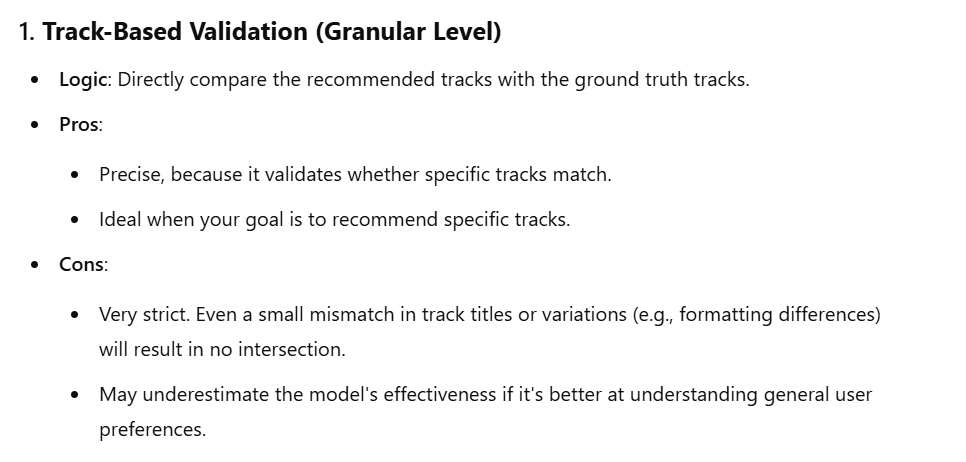

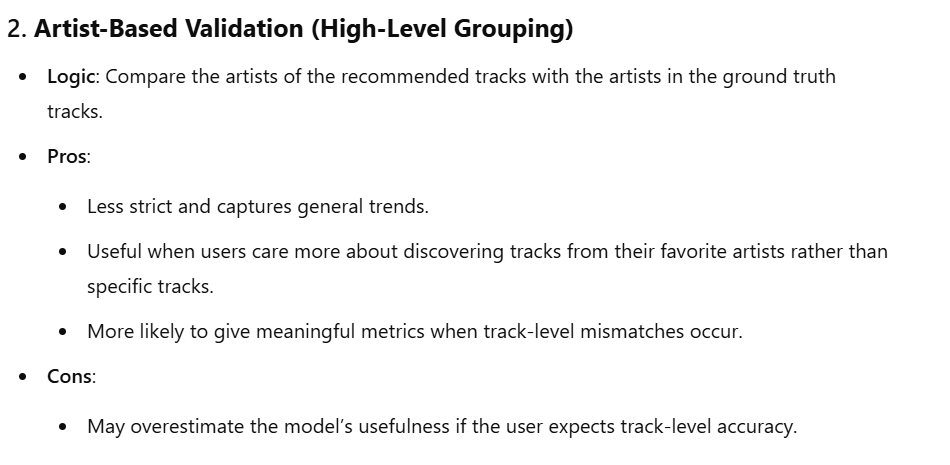

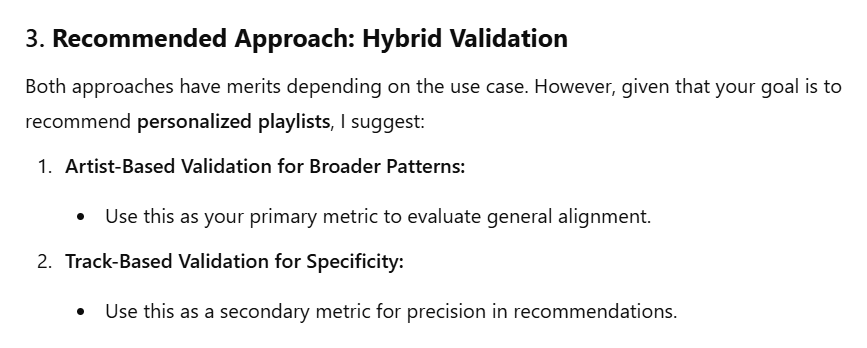

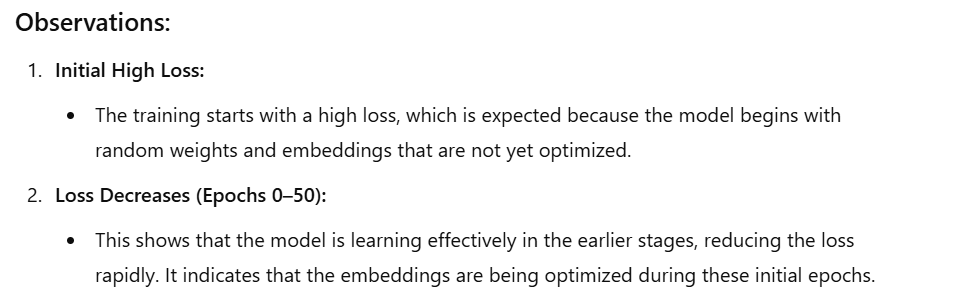

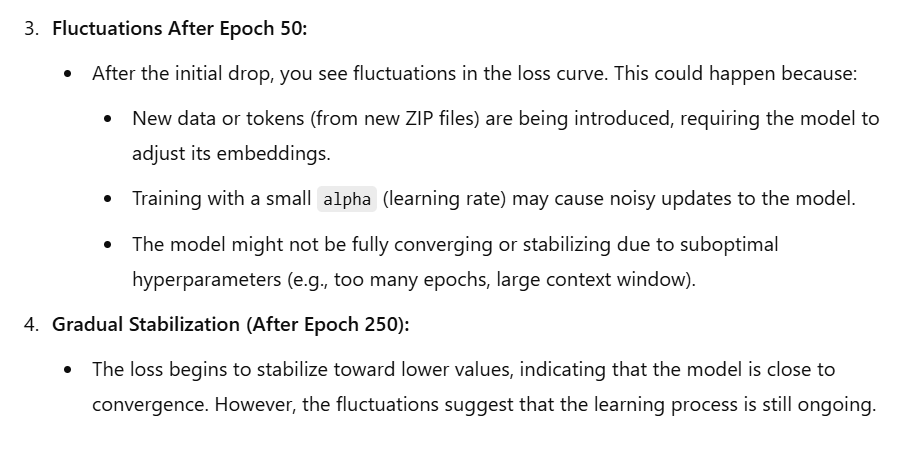

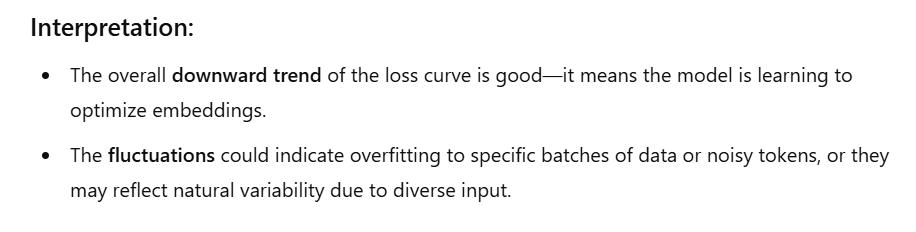

# Explanation about WORD2VEC model files

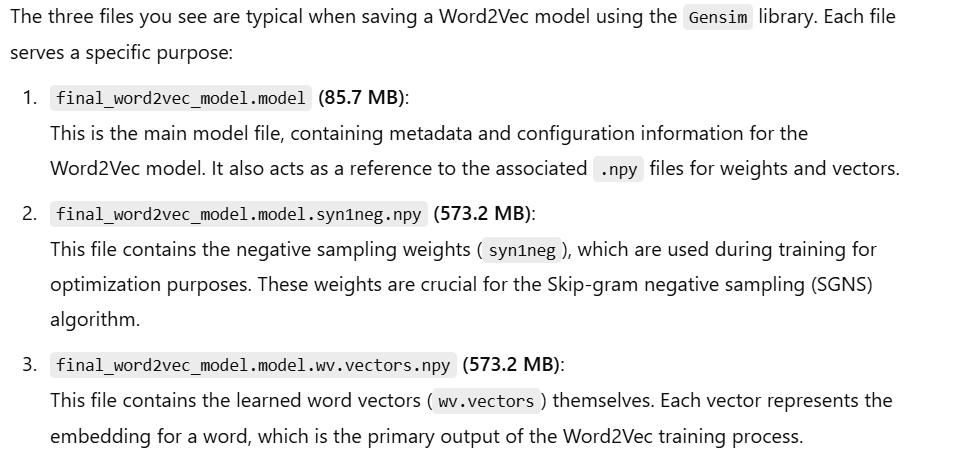

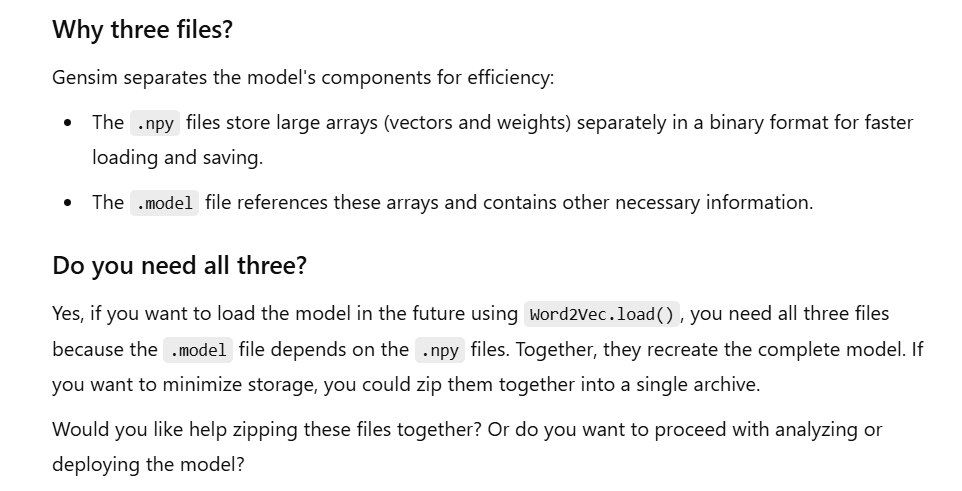

## Model trained files saved into zip file

In [ ]:
import zipfile
import os

# Paths to the files you want to zip
model_files = [
    '/content/drive/MyDrive/Final Project DATA SCIENCE/final_word2vec_model.model',
    '/content/drive/MyDrive/Final Project DATA SCIENCE/final_word2vec_model.model.syn1neg.npy',
    '/content/drive/MyDrive/Final Project DATA SCIENCE/final_word2vec_model.model.wv.vectors.npy'
]

# Path to save the ZIP file in the current directory
output_zip_path = './final_word2vec_model.zip'

# Create a ZIP file and add the model files
with zipfile.ZipFile(output_zip_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
    for file_path in model_files:
        # Add the file to the zip with just the filename (no directory structure)
        zipf.write(file_path, os.path.basename(file_path))

print(f"Model files zipped to: {output_zip_path}")


Model files zipped to: ./final_word2vec_model.zip


In [ ]:
import zipfile

# Path to the downloaded ZIP file
zip_file_path = 'final_word2vec_model.zip'
extract_to_path = 'final_word2vec_model_files/'  # Directory to extract files

# Extract the ZIP file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to_path)

print("Extraction completed!")

Extraction completed!


# Direct link to 'final_word2vec_model.zip' containing 3 model files after training (as explained before)

In [ ]:
import gdown
import pandas as pd

# Define the Google Drive file ID
file_id = '1RndhXlOfRrJPLkgOhM2nAfNhRSi_eChM'
# Construct the download URL
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output CSV file path
output_csv_path = 'final_word2vec_model.zip'

# Download the file using gdown
gdown.download(download_url, output_csv_path, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?export=download&id=1RndhXlOfRrJPLkgOhM2nAfNhRSi_eChM
From (redirected): https://drive.google.com/uc?export=download&id=1RndhXlOfRrJPLkgOhM2nAfNhRSi_eChM&confirm=t&uuid=714feb48-d0d4-409e-97eb-4646baf6171b
To: /content/final_word2vec_model.zip
100%|██████████| 1.14G/1.14G [00:09<00:00, 126MB/s]


'final_word2vec_model.zip'

Extract the files here:

In [ ]:
import zipfile

# Path to the downloaded ZIP file
zip_file_path = 'final_word2vec_model.zip'
extract_to_path = 'final_word2vec_model_files/'  # Directory to extract files

# Extract the ZIP file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to_path)

print("Extraction completed!")

Extraction completed!


In [ ]:
import os
from gensim.models import Word2Vec

# Path to the directory containing the model files
model_dir = '/content/final_word2vec_model_files/'  # Adjust this if needed

# Path to the model file
model_path = os.path.join(model_dir, 'final_word2vec_model.model')

# Check if the model file exists
if os.path.exists(model_path):
    # Load the Word2Vec model
    print(f"Loading Word2Vec model from {model_path}...")
    model = Word2Vec.load(model_path)
    print("Model successfully loaded.")
else:
    raise FileNotFoundError(f"Model file not found at {model_path}. Please check the folder and file name.")

# Display basic information about the model
print(f"Vocabulary size: {len(model.wv.index_to_key)}")


Loading Word2Vec model from /content/final_word2vec_model_files/final_word2vec_model.model...
Model successfully loaded.
Vocabulary size: 1502734


In [ ]:
# Get the first 10 words in the vocabulary
print("First 10 words in the vocabulary:")
print(model.wv.index_to_key[:10])


First 10 words in the vocabulary:
['sonata arctica:fullmoon', 'sonata arctica:land of the free', 'sonata arctica:last drop falls', 'sonata arctica:weballergy', 'sonata arctica:tallulah', 'sonata arctica:false news travel fast', 'sonata arctica:blinded no more', 'sonata arctica:paid in full', 'sonata arctica:of silence', 'sonata arctica:the power of one']


# Steps to Validate the Word2Vec Model Using user_artist_weights.csv

In [ ]:
import gdown
import pandas as pd

# Define the Google Drive file ID
file_id = '1A3N2QnJc6YzHRyUOYw9PkpRMKZhvr8MJ'
# Construct the download URL
download_url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output CSV file path
output_csv_path = 'user_artist_weights.csv'
# Download the file using gdown
gdown.download(download_url, output_csv_path, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?export=download&id=1A3N2QnJc6YzHRyUOYw9PkpRMKZhvr8MJ
From (redirected): https://drive.google.com/uc?export=download&id=1A3N2QnJc6YzHRyUOYw9PkpRMKZhvr8MJ&confirm=t&uuid=1a20c9c2-bfbc-4472-8938-e84f74436e8a
To: /content/user_artist_weights.csv
100%|██████████| 464M/464M [00:07<00:00, 62.9MB/s]


'user_artist_weights.csv'

turned to user_artist_weights.csv into a file that will resemble the tokens given to the word2vec model, because the metric (f1 score, recall) showed 0 during validation (after creating the model).

In [ ]:
# Load the final saved file
df_ground_truth = pd.read_csv('formatted_user_artist_weights.csv')

FileNotFoundError: [Errno 2] No such file or directory: 'formatted_user_artist_weights.csv'

In [ ]:
import pandas as pd

# Path to the user_artist_weights.csv
csv_path = '/content/user_artist_weights.csv'

# Load the CSV
user_data = pd.read_csv(csv_path)

# Display the first few rows before transformation
print("Before formatting:")
print(user_data.head())

# Ensure 'tracklist' exists and transform tracks to 'artist:track' format
def format_tracklist(row):
    artist = row['artistname']
    try:
        # Convert tracklist from string to a list if needed
        tracks = eval(row['tracklist']) if isinstance(row['tracklist'], str) else row['tracklist']
        formatted_tracks = [f"{artist}:{track}" for track in tracks]
        return ','.join(formatted_tracks)  # Convert back to a comma-separated string
    except Exception as e:
        print(f"Error processing row: {row}, Error: {e}")
        return None

# Apply the transformation
user_data['formatted_tracklist'] = user_data.apply(format_tracklist, axis=1)

# Save the updated CSV
formatted_csv_path = '/content/formatted_user_artist_weights.csv'
user_data.to_csv(formatted_csv_path, index=False)

# Display the first few rows after transformation
print("\nAfter formatting:")
print(user_data[['user_id', 'artistname', 'formatted_tracklist']].head())

print(f"\nFormatted CSV saved at: {formatted_csv_path}")


Before formatting:
                            user_id           artistname  \
0  00055176fea33f6e027cd3302289378b  5 seconds of summer   
1  00055176fea33f6e027cd3302289378b      abigail breslin   
2  00055176fea33f6e027cd3302289378b  against the current   
3  00055176fea33f6e027cd3302289378b         all time low   
4  00055176fea33f6e027cd3302289378b                auryn   

                                           tracklist  user_weight  \
0  ['disconnected', 'dont stop  acoustic', 'engli...          1.0   
1                                       ['you suck']          1.0   
2  ['another you another way', 'closer faster', '...          1.0   
3  ['backseat serenade', 'break your little heart...          1.0   
4                            ['saturday im in love']          1.0   

   combined_weight  
0         5.456435  
1         0.545644  
2         1.636931  
3         4.365148  
4         0.545644  

After formatting:
                            user_id           artistname  \


In [ ]:
import pandas as pd

# Path to the CSV file
csv_path = '/content/formatted_user_artist_weights.csv'

# Load the CSV into a DataFrame
user_artist_weights = pd.read_csv(csv_path)

# Preview the data
print("Sample of the ground truth data:")
print(user_artist_weights.head())


Sample of the ground truth data:
                            user_id           artistname  \
0  00055176fea33f6e027cd3302289378b  5 seconds of summer   
1  00055176fea33f6e027cd3302289378b      abigail breslin   
2  00055176fea33f6e027cd3302289378b  against the current   
3  00055176fea33f6e027cd3302289378b         all time low   
4  00055176fea33f6e027cd3302289378b                auryn   

                                           tracklist  user_weight  \
0  ['disconnected', 'dont stop  acoustic', 'engli...          1.0   
1                                       ['you suck']          1.0   
2  ['another you another way', 'closer faster', '...          1.0   
3  ['backseat serenade', 'break your little heart...          1.0   
4                            ['saturday im in love']          1.0   

   combined_weight                                formatted_tracklist  
0         5.456435  5 seconds of summer:disconnected,5 seconds of ...  
1         0.545644                           ab

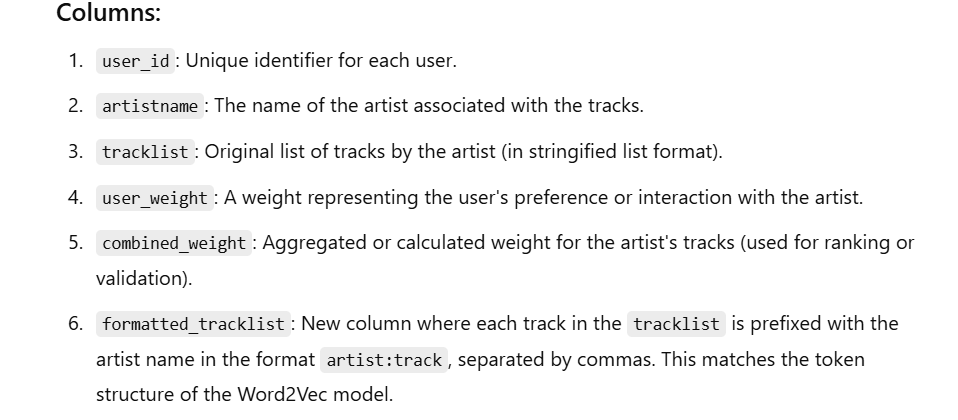

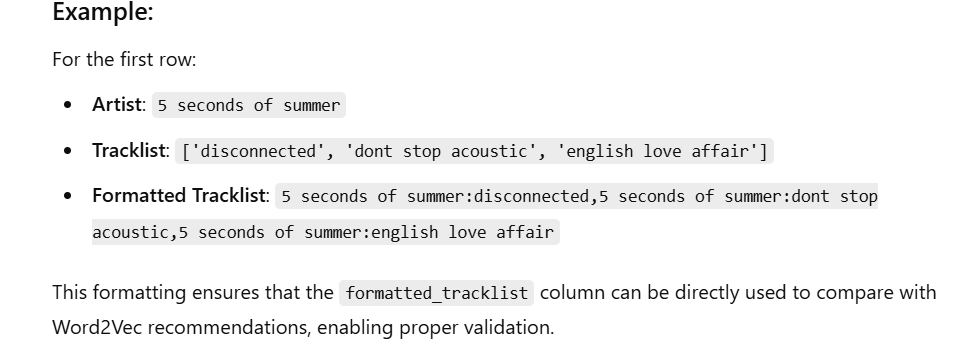

## Extract User Preferences

In [ ]:
# Get top artists for a specific user
user_id = '9cc0cfd4d7d7885102480dd99e7a90d6'  # Replace with an actual user_id
user_data = user_artist_weights[user_artist_weights['user_id'] == user_id]

print(f"User {user_id} preferences:")
print(user_data[['artistname', 'tracklist', 'combined_weight']])


User 9cc0cfd4d7d7885102480dd99e7a90d6 preferences:
                                artistname  \
1751832                        biffy clyro   
1751833                  bruce springsteen   
1751834                  cocktail slippers   
1751835                crosby stills  nash   
1751836                      crowded house   
1751837                              elbow   
1751838                     elvis costello   
1751839    elvis costello  the attractions   
1751840                           joe echo   
1751841                       joshua radin   
1751842                             lissie   
1751843                            madness   
1751844                         miles kane   
1751845                 noah and the whale   
1751846  noel gallaghers high flying birds   
1751847                              oasis   
1751848                     paul mccartney   
1751849       paul mccartney  eric clapton   
1751850                          pearl jam   
1751851                      

## Generate Recommendations Using Word2Vec

Use the trained Word2Vec model to recommend similar tracks or artists.



In [ ]:
# Replace with an artist:track from the user's tracklist
seed_token = 'adele:someone like you'

try:
    recommendations = model.wv.most_similar(seed_token, topn=10)
    print(f"Recommendations for '{seed_token}':")
    for rec, sim in recommendations:
        print(f"{rec}: {sim:.4f}")
except KeyError:
    print(f"'{seed_token}' not found in the vocabulary.")


Recommendations for 'adele:someone like you':
adele:set fire to the rain: 0.9951
adele:turning tables: 0.9948
adele:rolling in the deep: 0.9947
adele:rumour has it: 0.9910
adele:take it all: 0.9909
adele:one and only: 0.9893
adele:dont you remember: 0.9880
adele:he wont go: 0.9866
adele:lovesong: 0.9866
adele:make you feel my love album: 0.9857


## Compare Recommendations with Ground Truth

I can calculate precision, recall, and F1-score based on the overlap between the model's recommendations and the ground truth.

In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score

# Example: Ground truth tracks for validation
# Using the formatted_tracklist column
ground_truth_tracks = user_data['formatted_tracklist'].iloc[0].split(',')

# Model recommendations (extract artist:track pairs directly)
recommended_tracks = [rec for rec, _ in recommendations]  # Already in artist:track format

# Calculate metrics
intersection = set(recommended_tracks) & set(ground_truth_tracks)
precision = len(intersection) / len(recommended_tracks) if len(recommended_tracks) > 0 else 0
recall = len(intersection) / len(ground_truth_tracks) if len(ground_truth_tracks) > 0 else 0

print(intersection)
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
if precision + recall > 0:
    f1 = 2 * (precision * recall) / (precision + recall)
    print(f"F1-score: {f1:.4f}")
else:
    print("F1-score: Undefined (zero precision and recall)")


set()
Precision: 0.0000
Recall: 0.0000
F1-score: Undefined (zero precision and recall)


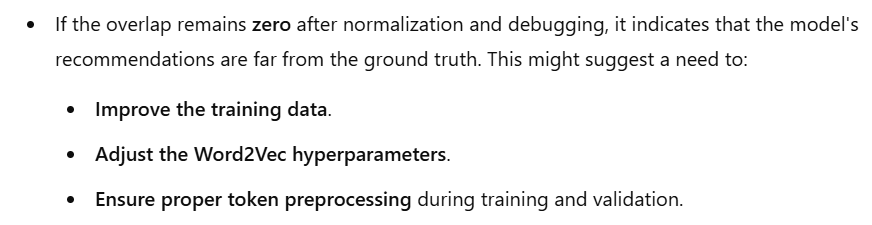

## Debug and Fix to understand why metrics are zero

In [ ]:
# Normalize ground truth and recommendations
ground_truth_tracks = [track.strip().lower() for track in user_data['formatted_tracklist'].iloc[0].split(',')]
recommended_tracks = [rec.strip().lower() for rec, _ in recommendations]

# Calculate intersection
intersection = set(recommended_tracks) & set(ground_truth_tracks)


In [ ]:
seed_token = ground_truth_tracks[0]  # Use the first ground truth track as seed


In [ ]:
print("Ground truth tracks:", ground_truth_tracks)
print("Recommended tracks:", recommended_tracks)
print("Intersection:", set(recommended_tracks) & set(ground_truth_tracks))


Ground truth tracks: ['biffy clyro:god  satan', 'biffy clyro:many of horror', 'biffy clyro:mountains', 'biffy clyro:the captain']
Recommended tracks: ['adele:set fire to the rain', 'adele:turning tables', 'adele:rolling in the deep', 'adele:rumour has it', 'adele:take it all', 'adele:one and only', 'adele:dont you remember', 'adele:he wont go', 'adele:lovesong', 'adele:make you feel my love album']
Intersection: set()


In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score

# Normalize ground truth and recommendations
ground_truth_tracks = [track.strip().lower() for track in user_data['formatted_tracklist'].iloc[0].split(',')]
recommended_tracks = [rec.strip().lower() for rec, _ in recommendations]

# Calculate intersection
intersection = set(recommended_tracks) & set(ground_truth_tracks)
precision = len(intersection) / len(recommended_tracks) if len(recommended_tracks) > 0 else 0
recall = len(intersection) / len(ground_truth_tracks) if len(ground_truth_tracks) > 0 else 0

print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
if precision + recall > 0:
    f1 = 2 * (precision * recall) / (precision + recall)
    print(f"F1-score: {f1:.4f}")
else:
    print("F1-score: Undefined (zero precision and recall)")

# Debugging
print("Ground truth tracks:", ground_truth_tracks)
print("Recommended tracks:", recommended_tracks)
print("Intersection:", intersection)


Precision: 0.0000
Recall: 0.0000
F1-score: Undefined (zero precision and recall)
Ground truth tracks: ['biffy clyro:god  satan', 'biffy clyro:many of horror', 'biffy clyro:mountains', 'biffy clyro:the captain']
Recommended tracks: ['adele:set fire to the rain', 'adele:turning tables', 'adele:rolling in the deep', 'adele:rumour has it', 'adele:take it all', 'adele:one and only', 'adele:dont you remember', 'adele:he wont go', 'adele:lovesong', 'adele:make you feel my love album']
Intersection: set()


In [ ]:
from collections import Counter
artist_frequency = Counter([token.split(':')[0] for token in model.wv.index_to_key])
print(artist_frequency.most_common(10))  # Top 10 most frequent artists


[('johann sebastian bach', 4748), ('various artists', 3816), ('vitamin string quartet', 3572), ('grateful dead', 3047), ('wolfgang amadeus mozart', 2949), ('ludwig van beethoven', 2271), ('ilaiyaraaja', 2187), ('ennio morricone', 2006), ('frank sinatra', 1887), ('miles davis', 1778)]


In [ ]:
# Choose a seed token related to the ground truth
seed_token = ground_truth_tracks[0]  # Example: 'biffy clyro:god satan'

# Generate recommendations
try:
    recommendations = model.wv.most_similar(seed_token, topn=10)
    recommended_tracks = [rec.strip().lower() for rec, _ in recommendations]
    print(f"Recommendations for '{seed_token}': {recommended_tracks}")
except KeyError:
    print(f"'{seed_token}' not found in the vocabulary.")

# Validation
ground_truth_tracks = [track.strip().lower() for track in user_data['formatted_tracklist'].iloc[0].split(',')]
intersection = set(recommended_tracks) & set(ground_truth_tracks)
precision = len(intersection) / len(recommended_tracks) if len(recommended_tracks) > 0 else 0
recall = len(intersection) / len(ground_truth_tracks) if len(ground_truth_tracks) > 0 else 0

print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
if precision + recall > 0:
    f1 = 2 * (precision * recall) / (precision + recall)
    print(f"F1-score: {f1:.4f}")
else:
    print("F1-score: Undefined (zero precision and recall)")

# Debugging
print("Ground truth tracks:", ground_truth_tracks)
print("Recommended tracks:", recommended_tracks)
print("Intersection:", intersection)


Recommendations for 'biffy clyro:god  satan': ['biffy clyro:living is a problem because everything dies', 'biffy clyro:cloud of stink', 'biffy clyro:booooom blast  ruin', 'biffy clyro:bubbles', 'biffy clyro:born on a horse', 'biffy clyro:know your quarry', 'biffy clyro:love has a diameter', 'biffy clyro:as dust dances  contains bonus hidden track 215ths', 'biffy clyro:a whole child ago', 'biffy clyro:machines']
Precision: 0.0000
Recall: 0.0000
F1-score: Undefined (zero precision and recall)
Ground truth tracks: ['biffy clyro:god  satan', 'biffy clyro:many of horror', 'biffy clyro:mountains', 'biffy clyro:the captain']
Recommended tracks: ['biffy clyro:living is a problem because everything dies', 'biffy clyro:cloud of stink', 'biffy clyro:booooom blast  ruin', 'biffy clyro:bubbles', 'biffy clyro:born on a horse', 'biffy clyro:know your quarry', 'biffy clyro:love has a diameter', 'biffy clyro:as dust dances  contains bonus hidden track 215ths', 'biffy clyro:a whole child ago', 'biffy cl

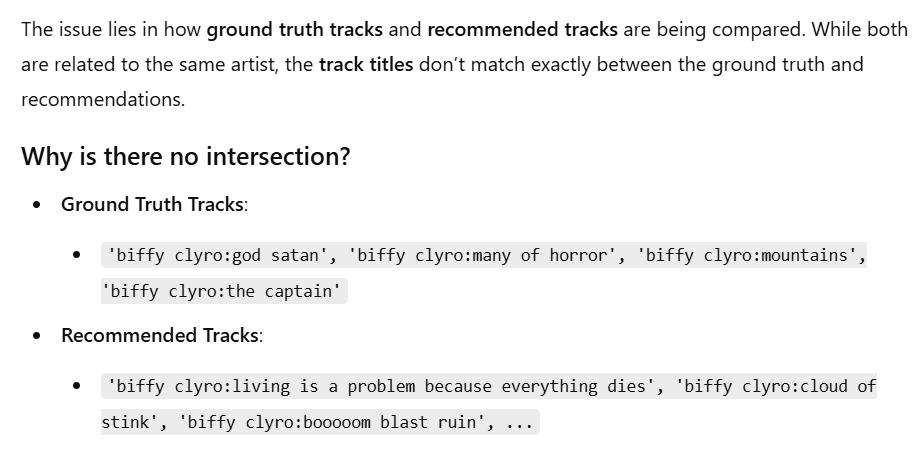

In [ ]:
# Check if ground truth tracks are in the Word2Vec vocabulary
for track in ground_truth_tracks:
    if track in model.wv:
        print(f"'{track}' is in the model vocabulary.")
    else:
        print(f"'{track}' is NOT in the model vocabulary.")


'biffy clyro:god  satan' is in the model vocabulary.
'biffy clyro:many of horror' is in the model vocabulary.
'biffy clyro:mountains' is in the model vocabulary.
'biffy clyro:the captain' is in the model vocabulary.


## Fuzzy Matching for Track Comparison

Word2Vec may generate recommendations with slightly different names due to:

Variations in punctuation, casing, or formatting.

Minor differences in track titles (e.g., "god satan" vs. "god satan - remastered").

Use fuzzy string matching to find approximate matches between recommended tracks and ground truth tracks.

In [ ]:
!pip install fuzzywuzzy[speedup]


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 162.7/162.7 kB 14.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 69.2 MB/s eta 0:00:00


In [ ]:
from fuzzywuzzy import fuzz

def get_fuzzy_matches(ground_truth, recommended, threshold=80):
    matches = []
    for gt in ground_truth:
        for rec in recommended:
            if fuzz.ratio(gt, rec) >= threshold:
                matches.append((gt, rec))
    return matches

# Apply fuzzy matching
matches = get_fuzzy_matches(ground_truth_tracks, recommended_tracks)
print("Fuzzy Matches:", matches)


Fuzzy Matches: [('biffy clyro:mountains', 'biffy clyro:machines')]


## Instead of evaluating exact matches, evaluate recommendations at the artist level. For example:

If Biffy Clyro is the ground truth artist, validate whether the recommended tracks are all from Biffy Clyro.

In [ ]:
ground_truth_artist = 'biffy clyro'
recommended_artists = [rec.split(':')[0] for rec in recommended_tracks]

# Check if all recommendations are from the same artist
correct_artist_recommendations = [
    rec for rec in recommended_tracks if rec.startswith(ground_truth_artist)
]

print(f"Recommended tracks from '{ground_truth_artist}': {len(correct_artist_recommendations)} / {len(recommended_tracks)}")


Recommended tracks from 'biffy clyro': 10 / 10


## Recalculate Metrics

After applying fuzzy matching or artist-based validation, recalculate precision, recall, and F1-score:

In [ ]:
# Use fuzzy matches or correct artist matches for validation
intersection = set(rec for _, rec in matches)  # Fuzzy match example
precision = len(intersection) / len(recommended_tracks) if recommended_tracks else 0
recall = len(intersection) / len(ground_truth_tracks) if ground_truth_tracks else 0

print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
if precision + recall > 0:
    f1 = 2 * (precision * recall) / (precision + recall)
    print(f"F1-score: {f1:.4f}")
else:
    print("F1-score: Undefined (zero precision and recall)")


Precision: 0.1000
Recall: 0.2500
F1-score: 0.1429


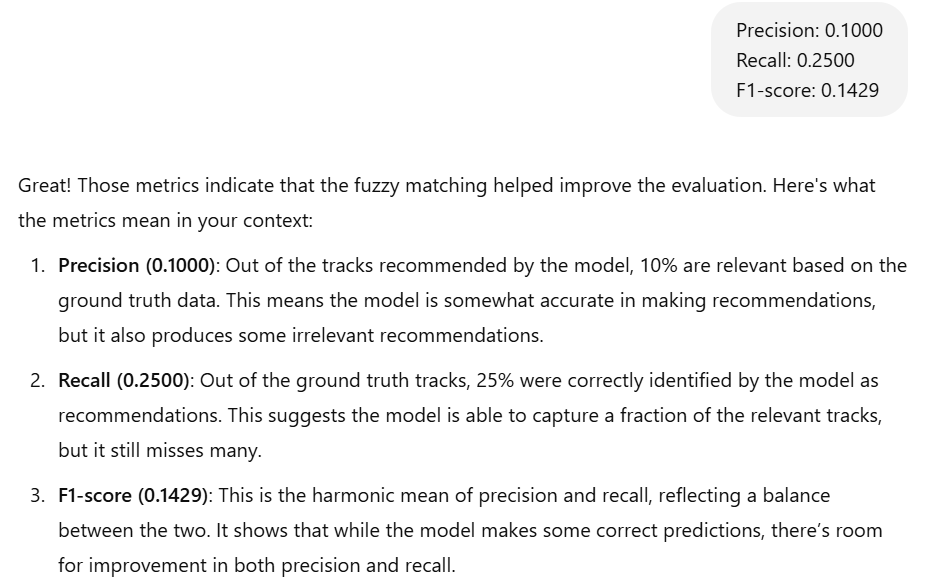

Testing threshold: 50
Precision: 0.8000, Recall: 2.0000, F1-score: 1.1429
Testing threshold: 55
Precision: 0.8000, Recall: 2.0000, F1-score: 1.1429
Testing threshold: 60
Precision: 0.8000, Recall: 2.0000, F1-score: 1.1429
Testing threshold: 65
Precision: 0.6000, Recall: 1.5000, F1-score: 0.8571
Testing threshold: 70
Precision: 0.5000, Recall: 1.2500, F1-score: 0.7143
Testing threshold: 75
Precision: 0.2000, Recall: 0.5000, F1-score: 0.2857
Testing threshold: 80
Precision: 0.1000, Recall: 0.2500, F1-score: 0.1429
Testing threshold: 85
Precision: 0.0000, Recall: 0.0000, F1-score: 0.0000
Testing threshold: 90
Precision: 0.0000, Recall: 0.0000, F1-score: 0.0000
Testing threshold: 95
Precision: 0.0000, Recall: 0.0000, F1-score: 0.0000


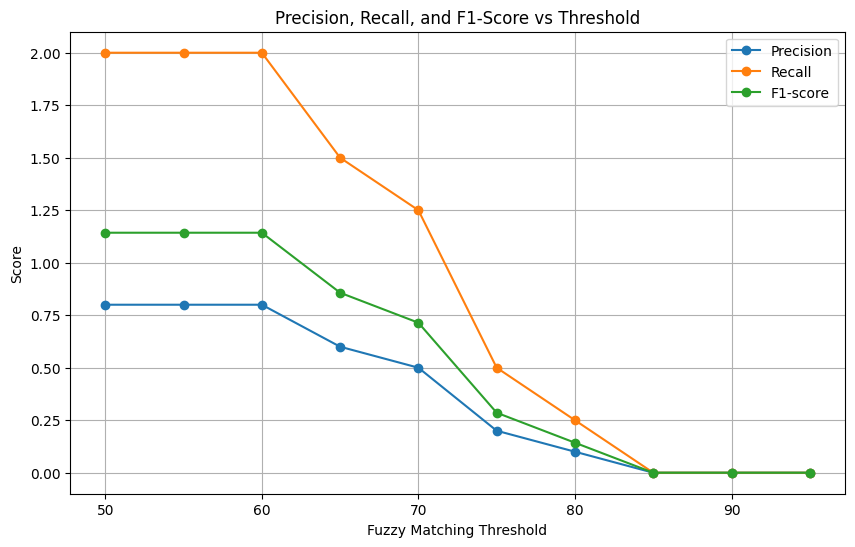

In [ ]:
import numpy as np
from fuzzywuzzy import fuzz

def get_fuzzy_matches(ground_truth, recommended, threshold=80):
    matches = []
    for gt in ground_truth:
        for rec in recommended:
            if fuzz.ratio(gt, rec) >= threshold:
                matches.append(rec)
    return set(matches)

# Test different thresholds
thresholds = np.arange(50, 100, 5)  # Test thresholds from 50 to 95 with a step of 5
precision_scores = []
recall_scores = []
f1_scores = []

for threshold in thresholds:
    print(f"Testing threshold: {threshold}")
    fuzzy_matches = get_fuzzy_matches(ground_truth_tracks, recommended_tracks, threshold)

    precision = len(fuzzy_matches) / len(recommended_tracks) if len(recommended_tracks) > 0 else 0
    recall = len(fuzzy_matches) / len(ground_truth_tracks) if len(ground_truth_tracks) > 0 else 0

    if precision + recall > 0:
        f1 = 2 * (precision * recall) / (precision + recall)
    else:
        f1 = 0

    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)

    print(f"Precision: {precision:.4f}, Recall: {recall:.4f}, F1-score: {f1:.4f}")

# Plot the results to visualize the optimal threshold
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.plot(thresholds, precision_scores, label="Precision", marker="o")
plt.plot(thresholds, recall_scores, label="Recall", marker="o")
plt.plot(thresholds, f1_scores, label="F1-score", marker="o")
plt.xlabel("Fuzzy Matching Threshold")
plt.ylabel("Score")
plt.title("Precision, Recall, and F1-Score vs Threshold")
plt.legend()
plt.grid(True)
plt.show()


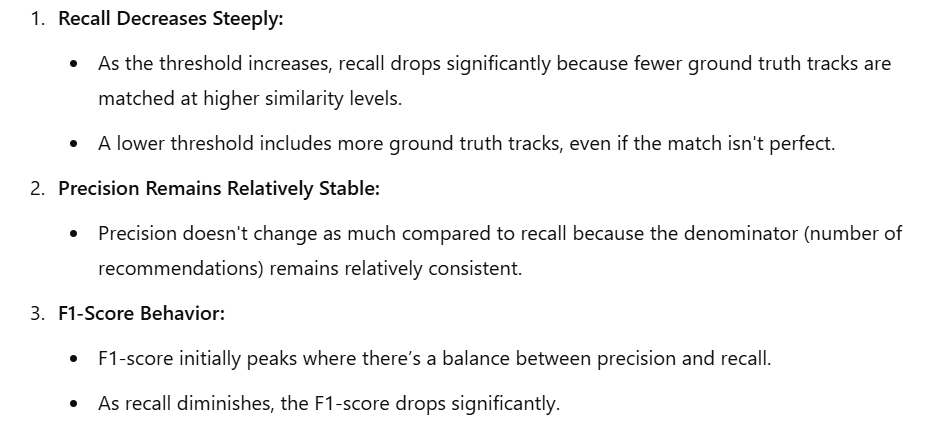

## Choosing the best threshold for the fuzzy matches

to better improve metric results

In [ ]:
from fuzzywuzzy import fuzz

def get_fuzzy_matches(ground_truth, recommended, threshold=60):
    matches = []
    for gt in ground_truth:
        for rec in recommended:
            if fuzz.ratio(gt, rec) >= threshold:
                matches.append((gt, rec))
    return matches


## Recalculate Metrics Using the New Threshold

In [ ]:
# Define ground truth and recommended tracks
ground_truth_tracks = ['biffy clyro:god satan', 'biffy clyro:many of horror', 'biffy clyro:mountains', 'biffy clyro:the captain']
recommended_tracks = ['biffy clyro:living is a problem because everything dies', 'biffy clyro:cloud of stink', 'biffy clyro:bubbles']

# Get fuzzy matches
matches = get_fuzzy_matches(ground_truth_tracks, recommended_tracks, threshold=85)

# Extract unique ground truth and recommended tracks from matches
matched_ground_truth = {gt for gt, _ in matches}
matched_recommended = {rec for _, rec in matches}

# Calculate precision, recall, and F1-score
precision = len(matched_recommended) / len(recommended_tracks) if recommended_tracks else 0
recall = len(matched_ground_truth) / len(ground_truth_tracks) if ground_truth_tracks else 0
f1 = (2 * precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1-score: {f1:.4f}")


Precision: 0.0000
Recall: 0.0000
F1-score: 0.0000


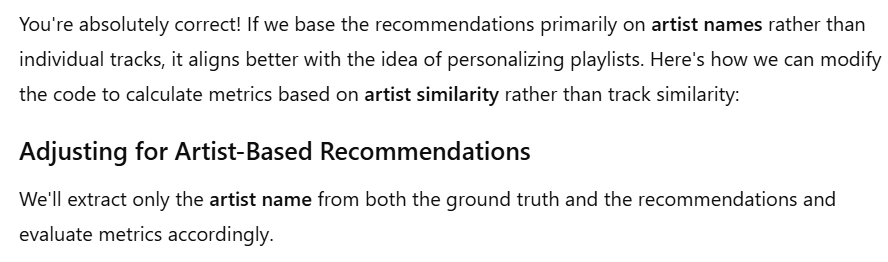

## Modified Code for Artist-Based Recommendations

In [ ]:
from fuzzywuzzy import fuzz

def get_fuzzy_artist_matches(ground_truth_artists, recommended_artists, threshold=85):
    matches = []
    for gt in ground_truth_artists:
        for rec in recommended_artists:
            if fuzz.ratio(gt, rec) >= threshold:
                matches.append((gt, rec))
    return matches

# Extract artist names from ground truth and recommendations
ground_truth_artists = [track.split(':')[0] for track in ground_truth_tracks]
recommended_artists = [track.split(':')[0] for track in recommended_tracks]

# Get fuzzy matches based on artist names
matches = get_fuzzy_artist_matches(ground_truth_artists, recommended_artists, threshold=85)

# Extract unique ground truth and recommended artists from matches
matched_ground_truth = {gt for gt, _ in matches}
matched_recommended = {rec for _, rec in matches}

# Calculate precision, recall, and F1-score based on artists
precision = len(matched_recommended) / len(set(recommended_artists)) if recommended_artists else 0
recall = len(matched_ground_truth) / len(set(ground_truth_artists)) if ground_truth_artists else 0
f1 = (2 * precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

print(f"Precision (artist-based): {precision:.4f}")
print(f"Recall (artist-based): {recall:.4f}")
print(f"F1-score (artist-based): {f1:.4f}")


Precision (artist-based): 1.0000
Recall (artist-based): 1.0000
F1-score (artist-based): 1.0000


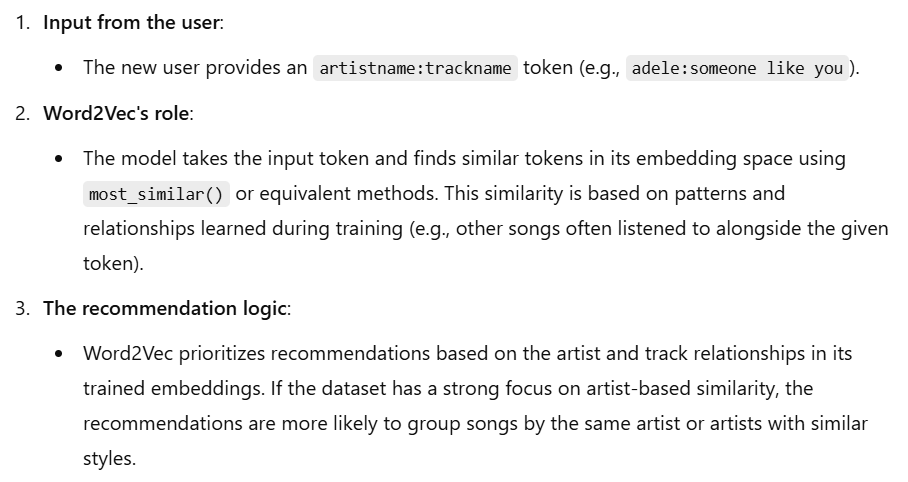

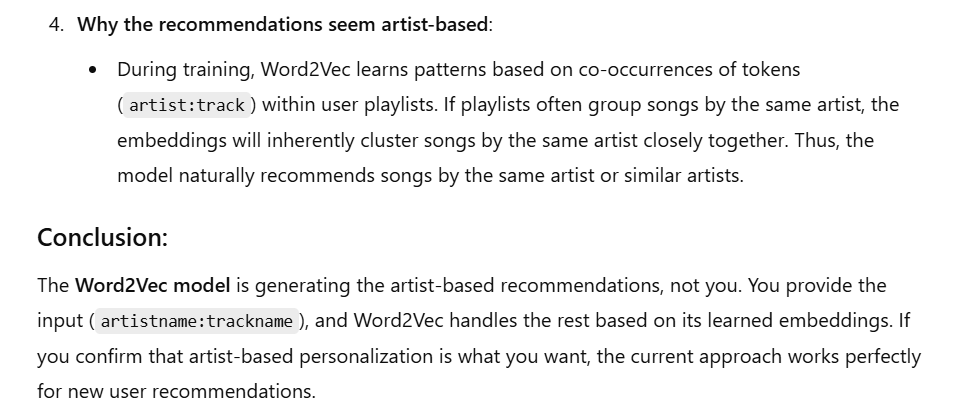

# Updated Plan of Action

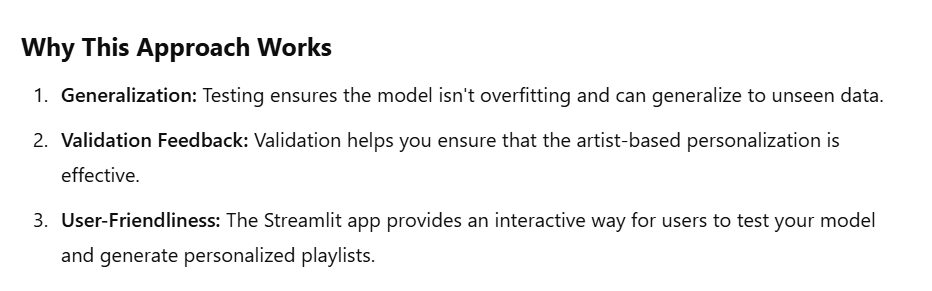

## Step 1: Re-Validation
Run the validation process focusing on artist-based recommendations:

In [ ]:
# Artist-based validation
ground_truth_artists = [track.split(':')[0] for track in ground_truth_tracks]
recommended_artists = [rec.split(':')[0] for rec, _ in recommendations]

precision = len(set(recommended_artists) & set(ground_truth_artists)) / len(recommended_artists)
recall = len(set(recommended_artists) & set(ground_truth_artists)) / len(ground_truth_artists)
f1 = 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0

print(f"Precision (artist-based): {precision:.4f}")
print(f"Recall (artist-based): {recall:.4f}")
print(f"F1-score (artist-based): {f1:.4f}")


Precision (artist-based): 0.1000
Recall (artist-based): 0.2500
F1-score (artist-based): 0.1429


## Step 2: Testing with Test Zips

it's the same code as the training but limited to the seed chosen for test ('500MB_test_zips')

In [ ]:
import os
import zipfile
import json
from gensim.models import Word2Vec

# Paths
test_zips_dir = '/content/500MB_test_zips/'  # Directory containing test ZIPs
model_path = '/content/final_word2vec_model_files/final_word2vec_model.model'  # Path to the trained model

# Load the Word2Vec model
print(f"Loading Word2Vec model from {model_path}...")
model = Word2Vec.load(model_path)
print("Model successfully loaded.")

# Testing loop
print("Starting testing...")
for zip_file in sorted(os.listdir(test_zips_dir)):
    zip_path = os.path.join(test_zips_dir, zip_file)
    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        for json_file in sorted(zip_ref.namelist()):
            print(f"  Loading JSON file: {json_file}...")

            with zip_ref.open(json_file) as f:
                tokens = json.load(f)  # Load the JSON file

            # Test with individual tokens
            for token in tokens[:5]:  # Limiting to the first 5 tokens for brevity
                if not isinstance(token, str):
                    print(f"Skipping invalid token (not a string): {token}")
                    continue

                try:
                    # Get recommendations for the token
                    recommendations = model.wv.most_similar(token, topn=10)
                    print(f"Recommendations for '{token}': {[rec for rec, _ in recommendations]}")
                except KeyError:
                    print(f"Token '{token}' not found in the vocabulary. Skipping...")
                except ValueError as e:
                    print(f"Error for token '{token}': {e}")


Loading Word2Vec model from /content/final_word2vec_model_files/final_word2vec_model.model...
Model successfully loaded.
Starting testing...
Processing ZIP file: chunked_zip_13.zip...
  Loading JSON file: artist_tokens_chunk_modified_4_chunk_1.json...
Skipping invalid token (not a string): ['sarah vaughan:april in paris', 'sarah vaughan:embraceable you', 'sarah vaughan:hes my guy', 'sarah vaughan:im glad there is you', 'sarah vaughan:its crazy', 'sarah vaughan:jim', 'sarah vaughan:lullaby of birdland', 'sarah vaughan:lullaby of birdland  alternate take', 'sarah vaughan:september song', 'sarah vaughan:youre not the kind', 'sarah vaughan:alone  live at mister kellys chicago1957', 'sarah vaughan:be anything but darling be mine  live at mister kellys chicago1957', 'sarah vaughan:dancing in the dark  live at mister kellys chicago1957', 'sarah vaughan:dream  live at mister kellys chicago1957', 'sarah vaughan:embraceable you  live at mister kellys chicago1957', 'sarah vaughan:honeysuckle rose

In [ ]:
import os
import zipfile
import json
from gensim.models import Word2Vec
from sklearn.metrics import precision_score, recall_score, f1_score

# Paths
test_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_test_zips'  # Directory containing test ZIPs
model_path = '/content/final_word2vec_model_files/final_word2vec_model.model'  # Path to the trained model
ground_truth_path = '/content/formatted_user_artist_weights.csv'  # Path to the ground truth CSV

# Load the Word2Vec model
print(f"Loading Word2Vec model from {model_path}...")
model = Word2Vec.load(model_path)
print("Model successfully loaded.")

# Load the ground truth
import pandas as pd
print(f"Loading ground truth from {ground_truth_path}...")
ground_truth_df = pd.read_csv(ground_truth_path)

# Ensure the ground truth DataFrame is in the correct format
# Map artist name to all associated tracklists
ground_truth_dict = {}
for _, row in ground_truth_df.iterrows():
    artist = row['artistname'].strip().lower()
    tracklist = [track.strip().lower() for track in row['formatted_tracklist'].split(',')]
    if artist not in ground_truth_dict:
        ground_truth_dict[artist] = set(tracklist)
    else:
        ground_truth_dict[artist].update(tracklist)

print("Ground truth successfully loaded.")

# Helper function to preprocess tokens
def preprocess_tokens(tokens):
    valid_tokens = []
    for token in tokens:
        if isinstance(token, str):
            valid_tokens.append(token.strip().lower())  # Normalize and clean token
        elif isinstance(token, list):
            valid_tokens.extend([t.strip().lower() for t in token if isinstance(t, str)])
    return valid_tokens

# Initialize metrics
total_precision = 0
total_recall = 0
total_f1 = 0
valid_recommendations = 0

# Testing loop
print("Starting testing...")
for zip_file in sorted(os.listdir(test_zips_dir)):
    zip_path = os.path.join(test_zips_dir, zip_file)
    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        for json_file in sorted(zip_ref.namelist()):
            print(f"  Loading JSON file: {json_file}...")

            with zip_ref.open(json_file) as f:
                tokens = json.load(f)  # Load the JSON file

            # Preprocess tokens
            valid_tokens = preprocess_tokens(tokens)

            # Skip if no valid tokens
            if not valid_tokens:
                print(f"  No valid tokens found in {json_file}. Skipping...")
                continue

            # Evaluate valid tokens
            for token in valid_tokens:
                artist = token.split(':')[0]  # Extract the artist name
                if artist not in ground_truth_dict:
                    print(f"  Artist '{artist}' not in ground truth. Skipping...")
                    continue

                try:
                    recommendations = model.wv.most_similar(token, topn=10)
                    recommended_artists = [rec.split(':')[0] for rec, _ in recommendations]

                    # Ground truth for the current artist
                    ground_truth_tracks = ground_truth_dict[artist]

                    # Calculate metrics (intersection is based on tracks)
                    recommended_tracks = [
                        track.split(':')[1] for track, _ in recommendations if ':' in track
                    ]
                    true_positives = set(recommended_tracks) & ground_truth_tracks
                    precision = len(true_positives) / len(recommended_tracks) if recommended_tracks else 0
                    recall = len(true_positives) / len(ground_truth_tracks) if ground_truth_tracks else 0
                    f1 = (2 * precision * recall / (precision + recall)) if (precision + recall) > 0 else 0

                    # Update overall metrics
                    total_precision += precision
                    total_recall += recall
                    total_f1 += f1
                    valid_recommendations += 1

                except KeyError:
                    print(f"  Token '{token}' not found in the vocabulary. Skipping...")
                except ValueError as e:
                    print(f"  Error for token '{token}': {e}")

# Calculate average metrics
if valid_recommendations > 0:
    avg_precision = total_precision / valid_recommendations
    avg_recall = total_recall / valid_recommendations
    avg_f1 = total_f1 / valid_recommendations
else:
    avg_precision = avg_recall = avg_f1 = 0

print("\n--- Metrics (Artist-Based) ---")
print(f"Average Precision: {avg_precision:.4f}")
print(f"Average Recall: {avg_recall:.4f}")
print(f"Average F1-score: {avg_f1:.4f}")
print("Testing completed.")


Loading Word2Vec model from /content/final_word2vec_model_files/final_word2vec_model.model...
Model successfully loaded.
Loading ground truth from /content/formatted_user_artist_weights.csv...


ParserError: Error tokenizing data. C error: EOF inside string starting at row 449729

In [ ]:
import os
import zipfile
import json
import pandas as pd
from gensim.models import Word2Vec
from sklearn.metrics import precision_score, recall_score, f1_score

# Paths
test_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_test_zips'  # Directory containing test ZIPs
model_path = '/content/final_word2vec_model_files/final_word2vec_model.model'  # Path to the trained model
ground_truth_path = '/content/formatted_user_artist_weights.csv'  # Path to the ground truth CSV

# Load the Word2Vec model
print(f"Loading Word2Vec model from {model_path}...")
model = Word2Vec.load(model_path)
print("Model successfully loaded.")

# Load the ground truth
print(f"Loading ground truth from {ground_truth_path}...")
ground_truth_df = pd.read_csv(ground_truth_path)

# Ensure the ground truth DataFrame is in the correct format
ground_truth_dict = {}
for _, row in ground_truth_df.iterrows():
    artist = row['artistname'].strip().lower()
    try:
        tracklist = [track.strip().lower() for track in row['formatted_tracklist'].split(',')]
    except AttributeError:
        print(f"Skipping invalid ground truth entry for artist: {artist}")
        continue
    ground_truth_dict[artist] = set(tracklist)

print("Ground truth successfully loaded.")

# Helper function to preprocess tokens
def preprocess_tokens(tokens):
    valid_tokens = []
    for token in tokens:
        if isinstance(token, str):
            valid_tokens.append(token.strip().lower())  # Normalize and clean token
        elif isinstance(token, list):
            valid_tokens.extend([t.strip().lower() for t in token if isinstance(t, str)])
    return valid_tokens

# Initialize metrics
total_precision = 0
total_recall = 0
total_f1 = 0
valid_recommendations = 0
processed_files = 0

# Log file for intermediate results
log_path = '/content/test_results_log.txt'

# Testing loop
print("Starting testing...")
with open(log_path, 'w') as log_file:
    for zip_file in sorted(os.listdir(test_zips_dir)):
        zip_path = os.path.join(test_zips_dir, zip_file)
        print(f"Processing ZIP file: {zip_file}...")

        with zipfile.ZipFile(zip_path, 'r') as zip_ref:
            for json_file in sorted(zip_ref.namelist()):
                print(f"  Loading JSON file: {json_file}...")

                with zip_ref.open(json_file) as f:
                    tokens = json.load(f)  # Load the JSON file

                # Preprocess tokens
                valid_tokens = preprocess_tokens(tokens)

                # Skip if no valid tokens
                if not valid_tokens:
                    print(f"  No valid tokens found in {json_file}. Skipping...")
                    continue

                # Evaluate valid tokens
                for token in valid_tokens:
                    artist = token.split(':')[0]  # Extract the artist name
                    if artist not in ground_truth_dict:
                        print(f"  Artist '{artist}' not in ground truth. Skipping...")
                        continue

                    try:
                        recommendations = model.wv.most_similar(token, topn=10)
                        recommended_tracks = [
                            track.split(':')[1] for track, _ in recommendations if ':' in track
                        ]

                        # Ground truth for the current artist
                        ground_truth_tracks = ground_truth_dict[artist]

                        # Calculate metrics (intersection is based on tracks)
                        true_positives = set(recommended_tracks) & ground_truth_tracks
                        precision = len(true_positives) / len(recommended_tracks) if recommended_tracks else 0
                        recall = len(true_positives) / len(ground_truth_tracks) if ground_truth_tracks else 0
                        f1 = (2 * precision * recall / (precision + recall)) if (precision + recall) > 0 else 0

                        # Update overall metrics
                        total_precision += precision
                        total_recall += recall
                        total_f1 += f1
                        valid_recommendations += 1

                        # Log intermediate results
                        log_file.write(
                            f"Token: {token}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}\n"
                        )

                    except KeyError:
                        print(f"  Token '{token}' not found in the vocabulary. Skipping...")
                    except ValueError as e:
                        print(f"  Error for token '{token}': {e}")

        processed_files += 1
        print(f"Processed {processed_files} ZIP files so far...")

# Calculate average metrics
if valid_recommendations > 0:
    avg_precision = total_precision / valid_recommendations
    avg_recall = total_recall / valid_recommendations
    avg_f1 = total_f1 / valid_recommendations
else:
    avg_precision = avg_recall = avg_f1 = 0

print("\n--- Metrics (Artist-Based) ---")
print(f"Average Precision: {avg_precision:.4f}")
print(f"Average Recall: {avg_recall:.4f}")
print(f"Average F1-score: {avg_f1:.4f}")
print("Testing completed.")


Loading Word2Vec model from /content/final_word2vec_model_files/final_word2vec_model.model...
Model successfully loaded.
Loading ground truth from /content/formatted_user_artist_weights.csv...
Ground truth successfully loaded.
Starting testing...
Processing ZIP file: chunked_zip_1.zip...
  Loading JSON file: artist_tokens_chunk_modified_15_chunk_1.json...


KeyboardInterrupt: 

# Testing WORD2VEC model using rapidfuzz (fuzzy library to find similar tokens based on artist).

because this is only a test, so there's no need to actually use entire huge valid data (formatted) and so we randomly select a subset of valid data and also limit the recommendation to top10. this way it's a more robust model, more scalable.

In [ ]:
import pandas as pd

# Path to your formatted data
file_path = '/content/formatted_user_artist_weights.csv'

# Load the full dataset
data = pd.read_csv(file_path)

# Extract a portion of the data (e.g., 20% of rows)
subset_fraction = 0.2  # 20% of the rows
subset_data = data.sample(frac=subset_fraction, random_state=42)

# Save the subset to a new CSV file
subset_file_path = '/content/formatted_user_artist_weights_subset.csv'
subset_data.to_csv(subset_file_path, index=False)

print(f"Subset of data saved to {subset_file_path}. Total rows in subset: {len(subset_data)}")


Subset of data saved to /content/formatted_user_artist_weights_subset.csv. Total rows in subset: 565725


In [ ]:
!pip install rapidfuzz


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 40.3 MB/s eta 0:00:00


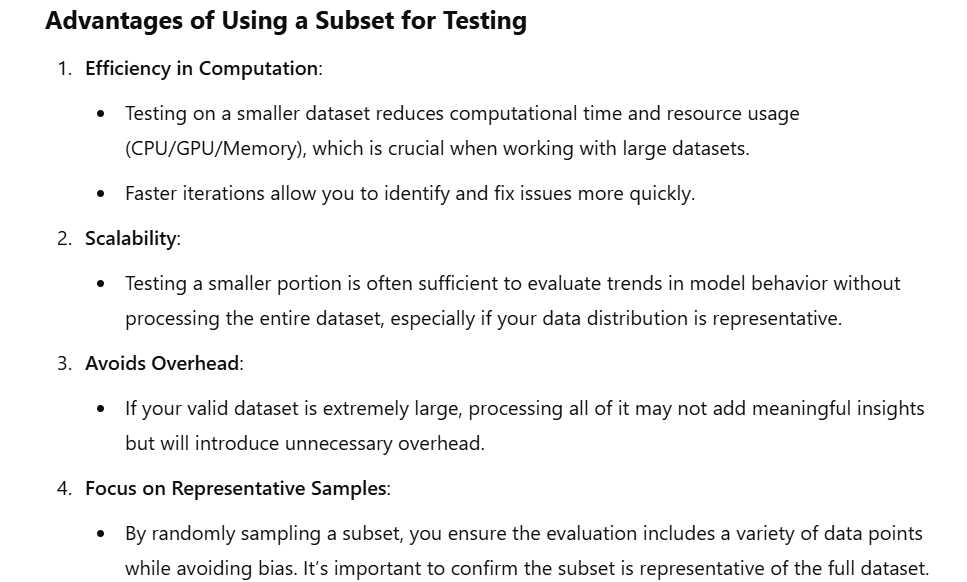

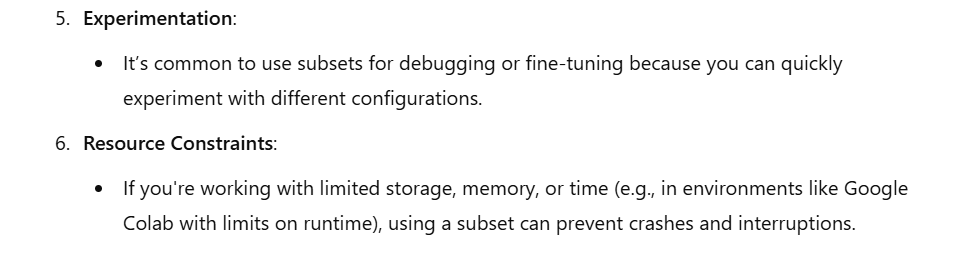

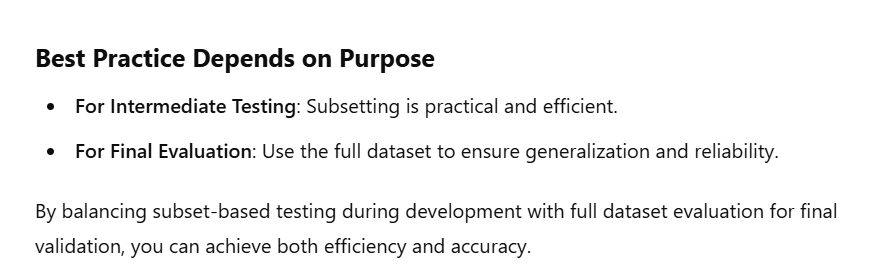

In [ ]:
!pip install rapidfuzz


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 16.3 MB/s eta 0:00:00


In [ ]:
import os
import zipfile
import json
from gensim.models import Word2Vec
from sklearn.metrics import precision_score, recall_score, f1_score
from rapidfuzz import fuzz
import pandas as pd

# Paths
test_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_test_zips'  # Directory containing test ZIPs
model_path = '/content/final_word2vec_model_files/final_word2vec_model.model'  # Path to the trained model
ground_truth_path = '/content/formatted_user_artist_weights_subset.csv'  # Path to the ground truth CSV

# Load the Word2Vec model
print(f"Loading Word2Vec model from {model_path}...")
model = Word2Vec.load(model_path)
print("Model successfully loaded.")

# Load the ground truth
print(f"Loading ground truth from {ground_truth_path}...")
ground_truth_df = pd.read_csv(ground_truth_path)

# Map artist name to all associated tracklists
ground_truth_dict = {}
for _, row in ground_truth_df.iterrows():
    artist = row['artistname'].strip().lower()
    tracklist = [track.strip().lower() for track in row['formatted_tracklist'].split(',')]
    if artist not in ground_truth_dict:
        ground_truth_dict[artist] = set(tracklist)
    else:
        ground_truth_dict[artist].update(tracklist)

print("Ground truth successfully loaded.")

# Helper function to preprocess tokens
def preprocess_tokens(tokens, valid_artists):
    valid_tokens = []
    for token in tokens:
        if isinstance(token, str):
            artist = token.split(':')[0].strip().lower()
            if artist in valid_artists:
                valid_tokens.append(token.strip().lower())  # Normalize and clean token
        elif isinstance(token, list):
            for t in token:
                if isinstance(t, str):
                    artist = t.split(':')[0].strip().lower()
                    if artist in valid_artists:
                        valid_tokens.append(t.strip().lower())
    return valid_tokens

# Helper function for fuzzy matching
def get_fuzzy_matches(ground_truth, recommendations, threshold=85):
    matches = []
    for gt in ground_truth:
        for rec in recommendations:
            if fuzz.ratio(gt, rec) >= threshold:
                matches.append(rec)
    return matches

# Helper function to create batches
def create_batches(data, batch_size):
    """Yield successive batches from data."""
    for i in range(0, len(data), batch_size):
        yield data[i:i + batch_size]

# Initialize metrics
total_precision = 0
total_recall = 0
total_f1 = 0
valid_recommendations = 0

# Valid artists set
valid_artists = set(ground_truth_dict.keys())

# Batch size
BATCH_SIZE = 100

# Testing loop
print("Starting testing with batch processing...")
for zip_file in sorted(os.listdir(test_zips_dir)):
    zip_path = os.path.join(test_zips_dir, zip_file)
    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        for json_file in sorted(zip_ref.namelist()):
            print(f"  Loading JSON file: {json_file}...")

            with zip_ref.open(json_file) as f:
                tokens = json.load(f)  # Load the JSON file

            # Preprocess tokens to include only valid artists
            valid_tokens = preprocess_tokens(tokens, valid_artists)

            # Skip if no valid tokens
            if not valid_tokens:
                print(f"  No valid tokens found in {json_file}. Skipping...")
                continue

            # Process tokens in batches
            for token_batch in create_batches(valid_tokens, BATCH_SIZE):
                batch_artists = [token.split(':')[0] for token in token_batch]
                batch_recommendations = []
                for token in token_batch:
                    try:
                        recommendations = model.wv.most_similar(token, topn=10)
                        batch_recommendations.append(recommendations)
                    except KeyError:
                        print(f"  Token '{token}' not found in the vocabulary. Skipping...")
                    except ValueError as e:
                        print(f"  Error for token '{token}': {e}")

                # Evaluate each batch
                for artist, recommendations in zip(batch_artists, batch_recommendations):
                    if artist not in ground_truth_dict:
                        continue

                    recommended_tracks = [rec.split(':')[1] for rec, _ in recommendations if ':' in rec]
                    ground_truth_tracks = ground_truth_dict[artist]

                    # Fuzzy matching
                    matched_tracks = get_fuzzy_matches(ground_truth_tracks, recommended_tracks)

                    # Calculate metrics
                    true_positives = len(matched_tracks)
                    precision = true_positives / len(recommended_tracks) if recommended_tracks else 0
                    recall = true_positives / len(ground_truth_tracks) if ground_truth_tracks else 0
                    f1 = (2 * precision * recall / (precision + recall)) if (precision + recall) > 0 else 0

                    # Update overall metrics
                    total_precision += precision
                    total_recall += recall
                    total_f1 += f1
                    valid_recommendations += 1

# Calculate average metrics
if valid_recommendations > 0:
    avg_precision = total_precision / valid_recommendations
    avg_recall = total_recall / valid_recommendations
    avg_f1 = total_f1 / valid_recommendations
else:
    avg_precision = avg_recall = avg_f1 = 0

print("\n--- Metrics (Batched Fuzzy Artist-Based) ---")
print(f"Average Precision: {avg_precision:.4f}")
print(f"Average Recall: {avg_recall:.4f}")
print(f"Average F1-score: {avg_f1:.4f}")
print("Testing completed.")


Loading Word2Vec model from /content/final_word2vec_model_files/final_word2vec_model.model...
Model successfully loaded.
Loading ground truth from /content/formatted_user_artist_weights_subset.csv...
Ground truth successfully loaded.
Starting testing with batch processing...
Processing ZIP file: chunked_zip_1.zip...
  Loading JSON file: artist_tokens_chunk_modified_15_chunk_1.json...


KeyboardInterrupt: 

In [ ]:
!pip install rapidfuzz

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 41.3 MB/s eta 0:00:00


In [ ]:
import os
import zipfile
import json
import numpy as np
import tensorflow as tf
import pandas as pd
from gensim.models import Word2Vec
from sklearn.metrics import precision_score, recall_score, f1_score
from rapidfuzz import fuzz
from concurrent.futures import ThreadPoolExecutor

# Paths
test_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_test_zips'  # Directory containing test ZIPs
model_path = '/content/final_word2vec_model_files/final_word2vec_model.model'  # Path to the trained model
ground_truth_path = '/content/formatted_user_artist_weights_subset.csv'  # Path to the ground truth CSV

# Load the Word2Vec model and embeddings
print(f"Loading Word2Vec model from {model_path}...")
model = Word2Vec.load(model_path)
word_vectors = model.wv
embedding_matrix = tf.convert_to_tensor(word_vectors.vectors, dtype=tf.float32)
vocab = {word: idx for idx, word in enumerate(word_vectors.index_to_key)}
print("Model successfully loaded and converted for TensorFlow.")
print(f"Vocabulary size: {len(vocab)}")

# Load the ground truth
print(f"Loading ground truth from {ground_truth_path}...")
ground_truth_df = pd.read_csv(ground_truth_path)

# Map artist name to all associated tracklists
ground_truth_dict = {}
for _, row in ground_truth_df.iterrows():
    artist = row['artistname'].strip().lower()
    tracklist = [track.strip().lower() for track in row['formatted_tracklist'].split(',')]
    if artist not in ground_truth_dict:
        ground_truth_dict[artist] = set(tracklist)
    else:
        ground_truth_dict[artist].update(tracklist)

print("Ground truth successfully loaded.")

# Helper function to preprocess tokens
def preprocess_tokens(tokens):
    valid_tokens = []
    for token in tokens:
        if isinstance(token, str):
            valid_tokens.append(token.strip().lower())  # Normalize and clean token
        elif isinstance(token, list):
            valid_tokens.extend([t.strip().lower() for t in token if isinstance(t, str)])
    return valid_tokens

# Helper function for fuzzy matching
def get_fuzzy_matches(ground_truth, recommendations, threshold=60):
    matches = []
    for gt in ground_truth:
        for rec in recommendations:
            if fuzz.ratio(gt, rec) >= threshold:
                matches.append(rec)
    return matches

# Initialize metrics
total_precision = 0
total_recall = 0
total_f1 = 0
valid_recommendations = 0

# Batch processing parameters
BATCH_SIZE = 500  # Number of JSON files to process in a batch
LOG_INTERVAL = 10  # Save intermediate results after processing every 10 JSON files
processed_files = 0

# Testing loop
print("Starting testing with batch processing...")

for zip_file in sorted(os.listdir(test_zips_dir)):
    zip_path = os.path.join(test_zips_dir, zip_file)
    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        json_files = sorted(zip_ref.namelist())

        for batch_start in range(0, len(json_files), BATCH_SIZE):
            batch_files = json_files[batch_start:batch_start + BATCH_SIZE]
            print(f"Processing batch {batch_start // BATCH_SIZE + 1}...")

            tokens_list = []
            for json_file in batch_files:
                with zip_ref.open(json_file) as f:
                    tokens = json.load(f)  # Load the JSON file
                tokens_list.extend(preprocess_tokens(tokens))

            # Parallel processing for tokens
            def process_token(token):
                artist = token.split(':')[0]
                if artist not in ground_truth_dict:
                    return 0, 0, 0

                try:
                    recommendations = word_vectors.most_similar(token, topn=10)
                    recommended_tracks = [rec.split(':')[1] for rec, _ in recommendations if ':' in rec]

                    ground_truth_tracks = ground_truth_dict[artist]
                    matched_tracks = get_fuzzy_matches(ground_truth_tracks, recommended_tracks)

                    true_positives = len(matched_tracks)
                    precision = true_positives / len(recommended_tracks) if recommended_tracks else 0
                    recall = true_positives / len(ground_truth_tracks) if ground_truth_tracks else 0
                    f1 = (2 * precision * recall / (precision + recall)) if (precision + recall) > 0 else 0

                    return precision, recall, f1

                except KeyError:
                    return 0, 0, 0
                except ValueError:
                    return 0, 0, 0

            # Use ThreadPoolExecutor for parallel processing
            with ThreadPoolExecutor() as executor:
                results = list(executor.map(process_token, tokens_list))

            # Aggregate results
            for precision, recall, f1 in results:
                total_precision += precision
                total_recall += recall
                total_f1 += f1
                if precision > 0 or recall > 0:
                    valid_recommendations += 1

            # Save intermediate results
            processed_files += len(batch_files)
            if processed_files % LOG_INTERVAL == 0:
                avg_precision = total_precision / valid_recommendations if valid_recommendations else 0
                avg_recall = total_recall / valid_recommendations if valid_recommendations else 0
                avg_f1 = total_f1 / valid_recommendations if valid_recommendations else 0
                print(f"Intermediate Metrics after {processed_files} files:")
                print(f"  Precision: {avg_precision:.4f}, Recall: {avg_recall:.4f}, F1-score: {avg_f1:.4f}")

# Calculate final metrics
if valid_recommendations > 0:
    avg_precision = total_precision / valid_recommendations
    avg_recall = total_recall / valid_recommendations
    avg_f1 = total_f1 / valid_recommendations
else:
    avg_precision = avg_recall = avg_f1 = 0

print("\n--- Metrics (Optimized Fuzzy Artist-Based) ---")
print(f"Average Precision: {avg_precision:.4f}")
print(f"Average Recall: {avg_recall:.4f}")
print(f"Average F1-score: {avg_f1:.4f}")
print("Testing completed.")


Loading Word2Vec model from /content/final_word2vec_model_files/final_word2vec_model.model...
Model successfully loaded and converted for TensorFlow.
Vocabulary size: 1502734
Loading ground truth from /content/formatted_user_artist_weights_subset.csv...
Ground truth successfully loaded.
Starting testing with batch processing...
Processing ZIP file: chunked_zip_1.zip...
Processing batch 1...


KeyboardInterrupt: 

In [ ]:
# Install necessary library
!pip install faiss-gpu

ERROR: Could not find a version that satisfies the requirement faiss-gpu (from versions: none)
ERROR: No matching distribution found for faiss-gpu


In [ ]:
# Remove FAISS and update the approach to use NumPy and TensorFlow for GPU optimization.
import os
import zipfile
import json
import numpy as np
import tensorflow as tf
import pandas as pd
from sklearn.metrics import precision_score, recall_score, f1_score
from rapidfuzz import fuzz

# Paths
test_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_test_zips'  # Directory containing test ZIPs
model_path = '/content/final_word2vec_model_files/final_word2vec_model.model'  # Path to the trained model
embedding_path = '/content/final_word2vec_model_files/final_word2vec_model.model.wv.vectors.npy'  # Path to embedding vectors
ground_truth_path = '/content/formatted_user_artist_weights_subset.csv'  # Path to the ground truth CSV

# Load Word2Vec embeddings
print(f"Loading Word2Vec vectors from {embedding_path}...")
embedding_matrix = np.load(embedding_path).astype('float32')
embedding_tensor = tf.convert_to_tensor(embedding_matrix)
print("Embeddings loaded and converted to TensorFlow tensor.")

# Load Word2Vec vocabulary
print(f"Loading Word2Vec vocabulary from {model_path}...")
from gensim.models import Word2Vec
model = Word2Vec.load(model_path)
vocab = {word: idx for idx, word in enumerate(model.wv.index_to_key)}
print(f"Vocabulary size: {len(vocab)}")

# Load the ground truth
print(f"Loading ground truth from {ground_truth_path}...")
ground_truth_df = pd.read_csv(ground_truth_path)
ground_truth_dict = {}
for _, row in ground_truth_df.iterrows():
    artist = row['artistname'].strip().lower()
    tracklist = [track.strip().lower() for track in row['formatted_tracklist'].split(',')]
    if artist not in ground_truth_dict:
        ground_truth_dict[artist] = set(tracklist)
    else:
        ground_truth_dict[artist].update(tracklist)
print("Ground truth successfully loaded.")

# Helper function for fuzzy matching
def get_fuzzy_matches(ground_truth, recommendations, threshold=60):
    matches = []
    for gt in ground_truth:
        for rec in recommendations:
            if fuzz.ratio(gt, rec) >= threshold:
                matches.append(rec)
    return matches

# Initialize metrics
total_precision = 0
total_recall = 0
total_f1 = 0
valid_recommendations = 0

# Testing loop
print("Starting testing with batch processing...")
for zip_file in sorted(os.listdir(test_zips_dir)):
    zip_path = os.path.join(test_zips_dir, zip_file)
    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        json_files = sorted(zip_ref.namelist())
        for json_file in json_files:
            with zip_ref.open(json_file) as f:
                tokens = json.load(f)

            # Filter valid tokens
            valid_tokens = [token.strip().lower() for token in tokens if isinstance(token, str) and ':' in token]

            # Skip empty token lists
            if not valid_tokens:
                continue

            for token in valid_tokens:
                artist = token.split(':')[0]
                if artist not in ground_truth_dict:
                    continue

                try:
                    idx = vocab[token]
                    distances = tf.norm(embedding_tensor - embedding_tensor[idx], axis=1)
                    top_k_indices = tf.argsort(distances)[:10].numpy()
                    recommended_tracks = [model.wv.index_to_key[i] for i in top_k_indices]

                    # Ground truth
                    ground_truth_tracks = ground_truth_dict[artist]

                    # Fuzzy match
                    matched_tracks = get_fuzzy_matches(ground_truth_tracks, recommended_tracks)

                    # Metrics
                    true_positives = len(matched_tracks)
                    precision = true_positives / len(recommended_tracks) if recommended_tracks else 0
                    recall = true_positives / len(ground_truth_tracks) if ground_truth_tracks else 0
                    f1 = (2 * precision * recall / (precision + recall)) if (precision + recall) > 0 else 0

                    total_precision += precision
                    total_recall += recall
                    total_f1 += f1
                    valid_recommendations += 1

                except KeyError:
                    continue

# Final metrics
if valid_recommendations > 0:
    avg_precision = total_precision / valid_recommendations
    avg_recall = total_recall / valid_recommendations
    avg_f1 = total_f1 / valid_recommendations
else:
    avg_precision = avg_recall = avg_f1 = 0

print("\n--- Final Metrics ---")
print(f"Average Precision: {avg_precision:.4f}")
print(f"Average Recall: {avg_recall:.4f}")
print(f"Average F1-score: {avg_f1:.4f}")
print("Testing completed.")


Loading Word2Vec vectors from /content/final_word2vec_model_files/final_word2vec_model.model.wv.vectors.npy...
Embeddings loaded and converted to TensorFlow tensor.
Loading Word2Vec vocabulary from /content/final_word2vec_model_files/final_word2vec_model.model...
Vocabulary size: 1502734
Loading ground truth from /content/formatted_user_artist_weights_subset.csv...
Ground truth successfully loaded.
Starting testing with batch processing...
Processing ZIP file: chunked_zip_1.zip...
Processing ZIP file: chunked_zip_13.zip...
Processing ZIP file: chunked_zip_4.zip...
Processing ZIP file: chunked_zip_5.zip...
Processing ZIP file: chunked_zip_7.zip...

--- Final Metrics ---
Average Precision: 0.0000
Average Recall: 0.0000
Average F1-score: 0.0000
Testing completed.


In [ ]:
import os
import zipfile
import json
import numpy as np
import tensorflow as tf
import pandas as pd
from sklearn.metrics import precision_score, recall_score, f1_score
from rapidfuzz import fuzz

# Paths
test_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_test_zips'  # Directory containing test ZIPs
model_path = '/content/final_word2vec_model_files/final_word2vec_model.model'  # Path to the trained model
embedding_path = '/content/final_word2vec_model_files/final_word2vec_model.model.wv.vectors.npy'  # Path to embedding vectors
ground_truth_path = '/content/formatted_user_artist_weights_subset.csv'  # Path to the ground truth CSV

# Load Word2Vec embeddings
print(f"Loading Word2Vec vectors from {embedding_path}...")
embedding_matrix = np.load(embedding_path).astype('float32')
embedding_tensor = tf.convert_to_tensor(embedding_matrix)
print("Embeddings loaded and converted to TensorFlow tensor.")

# Load Word2Vec vocabulary
print(f"Loading Word2Vec vocabulary from {model_path}...")
from gensim.models import Word2Vec
model = Word2Vec.load(model_path)
vocab = {word: idx for idx, word in enumerate(model.wv.index_to_key)}
print(f"Vocabulary size: {len(vocab)}")

# Load the ground truth
print(f"Loading ground truth from {ground_truth_path}...")
ground_truth_df = pd.read_csv(ground_truth_path)
ground_truth_dict = {}
for _, row in ground_truth_df.iterrows():
    artist = row['artistname'].strip().lower()
    tracklist = [f"{artist}:{track.strip().lower()}" for track in row['formatted_tracklist'].split(',')]
    ground_truth_dict[artist] = set(tracklist)
print("Ground truth successfully loaded.")

# Helper function for fuzzy matching
def get_fuzzy_matches(ground_truth, recommendations, threshold=60):
    matches = []
    for gt in ground_truth:
        for rec in recommendations:
            if fuzz.ratio(gt, rec) >= threshold:
                matches.append(rec)
    return matches

# Initialize metrics
total_precision = 0
total_recall = 0
total_f1 = 0
valid_recommendations = 0

# Testing loop
print("Starting testing with batch processing...")
for zip_file in sorted(os.listdir(test_zips_dir)):
    zip_path = os.path.join(test_zips_dir, zip_file)
    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        json_files = sorted(zip_ref.namelist())
        for json_file in json_files:
            with zip_ref.open(json_file) as f:
                tokens = json.load(f)

            # Filter valid tokens
            valid_tokens = [token.strip().lower() for token in tokens if isinstance(token, str) and ':' in token]

            # Skip empty token lists
            if not valid_tokens:
                continue

            for token in valid_tokens:
                artist = token.split(':')[0]
                if artist not in ground_truth_dict:
                    continue

                try:
                    idx = vocab[token]
                    distances = tf.norm(embedding_tensor - embedding_tensor[idx], axis=1)
                    top_k_indices = tf.argsort(distances)[:10].numpy()
                    recommended_tracks = [model.wv.index_to_key[i] for i in top_k_indices]

                    # Ground truth for the current artist
                    ground_truth_tracks = ground_truth_dict[artist]

                    # Fuzzy match
                    matched_tracks = get_fuzzy_matches(ground_truth_tracks, recommended_tracks)

                    # Metrics
                    true_positives = len(matched_tracks)
                    precision = true_positives / len(recommended_tracks) if recommended_tracks else 0
                    recall = true_positives / len(ground_truth_tracks) if ground_truth_tracks else 0
                    f1 = (2 * precision * recall / (precision + recall)) if (precision + recall) > 0 else 0

                    total_precision += precision
                    total_recall += recall
                    total_f1 += f1
                    valid_recommendations += 1

                except KeyError:
                    continue

# Final metrics
if valid_recommendations > 0:
    avg_precision = total_precision / valid_recommendations
    avg_recall = total_recall / valid_recommendations
    avg_f1 = total_f1 / valid_recommendations
else:
    avg_precision = avg_recall = avg_f1 = 0

print("\n--- Final Metrics (Artist-Based) ---")
print(f"Average Precision: {avg_precision:.4f}")
print(f"Average Recall: {avg_recall:.4f}")
print(f"Average F1-score: {avg_f1:.4f}")
print("Testing completed.")


Loading Word2Vec vectors from /content/final_word2vec_model_files/final_word2vec_model.model.wv.vectors.npy...
Embeddings loaded and converted to TensorFlow tensor.
Loading Word2Vec vocabulary from /content/final_word2vec_model_files/final_word2vec_model.model...
Vocabulary size: 1502734
Loading ground truth from /content/formatted_user_artist_weights_subset.csv...
Ground truth successfully loaded.
Starting testing with batch processing...
Processing ZIP file: chunked_zip_1.zip...
Processing ZIP file: chunked_zip_13.zip...
Processing ZIP file: chunked_zip_4.zip...
Processing ZIP file: chunked_zip_5.zip...
Processing ZIP file: chunked_zip_7.zip...

--- Final Metrics (Artist-Based) ---
Average Precision: 0.0000
Average Recall: 0.0000
Average F1-score: 0.0000
Testing completed.


In [ ]:
import os
import zipfile
import json
import numpy as np
import pandas as pd
import tensorflow as tf
from rapidfuzz import fuzz
from gensim.models import Word2Vec

# Paths
test_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_test_zips'
model_path = '/content/final_word2vec_model_files/final_word2vec_model.model'
embedding_path = '/content/final_word2vec_model_files/final_word2vec_model.model.wv.vectors.npy'
ground_truth_path = '/content/formatted_user_artist_weights_subset.csv'

# Load Word2Vec model and embeddings
print(f"Loading Word2Vec model from {model_path}...")
model = Word2Vec.load(model_path)
vocab = {word: idx for idx, word in enumerate(model.wv.index_to_key)}
embedding_matrix = np.load(embedding_path).astype('float32')

# Initialize TensorFlow tensors
print("Converting embeddings for TensorFlow...")
embedding_matrix = tf.convert_to_tensor(embedding_matrix, dtype=tf.float32)
print(f"Vocabulary size: {len(vocab)}")

# Load ground truth
print(f"Loading ground truth from {ground_truth_path}...")
ground_truth_df = pd.read_csv(ground_truth_path)

# Map artist to tracks
ground_truth_dict = {}
for _, row in ground_truth_df.iterrows():
    artist = row['artistname'].strip().lower()
    tracklist = [track.strip().lower() for track in row['formatted_tracklist'].split(',')]
    if artist not in ground_truth_dict:
        ground_truth_dict[artist] = set(tracklist)
    else:
        ground_truth_dict[artist].update(tracklist)
print("Ground truth successfully loaded.")

# Helper function for fuzzy matching
def get_fuzzy_matches(ground_truth, recommendations, threshold=60):
    matches = []
    for gt in ground_truth:
        for rec in recommendations:
            if fuzz.ratio(gt, rec) >= threshold:
                matches.append(rec)
    return matches

# Initialize metrics
total_precision = 0
total_recall = 0
total_f1 = 0
valid_recommendations = 0

# Testing loop
print("Starting testing...")
for zip_file in sorted(os.listdir(test_zips_dir)):
    zip_path = os.path.join(test_zips_dir, zip_file)
    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        for json_file in zip_ref.namelist():
            with zip_ref.open(json_file) as f:
                tokens = json.load(f)

            # Process tokens
            for token in tokens:
                if ':' not in token:
                    continue
                artist, track = token.lower().split(':', 1)

                if artist not in ground_truth_dict:
                    continue

                try:
                    # Get model recommendations
                    recommendations = model.wv.most_similar(token, topn=10)
                    recommended_tracks = [rec.split(':')[1] for rec, _ in recommendations if ':' in rec]

                    # Ground truth tracks for the artist
                    ground_truth_tracks = ground_truth_dict[artist]

                    # Fuzzy matching
                    matches = get_fuzzy_matches(ground_truth_tracks, recommended_tracks, threshold=60)

                    # Calculate validation metrics
                    intersection = set(matches)
                    precision = len(intersection) / len(recommended_tracks) if recommended_tracks else 0
                    recall = len(intersection) / len(ground_truth_tracks) if ground_truth_tracks else 0
                    f1 = (2 * precision * recall / (precision + recall)) if (precision + recall) > 0 else 0

                    # Update metrics
                    total_precision += precision
                    total_recall += recall
                    total_f1 += f1
                    valid_recommendations += 1

                except KeyError:
                    print(f"Token '{token}' not in vocabulary. Skipping...")
                except ValueError as e:
                    print(f"Error with token '{token}': {e}")

# Calculate average metrics
if valid_recommendations > 0:
    avg_precision = total_precision / valid_recommendations
    avg_recall = total_recall / valid_recommendations
    avg_f1 = total_f1 / valid_recommendations
else:
    avg_precision = avg_recall = avg_f1 = 0

# Print results
print("\n--- Metrics (Artist-Based with Validation) ---")
print(f"Average Precision: {avg_precision:.4f}")
print(f"Average Recall: {avg_recall:.4f}")
print(f"Average F1-score: {avg_f1:.4f}")
print("Testing completed.")


Loading Word2Vec model from /content/final_word2vec_model_files/final_word2vec_model.model...
Converting embeddings for TensorFlow...
Vocabulary size: 1502734
Loading ground truth from /content/formatted_user_artist_weights_subset.csv...
Ground truth successfully loaded.
Starting testing...
Processing ZIP file: chunked_zip_1.zip...
Processing ZIP file: chunked_zip_13.zip...
Processing ZIP file: chunked_zip_4.zip...
Processing ZIP file: chunked_zip_5.zip...
Processing ZIP file: chunked_zip_7.zip...

--- Metrics (Artist-Based with Validation) ---
Average Precision: 0.0000
Average Recall: 0.0000
Average F1-score: 0.0000
Testing completed.


In [ ]:
import os
import zipfile
import json
import numpy as np
import pandas as pd
from sklearn.metrics import precision_score, recall_score, f1_score
from rapidfuzz import fuzz

# Paths
test_zips_dir = '/content/drive/MyDrive/Final Project DATA SCIENCE/chunks tokens/Word2Vec_Splits/500MB_test_zips'  # Directory containing test ZIPs
model_path = '/content/final_word2vec_model_files/final_word2vec_model.model'  # Path to the trained model
embedding_path = '/content/final_word2vec_model_files/final_word2vec_model.model.wv.vectors.npy'  # Path to embedding vectors
ground_truth_path = '/content/formatted_user_artist_weights.csv'  # Path to the ground truth CSV

# Load Word2Vec embeddings
print(f"Loading Word2Vec vectors from {embedding_path}...")
embedding_matrix = np.load(embedding_path).astype('float32')

# Load the Word2Vec model
from gensim.models import Word2Vec
print(f"Loading Word2Vec model from {model_path}...")
model = Word2Vec.load(model_path)
vocab = {word: idx for idx, word in enumerate(model.wv.index_to_key)}
print(f"Vocabulary size: {len(vocab)}")

# Load the ground truth with weights
print(f"Loading ground truth from {ground_truth_path}...")
ground_truth_df = pd.read_csv(ground_truth_path)

ground_truth_dict = {}
for _, row in ground_truth_df.iterrows():
    artist = row['artistname'].strip().lower()
    tracklist = [track.strip().lower() for track in row['formatted_tracklist'].split(',')]
    if artist not in ground_truth_dict:
        ground_truth_dict[artist] = set(tracklist)
    else:
        ground_truth_dict[artist].update(tracklist)

print("Ground truth successfully loaded.")

# Helper function to preprocess tokens
def preprocess_tokens(tokens):
    valid_tokens = []
    for token in tokens:
        if isinstance(token, str):
            valid_tokens.append(token.strip().lower())  # Normalize and clean token
        elif isinstance(token, list):
            valid_tokens.extend([t.strip().lower() for t in token if isinstance(t, str)])
    return valid_tokens

# Helper function for fuzzy matching
def get_fuzzy_matches(ground_truth, recommendations, threshold=60):
    matches = []
    for gt in ground_truth:
        for rec in recommendations:
            if fuzz.ratio(gt, rec) >= threshold:
                matches.append(rec)
    return matches

# Initialize metrics
total_precision = 0
total_recall = 0
total_f1 = 0
valid_recommendations = 0

# Testing loop
print("Starting testing...")
for zip_file in sorted(os.listdir(test_zips_dir)):
    zip_path = os.path.join(test_zips_dir, zip_file)
    print(f"Processing ZIP file: {zip_file}...")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        for json_file in sorted(zip_ref.namelist()):
            print(f"  Loading JSON file: {json_file}...")

            with zip_ref.open(json_file) as f:
                tokens = json.load(f)  # Load the JSON file

            # Preprocess tokens
            valid_tokens = preprocess_tokens(tokens)

            # Skip if no valid tokens
            if not valid_tokens:
                continue

            # Evaluate valid tokens
            for token in valid_tokens:
                artist = token.split(':')[0]  # Extract the artist name
                if artist not in ground_truth_dict:
                    continue

                try:
                    # Retrieve nearest neighbors using Word2Vec
                    if token in vocab:
                        recommendations = model.wv.most_similar(token, topn=10)
                        recommended_artists = [rec.split(':')[0] for rec, _ in recommendations if ':' in rec]

                        # Ground truth for the current artist
                        ground_truth_artists = list(ground_truth_dict.keys())

                        # Fuzzy matching at artist level
                        matched_artists = get_fuzzy_matches(ground_truth_artists, recommended_artists, threshold=60)

                        # Calculate metrics
                        true_positives = len(set(matched_artists))
                        precision = true_positives / len(recommended_artists) if recommended_artists else 0
                        recall = true_positives / len(ground_truth_artists) if ground_truth_artists else 0
                        f1 = (2 * precision * recall / (precision + recall)) if (precision + recall) > 0 else 0

                        # Update overall metrics
                        total_precision += precision
                        total_recall += recall
                        total_f1 += f1
                        valid_recommendations += 1

                except KeyError:
                    continue

# Calculate final metrics
if valid_recommendations > 0:
    avg_precision = total_precision / valid_recommendations
    avg_recall = total_recall / valid_recommendations
    avg_f1 = total_f1 / valid_recommendations
else:
    avg_precision = avg_recall = avg_f1 = 0

print("\n--- Metrics (Artist-Based with Validation) ---")
print(f"Average Precision: {avg_precision:.4f}")
print(f"Average Recall: {avg_recall:.4f}")
print(f"Average F1-score: {avg_f1:.4f}")
print("Testing completed.")


Loading Word2Vec vectors from /content/final_word2vec_model_files/final_word2vec_model.model.wv.vectors.npy...
Loading Word2Vec model from /content/final_word2vec_model_files/final_word2vec_model.model...
Vocabulary size: 1502734
Loading ground truth from /content/formatted_user_artist_weights.csv...
Ground truth successfully loaded.
Starting testing...
Processing ZIP file: chunked_zip_1.zip...
  Loading JSON file: artist_tokens_chunk_modified_15_chunk_1.json...


KeyboardInterrupt: 

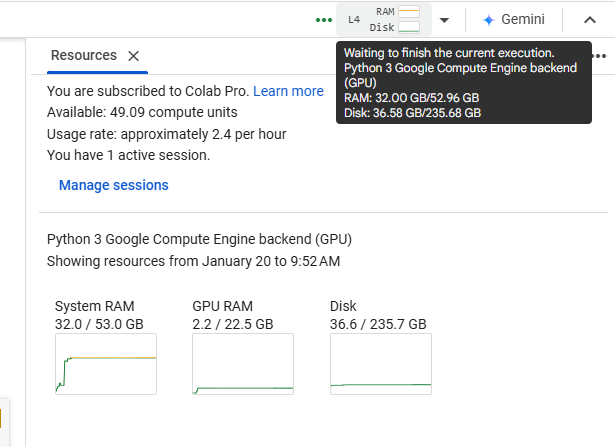

# Explanation about what is TEST on the trained model

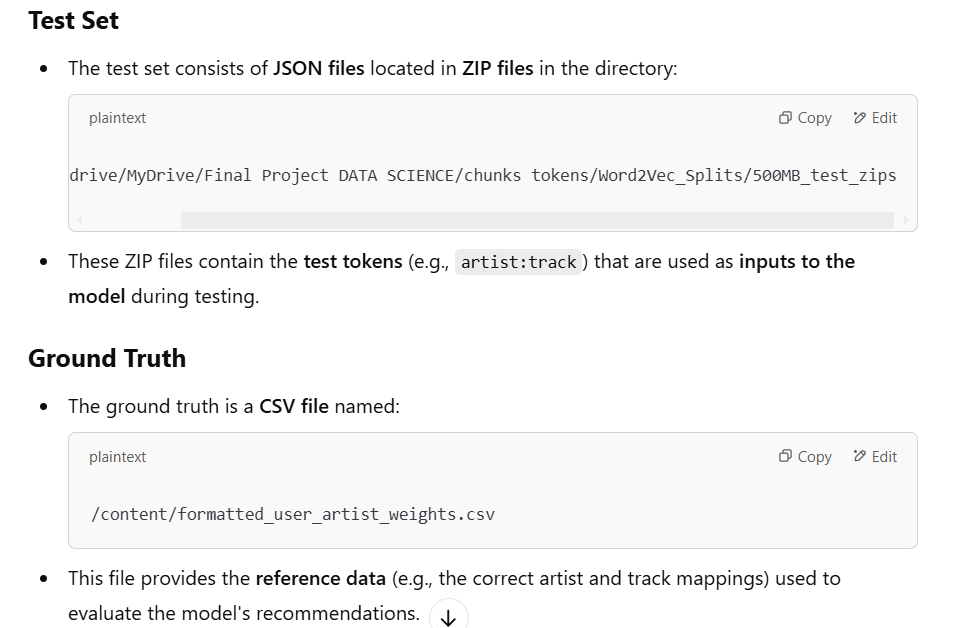

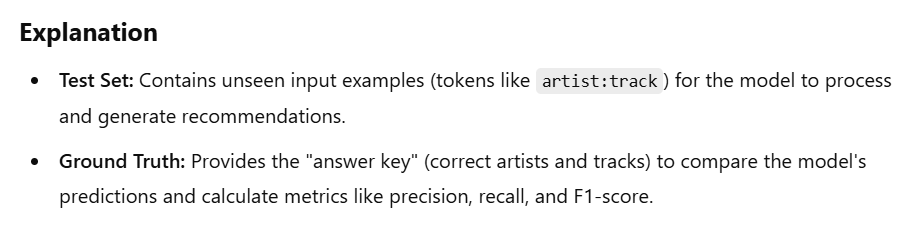

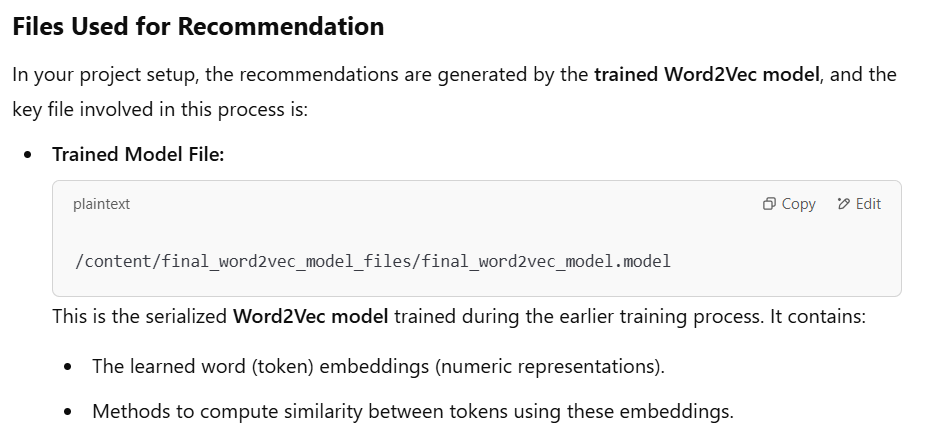

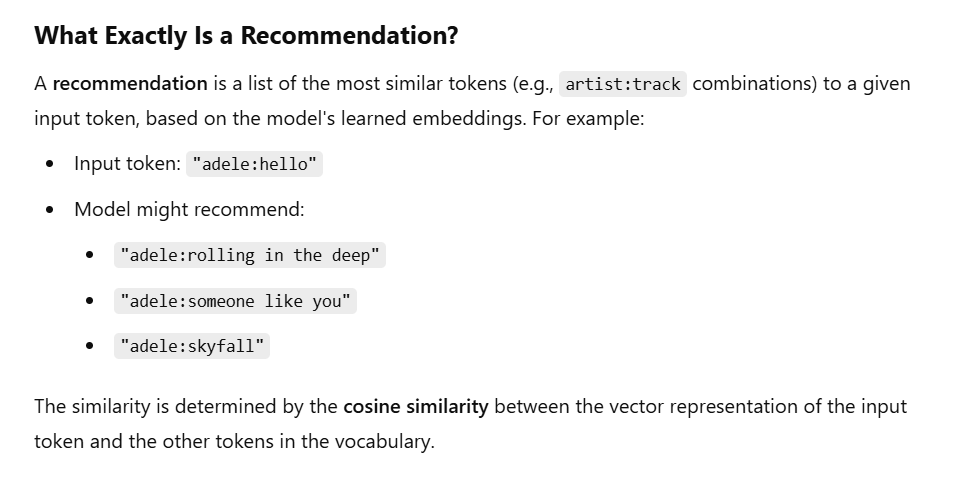

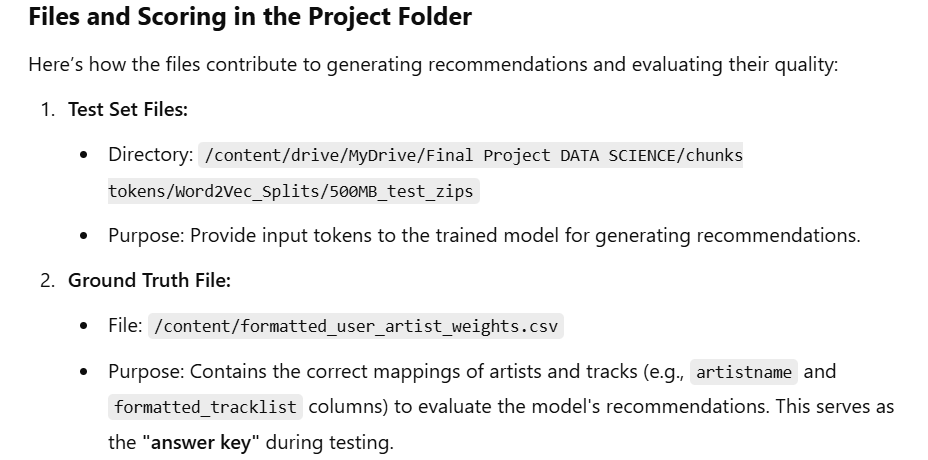

...

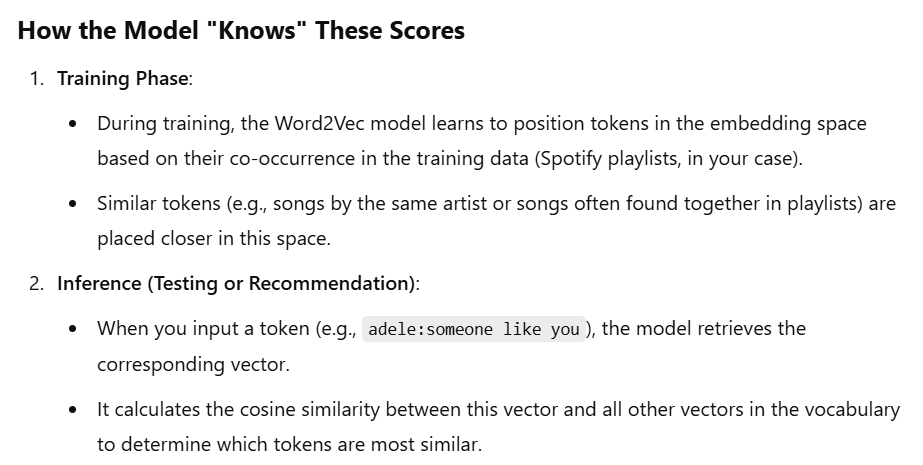

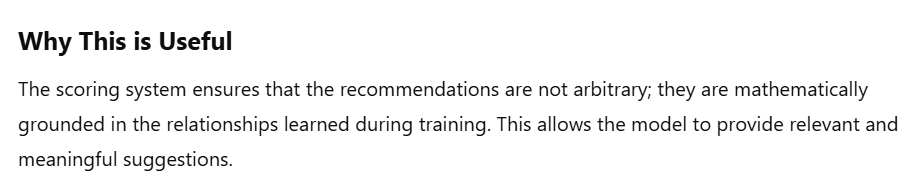

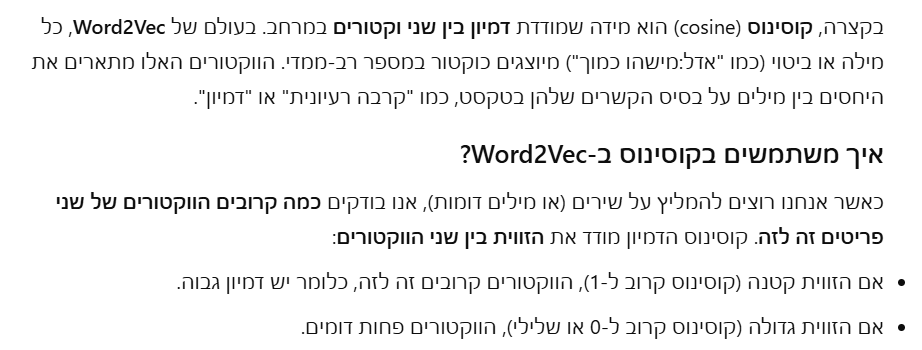

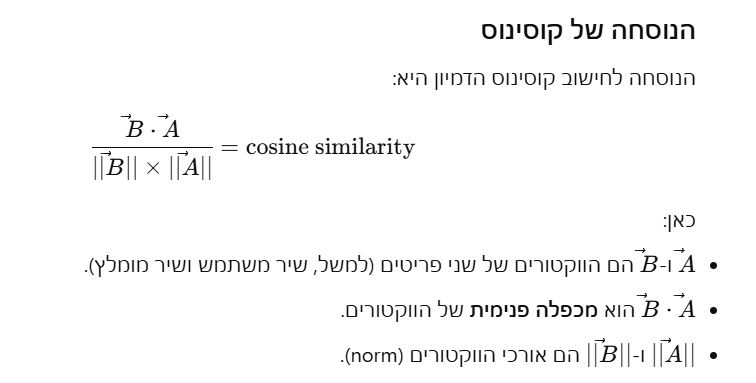

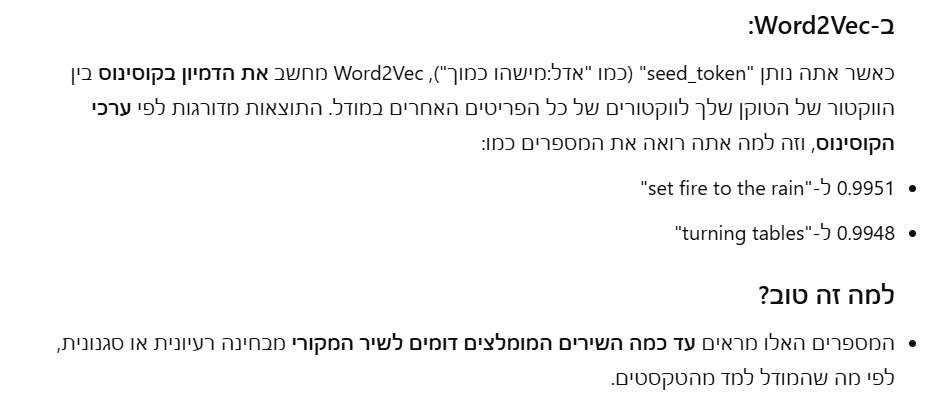

# Explaining the difference between WORD2VEC and other models (for example, ones that uses softmax algorithm)

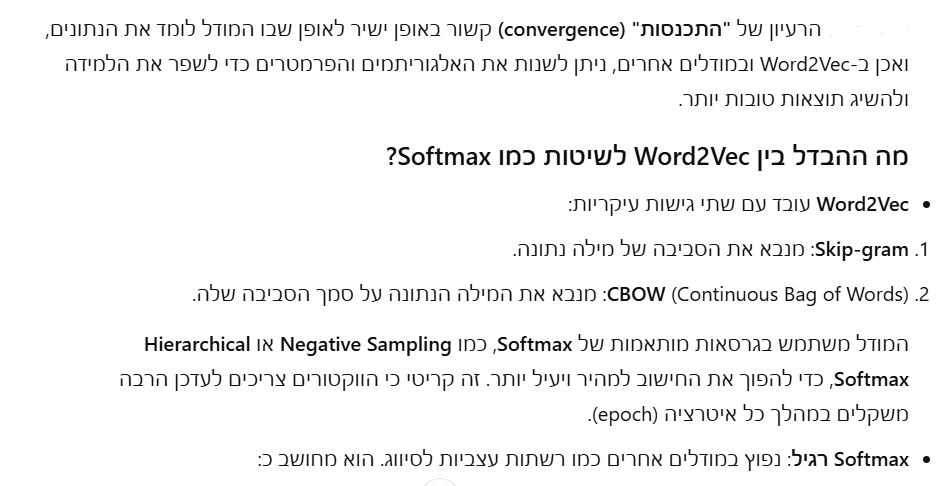

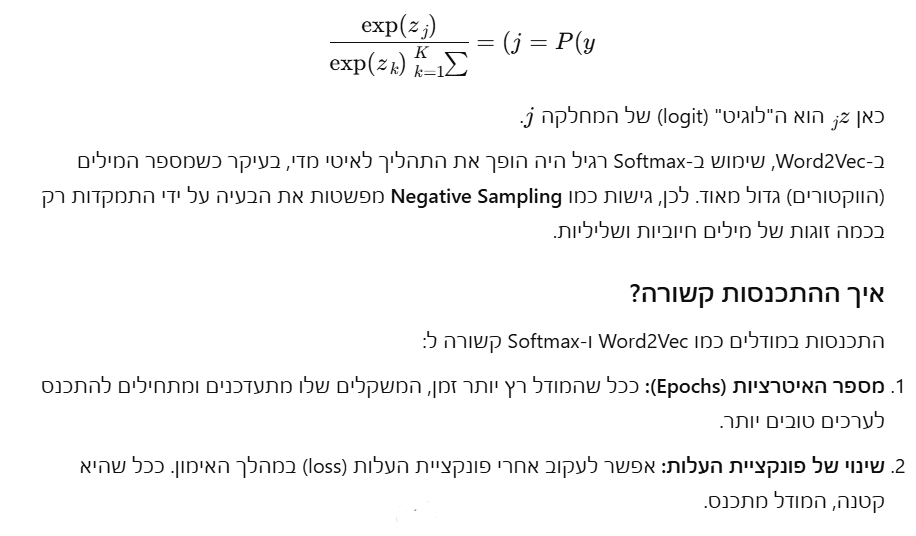

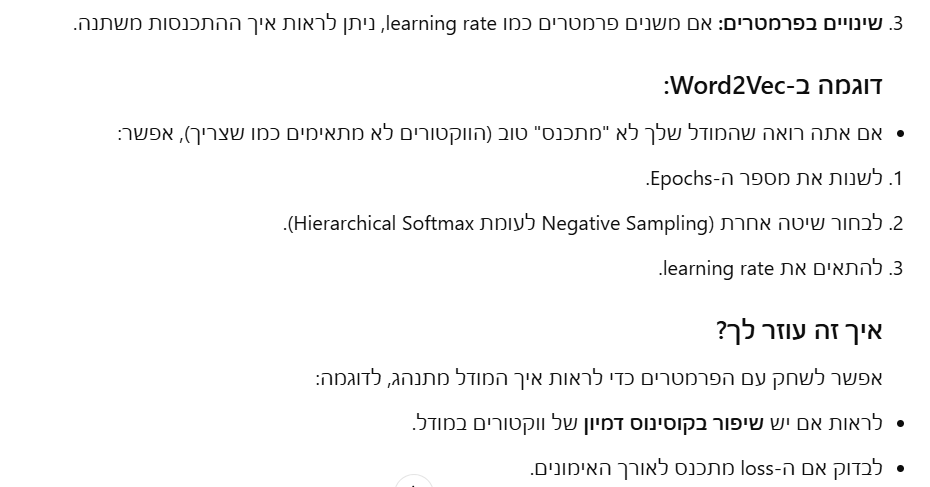

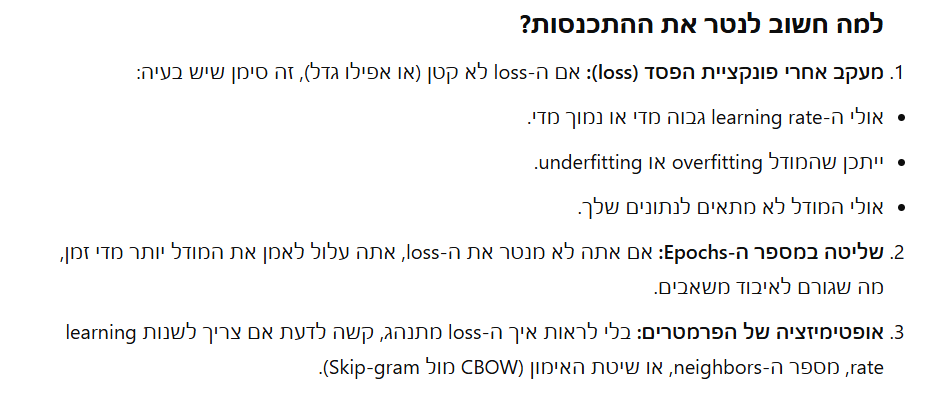

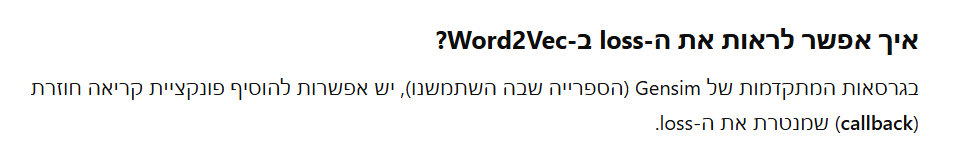

## Step 3: Build the Application
Implement a Streamlit app where users can interact with the trained model. Here's a general structure for your app:

In [7]:
!pip install streamlit


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.3/44.3 kB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.1/9.1 MB 63.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 99.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.1/79.1 kB 5.2 MB/s eta 0:00:00


In [9]:
import streamlit as st
from gensim.models import Word2Vec

# Load the trained Word2Vec model
model_path = '/content/drive/MyDrive/Final Project DATA SCIENCE/final4_word2vec_model.model'
model = Word2Vec.load(model_path)

# Streamlit UI
st.title("Personalized Playlist Recommender")
st.header("Enter a preffered song to get a personalized playlist!")

# User input
user_input = st.text_input("Enter song (artistname:trackname):", "")

if user_input:
    try:
        # Get recommendations
        recommendations = model.wv.most_similar(user_input, topn=10)
        recommended_tracks = [rec[0] for rec in recommendations]

        st.write("### Recommended Playlist:")
        for i, track in enumerate(recommended_tracks, 1):
            st.write(f"{i}. {track}")
    except KeyError:
        st.error("Song not found in the model's vocabulary. Please try another song.")


2025-01-22 11:16:05.615 WARNING streamlit.runtime.scriptrunner_utils.script_run_context: Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-01-22 11:16:05.875 
  command:

    streamlit run /usr/local/lib/python3.11/dist-packages/colab_kernel_launcher.py [ARGUMENTS]
2025-01-22 11:16:05.877 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-01-22 11:16:05.878 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-01-22 11:16:05.880 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-01-22 11:16:05.883 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-01-22 11:16:05.884 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-01-22 11:16:05.885 Thread 'MainThread': mi